# Домашняя работа №1 по дисциплине «МОВС: Компьютерное зрение» 

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

Выполнил:  
**Вольхин Данил Федорович**

Email:  
[dfvolkhin@edu.hse.ru](mailto:dfvolkhin@edu.hse.ru)

Дата:  
**26 января 2025**

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

😊 Первый раз в жизни делаю посадку на юпитер 😊

## ANSI коды для цветов текста

In [1]:
RED = "\033[31m"
GREEN = "\033[32m"
YELLOW = "\033[33m"
BLUE = "\033[34m"
RESET = "\033[0m"  # сброс цветов до стандартных

## Шаблоны markdown

<span style="color: green;"># Это комментарий в коде</span><br>
<span style="color: blue;">def</span> greet(name):<br>
<span style="color: red;">print</span>(f"Hello, {name}!")
<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">
<pre style="background-color: #F5F5F5; padding: 10px; border-radius: 5px; font-family: monospace;">code</pre>

## Установка библиотек

In [2]:
# !pip install torch==1.12.1+cu116 torchvision==0.13.1+cu116 --index-url https://download.pytorch.org/whl/cu116
# !pip install tensorboard==2.10.1 tensorflow==2.10.0
# !pip install pydantic==2.10.3
# !pip install tqdm==4.66.2
# !pip install scikit-learn==1.5.1
# !pip install scipy==1.13.1
# !pip install seaborn==0.13.2
# !pip install rich==13.7.1
# !pip install requests==2.32.3
# !pip install pillow==10.4.0
# !pip install pandas==2.2.2
# !pip install matplotlib==3.9.2
# !pip install duckdb==1.1.0
# !pip install annotated-types==0.7.0

# Подготовка к написанию кода

## Импорт библиотек

In [3]:
print(f"{YELLOW}"+60*"-"+f"{RESET}")
print(f"Библиотеки: \n")

# Дополнительные библиотеки
import platform # Узнать версию пайтона ;)
import os
import logging
import time
import sys
import random
import re
import shutil
from tqdm import tqdm
from functools import wraps
from typing import Any, Tuple, Union, Optional, List, Type, Callable, Dict
from collections import Counter
import zipfile
from dataclasses import dataclass

# Основные библиотеки
import IPython.display as ipd # Добавляет виджеты для ячеек юпитера
from IPython import get_ipython
import ipykernel
print(f"python: {BLUE}{platform.python_version()}{RESET} ")
import matplotlib # Для рисунков
import matplotlib.pyplot as plt
print(f"matplotlib: {BLUE}{matplotlib.__version__}{RESET}")
import numpy as np # Для работы с массивами
print(f"numpy: {BLUE}{np.__version__}{RESET}")
import pandas as pd # Работа с таблицами
print(f"pandas: {BLUE}{pd.__version__}{RESET}")
import sklearn # Много полезного для ML
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
print(f"sklearn: {BLUE}{sklearn.__version__}{RESET}")
import scipy
print(f"scipy: {BLUE}{scipy.__version__}{RESET}")
import pydantic # Для валидации данных
from pydantic import (BaseModel, Field, StrictStr, condecimal, StrictInt, StrictBool,
                      FilePath, DirectoryPath, ValidationError, root_validator, ConfigDict)
print(f"pydantic: {BLUE}{pydantic.__version__}{RESET}")
import fastapi
from fastapi import HTTPException, status
print(f"fastapi: {BLUE}{fastapi.__version__}{RESET}")
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Subset, WeightedRandomSampler
print(f"torch: {BLUE}{torch.__version__}{RESET}")
import torchvision
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torchvision.models as models
print(f"torchvision: {BLUE}{torchvision.__version__}{RESET}")
import requests
print(f"requests: {BLUE}{requests.__version__}{RESET}")
import PIL
from PIL import Image
print(f"Pillow: {BLUE}{PIL.__version__}{RESET}")

from rich.theme import Theme
from rich.logging import RichHandler
from rich.console import Console
from rich.pretty import install as pretty_install
from rich.traceback import install as traceback_install


print(f"{YELLOW}"+60*"-"+f"{RESET}")

------------------------------------------------------------
Библиотеки: 

python: 3.9.16 
matplotlib: 3.9.2
numpy: 1.26.4
pandas: 2.2.2
sklearn: 1.5.1
scipy: 1.13.1
pydantic: 2.10.3
fastapi: 0.115.7


C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


torch: 1.12.1+cu116
torchvision: 0.13.1+cu116
requests: 2.32.3
Pillow: 10.4.0
------------------------------------------------------------


## Дополнительные настройки

In [4]:
import warnings
warnings.filterwarnings("ignore")
import logging
# Отключение логирования для cmdstanpy
logging.getLogger('cmdstanpy').setLevel(logging.ERROR)
# Полезна при разработке собственных библиотек, юпитер будет переимпортировать модули, если в них были изменения
%load_ext autoreload
%autoreload 1

## Кастомный setup_logging

In [5]:
log = None

def setup_logging(clean=False, debug=False):
    global log

    if log is not None:
        return log

    try:
        if clean and os.path.isfile('setup.log'):
            os.remove('setup.log')
        time.sleep(0.1)  # prevent race condition
    except:
        pass

    if sys.version_info >= (3, 9):
        logging.basicConfig(level=logging.DEBUG, format='%(asctime)s | %(levelname)s | %(pathname)s | %(message)s',
                            filename='setup.log', filemode='a', encoding='utf-8', force=True)
    else:
        logging.basicConfig(level=logging.DEBUG, format='%(asctime)s | %(levelname)s | %(pathname)s | %(message)s',
                            filename='setup.log', filemode='a', force=True)

    console = Console(log_time=True, log_time_format='%H:%M:%S-%f', theme=Theme({
        "traceback.border": "black",
        "traceback.border.syntax_error": "black",
        "inspect.value.border": "black",
    }))
    pretty_install(console=console)
    traceback_install(console=console, extra_lines=1, width=console.width, word_wrap=False, indent_guides=False,
                      suppress=[])
    rh = RichHandler(show_time=True, omit_repeated_times=False, show_level=True, show_path=False, markup=False,
                     rich_tracebacks=True, log_time_format='%H:%M:%S-%f',
                     level=logging.DEBUG if debug else logging.INFO, console=console)
    rh.set_name(logging.DEBUG if debug else logging.INFO)
    log = logging.getLogger("sd")
    log.addHandler(rh)

    return log

In [6]:
log = setup_logging()

## Валидация входящих данных для каждого класса

### validate_with_pydantic

In [7]:
def validate_with_pydantic(model_cls):
    """
    Декоратор для валидации данных с использованием Pydantic-модели.
    """

    def decorator(func):
        @wraps(func)
        def wrapper(*args, **kwargs):
            # Проверяем данные в аргументах функции
            try:
                data = kwargs.get("entry", args[0] if args else None)
                if not data:
                    raise HTTPException(status_code=status.HTTP_400_BAD_REQUEST,
                                        detail="No data provided for validation.")
                # Валидация данных
                if isinstance(data, BaseModel):
                    data = data.dict(by_alias=True)
                validated_data = model_cls(**data)
                # Передаем валидированные данные дальше
                kwargs["entry"] = validated_data
                return func(*args, **kwargs)
            except ValidationError as ve:
                log.exception("Validation failed", exc_info=ve)
                raise HTTPException(status_code=status.HTTP_400_BAD_REQUEST,
                                    detail="Invalid data for Pydantic model.") from ve

        return wrapper

    return decorator

### auto_generate_docstring

In [8]:
def auto_generate_docstring(cls: Type[BaseModel]) -> Type[BaseModel]:
    """
    Декоратор для автоматического добавления docstring в классы Pydantic.
    """

    def generate_docstring(model: Type[BaseModel]) -> str:
        """
        Генерация строки документации из описания полей модели Pydantic.
        """
        docstring = []
        for field_name, field_info in model.__fields__.items():
            field_details = f"Field '{field_name}':\n"
            if field_info.description:  # Получение описания
                field_details += f"  Description: {field_info.description}\n"
            if field_info.examples:  # Получение примеров
                field_details += f"  Examples: {field_info.examples}\n"
            docstring.append(field_details)
        return "\n".join(docstring)

    # Добавляем описание к существующему docstring
    cls.__doc__ = (cls.__doc__ or "") + "\n\n" + generate_docstring(cls)
    return cls

### EntryGraduateModel

In [103]:
@auto_generate_docstring
class EntryGraduateModel(BaseModel):
    """
    Класс для валидации входных данных EntryGraduateModel
    """
    model_config = ConfigDict(arbitrary_types_allowed=True)
    Prefix: Optional[StrictStr] = Field("",
                                        alias="prefix",
                                        examples=["exp1"],
                                        descripton="Префикс к названию модели")
    Models: list[str] = Field(...,
                              alias="models",
                              examples=[["efficientnet_b0", "efficientnet_b1"]],
                              description="Список моделей для обучения")
    NameOptimizers: list[str] = Field(...,
                                      alias="name_optimizers",
                                      examples=[["Adam"]],
                                      description="Лист с названиями оптимизаторов из доступных в torch.nn.optim для каждой модели")
    UseImageNetWeights: Optional[bool] = Field(False,
                                               alias="is_use_imagenet_weights",
                                               examples=[True],
                                               description="Использовать предобученные веса ImageNet?")
    IsGray: Optional[bool] = Field(False,
                                   alias="is_gray",
                                   examples=[False],
                                   description="RGB в GrayScale?")
    NameLoss: Optional[StrictStr] = Field("CrossEntropyLoss",
                                          alias="name_loss",
                                          examples=["name_loss"],
                                          description="Название функции потерь из torch.utils")
    SizeImg: Optional[tuple] = Field((64, 64),
                                     alias="size_img",
                                     examples=[(224, 224)],
                                     description="Размер изображения для обучения")
    Ratio: Optional[tuple] = Field((60, 20, 20),
                                   alias="ratio",
                                   examples=[(60, 20, 20)],
                                   description="Доля тренировочной, валидационной и тестовой выборок")
    PathData: Optional[StrictStr] = Field("./data",
                                          alias="path_to_data",
                                          examples=["./data"],
                                          description="Путь к директории с данными. Дефолтный путь ./data")
    PathWeights: Optional[StrictStr] = Field("./weights",
                                             alias="path_to_weights",
                                             examples=["./weights"],
                                             description="Если сохраняем веса, то куда? Дефолтный путь ./weights")
    PathMetricsTrain: Optional[StrictStr] = Field("./metrics_train",
                                                  alias="path_to_metrics_train",
                                                  examples=["./metrics_train"],
                                                  description="Куда сохраняем тренировочные метрики? Дефолтный путь ./metrics_train")
    PathMetricsTest: Optional[StrictStr] = Field("./metrics_test",
                                                 alias="path_to_metrics_test",
                                                 examples=["./metrics_test"],
                                                 description="Куда сохраняем тестовые метрики? Дефолтный путь ./metrics_test")
    PathSavePlots: Optional[StrictStr] = Field("./plot",
                                               alias="path_to_save_plots",
                                               examples=["./plot"],
                                               description="Куда сохраняем графики результатов обучения? Дефолтный путь ./plot")
    UseDevice: Optional[StrictStr] = Field(None,
                                           alias="use_device",
                                           examples=["cuda"],
                                           description="Какое устройство использовать? cpu/cuda")
    StartLerningRate: Optional[condecimal(ge=0.00000001, le=0.01, decimal_places=8)] = Field(0.0001,
                                                                                             alias="start_learning_rate",
                                                                                             examples=[0.0001],
                                                                                             description="Начальная величина шага градиентного спуска")
    BatchSize: Optional[StrictInt] = Field(1,
                                           alias="batch_size",
                                           examples=[10],
                                           description="Размер пакета при обучении")
    NumWorkers: Optional[StrictInt] = Field(0,
                                            alias="num_workers",
                                            examples=[0],
                                            description="Кол. используемых потоков при подгрузке данных DataLoader (0 это 1)")
    PinMemory: Optional[StrictBool] = Field(False,
                                            alias="pin_memory",
                                            examples=[False],
                                            description="Если True ускоряет загрузку данных на видеокарте, для cpu всегда False")
    NumEpochs: Optional[StrictInt] = Field(3,
                                           alias="num_epochs",
                                           examples=[20],
                                           description="Количество эпох обучения для каждой модели")
    Seed: Optional[StrictInt] = Field(17,
                                      alias="seed",
                                      examples=[17],
                                      description="Сажает зерно")
    ClassPercentages: Optional[dict[str, int]] = Field(None,
                                                       alias="class_persantages",
                                                       examples=[{"cats": 0.2, "dogs": 0.4}],
                                                       description="Доля используемых данных в обучении для каждого класса")
    UseClassWeights: Optional[bool] = Field(False,
                                            alias="is_use_class_weights",
                                            examples=[True],
                                            description="Учитывать ли веса классов в функции потерь?")
    ResamplingMethod: Optional[str] = Field(None,
                                            alias="resampling_method",
                                            examples=["undersampling"],
                                            description="Метод resampling: oversampling, undersampling, None")

### EntryInferenceModel

In [148]:
@auto_generate_docstring
class EntryInferenceModel(BaseModel):
    """
    Класс для валидации входных данных EntryInferenceModel
    """
    model_config = ConfigDict(arbitrary_types_allowed=True)
    Prefix: Optional[StrictStr] = Field("",
                                        alias="prefix",
                                        examples=["exp1"],
                                        descripton="Префикс к названию модели")
    NameModel: StrictStr = Field(...,
                                 alias="name_model",
                                 examples=["efficientnet_b0_2024_10_02)"],
                                 description="Название файла .pt")
    NumClasses: Optional[StrictInt] = Field(2,
                                            alias="num_classes",
                                            examples=[2],
                                            description="Количество классов")
    ImageList: list[StrictStr] = Field(...,
                                       alias="image_path_list",
                                       examples=[["./images/image.jpg"]],
                                       description="Список путей к изображениям")
    SizeImg: Optional[tuple] = Field((64, 64),
                                     alias="size_img",
                                     examples=[(224, 224)],
                                     description="Размер изображения для инференса")
    PathWeights: Optional[StrictStr] = Field("./weights",
                                             alias="path_to_weights",
                                             examples=["./weights"],
                                             description="Путь к папке, где хранятся веса модели? Дефолтный путь ./weights")
    Plots: Optional[StrictBool] = Field(False,
                                        alias="plots",
                                        examples=[True],
                                        description="Строить рисунки? Да/Нет")
    SavePlots: Optional[StrictBool] = Field(True,
                                            alias="save_plots",
                                            examples=[True],
                                            description="Сохранять рисунки? Да/Нет")
    SavePathPlots: Optional[StrictStr] = Field("./result",
                                               alias="save_path_plots",
                                               examples=["./plot"],
                                               description="Если сохраняем рисунки, то куда? Дефолтный путь ./plot")
    UseDevice: Optional[StrictStr] = Field(None,
                                           alias="use_device",
                                           examples=["cuda"],
                                           description="Какое устройство использовать? cpu/cuda")
    GroundTruth: Optional[list[int]] = Field(None,
                                             alias="ground_truth",
                                             examples=[[1, 0]],
                                             description="Список ground truth меток для изображений")
    Classes: Optional[list[str]] = Field(None,
                                         alias="classes",
                                         examples=[["cat", "dog"]],
                                         description="Список названий классов")

# Загрузка и предобработка данных

## Загрузка и распаковка набор данных CatVsDogs

In [11]:
class CatsVsDogsDatasetDownloader:
    def __init__(self, download_url, target_dir):
        self.download_url = download_url
        self.target_dir = target_dir
        self.dataset_zip = os.path.join(self.target_dir, 'cats_vs_dogs.zip')

    def download_dataset(self):
        os.makedirs(self.target_dir, exist_ok=True)
        response = requests.get(self.download_url, stream=True)
        total_size = int(response.headers.get('content-length', 0))
        
        with open(self.dataset_zip, 'wb') as file, tqdm(
            desc="Downloading CatsVsDogs Dataset",
            total=total_size,
            unit='B',
            unit_scale=True,
            unit_divisor=1024
        ) as bar:
            for data in response.iter_content(chunk_size=1024):
                file.write(data)
                bar.update(len(data))

    def extract_dataset(self):
        with zipfile.ZipFile(self.dataset_zip, 'r') as zip_ref:
            zip_ref.extractall(self.target_dir)

    def organize_dataset(self):
        # Определяем пути
        extracted_dir = os.path.join(self.target_dir, 'cats_and_dogs_filtered')
        cat_dir = os.path.join(self.target_dir, 'data', 'cats')
        dog_dir = os.path.join(self.target_dir, 'data', 'dogs')
    
        # Создаем целевые директории
        os.makedirs(cat_dir, exist_ok=True)
        os.makedirs(dog_dir, exist_ok=True)
    
        # Перенос файлов из train и validation
        for subset in ['train', 'validation']:
            subset_dir = os.path.join(extracted_dir, subset)
    
            for label in ['cats', 'dogs']:
                src_dir = os.path.join(subset_dir, label)
                target_dir = cat_dir if label == 'cats' else dog_dir
    
                for filename in os.listdir(src_dir):
                    src_file = os.path.join(src_dir, filename)
                    target_file = os.path.join(target_dir, filename)
    
                    # Проверяем, существует ли файл в целевой папке
                    if os.path.isfile(src_file) and not os.path.exists(target_file):
                        os.rename(src_file, target_file)
    
        # Удаляем временные файлы и папки
        os.remove(self.dataset_zip)
        shutil.rmtree(extracted_dir)  # Рекурсивно удаляем папку вместе с файлами

    def download_and_prepare(self):
        self.download_dataset()
        self.extract_dataset()
        self.organize_dataset()

In [12]:
# Скачивание и подготовка данных
dataset_url = "https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip"
target_directory = "./"

downloader = CatsVsDogsDatasetDownloader(dataset_url, target_directory)
downloader.download_and_prepare()

<span style="color: green;">Это отфильтрованный набор данных, он содержит меньше примеров, с крупным обучение долгое</span><br>

## Формирование датасета для обучения TrainDirCreator

In [12]:
class TrainDirCreator:

    def __init__(self,
                 image_dirs: list,
                 dest_dir: str,
                 ratio=(60, 20, 20)):
        self.dirs = image_dirs
        self.dest_dir = dest_dir
        self.ratio = ratio

        """
        ratio[0] = train
        ratio[1] = test
        ratio[2] = valid
        """

    def create_train_dirs(self):

        output_dir = self.dest_dir
        
        # Создание основной директории
        if not os.path.exists(output_dir):
            os.makedirs(output_dir)

        # Создание поддиректорий для train, test и validation
        for dataset_type in ["train_dataset", "test_dataset", "valid_dataset"]:
            dataset_path = os.path.join(output_dir, dataset_type)
            if not os.path.exists(dataset_path):
                os.makedirs(dataset_path)

        # Перемешивание и распределение изображений
        for image_dir in self.dirs:
            class_name = os.path.basename(image_dir)
            print(f"\nClass_name: {class_name}")
            image_list = os.listdir(image_dir)
            random.shuffle(image_list)
            total_images = len(image_list)
            train_count = int(total_images * self.ratio[0] / 100)
            print(f"Train_count: {train_count}")
            test_count = int(total_images * self.ratio[1] / 100)
            print(f"Test_count: {test_count}")
            valid_count = int(total_images * self.ratio[2] / 100)
            print(f"Valid_count: {valid_count}")

            # Перемешивание и копирование изображений в директории
            for i, image_name in enumerate(tqdm(image_list, desc="Shutil images", unit="image")):
                src_path = os.path.join(image_dir, image_name)
                if i < train_count:
                    dest_path = os.path.join(output_dir, "train_dataset", class_name, image_name)
                elif i < train_count + test_count:
                    dest_path = os.path.join(output_dir, "test_dataset", class_name, image_name)
                else:
                    dest_path = os.path.join(output_dir, "valid_dataset", class_name, image_name)

                # Создание директории для класса, если ее нет
                if not os.path.exists(os.path.dirname(dest_path)):
                    os.makedirs(os.path.dirname(dest_path))

                shutil.copy(src_path, dest_path)


def get_path_to_dir(path_to_data):
    list_dir = os.listdir(path_to_data)
    test_dir = os.path.join(path_to_data, list_dir[0])
    train_dir = os.path.join(path_to_data, list_dir[1])
    valid_dir = os.path.join(path_to_data, list_dir[2])
    return train_dir, test_dir, valid_dir

# Обучение моделей

## FocalLoss

In [13]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=None, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        if isinstance(alpha, (list, torch.Tensor)):
            self.alpha = torch.tensor(alpha, dtype=torch.float32)
        else:
            self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        ce_loss = F.cross_entropy(inputs, targets, reduction='none', weight=self.alpha)
        pt = torch.exp(-ce_loss)
        focal_loss = ((1 - pt) ** self.gamma) * ce_loss
        if self.reduction == 'mean':
            return focal_loss.mean()
        elif self.reduction == 'sum':
            return focal_loss.sum()
        else:  # 'none'
            return focal_loss

In [14]:
# Пример с двумя классами, вес для классов: [0.75, 0.25]
# focal_loss = FocalLoss(alpha=[0.75, 0.25], gamma=2, reduction='mean')

## CustomSubset

In [196]:
class CustomSubset(Subset):
    def __init__(self, dataset, indices):
        super().__init__(dataset, indices)
        self.classes = dataset.classes  # Сохраняем классы из оригинального датасета
        self.targets = [dataset.targets[i] for i in indices]  # Сохраняем targets

## GraduateModel

In [197]:
class GraduateModel:

    def __init__(self,
                 prefix: str = "",
                 name_model: str = "efficientnet_b0",
                 path_to_data: str = "./data",
                 path_to_weights: str = "./weights",
                 path_to_metrics_train: str = "./metrics_train",
                 path_to_metrics_test: str = "./metrics_test",
                 is_use_imagenet_weights: bool = True,
                 name_optimizer: str = "Adam",
                 num_epochs: int = 3,
                 batch_size: int = 1,
                 train_size_img: tuple = (224, 224),
                 ratio: tuple = (60, 20, 20),
                 is_gray: str = False,
                 class_percentages: dict = None,
                 name_loss: str = None,
                 is_use_class_weights: bool = False,
                 resampling_method: str = None,
                 use_device: str = None,
                 start_learning_rate: float = None,
                 pin_memory: bool = False,
                 num_workers: int = 0,
                 seed: int = 17):
        
        self.name_model = name_model
        self.name_model_user = f"{self.name_model}_{prefix}" if prefix != "" else self.name_model
        self.path_to_data = path_to_data
        directories_to_create = [path_to_weights, path_to_metrics_train, path_to_metrics_test]
        self.create_directories_if_not_exist(*directories_to_create)
        self.path_to_weights = os.path.join(path_to_weights, f"{self.name_model_user}.pt")
        self.path_to_metrics_train = os.path.join(path_to_metrics_train, f"{self.name_model_user}.pt")
        self.path_to_metrics_test = os.path.join(path_to_metrics_test, f"{self.name_model_user}.pt")
        self.num_epochs = num_epochs
        self.batch_size = batch_size
        self.size_img = train_size_img
        self.name_optimizer = name_optimizer
        self.size_img = train_size_img
        self.model = None
        self.train_loader = None
        self.valid_loader = None
        self.test_loader = None
        self.classes = None
        self.total_samples = None
        self.targets = None
        self.class_counts = None
        self.class_weights = None
        self.criterion = None
        self.scheduler = None
        self.imagenet = is_use_imagenet_weights
        self.is_gray = is_gray
        self.class_percentages = class_percentages
        self.name_loss = name_loss
        self.is_use_class_weights = is_use_class_weights
        self.resampling_method = resampling_method
        self.ratio = ratio
        self.use_device = use_device
        self.start_learning_rate = start_learning_rate
        self.pin_memory = pin_memory
        self.num_workers = num_workers
        self.seed = seed

        # Получение списка доступных моделей
        self.model_list = sorted(name for name in models.__dict__
                                 if name.islower() and not name.startswith("__")
                                 and name != "get_weight"
                                 and callable(models.__dict__[name]))

        # Перемещение модели на GPU, если CUDA доступен
        if self.use_device == None:
            self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        elif self.use_device == "cuda":
            self.device = torch.device("cuda")
        elif self.use_device == "cpu":
            if self.pin_memory == True:
                raise Exception("pin_memory musn't be True with use_device cpu")
            self.device = torch.device("cpu")
        else:
            raise Exception("use_device must be cuda or cpu or None")

    @staticmethod
    def seed_everything(seed):
        random.seed(seed)
        os.environ["PYTHONHASHSEED"] = str(seed)
        np.random.seed(seed)
        torch.manual_seed(seed)
        torch.cuda.manual_seed(seed)
        torch.backends.cudnn.deterministic = True

    def graduate(self):
        # Фиксируем зерно
        self.seed_everything(self.seed)
        # Получаем трансформер
        self.get_transform()
        # Получаем генераторы обучения, валидации и теста
        self.get_loaders()
        # Загружаем модель
        self.get_model()
        # Получаем веса классов
        self.get_classes_weights()
        # Определяем оптимизатор, функцию потерь и планировщик
        self.get_opt_crit_sh()
        # Вывод архитектуры
        """summary(self.model,
                (3, self.size_img[0], self.size_img[1]),
                self.batch_size)"""
        # Выводим информацию
        print(self.__str__())
        # Обучаем
        self.train_model()
        # Тестируем
        self.evaluate_model()

    def __str__(self):

        return f"""
        
        ----------------------------------------------------------------------
        
        Выбранная модель: {self.name_model}
        Пользовательское название модели: {self.name_model_user}
        Выбранный оптимизатор: {self.name_optimizer}
        
        ----------------------------------------------------------------------
        
        """

    def create_directories_if_not_exist(self, *directories):
        for directory in directories:
            if not os.path.exists(directory):
                os.makedirs(directory)

    # Функция для показа изображения
    def image_show(self, img):
        img = img / 2 + 0.5  # unnormalize
        np_img = img.cpu().numpy()
        plt.imshow(np.transpose(np_img, (1, 2, 0)))
        plt.show()

    # Функция для сохранения модели
    def save_model(self):
        # Сохраняем модель
        torch.save({
            'epoch': self.num_epochs,
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict()},
            f"{self.path_to_weights}")

    def save_metrics_train(self,
                           train_loss_values,
                           valid_loss_values,
                           f1_values):
        metrics = {
            'train_loss': train_loss_values,
            'valid_loss': valid_loss_values,
            'valid_f1': f1_values
        }
        # Сохранение метрик
        torch.save(metrics, self.path_to_metrics_train)

    def save_metrics_test(self,
                          f1,
                          class_acc_dir):
        metric = {
            'f1_value': f1,
            'Acc_dir': class_acc_dir
        }
        # Сохранение метрик
        torch.save(metric, self.path_to_metrics_test)

    def get_transform(self):
        if self.is_gray:
            self.transform = {
                "train": transforms.Compose([
                    transforms.Resize((self.size_img[0], self.size_img[1])),
                    transforms.RandomHorizontalFlip(),
                    transforms.RandomResizedCrop(size=(self.size_img[0], self.size_img[1])),
                    transforms.ToTensor()
                ]),
                "valid": transforms.Compose([
                    transforms.Resize((self.size_img[0], self.size_img[1])),
                    transforms.ToTensor()
                ])
            }
        else:
            self.transform = {
                "train": transforms.Compose([
                    transforms.Resize((self.size_img[0], self.size_img[1])),
                    transforms.AutoAugment(),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                ]),
                "valid": transforms.Compose([
                    transforms.Resize((self.size_img[0], self.size_img[1])),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                ])
            }

    @staticmethod
    def create_imbalanced_dataset(dataset, class_percentages):
    
        # Проверка входных данных
        if not hasattr(dataset, 'classes'):
            raise ValueError("Dataset must have a 'classes' attribute containing class names.")
    
        # Построим индексы для каждого класса
        class_to_indices = {class_name: [] for class_name in dataset.classes}
        for i, (_, label) in enumerate(dataset):
            class_name = dataset.classes[label]
            class_to_indices[class_name].append(i)
    
        # Отберем заданный процент для каждого класса
        selected_indices = []
        for class_name, percentage in class_percentages.items():
            if class_name not in class_to_indices:
                raise ValueError(f"Class '{class_name}' not found in the dataset.")
            if not (0 <= percentage <= 1):
                raise ValueError("Percentage values must be between 0 and 1.")
    
            class_indices = class_to_indices[class_name]
            selected_count = int(len(class_indices) * percentage)
            selected_indices.extend(random.sample(class_indices, selected_count))
    
        # Создаем поднабор данных
        return Subset(dataset, selected_indices)

    def get_classes_weights(self):
        # Получение количества примеров для каждого класса
        self.class_counts = np.bincount(self.targets)
        # Вычисление весов классов
        self.class_weights = torch.tensor([self.total_samples / count for count in self.class_counts],
                                          dtype=torch.float)
        self.class_weights = self.class_weights.to(self.device)

    # Функция для undersampling
    @staticmethod
    def create_undersampled_dataset(dataset):
        class_counts = Counter([label for _, label in dataset])
        min_class_count = min(class_counts.values())
        # Вычисление индексов для каждого класса
        class_indices = {cls: np.where(np.array(dataset.targets) == cls)[0] for cls in class_counts.keys()}
        # Обрезка индексов до минимального количества
        undersampled_indices = []
        for cls, indices in class_indices.items():
            undersampled_indices.extend(indices[:min_class_count])
        # Создание поднабора
        return CustomSubset(dataset, undersampled_indices)

    @staticmethod
    def create_oversampled_dataset(dataset):
        class_counts = Counter([label for _, label in dataset])
        max_class_count = max(class_counts.values())
        # Сохранение индексов для каждого класса
        class_indices = {cls: np.where(np.array(dataset.targets) == cls)[0] for cls in class_counts.keys()}
        oversampled_indices = []
        for cls, indices in class_indices.items():
            # Дублирование индексов, чтобы достичь максимального размера класса
            oversampled_indices.extend(
                np.random.choice(indices, size=max_class_count, replace=True)
            )
        # Создание поднабора
        return CustomSubset(dataset, oversampled_indices)

    # Функция для загрузки данных
    def get_loaders(self):
        # Список файлов с полными путями
        full_paths = [os.path.join(self.path_to_data, file) for file in os.listdir(self.path_to_data)]
        # Передача в TrainDirCreator
        train_dir_creator = TrainDirCreator(full_paths, "./dataset", self.ratio)
        train_dir_creator.create_train_dirs()
        # Получаем пути к директориям
        train_dir, test_dir, valid_dir = get_path_to_dir("./dataset")
        # Создание датасетов
        train_dataset = ImageFolder(train_dir, transform=self.transform["train"])
        test_dataset = ImageFolder(test_dir, transform=self.transform["valid"])
        valid_dataset = ImageFolder(valid_dir, transform=self.transform["valid"])

        if self.class_percentages is not None:
            # Создание несбалансированного датасета
            train_dataset = self.create_imbalanced_dataset(train_dataset, self.class_percentages)

        resampling_method_list = ["oversampling", "undersampling", None]

        if self.resampling_method not in resampling_method_list:
            raise Exception("resampling_method must be oversampling or undersampling")
        
        if self.resampling_method == "oversampling":
            train_dataset = self.create_oversampled_dataset(train_dataset)
        elif self.resampling_method == "undersampling":
            train_dataset = self.create_undersampled_dataset(train_dataset)
        
        # Создание загрузчиков данных
        self.train_loader = DataLoader(train_dataset, batch_size=self.batch_size, pin_memory=self.pin_memory,
                                       num_workers=self.num_workers, shuffle=True)
        self.test_loader = DataLoader(test_dataset, batch_size=self.batch_size, pin_memory=self.pin_memory,
                                      num_workers=self.num_workers, shuffle=False)
        self.valid_loader = DataLoader(valid_dataset, batch_size=self.batch_size, pin_memory=self.pin_memory,
                                       num_workers=self.num_workers, shuffle=False)
        # Список классов
        self.classes = train_dataset.classes
        self.total_samples = len(train_dataset)
        self.targets = train_dataset.targets

    def get_model(self):
        # Проверка доступности модели в torchvision
        if self.name_model in self.model_list:
            # Проверка доступности весов ImageNet
            if self.imagenet:
                try:
                    if self.name_model in ["inception_v3", "googlenet"]:
                        # Попытка загрузки модели с весами ImageNet
                        self.model = models.__dict__[self.name_model](init_weights=True)
                    else:
                        if self.name_model in ["regnet_y_128gf", "vit_h_14"]:
                            self.model = models.__dict__[self.name_model](weights="IMAGENET1K_SWAG_E2E_V1")
                        else:
                            self.model = models.__dict__[self.name_model](weights="IMAGENET1K_V1")
                except KeyError:
                    # Если веса ImageNet для данной модели недоступны, загрузка без весов
                    print(
                        f"Предобученные веса ImageNet для модели {self.name_model} недоступны."
                        f" Загрузка модели без предобученных весов.")
                    if self.name_model in ["inception_v3", "googlenet"]:
                        # Попытка загрузки модели с весами ImageNet
                        self.model = models.__dict__[self.name_model](init_weights=False)
                    else:
                        self.model = models.__dict__[self.name_model](weights=None)
            else:
                # Если не указано использование весов ImageNet, загрузить модель без них
                if self.name_model in ["inception_v3", "googlenet"]:
                    self.model = models.__dict__[self.name_model](init_weights=False)
                else:
                    self.model = models.__dict__[self.name_model](weights=None)

            try:
                name_without_numbers = re.sub(r'\d+', '', self.name_model)
                # Проверка доступности слоя classifier
                if hasattr(self.model, 'classifier'):
                    if name_without_numbers == "densenet":
                        num_features = self.model.classifier.in_features
                        self.model.classifier = nn.Linear(num_features, len(self.classes))
                    elif name_without_numbers == "squeezenet_":
                        num_features = 512
                        self.model.classifier[-1] = nn.Linear(num_features, len(self.classes))
                    else:
                        num_features = self.model.classifier[-1].in_features
                        self.model.classifier[-1] = nn.Linear(num_features, len(self.classes))
                elif hasattr(self.model, 'last_linear'):
                    num_features = self.model.last_linear.in_features
                    self.model.last_linear = nn.Linear(num_features, len(self.classes))
                elif hasattr(self.model, 'fc'):
                    num_features = self.model.fc.in_features
                    self.model.fc = nn.Linear(num_features, len(self.classes))
                elif hasattr(self.model, 'head'):
                    num_features = self.model.head.in_features
                    self.model.head = nn.Linear(num_features, len(self.classes))
                elif hasattr(self.model, "heads"):
                    num_features = self.model.heads[0].in_features
                    self.model.heads[0] = nn.Linear(num_features, len(self.classes))
                else:
                    print(f"Слой classifier не найден в модели. name_model:{self.name_model}")
            except Exception as ex:
                print(f"Exception: {ex}, name_model: {self.name_model}")

            # Перемещение модели на GPU и указание устройства
            self.model = self.model.to(self.device)
        else:
            print(f"Модель {self.name_model} не найдена в torchvision."
                  f"\nСписок доступных моделей: {self.model_list}")

    def get_opt_crit_sh(self):
        # Определение функции потерь с учетом весов классов
        available_losses = ["CrossEntropyLoss", "MSELoss", "L1Loss"]  # список доступных лоссов
        
        if self.name_loss == "FocalLoss":
            # Используем кастомный FocalLoss
            self.class_weights = self.class_weights if self.is_use_class_weights else None
            self.criterion = FocalLoss(alpha=self.class_weights, gamma=2)
        elif self.name_loss in available_losses:
            # Используем лоссы из torch.nn
            loss_class = getattr(nn, self.name_loss, None)
            if loss_class is None:
                raise ValueError(f"Loss function {self.name_loss} is not available in torch.nn")
            self.class_weights = self.class_weights if self.is_use_class_weights else None
            self.criterion = loss_class(weight=self.class_weights)
        else:
            raise ValueError(f"Loss function {self.name_loss} is not recognized")
    
        # Определение оптимизатора
        if self.start_learning_rate is not None:
            lr = self.start_learning_rate
        else:
            lr = 0.001
            
        self.optimizer = optim.__dict__[f"{self.name_optimizer}"](self.model.parameters(), lr=lr)
        
        # Создание планировщика LR
        # ReduceLROnPlateau уменьшает скорость обучения, когда метрика перестает уменьшаться
        self.scheduler = ReduceLROnPlateau(self.optimizer, mode='min', patience=2, verbose=True)

    # Функция для обучения модели с валидацией
    def train_model(self):

        train_loss_values = []
        valid_loss_values = []
        f1_values = []

        for epoch in range(self.num_epochs):
            self.model.train()
            running_loss = 0.0
            for inputs, labels in tqdm(self.train_loader, desc=f"Epoch {epoch + 1}/{self.num_epochs} (Train)",
                                       unit="sample"):
                inputs, labels = inputs.cuda(), labels.cuda()
                self.optimizer.zero_grad()
                outputs = self.model(inputs)
                loss = self.criterion(outputs, labels)
                loss.backward()
                self.optimizer.step()
                running_loss += loss.item() * inputs.size(0)

            # Вычисление loss на валидационном датасете и метрик
            self.model.eval()
            valid_loss = 0.0
            best_f1 = 0.0
            all_predictions = []
            all_labels = []
            with torch.no_grad():
                for inputs, labels in tqdm(self.valid_loader, desc=f"Epoch {epoch + 1}/{self.num_epochs} (Eval)",
                                           unit="sample"):
                    inputs, labels = inputs.cuda(), labels.cuda()
                    outputs = self.model(inputs)
                    loss = self.criterion(outputs, labels)
                    valid_loss += loss.item() * inputs.size(0)
                    _, predicted = torch.max(outputs, 1)
                    all_predictions.extend(predicted.cpu().numpy())
                    all_labels.extend(labels.cpu().numpy())

            epoch_loss = running_loss / len(self.train_loader.dataset)
            valid_loss = valid_loss / len(self.valid_loader.dataset)

            accuracy = accuracy_score(all_labels, all_predictions)
            precision = precision_score(all_labels, all_predictions, average='weighted')
            recall = recall_score(all_labels, all_predictions, average='weighted')
            f1 = f1_score(all_labels, all_predictions, average='weighted')

            # Сообщаем планировщику LR о текущей ошибке на валидационном наборе
            self.scheduler.step(valid_loss)

            # we want to save the model if the accuracy is the best
            if f1 > best_f1:
                self.save_model()
                best_f1 = f1

            # Добавление значений метрик в списки
            train_loss_values.append(epoch_loss)
            valid_loss_values.append(valid_loss)
            f1_values.append(f1)

            # Сохранение метрик
            self.save_metrics_train(train_loss_values,
                                    valid_loss_values,
                                    f1_values)

            print(f"\nEpoch {epoch + 1}/{self.num_epochs}, Training Loss: {epoch_loss}, Validation Loss: {valid_loss}")
            print(f"Accuracy: {accuracy}, Precision: {precision}, Recall: {recall}, F1-score: {f1}")

        print("Тренировка завершена!")

    # Функция для оценки модели на тестовом датасете
    def evaluate_model(self):
        self.model.eval()
        correct = 0
        total = 0
        all_predictions = []
        all_labels = []

        # Initialize variables to track correct predictions for each class
        class_correct = [0] * len(self.classes)
        class_total = [0] * len(self.classes)

        with torch.no_grad():
            for inputs, labels in tqdm(self.test_loader, desc="Test", unit="sample"):
                inputs, labels = inputs.cuda(), labels.cuda()
                outputs = self.model(inputs)
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()
                all_predictions.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

                # Calculate class-wise correct predictions
                for i in range(len(labels)):
                    label = labels[i].item()
                    class_correct[label] += (predicted[i] == labels[i]).item()
                    class_total[label] += 1

        accuracy = correct / total
        print(f"Test Accuracy: {accuracy}")

        precision = precision_score(all_labels, all_predictions, average='weighted')
        recall = recall_score(all_labels, all_predictions, average='weighted')
        f1 = f1_score(all_labels, all_predictions, average='weighted')
        print(f"Precision: {precision}, Recall: {recall}, F1-score: {f1}")

        class_acc_dir = {}
        # Print accuracy for each class
        for i in range(len(self.classes)):
            class_acc = 100 * class_correct[i] / class_total[i] if class_total[i] != 0 else 0
            class_acc_dir[self.classes[i]] = class_acc
            print('Accuracy of %5s : %2d %%' % (self.classes[i], class_acc))

        self.save_metrics_test(f1,
                               class_acc_dir)

# Инференс моделью

## InferenceModel

In [171]:
class InferenceModel:
    def __init__(self,
                 model_name: str,
                 num_classes: int,
                 path_to_weights: str,
                 image_paths: List[str],
                 prefix: str = "",
                 use_device: str = None,
                 classes: Optional[List[str]] = None,
                 plots: bool = False,
                 save_plots: bool = False,
                 plot_dir: str = './result',
                 size_img: tuple = (64, 64)):
        self.name_model = model_name
        self.path_to_weights = path_to_weights
        self.image_paths = image_paths
        self.classes = classes if classes is not None else []
        self.save_plots = save_plots
        self.plot_dir = plot_dir
        self.size_img = size_img
        self.use_device = use_device
        self.num_classes = num_classes
        self.plots = plots
        self.device = None
        self.prefix = prefix

        # Получение списка доступных моделей
        self.model_list = sorted(name for name in models.__dict__
                                 if name.islower() and not name.startswith("__")
                                 and name != "get_weight"
                                 and callable(models.__dict__[name]))

        # Перемещение модели на GPU, если CUDA доступен
        if self.use_device == None:
            self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        elif self.use_device == "cuda":
            self.device = torch.device("cuda")
        elif self.use_device == "cpu":
            self.device = torch.device("cpu")
        else:
            raise Exception("use_device must be cuda or cpu or None")

    def get_model(self):
        # Проверка доступности модели в torchvision
        if self.name_model in self.model_list:
            if self.name_model in ["inception_v3", "googlenet"]:
                self.model = models.__dict__[self.name_model](init_weights=False)
            else:
                self.model = models.__dict__[self.name_model](weights=None)

            try:
                name_without_numbers = re.sub(r'\d+', '', self.name_model)
                # Проверка доступности слоя classifier
                if hasattr(self.model, 'classifier'):
                    if name_without_numbers == "densenet":
                        num_features = self.model.classifier.in_features
                        self.model.classifier = nn.Linear(num_features, self.num_classes)
                    elif name_without_numbers == "squeezenet_":
                        num_features = 512
                        self.model.classifier[-1] = nn.Linear(num_features, self.num_classes)
                    else:
                        num_features = self.model.classifier[-1].in_features
                        self.model.classifier[-1] = nn.Linear(num_features, self.num_classes)
                elif hasattr(self.model, 'last_linear'):
                    num_features = self.model.last_linear.in_features
                    self.model.last_linear = nn.Linear(num_features, self.num_classes)
                elif hasattr(self.model, 'fc'):
                    num_features = self.model.fc.in_features
                    self.model.fc = nn.Linear(num_features, self.num_classes)
                elif hasattr(self.model, 'head'):
                    num_features = self.model.head.in_features
                    self.model.head = nn.Linear(num_features, self.num_classes)
                elif hasattr(self.model, "heads"):
                    num_features = self.model.heads[0].in_features
                    self.model.heads[0] = nn.Linear(num_features, self.num_classes)
                else:
                    print(f"Слой classifier не найден в модели. name_model:{self.name_model}")
            except Exception as ex:
                print(f"Exception: {ex}, name_model: {self.name_model}")

            # Перемещение модели на GPU и указание устройства
            self.model = self.model.to(self.device)
            log.info("Модель инициализирована")
        else:
            print(f"Модель {self.name_model} не найдена в torchvision."
                  f"\nСписок доступных моделей: {self.model_list}")

    def load_model(self):
        if self.prefix != "":
            path = os.path.join(self.path_to_weights, f"{self.name_model}_{self.prefix}.pt")
        else:
            path = os.path.join(self.path_to_weights, f"{self.name_model}.pt")
        try:
            if self.name_model in models.__dict__:
                if os.path.exists(path):
                    state_dict = torch.load(path, map_location=self.device)['model_state_dict']
                    self.model.load_state_dict(state_dict)
                    log.info(f"Модель {self.name_model} успешно загружена с весами из {self.path_to_weights}.")
            else:
                log.warning(f"Модель {self.name_model} не найдена.")
        except Exception as e:
            log.exception(f"Ошибка при загрузке модели: {e}")

    def get_transform(self):
        return transforms.Compose([
            transforms.Resize((self.size_img[0], self.size_img[1])),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])

    def predict(self):
        self.get_model()
        self.load_model()
        self.model.eval()
        predictions = []
        all_images = []

        with torch.no_grad():
            for image_path in tqdm(self.image_paths, desc="Classifying", unit="image"):
                try:
                    # Load image
                    image = Image.open(image_path).convert('RGB')
                    image = self.get_transform()(image).unsqueeze(0).to(self.device)

                    # Inference
                    output = self.model(image)
                    _, predicted_class = torch.max(output, 1)
                    predicted_label = predicted_class.item()

                    # Store prediction and image path
                    predictions.append(predicted_label)
                    all_images.append((image_path, predicted_label))

                    # If required, plot and save image
                    if self.save_plots:
                        self.plot_image(image_path, predicted_label)

                except Exception as e:
                    print(f"Ошибка при обработке изображения {image_path}: {e}")
                    predictions.append(None)

        print(f"predictions: {predictions}")

        return predictions, all_images

    def plot_image(self, image_path, predicted_label):
        image = Image.open(image_path)
        if self.plots is not None:
            plt.imshow(image)
        plt.title(f"Predicted: {self.classes[predicted_label] if self.classes else predicted_label}")
        plt.axis('off')
        if self.save_plots:
            if not os.path.exists(self.plot_dir):
                os.makedirs(self.plot_dir)
            plt.savefig(os.path.join(self.plot_dir, os.path.basename(image_path)), bbox_inches='tight')
        plt.show()

    def evaluate(self, predictions, ground_truth):
        # Calculate metrics
        precision = precision_score(ground_truth, predictions, average='weighted')
        recall = recall_score(ground_truth, predictions, average='weighted')
        f1 = f1_score(ground_truth, predictions, average='weighted')

        print(f"Precision: {precision}, Recall: {recall}, F1-score: {f1}")

        return precision, recall, f1

# Визуализация графиков обучения

## MetricsVisualizer

In [219]:
class MetricsVisualizer:
    def __init__(self,
                 prefix: str = "",
                 path_to_metrics_train: str = "./metrics_train",
                 path_to_metrics_test: str = "./metrics_test",
                 path_to_save_plots: str = None):

        self.prefix = prefix
        if path_to_save_plots:
            os.makedirs(path_to_save_plots, exist_ok=True)
        self.path_to_save_plots = path_to_save_plots if path_to_save_plots is not None else "./"
        self.metrics_train_dir = os.path.join(path_to_metrics_train)
        self.metrics_test_dir = os.path.join(path_to_metrics_test)
        self.train_loss_values = {}
        self.valid_loss_values = {}
        self.f1_values_valid = {}
        self.f1_values_test = {}
        self.class_acc_dir_values = {}

        # Инициализируем сохранение графиков
        self.load_train_metrics()
        self.load_test_metrics()
        self.plot_metrics()

    def _load_metrics(self, directory, files_dict, key_name):
        for file in os.listdir(directory):
            if file.endswith(".pt") and f"_{self.prefix}" in file:
                metrics = torch.load(os.path.join(directory, file))
                model_name = file.replace('.pt', '').replace(f'_{self.prefix}', '')
                files_dict[model_name] = metrics[key_name]

    def load_train_metrics(self):
        self._load_metrics(self.metrics_train_dir, self.train_loss_values, 'train_loss')
        self._load_metrics(self.metrics_train_dir, self.valid_loss_values, 'valid_loss')
        self._load_metrics(self.metrics_train_dir, self.f1_values_valid, 'valid_f1')

    def load_test_metrics(self):
        self._load_metrics(self.metrics_test_dir, self.f1_values_test, 'f1_value')
        self._load_metrics(self.metrics_test_dir, self.class_acc_dir_values, 'Acc_dir')

    def plot_metrics(self):
        fig, axs = plt.subplots(2, 2, figsize=(14, 10))

        # Сравнение категориальной кроссэнтропии для разных моделей на тренировке
        for model, train_loss in self.train_loss_values.items():
            axs[0, 0].plot(train_loss, label=model, linewidth=2)
        axs[0, 0].set_title('Функция потерь на тренировке', fontsize=12)
        axs[0, 0].set_xlabel('Эпоха')
        axs[0, 0].set_ylabel('Значение функции потерь', fontsize=12)

        # Вычисление адаптивных лимитов для оси Y
        all_values = [value for values in self.train_loss_values.values() for value in values]
        lower_limit = np.percentile(all_values, 0)  # нижний предел (например, 5-й перцентиль)
        upper_limit = np.percentile(all_values, 95)  # верхний предел (например, 95-й перцентиль)

        try:
            # Применение ограничений
            axs[0, 0].set_ylim(lower_limit, upper_limit)
        except Exception as ex:
            pass

        for model, valid_loss in self.valid_loss_values.items():
            axs[0, 1].plot(valid_loss, label=model, linewidth=2)
        axs[0, 1].set_title('Функция потерь на валидации', fontsize=12)
        axs[0, 1].set_xlabel('Эпоха')
        axs[0, 1].set_ylabel('Значение функции потерь', fontsize=12)

        # Вычисление адаптивных лимитов для оси Y
        all_values = [value for values in self.valid_loss_values.values() for value in values]
        lower_limit = np.percentile(all_values, 0)  # нижний предел (например, 5-й перцентиль)
        upper_limit = np.percentile(all_values, 95)  # верхний предел (например, 95-й перцентиль)
        
        try:
            # Применение ограничений
            axs[0, 1].set_ylim(lower_limit, upper_limit)
        except Exception as ex:
            axs[0, 1].set_ylim(0.4, 0.8)

        for model, f1_valid in self.f1_values_valid.items():
            axs[1, 0].plot(f1_valid, label=model, linewidth=2)
        axs[1, 0].set_title('F1-мера на валидации', fontsize=12)
        axs[1, 0].set_xlabel('Эпоха')
        axs[1, 0].set_ylabel('Значение метрики F1-мера', fontsize=12)

        for model, f1_score in self.f1_values_test.items():
            bar = axs[1, 1].bar(model, f1_score, label=model)
            axs[1, 1].text(bar.patches[0].get_x() + bar.patches[0].get_width() / 2.,
                           bar.patches[0].get_height() + 0.02,
                           f'{f1_score:.2f}',
                           ha='center', va='bottom', rotation=90, fontsize=8, color='black')

        axs[1, 1].set_title('F1-мера на тесте', fontsize=12)
        axs[1, 1].set_xlabel('Название модели')
        axs[1, 1].set_ylabel('Значение метрики F1-мера', fontsize=12)
        plt.setp(axs[1, 1].get_xticklabels(), rotation=90, fontsize=6)

        # Добавление общей легенды
        handles, labels = axs[0, 0].get_legend_handles_labels()
        fig.legend(handles, labels, loc='center right', fontsize=8, frameon=False)

        # Обрезаем графики, чтобы освободить место для легенды
        plt.subplots_adjust(left=0.1, right=0.8, top=0.9, bottom=0.1)
        path = os.path.join(self.path_to_save_plots, f"PlotsMetrics_{self.prefix}.png")
        plt.savefig(path, dpi=500)
        plt.show()

        plt.figure(figsize=(8, 8))
        class_names = list(self.class_acc_dir_values[list(self.class_acc_dir_values.keys())[0]].keys())
        num_classes = len(class_names)

        for i, class_name in enumerate(class_names):
            plt.subplot(num_classes, 1, i + 1)
            for model, class_acc_dir in self.class_acc_dir_values.items():
                acc = class_acc_dir.get(class_name, 0)
                bar = plt.bar(model, acc, label=model)
                percentage = acc
                plt.text(bar[0].get_x() + bar[0].get_width() / 2.,
                         bar[0].get_height() - bar[0].get_height() * 0.3,
                         f'{percentage:.2f}%', ha='center', va='bottom', rotation=90, fontsize=6, color='white')

            plt.xlabel('Название модели')
            plt.ylabel('Accuracy')
            plt.title(f'Accuracy для класса: {class_name}')
            plt.xticks(rotation=90, fontsize=8)
            plt.subplots_adjust(hspace=0.5)

        plt.tight_layout()
        path = os.path.join(self.path_to_save_plots, f"AccuracyForClass_{self.prefix}.png")
        plt.savefig(path, dpi=500)
        plt.show()

# Пайплайн

## GraduateModelPipeline

In [66]:
@dataclass
class GraduateModelPipeline:
    entry: EntryGraduateModel

    def __post_init__(self):
        pass

    def graduate(self):

        prefix = self.entry.Prefix
        models = self.entry.Models
        name_optimizers = self.entry.NameOptimizers
        is_use_imagenet_weights = self.entry.UseImageNetWeights
        ratio = self.entry.Ratio
        path_to_data = self.entry.PathData
        path_to_weights = self.entry.PathWeights
        use_device = self.entry.UseDevice
        name_loss = self.entry.NameLoss
        is_gray = self.entry.IsGray
        class_percentages = self.entry.ClassPercentages
        is_use_class_weights = self.entry.UseClassWeights
        resampling_method = self.entry.ResamplingMethod
        start_learning_rate = self.entry.StartLerningRate
        train_size_img = self.entry.SizeImg
        batch_size = self.entry.BatchSize
        num_workers = self.entry.NumWorkers
        pin_memory = self.entry.PinMemory
        num_epochs = self.entry.NumEpochs
        seed = self.entry.Seed

        path_to_metrics_train = self.entry.PathMetricsTrain
        path_to_metrics_test = self.entry.PathMetricsTest
        path_to_save_plots = self.entry.PathSavePlots
    
        for index, name_model in enumerate(models):

            try:
                train = GraduateModel(
                              prefix=prefix,
                              name_model=name_model,
                              path_to_data=path_to_data,
                              path_to_weights=path_to_weights,
                              path_to_metrics_train=path_to_metrics_train,
                              path_to_metrics_test=path_to_metrics_test,
                              is_use_imagenet_weights=is_use_imagenet_weights,
                              name_optimizer=name_optimizers[index],
                              name_loss=name_loss,
                              num_epochs=num_epochs,
                              batch_size=batch_size,
                              train_size_img=train_size_img,
                              is_gray=is_gray,
                              class_percentages=class_percentages,
                              is_use_class_weights=is_use_class_weights,
                              resampling_method=resampling_method,
                              use_device=use_device,
                              num_workers=num_workers,
                              pin_memory=pin_memory,
                              seed=seed)
                train.graduate()
            except Exception as ex:
                log.exception("GraduateModel\n", exc_info=ex)

        # Построение графиков
        try:
            metrics_visualizer = MetricsVisualizer(prefix=prefix,
                                                   path_to_metrics_train=path_to_metrics_train,
                                                   path_to_metrics_test=path_to_metrics_test,
                                                   path_to_save_plots=path_to_save_plots)
        except Exception as ex:
            log.exception("MetricsVisualiser\n", exc_info=ex)

## InferenceModelPipeline

In [165]:
@dataclass
class InferenceModelPipeline:
    entry: EntryInferenceModel

    def __post_init__(self):
        pass

    def inference(self):

        prefix = self.entry.Prefix
        name_model = self.entry.NameModel
        num_classes = self.entry.NumClasses
        path_to_weights = self.entry.PathWeights
        image_path_list = self.entry.ImageList
        use_device = self.entry.UseDevice
        classes = self.entry.Classes
        plots = self.entry.Plots
        save_plots = self.entry.SavePlots
        save_path_plots = self.entry.SavePathPlots
        ground_truth = self.entry.GroundTruth
        size_img = self.entry.SizeImg
        
        try:
            inference_model = InferenceModel(
                          prefix=prefix,
                          model_name=name_model,
                          num_classes=num_classes,
                          path_to_weights=path_to_weights,
                          image_paths=image_path_list,
                          use_device=use_device,
                          size_img=size_img,
                          classes=classes,
                          plots=plots,
                          save_plots=save_plots,
                          plot_dir=save_path_plots)
            predictions, all_images = inference_model.predict()
            log.info(f"Predictions: {predictions}")
            if ground_truth is not None:
                precision, recall, f1 = inference_model.evaluate(predictions, ground_truth)
                log.info(f"Precision: {precision}, Recall: {recall}, F1: {f1}")
            return predictions, all_images
        except Exception as ex:
            log.exception("InferenceModel\n", exc_info=ex)

## Список моделей и оптимизаторов

In [68]:
exclude_model = ["get_weight", "convnext_base", "convnext_large", "convnext_small",
                 "densenet161", "efficientnet_b5", "efficientnet_b6", "efficientnet_b7",
                 "efficientnet_v2_l", "efficientnet_v2_m", "regnet_x_8gf", "regnet_x_32gf",
                 "regnet_y_32gf", "regnet_y_128gf", "resnext101_32x8d", "vit_h_14", "vit_l_16",
                 "vit_l_32", "googlenet", "inception_v3", "squeezenet1_0", "squeezenet1_1"]

optimizer_list = ["SGD", "SGD", "SGD", "SGD", "SGD", "AdamW", "AdamW", "AdamW", "AdamW",
                  "AdamW", "AdamW", "AdamW", "AdamW", "AdamW", "AdamW", "AdamW", "AdamW", "AdamW",
                  "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD",
                  "SGD", "SGD", "SGD", "SGD", "SGD", "AdamW", "AdamW", "AdamW", "AdamW", "SGD", "SGD", "SGD",
                  "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD", "SGD"]


# Получение списка доступных моделей
model_list = sorted(name for name in models.__dict__
                    if name.islower() and not name.startswith("__")
                    and name not in exclude_model
                    and callable(models.__dict__[name]))
print(model_list)

['alexnet', 'convnext_tiny', 'densenet121', 'densenet169', 'densenet201', 'efficientnet_b0', 'efficientnet_b1', 'efficientnet_b2', 'efficientnet_b3', 'efficientnet_b4', 'efficientnet_v2_s', 'mnasnet0_5', 'mnasnet0_75', 'mnasnet1_0', 'mnasnet1_3', 'mobilenet_v2', 'mobilenet_v3_large', 'mobilenet_v3_small', 'regnet_x_16gf', 'regnet_x_1_6gf', 'regnet_x_3_2gf', 'regnet_x_400mf', 'regnet_x_800mf', 'regnet_y_16gf', 'regnet_y_1_6gf', 'regnet_y_3_2gf', 'regnet_y_400mf', 'regnet_y_800mf', 'regnet_y_8gf', 'resnet101', 'resnet152', 'resnet18', 'resnet34', 'resnet50', 'resnext101_64x4d', 'resnext50_32x4d', 'shufflenet_v2_x0_5', 'shufflenet_v2_x1_0', 'shufflenet_v2_x1_5', 'shufflenet_v2_x2_0', 'swin_b', 'swin_s', 'swin_t', 'vgg11', 'vgg11_bn', 'vgg13', 'vgg13_bn', 'vgg16', 'vgg16_bn', 'vgg19', 'vgg19_bn', 'vit_b_16', 'vit_b_32', 'wide_resnet101_2', 'wide_resnet50_2']


# Эксперименты

## Exp1 / Диcбаланс классов + кроссэнтропия

In [27]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "Exp1",
        "models": model_list,
        "name_optimizers": optimizer_list,
        "name_loss": "CrossEntropyLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 10,
        "class_percentage": {"cats": 0.3, "dogs": 1.0}
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.24image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1755.94image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: alexnet
        Пользовательское название модели: alexnet_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.70sample/s]



Epoch 1/10, Training Loss: 0.6933255725482133, Validation Loss: 0.6931324764496862
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.69sample/s]



Epoch 2/10, Training Loss: 0.6931735874039413, Validation Loss: 0.6931255032113717
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.12sample/s]



Epoch 3/10, Training Loss: 0.6931035044546239, Validation Loss: 0.6931205299277764
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.71sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6932181448173327, Validation Loss: 0.6931170706695082
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.62sample/s]



Epoch 5/10, Training Loss: 0.6933068363653462, Validation Loss: 0.6931168187809529
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.65sample/s]



Epoch 6/10, Training Loss: 0.6932172757905996, Validation Loss: 0.6931166291910377
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.43sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6932283901367553, Validation Loss: 0.6931163352088067
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.57sample/s]



Epoch 8/10, Training Loss: 0.6932276033881268, Validation Loss: 0.6931163047329855
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.06sample/s]



Epoch 9/10, Training Loss: 0.6932014255102078, Validation Loss: 0.6931162821707753
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.04sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6931629197862231, Validation Loss: 0.693116250011207
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.32sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1875.81image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1787.23image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: convnext_tiny
        Пользовательское название модели: convnext_tiny_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.60sample/s]



Epoch 1/10, Training Loss: 0.7224499498065651, Validation Loss: 0.6782357379541559
Accuracy: 0.5519774011299435, Precision: 0.5524218644279238, Recall: 0.5519774011299435, F1-score: 0.5500154698199233


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.18sample/s]



Epoch 2/10, Training Loss: 0.7055071843373114, Validation Loss: 0.6754065516304835
Accuracy: 0.5728813559322034, Precision: 0.5730208019359492, Recall: 0.5728813559322034, F1-score: 0.5722914198438971


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.49sample/s]



Epoch 3/10, Training Loss: 0.6983874056991279, Validation Loss: 0.664170292306081
Accuracy: 0.5836158192090396, Precision: 0.5836433787714821, Recall: 0.5836158192090396, F1-score: 0.5836204709893781


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.25sample/s]



Epoch 4/10, Training Loss: 0.6967111543852471, Validation Loss: 0.669619344553705
Accuracy: 0.5751412429378531, Precision: 0.5751182823849705, Recall: 0.5751412429378531, F1-score: 0.5751114036934636


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.59sample/s]



Epoch 5/10, Training Loss: 0.686466957094573, Validation Loss: 0.6614064811649969
Accuracy: 0.580225988700565, Precision: 0.5805395901091347, Recall: 0.580225988700565, F1-score: 0.5793926654215571


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.57sample/s]



Epoch 6/10, Training Loss: 0.6870229857641185, Validation Loss: 0.6655065621023124
Accuracy: 0.5813559322033899, Precision: 0.5814274172059531, Recall: 0.5813559322033899, F1-score: 0.5813499189130932


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.28sample/s]



Epoch 7/10, Training Loss: 0.6820132057498464, Validation Loss: 0.6527733757334241
Accuracy: 0.6005649717514124, Precision: 0.6015225288495102, Recall: 0.6005649717514124, F1-score: 0.5999617847496937


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 8/10, Training Loss: 0.6838237212037616, Validation Loss: 0.6511225890641832
Accuracy: 0.5943502824858757, Precision: 0.5945732709952575, Recall: 0.5943502824858757, F1-score: 0.5942674043312999


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.31sample/s]



Epoch 9/10, Training Loss: 0.6812327204296408, Validation Loss: 0.6526899785645264
Accuracy: 0.6, Precision: 0.6010225682194127, Recall: 0.6, F1-score: 0.599341802448679


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.25sample/s]



Epoch 10/10, Training Loss: 0.6853103782315219, Validation Loss: 0.6469701387114444
Accuracy: 0.6135593220338983, Precision: 0.6158227011550061, Recall: 0.6135593220338983, F1-score: 0.6111295867531767
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.82sample/s]


Test Accuracy: 0.6042363433667781
Precision: 0.6076683656896441, Recall: 0.6042363433667781, F1-score: 0.6017839659614047
Accuracy of  cats : 68 %
Accuracy of  dogs : 52 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1855.72image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.91image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet121
        Пользовательское название модели: densenet121_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.83sample/s]



Epoch 1/10, Training Loss: 0.6861347039118461, Validation Loss: 0.6792224150592998
Accuracy: 0.5677966101694916, Precision: 0.5789844692944902, Recall: 0.5677966101694916, F1-score: 0.5496612429130909


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.71sample/s]



Epoch 2/10, Training Loss: 0.6771092992722784, Validation Loss: 0.6705324419137448
Accuracy: 0.6112994350282486, Precision: 0.6205056738953446, Recall: 0.6112994350282486, F1-score: 0.6027230372586625


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.60sample/s]



Epoch 3/10, Training Loss: 0.6673782762188548, Validation Loss: 0.6639382861091592
Accuracy: 0.6152542372881356, Precision: 0.628330307430552, Recall: 0.6152542372881356, F1-score: 0.6040989682956611


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.64sample/s]



Epoch 4/10, Training Loss: 0.6644193392816351, Validation Loss: 0.6565416652267262
Accuracy: 0.6305084745762712, Precision: 0.6500436509286674, Recall: 0.6305084745762712, F1-score: 0.6170211702251328


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.30sample/s]



Epoch 5/10, Training Loss: 0.6611493007421003, Validation Loss: 0.6522290920470394
Accuracy: 0.6389830508474577, Precision: 0.6597294491927979, Recall: 0.6389830508474577, F1-score: 0.6258873083283591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.07sample/s]



Epoch 6/10, Training Loss: 0.655658473904775, Validation Loss: 0.6479252324265948
Accuracy: 0.6322033898305085, Precision: 0.6647718762317698, Recall: 0.6322033898305085, F1-score: 0.6118541908972215


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.96sample/s]



Epoch 7/10, Training Loss: 0.6454464864698153, Validation Loss: 0.6413889394304847
Accuracy: 0.6519774011299435, Precision: 0.6569422769374572, Recall: 0.6519774011299435, F1-score: 0.6487389838464171


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.61sample/s]



Epoch 8/10, Training Loss: 0.649853673575266, Validation Loss: 0.6360503779461155
Accuracy: 0.656497175141243, Precision: 0.6658390058093387, Recall: 0.656497175141243, F1-score: 0.6510063317950939


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.87sample/s]



Epoch 9/10, Training Loss: 0.6414696042099745, Validation Loss: 0.6328343822289322
Accuracy: 0.6548022598870057, Precision: 0.6643175224531157, Recall: 0.6548022598870057, F1-score: 0.6491315382385457


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.59sample/s]



Epoch 10/10, Training Loss: 0.6397654499355614, Validation Loss: 0.6278493182975694
Accuracy: 0.6581920903954802, Precision: 0.658879661069222, Recall: 0.6581920903954802, F1-score: 0.657644995910891
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.33sample/s]


Test Accuracy: 0.6683389074693422
Precision: 0.6696716820496154, Recall: 0.6683389074693422, F1-score: 0.6678945888628517
Accuracy of  cats : 70 %
Accuracy of  dogs : 63 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1866.82image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1771.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet169
        Пользовательское название модели: densenet169_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.32sample/s]



Epoch 1/10, Training Loss: 0.6979774566976235, Validation Loss: 0.6895404766171666
Accuracy: 0.536723163841808, Precision: 0.5466664098652686, Recall: 0.536723163841808, F1-score: 0.5055629589527895


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.39sample/s]



Epoch 2/10, Training Loss: 0.6808787794698176, Validation Loss: 0.68533539317422
Accuracy: 0.5610169491525424, Precision: 0.5698288376628357, Recall: 0.5610169491525424, F1-score: 0.5442834854897793


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.33sample/s]



Epoch 3/10, Training Loss: 0.6807962973858086, Validation Loss: 0.6785378515046868
Accuracy: 0.5672316384180791, Precision: 0.5865513353561195, Recall: 0.5672316384180791, F1-score: 0.5389567382904445


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.41sample/s]



Epoch 4/10, Training Loss: 0.6746215471222925, Validation Loss: 0.6717122818453837
Accuracy: 0.5983050847457627, Precision: 0.6063846017324587, Recall: 0.5983050847457627, F1-score: 0.5893720758478052


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.34sample/s]



Epoch 5/10, Training Loss: 0.6715045338464649, Validation Loss: 0.6729690339100562
Accuracy: 0.5644067796610169, Precision: 0.6296980521384089, Recall: 0.5644067796610169, F1-score: 0.4984737987793909


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.09sample/s]



Epoch 6/10, Training Loss: 0.6656175241476874, Validation Loss: 0.6614054360632169
Accuracy: 0.6146892655367232, Precision: 0.6360059543128826, Recall: 0.6146892655367232, F1-score: 0.5976537982847187


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.31sample/s]



Epoch 7/10, Training Loss: 0.6590304289720417, Validation Loss: 0.6573042546288442
Accuracy: 0.6344632768361582, Precision: 0.6399504466117477, Recall: 0.6344632768361582, F1-score: 0.630248509530176


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.37sample/s]



Epoch 8/10, Training Loss: 0.6572266076018011, Validation Loss: 0.6533190341992566
Accuracy: 0.6265536723163841, Precision: 0.6576477302588359, Recall: 0.6265536723163841, F1-score: 0.6058918896821252


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.64sample/s]



Epoch 9/10, Training Loss: 0.655975492585596, Validation Loss: 0.6439672238745932
Accuracy: 0.6502824858757063, Precision: 0.651849205069179, Recall: 0.6502824858757063, F1-score: 0.649097756376515


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.88sample/s]



Epoch 10/10, Training Loss: 0.6574577587242401, Validation Loss: 0.6411241639805378
Accuracy: 0.6593220338983051, Precision: 0.6622381065829434, Recall: 0.6593220338983051, F1-score: 0.6574486027004873
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:07<00:00, 10.26sample/s]


Test Accuracy: 0.649386845039019
Precision: 0.653486834028616, Recall: 0.649386845039019, F1-score: 0.6474847960053897
Accuracy of  cats : 72 %
Accuracy of  dogs : 57 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1869.10image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1840.58image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet201
        Пользовательское название модели: densenet201_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.77sample/s]



Epoch 1/10, Training Loss: 0.6962270773666374, Validation Loss: 0.6901366503561958
Accuracy: 0.5463276836158192, Precision: 0.5462789870230613, Recall: 0.5463276836158192, F1-score: 0.5462110667208064


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.87sample/s]



Epoch 2/10, Training Loss: 0.687650529855404, Validation Loss: 0.6826642500815419
Accuracy: 0.5468926553672316, Precision: 0.5886456109161917, Recall: 0.5468926553672316, F1-score: 0.48194034485822995


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.15sample/s]



Epoch 3/10, Training Loss: 0.6735788353139852, Validation Loss: 0.6752971496622441
Accuracy: 0.5932203389830508, Precision: 0.5932528860233163, Recall: 0.5932203389830508, F1-score: 0.5932244939243614


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.17sample/s]



Epoch 4/10, Training Loss: 0.6685741442658462, Validation Loss: 0.6680206398842699
Accuracy: 0.619774011299435, Precision: 0.6197604696307839, Recall: 0.619774011299435, F1-score: 0.6197433006412335


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.18sample/s]



Epoch 5/10, Training Loss: 0.6666093120393564, Validation Loss: 0.6615318674488929
Accuracy: 0.6067796610169491, Precision: 0.6163798499970471, Recall: 0.6067796610169491, F1-score: 0.5974063558773091


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.13sample/s]



Epoch 6/10, Training Loss: 0.6608455751430833, Validation Loss: 0.6555790710920668
Accuracy: 0.6333333333333333, Precision: 0.6333230302349107, Recall: 0.6333333333333333, F1-score: 0.6333037178546219


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.17sample/s]



Epoch 7/10, Training Loss: 0.6569069029330553, Validation Loss: 0.6525533394624958
Accuracy: 0.631638418079096, Precision: 0.6321123290689631, Recall: 0.631638418079096, F1-score: 0.6310980235122406


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.07sample/s]



Epoch 8/10, Training Loss: 0.6604726020606762, Validation Loss: 0.6477325530880589
Accuracy: 0.6350282485875707, Precision: 0.6385988116303201, Recall: 0.6350282485875707, F1-score: 0.6321734704726708


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.19sample/s]



Epoch 9/10, Training Loss: 0.6550826103087564, Validation Loss: 0.6439938762430417
Accuracy: 0.6440677966101694, Precision: 0.6451657197125229, Recall: 0.6440677966101694, F1-score: 0.6436060397408563


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.83sample/s]



Epoch 10/10, Training Loss: 0.64849885268682, Validation Loss: 0.6392841962097728
Accuracy: 0.6632768361581921, Precision: 0.6644789360803275, Recall: 0.6632768361581921, F1-score: 0.6624460394309507
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:07<00:00,  9.40sample/s]


Test Accuracy: 0.6538461538461539
Precision: 0.6557979051829502, Recall: 0.6538461538461539, F1-score: 0.6530544234849235
Accuracy of  cats : 70 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1733.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1693.41image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b0
        Пользовательское название модели: efficientnet_b0_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.09sample/s]



Epoch 1/10, Training Loss: 0.7302487659037644, Validation Loss: 1.2924524341936166
Accuracy: 0.5372881355932203, Precision: 0.5564912953447351, Recall: 0.5372881355932203, F1-score: 0.4887176826653732


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.86sample/s]



Epoch 2/10, Training Loss: 0.6953547653512975, Validation Loss: 1.6737568551032556
Accuracy: 0.5706214689265536, Precision: 0.5923514680011971, Recall: 0.5706214689265536, F1-score: 0.5411821488149751


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.29sample/s]



Epoch 3/10, Training Loss: 0.6902665245851644, Validation Loss: 0.6819961663693358
Accuracy: 0.6203389830508474, Precision: 0.6203252586726002, Recall: 0.6203389830508474, F1-score: 0.620312318194159


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.21sample/s]



Epoch 4/10, Training Loss: 0.6956392032917106, Validation Loss: 0.8912628924442549
Accuracy: 0.615819209039548, Precision: 0.6185886122726348, Recall: 0.615819209039548, F1-score: 0.6140504453592053


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.33sample/s]



Epoch 5/10, Training Loss: 0.6708097875199962, Validation Loss: 0.6352225489872324
Accuracy: 0.6502824858757063, Precision: 0.6773930349925192, Recall: 0.6502824858757063, F1-score: 0.6354352307485164


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.04sample/s]



Epoch 6/10, Training Loss: 0.6540639874786445, Validation Loss: 0.6252367301175823
Accuracy: 0.6508474576271186, Precision: 0.6630283360031842, Recall: 0.6508474576271186, F1-score: 0.6448600257324696


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.82sample/s]



Epoch 7/10, Training Loss: 0.6542425363377564, Validation Loss: 0.627041901572276
Accuracy: 0.7225988700564971, Precision: 0.722627671768511, Recall: 0.7225988700564971, F1-score: 0.7226019691394634


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.99sample/s]



Epoch 8/10, Training Loss: 0.6215585335486551, Validation Loss: 0.5982430490565165
Accuracy: 0.752542372881356, Precision: 0.7533134305702754, Recall: 0.752542372881356, F1-score: 0.7524187919855952


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.27sample/s]



Epoch 9/10, Training Loss: 0.6095031294269542, Validation Loss: 0.5472446328165841
Accuracy: 0.7779661016949152, Precision: 0.785184827686229, Recall: 0.7779661016949152, F1-score: 0.7763830913275211


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.08sample/s]



Epoch 10/10, Training Loss: 0.5991643061369882, Validation Loss: 0.5181674186961126
Accuracy: 0.7542372881355932, Precision: 0.7628695729355455, Recall: 0.7542372881355932, F1-score: 0.7519775331635382
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.92sample/s]


Test Accuracy: 0.7603121516164995
Precision: 0.769412310122298, Recall: 0.7603121516164995, F1-score: 0.7585143420363536
Accuracy of  cats : 84 %
Accuracy of  dogs : 67 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1870.08image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.51image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b1
        Пользовательское название модели: efficientnet_b1_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.89sample/s]



Epoch 1/10, Training Loss: 0.7369038601743595, Validation Loss: 0.7294729466492174
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.89sample/s]



Epoch 2/10, Training Loss: 0.7156058897336433, Validation Loss: 0.7011872912194096
Accuracy: 0.5084745762711864, Precision: 0.5603546645757966, Recall: 0.5084745762711864, F1-score: 0.36232771302162675


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.83sample/s]



Epoch 3/10, Training Loss: 0.7084879818601588, Validation Loss: 0.6906078538652194
Accuracy: 0.5406779661016949, Precision: 0.6086709247258225, Recall: 0.5406779661016949, F1-score: 0.45082145264890233


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.11sample/s]



Epoch 4/10, Training Loss: 0.7012414730641023, Validation Loss: 0.6960913299840722
Accuracy: 0.492090395480226, Precision: 0.48074454565203384, Recall: 0.492090395480226, F1-score: 0.3773275477668832


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.11sample/s]



Epoch 5/10, Training Loss: 0.7009011016388802, Validation Loss: 0.704486798263539
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.79sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.7033013548035586, Validation Loss: 0.6919969470150726
Accuracy: 0.5141242937853108, Precision: 0.5321562504006758, Recall: 0.5141242937853108, F1-score: 0.420024599096479


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.88sample/s]



Epoch 7/10, Training Loss: 0.6905143075891355, Validation Loss: 0.6902980849904529
Accuracy: 0.5242937853107345, Precision: 0.5368035621641862, Recall: 0.5242937853107345, F1-score: 0.4712584039965844


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.02sample/s]



Epoch 8/10, Training Loss: 0.6876194057315894, Validation Loss: 0.6899287003581807
Accuracy: 0.5276836158192091, Precision: 0.5670677967852513, Recall: 0.5276836158192091, F1-score: 0.4392434212026283


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.93sample/s]



Epoch 9/10, Training Loss: 0.6857665077393148, Validation Loss: 0.6878813170107071
Accuracy: 0.5338983050847458, Precision: 0.5633490231707454, Recall: 0.5338983050847458, F1-score: 0.4663473471806183


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.06sample/s]



Epoch 10/10, Training Loss: 0.6915690825155453, Validation Loss: 0.6899066190261626
Accuracy: 0.5248587570621469, Precision: 0.5621127262926457, Recall: 0.5248587570621469, F1-score: 0.43314661319745384
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.09sample/s]


Test Accuracy: 0.5261984392419174
Precision: 0.5861410600452844, Recall: 0.5261984392419174, F1-score: 0.43346091691649985
Accuracy of  cats : 93 %
Accuracy of  dogs : 12 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1816.85image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1910.42image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b2
        Пользовательское название модели: efficientnet_b2_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.61sample/s]



Epoch 1/10, Training Loss: 0.7594528090390055, Validation Loss: 0.7536237125342848
Accuracy: 0.5011299435028248, Precision: 0.4597690605160464, Recall: 0.5011299435028248, F1-score: 0.34582875858871664


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.02sample/s]



Epoch 2/10, Training Loss: 0.7165128451001571, Validation Loss: 0.7176835713750225
Accuracy: 0.511864406779661, Precision: 0.5523851562655411, Recall: 0.511864406779661, F1-score: 0.38286466300284355


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.81sample/s]



Epoch 3/10, Training Loss: 0.7286718392960416, Validation Loss: 0.7097975998948522
Accuracy: 0.5225988700564972, Precision: 0.5330626064189501, Recall: 0.5225988700564972, F1-score: 0.472078554916805


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.79sample/s]



Epoch 4/10, Training Loss: 0.7279319847136675, Validation Loss: 0.8235178642017019
Accuracy: 0.4937853107344633, Precision: 0.4849328894825805, Recall: 0.4937853107344633, F1-score: 0.4308362319374967


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.73sample/s]



Epoch 5/10, Training Loss: 0.7147913668725979, Validation Loss: 0.9518771129476149
Accuracy: 0.5683615819209039, Precision: 0.5683851439692897, Recall: 0.5683615819209039, F1-score: 0.5680217617101319


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.73sample/s]



Epoch 6/10, Training Loss: 0.7086800028192743, Validation Loss: 0.6899365390424674
Accuracy: 0.5073446327683616, Precision: 0.5451594292437616, Recall: 0.5073446327683616, F1-score: 0.361759494169334


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.74sample/s]



Epoch 7/10, Training Loss: 0.6905410349001372, Validation Loss: 0.6953914391118928
Accuracy: 0.515819209039548, Precision: 0.5279960448457177, Recall: 0.515819209039548, F1-score: 0.4425318359973256


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.97sample/s]



Epoch 8/10, Training Loss: 0.701789746470775, Validation Loss: 0.6815600986197844
Accuracy: 0.5734463276836158, Precision: 0.5767902858213965, Recall: 0.5734463276836158, F1-score: 0.5698051324945624


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.53sample/s]



Epoch 9/10, Training Loss: 0.7009077135670095, Validation Loss: 0.6767143038033092
Accuracy: 0.6112994350282486, Precision: 0.6297559007789527, Recall: 0.6112994350282486, F1-score: 0.5956525902518434


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.80sample/s]



Epoch 10/10, Training Loss: 0.6822488389046246, Validation Loss: 0.6453567145571197
Accuracy: 0.6310734463276836, Precision: 0.6380641861495918, Recall: 0.6310734463276836, F1-score: 0.6256520919807654
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.06sample/s]


Test Accuracy: 0.6315496098104794
Precision: 0.6388538858764802, Recall: 0.6315496098104794, F1-score: 0.6273790521789951
Accuracy of  cats : 73 %
Accuracy of  dogs : 52 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1902.84image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1888.32image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b3
        Пользовательское название модели: efficientnet_b3_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.08sample/s]



Epoch 1/10, Training Loss: 0.761479578927578, Validation Loss: 1.0088414379769126
Accuracy: 0.5011299435028248, Precision: 0.4785934149516058, Recall: 0.5011299435028248, F1-score: 0.3550630142088036


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.81sample/s]



Epoch 2/10, Training Loss: 0.7198541409720943, Validation Loss: 1.0061426218283378
Accuracy: 0.49491525423728816, Precision: 0.49380757332171815, Recall: 0.49491525423728816, F1-score: 0.48784266990263975


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.70sample/s]



Epoch 3/10, Training Loss: 0.722934346827356, Validation Loss: 0.981686058354243
Accuracy: 0.5344632768361582, Precision: 0.5541825520902511, Recall: 0.5344632768361582, F1-score: 0.4817322903085616


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.01sample/s]



Epoch 4/10, Training Loss: 0.716695944440945, Validation Loss: 1.0163657370596955
Accuracy: 0.5214689265536723, Precision: 0.5252511839619142, Recall: 0.5214689265536723, F1-score: 0.4944372768864406


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.93sample/s]



Epoch 5/10, Training Loss: 0.7034830445292226, Validation Loss: 0.7314445288841334
Accuracy: 0.5468926553672316, Precision: 0.5694093938989824, Recall: 0.5468926553672316, F1-score: 0.5025407873265317


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.25sample/s]



Epoch 6/10, Training Loss: 0.7041551484033782, Validation Loss: 0.7148596223464794
Accuracy: 0.596045197740113, Precision: 0.5981705381081547, Recall: 0.596045197740113, F1-score: 0.5931651661556684


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.28sample/s]



Epoch 7/10, Training Loss: 0.7028284017111521, Validation Loss: 0.6835094390615906
Accuracy: 0.6180790960451977, Precision: 0.6244812534261783, Recall: 0.6180790960451977, F1-score: 0.6138219805990832


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.39sample/s]



Epoch 8/10, Training Loss: 0.682530328212657, Validation Loss: 0.7085619690054554
Accuracy: 0.615819209039548, Precision: 0.6239701467423727, Recall: 0.615819209039548, F1-score: 0.6084983252025784


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.09sample/s]



Epoch 9/10, Training Loss: 0.6817250830658174, Validation Loss: 1.0754199480101214
Accuracy: 0.6124293785310735, Precision: 0.618759015031251, Recall: 0.6124293785310735, F1-score: 0.6063471150608937


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.22sample/s]



Epoch 10/10, Training Loss: 0.6902048052623715, Validation Loss: 0.6689960503645536
Accuracy: 0.6022598870056497, Precision: 0.6525499910350361, Recall: 0.6022598870056497, F1-score: 0.5646106662478924
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.94sample/s]


Test Accuracy: 0.5875139353400223
Precision: 0.6425614808306408, Recall: 0.5875139353400223, F1-score: 0.546028065725551
Accuracy of  cats : 89 %
Accuracy of  dogs : 28 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1887.55image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.32image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b4
        Пользовательское название модели: efficientnet_b4_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.19sample/s]



Epoch 1/10, Training Loss: 0.7855204430404308, Validation Loss: 3.706076660567084
Accuracy: 0.5028248587570622, Precision: 0.4999652873872869, Recall: 0.5028248587570622, F1-score: 0.396463911526946


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.11sample/s]



Epoch 2/10, Training Loss: 0.728178498391994, Validation Loss: 0.8928614161108847
Accuracy: 0.5107344632768361, Precision: 0.5370391324777831, Recall: 0.5107344632768361, F1-score: 0.38933855673204415


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.12sample/s]



Epoch 3/10, Training Loss: 0.7401890469953735, Validation Loss: 0.7170179216875194
Accuracy: 0.5050847457627119, Precision: 0.5413622189130105, Recall: 0.5050847457627119, F1-score: 0.3486487733782782


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.06sample/s]



Epoch 4/10, Training Loss: 0.7165879966094937, Validation Loss: 0.6940849839294024
Accuracy: 0.5062146892655367, Precision: 0.5425097095513438, Recall: 0.5062146892655367, F1-score: 0.35574974487393124


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.99sample/s]



Epoch 5/10, Training Loss: 0.7167060631566704, Validation Loss: 0.689757367817022
Accuracy: 0.5468926553672316, Precision: 0.5600399425679984, Recall: 0.5468926553672316, F1-score: 0.5167089461566504


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.08sample/s]



Epoch 6/10, Training Loss: 0.7069652102800817, Validation Loss: 0.7037376438157034
Accuracy: 0.5265536723163842, Precision: 0.5325191017012889, Recall: 0.5265536723163842, F1-score: 0.4968122481777382


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.10sample/s]



Epoch 7/10, Training Loss: 0.7108447139111179, Validation Loss: 0.6942453677371397
Accuracy: 0.4915254237288136, Precision: 0.44430032507881617, Recall: 0.4915254237288136, F1-score: 0.3434271196969469


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.05sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7109383242517566, Validation Loss: 0.6942074303909883
Accuracy: 0.5361581920903955, Precision: 0.5425834649958152, Recall: 0.5361581920903955, F1-score: 0.5133435047534619


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.06sample/s]



Epoch 9/10, Training Loss: 0.6977846908642872, Validation Loss: 0.7120254491008607
Accuracy: 0.5135593220338983, Precision: 0.514987134829954, Recall: 0.5135593220338983, F1-score: 0.5080780090336136


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.02sample/s]



Epoch 10/10, Training Loss: 0.6982577239674522, Validation Loss: 0.6918550062987764
Accuracy: 0.535593220338983, Precision: 0.5363615163218618, Recall: 0.535593220338983, F1-score: 0.5343951515066336
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.83sample/s]


Test Accuracy: 0.5412486064659978
Precision: 0.5412170700776759, Recall: 0.5412486064659978, F1-score: 0.540430536784698
Accuracy of  cats : 49 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.50image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.92image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_v2_s
        Пользовательское название модели: efficientnet_v2_s_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.44sample/s]



Epoch 1/10, Training Loss: 0.7410645055149907, Validation Loss: 1.4679833450223092
Accuracy: 0.5073446327683616, Precision: 0.5149300364159511, Recall: 0.5073446327683616, F1-score: 0.402639610728625


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.44sample/s]



Epoch 2/10, Training Loss: 0.7324830469527908, Validation Loss: 0.7190983527797764
Accuracy: 0.523728813559322, Precision: 0.5956232986985837, Recall: 0.523728813559322, F1-score: 0.4195343589558144


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.46sample/s]



Epoch 3/10, Training Loss: 0.709241316835712, Validation Loss: 0.6946007075619562
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.74sample/s]



Epoch 4/10, Training Loss: 0.7223429033166338, Validation Loss: 0.6976409839034754
Accuracy: 0.49887005649717514, Precision: 0.6247200792627792, Recall: 0.49887005649717514, F1-score: 0.3365391854176434


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.62sample/s]



Epoch 5/10, Training Loss: 0.70222820622452, Validation Loss: 0.7697254173499716
Accuracy: 0.5022598870056497, Precision: 0.25311852902829973, Recall: 0.5022598870056497, F1-score: 0.3366029028371823


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.62sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.7115756432188137, Validation Loss: 0.6974032785596147
Accuracy: 0.5073446327683616, Precision: 0.5879626426841924, Recall: 0.5073446327683616, F1-score: 0.3690467283130258


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.82sample/s]



Epoch 7/10, Training Loss: 0.6972701803227661, Validation Loss: 0.6925158586542485
Accuracy: 0.5169491525423728, Precision: 0.5874839380774644, Recall: 0.5169491525423728, F1-score: 0.402070631654607


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.89sample/s]



Epoch 8/10, Training Loss: 0.6971814286390178, Validation Loss: 0.6903599411417536
Accuracy: 0.5327683615819209, Precision: 0.5802646210324856, Recall: 0.5327683615819209, F1-score: 0.4572743042196972


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.73sample/s]



Epoch 9/10, Training Loss: 0.6944277000557976, Validation Loss: 0.6896832152611791
Accuracy: 0.5288135593220339, Precision: 0.5745314248575611, Recall: 0.5288135593220339, F1-score: 0.4497001045482102


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.74sample/s]



Epoch 10/10, Training Loss: 0.6855318144913648, Validation Loss: 0.679916870964449
Accuracy: 0.556497175141243, Precision: 0.5638584233168218, Recall: 0.556497175141243, F1-score: 0.5455435702277788
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.90sample/s]


Test Accuracy: 0.560200668896321
Precision: 0.5649566710718458, Recall: 0.560200668896321, F1-score: 0.5496903687936874
Accuracy of  cats : 40 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1838.39image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.56image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_5
        Пользовательское название модели: mnasnet0_5_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.88sample/s]



Epoch 1/10, Training Loss: 0.7538466449466938, Validation Loss: 0.693178128051219
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.80sample/s]



Epoch 2/10, Training Loss: 0.7228027750483271, Validation Loss: 0.6932709814801727
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.34sample/s]



Epoch 3/10, Training Loss: 0.714825640380832, Validation Loss: 0.6931733792111024
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.14sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6853132195632862, Validation Loss: 0.6932825106011946
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.53sample/s]



Epoch 5/10, Training Loss: 0.6684745921101612, Validation Loss: 0.6931488197402093
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.44sample/s]



Epoch 6/10, Training Loss: 0.6598997531768963, Validation Loss: 0.6931817225143735
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.54sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6508996698487042, Validation Loss: 0.6931953276954802
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.20sample/s]



Epoch 8/10, Training Loss: 0.6469072058459845, Validation Loss: 0.6932000578460047
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.32sample/s]



Epoch 9/10, Training Loss: 0.6410418623436633, Validation Loss: 0.6932240155457103
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.99sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6437242782794097, Validation Loss: 0.6932532509504739
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.76sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1785.44image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1804.33image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_75
        Пользовательское название модели: mnasnet0_75_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.17sample/s]



Epoch 1/10, Training Loss: 0.7704829893102378, Validation Loss: 0.69312587515109
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.15sample/s]



Epoch 2/10, Training Loss: 0.7081687800111307, Validation Loss: 0.6931499135022783
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.89sample/s]



Epoch 3/10, Training Loss: 0.694996511940273, Validation Loss: 0.6931948082595222
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.19sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6745490987796012, Validation Loss: 0.6936638784610619
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.17sample/s]



Epoch 5/10, Training Loss: 0.6476706291119312, Validation Loss: 0.6942690058616595
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.77sample/s]



Epoch 6/10, Training Loss: 0.6334168520424773, Validation Loss: 0.6949907743324668
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.01sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.627494360105153, Validation Loss: 0.6948538363653388
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.03sample/s]



Epoch 8/10, Training Loss: 0.6176315389262069, Validation Loss: 0.6953546384633598
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.13sample/s]



Epoch 9/10, Training Loss: 0.6095115223451376, Validation Loss: 0.6960371333663746
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.07sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6023872269597096, Validation Loss: 0.6967217984509333
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.64sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1887.59image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1873.43image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_0
        Пользовательское название модели: mnasnet1_0_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.38sample/s]



Epoch 1/10, Training Loss: 0.730597057086789, Validation Loss: 0.6931241710307234
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.57sample/s]



Epoch 2/10, Training Loss: 0.7057724457395004, Validation Loss: 0.6935586892278854
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.87sample/s]



Epoch 3/10, Training Loss: 0.6915914481882366, Validation Loss: 0.6937840648290128
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.24sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6759469727075942, Validation Loss: 0.6935634682070737
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.22sample/s]



Epoch 5/10, Training Loss: 0.640070489727119, Validation Loss: 0.693854318836988
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.14sample/s]



Epoch 6/10, Training Loss: 0.6424570123347785, Validation Loss: 0.6937444445777075
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.53sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6183196186120581, Validation Loss: 0.6938161907222985
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.23sample/s]



Epoch 8/10, Training Loss: 0.618325116854567, Validation Loss: 0.6939219977222594
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.24sample/s]



Epoch 9/10, Training Loss: 0.60655968799176, Validation Loss: 0.6940649111392134
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.51sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6051599855820066, Validation Loss: 0.6941952434300029
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.65sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1857.39image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1855.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_3
        Пользовательское название модели: mnasnet1_3_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.79sample/s]



Epoch 1/10, Training Loss: 0.7453707912304861, Validation Loss: 0.6932232014540225
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.86sample/s]



Epoch 2/10, Training Loss: 0.6915337747094401, Validation Loss: 0.6940833863902227
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 3/10, Training Loss: 0.6815066898293982, Validation Loss: 0.694042058482682
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.82sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6657367453663376, Validation Loss: 0.697924131727488
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.74sample/s]



Epoch 5/10, Training Loss: 0.6205876866397668, Validation Loss: 0.6961550515587047
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.33sample/s]



Epoch 6/10, Training Loss: 0.6142908531133241, Validation Loss: 0.6981291243922239
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.16sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.5884521437618649, Validation Loss: 0.6997733203704748
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 8/10, Training Loss: 0.5831934201484514, Validation Loss: 0.6989715863755868
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 9/10, Training Loss: 0.5614614616607133, Validation Loss: 0.6990238567866848
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.96sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.5635667595044647, Validation Loss: 0.699518591502292
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.93sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1862.77image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.63image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v2
        Пользовательское название модели: mobilenet_v2_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.34sample/s]



Epoch 1/10, Training Loss: 0.7600353945192202, Validation Loss: 0.7403636079723552
Accuracy: 0.5186440677966102, Precision: 0.5409615221086423, Recall: 0.5186440677966102, F1-score: 0.431526463088781


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.82sample/s]



Epoch 2/10, Training Loss: 0.7087958742078646, Validation Loss: 0.6902601176736045
Accuracy: 0.5338983050847458, Precision: 0.5492186160905765, Recall: 0.5338983050847458, F1-score: 0.4884642001314506


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.26sample/s]



Epoch 3/10, Training Loss: 0.7065067168904788, Validation Loss: 0.6746870425798125
Accuracy: 0.5745762711864407, Precision: 0.6229106350832365, Recall: 0.5745762711864407, F1-score: 0.530841694138255


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 4/10, Training Loss: 0.6858758113823826, Validation Loss: 0.6375473069269105
Accuracy: 0.6429378531073446, Precision: 0.675030343313494, Recall: 0.6429378531073446, F1-score: 0.6246936441720172


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.54sample/s]



Epoch 5/10, Training Loss: 0.6720624514194774, Validation Loss: 0.6069531192382177
Accuracy: 0.6875706214689266, Precision: 0.6876115608863792, Recall: 0.6875706214689266, F1-score: 0.6875733140596424


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.35sample/s]



Epoch 6/10, Training Loss: 0.6720092469613138, Validation Loss: 0.6364144651734897
Accuracy: 0.619774011299435, Precision: 0.7078290095699298, Recall: 0.619774011299435, F1-score: 0.573033005850249


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.86sample/s]



Epoch 7/10, Training Loss: 0.6465116708939659, Validation Loss: 0.5953923852766975
Accuracy: 0.6977401129943502, Precision: 0.709179475494856, Recall: 0.6977401129943502, F1-score: 0.6931272535508498


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.59sample/s]



Epoch 8/10, Training Loss: 0.6548008309438508, Validation Loss: 0.6229776777116592
Accuracy: 0.6937853107344633, Precision: 0.7083461643868652, Recall: 0.6937853107344633, F1-score: 0.6888090600214954


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 9/10, Training Loss: 0.6440170015718448, Validation Loss: 0.574197493367276
Accuracy: 0.7090395480225988, Precision: 0.7137147829148985, Recall: 0.7090395480225988, F1-score: 0.7076773941440283


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.34sample/s]



Epoch 10/10, Training Loss: 0.6211427168191664, Validation Loss: 0.55404227769981
Accuracy: 0.7372881355932204, Precision: 0.7376292331233835, Recall: 0.7372881355932204, F1-score: 0.7371359884083245
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.89sample/s]


Test Accuracy: 0.7313266443701226
Precision: 0.7320438758565849, Recall: 0.7313266443701226, F1-score: 0.7312037234698813
Accuracy of  cats : 75 %
Accuracy of  dogs : 70 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1882.39image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1798.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_large
        Пользовательское название модели: mobilenet_v3_large_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.90sample/s]



Epoch 1/10, Training Loss: 0.7205925822421408, Validation Loss: 0.6934744587725838
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.76sample/s]



Epoch 2/10, Training Loss: 0.6837483520496374, Validation Loss: 0.6993315132324305
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.88sample/s]



Epoch 3/10, Training Loss: 0.662323766820148, Validation Loss: 0.697016385147127
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.87sample/s]



Epoch 4/10, Training Loss: 0.6559018595444167, Validation Loss: 0.6924672840678759
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.94sample/s]



Epoch 5/10, Training Loss: 0.6482937501014464, Validation Loss: 0.6861111486362199
Accuracy: 0.5480225988700564, Precision: 0.633156017645167, Recall: 0.5480225988700564, F1-score: 0.45811291442501256


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 6/10, Training Loss: 0.6516743396103096, Validation Loss: 0.9679696818361174
Accuracy: 0.5107344632768361, Precision: 0.5195368625270292, Recall: 0.5107344632768361, F1-score: 0.4646231225562106


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.83sample/s]



Epoch 7/10, Training Loss: 0.6626004209413848, Validation Loss: 2.2271408907606105
Accuracy: 0.6231638418079096, Precision: 0.6247441778560423, Recall: 0.6231638418079096, F1-score: 0.6215699741752352


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.6588137991179989, Validation Loss: 1.111955546305678
Accuracy: 0.6152542372881356, Precision: 0.6206693930305857, Recall: 0.6152542372881356, F1-score: 0.6101263595662468


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 9/10, Training Loss: 0.6388266711017708, Validation Loss: 0.59711696123336
Accuracy: 0.6841807909604519, Precision: 0.6868547959840448, Recall: 0.6841807909604519, F1-score: 0.6832723372172248


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.89sample/s]



Epoch 10/10, Training Loss: 0.6241687655939151, Validation Loss: 0.5839729155019179
Accuracy: 0.6994350282485876, Precision: 0.699808043142864, Recall: 0.6994350282485876, F1-score: 0.6993632553426676
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.77sample/s]


Test Accuracy: 0.7040133779264214
Precision: 0.7040157336197755, Recall: 0.7040133779264214, F1-score: 0.7039880823695754
Accuracy of  cats : 69 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1864.57image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1877.75image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_small
        Пользовательское название модели: mobilenet_v3_small_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.56sample/s]



Epoch 1/10, Training Loss: 0.6991711515854122, Validation Loss: 0.6931807498137156
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 2/10, Training Loss: 0.673266191589579, Validation Loss: 0.6931756052930477
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 3/10, Training Loss: 0.6684901582778031, Validation Loss: 0.6929561384653641
Accuracy: 0.5005649717514125, Precision: 0.46339233203200886, Recall: 0.5005649717514125, F1-score: 0.3493076346543163


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 4/10, Training Loss: 0.6501822334148035, Validation Loss: 0.6919774549492335
Accuracy: 0.6536723163841808, Precision: 0.6591760030642536, Recall: 0.6536723163841808, F1-score: 0.6501756416277868


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.49sample/s]



Epoch 5/10, Training Loss: 0.6544254887912926, Validation Loss: 0.657251213903481
Accuracy: 0.6587570621468927, Precision: 0.676808836738773, Recall: 0.6587570621468927, F1-score: 0.6490678216754646


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.36sample/s]



Epoch 6/10, Training Loss: 0.6538840595522999, Validation Loss: 0.6267448608147896
Accuracy: 0.6661016949152543, Precision: 0.6831556810263947, Recall: 0.6661016949152543, F1-score: 0.6574628960540679


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.53sample/s]



Epoch 7/10, Training Loss: 0.6418931743741607, Validation Loss: 0.7377062989661922
Accuracy: 0.6005649717514124, Precision: 0.6638438483024366, Recall: 0.6005649717514124, F1-score: 0.555855673870595


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.16sample/s]



Epoch 8/10, Training Loss: 0.6336240978417452, Validation Loss: 0.6379429159191369
Accuracy: 0.6389830508474577, Precision: 0.6472674928616549, Recall: 0.6389830508474577, F1-score: 0.6344624384337335


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 9/10, Training Loss: 0.6242626571569482, Validation Loss: 0.5882972783624789
Accuracy: 0.6994350282485876, Precision: 0.7001337976266488, Recall: 0.6994350282485876, F1-score: 0.6992691783291256


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 10/10, Training Loss: 0.6132323165271607, Validation Loss: 2.9675822852568774
Accuracy: 0.5587570621468927, Precision: 0.6246825143383421, Recall: 0.5587570621468927, F1-score: 0.48804678252081135
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.15sample/s]


Test Accuracy: 0.5557413600891862
Precision: 0.6285660379113032, Recall: 0.5557413600891862, F1-score: 0.4864378415803054
Accuracy of  cats : 92 %
Accuracy of  dogs : 19 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.80image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1854.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_16gf
        Пользовательское название модели: regnet_x_16gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.81sample/s]



Epoch 1/10, Training Loss: 0.6985365851763751, Validation Loss: 0.7197947101404438
Accuracy: 0.49265536723163844, Precision: 0.49289278607200143, Recall: 0.49265536723163844, F1-score: 0.47228915256395315


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.59sample/s]



Epoch 2/10, Training Loss: 0.7054226644812094, Validation Loss: 0.7090487193926579
Accuracy: 0.5067796610169492, Precision: 0.5073889542693694, Recall: 0.5067796610169492, F1-score: 0.458300113141216


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.52sample/s]



Epoch 3/10, Training Loss: 0.706327028046576, Validation Loss: 0.7103262022558579
Accuracy: 0.5016949152542373, Precision: 0.4985489169683141, Recall: 0.5016949152542373, F1-score: 0.42868406244820473


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.61sample/s]



Epoch 4/10, Training Loss: 0.7073858716334277, Validation Loss: 0.7031229365680177
Accuracy: 0.5084745762711864, Precision: 0.5093475360777968, Recall: 0.5084745762711864, F1-score: 0.47008559094843483


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.55sample/s]



Epoch 5/10, Training Loss: 0.7015540343469917, Validation Loss: 0.6956144551099357
Accuracy: 0.5282485875706214, Precision: 0.5361205998846506, Recall: 0.5282485875706214, F1-score: 0.5066077921153322


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.36sample/s]



Epoch 6/10, Training Loss: 0.6998956042499556, Validation Loss: 0.6929968172884257
Accuracy: 0.5457627118644067, Precision: 0.5457261521905219, Recall: 0.5457627118644067, F1-score: 0.5453754643348223


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.53sample/s]



Epoch 7/10, Training Loss: 0.7022757271408135, Validation Loss: 0.6917797362400313
Accuracy: 0.5418079096045197, Precision: 0.5461916647510177, Recall: 0.5418079096045197, F1-score: 0.533311904269573


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.53sample/s]



Epoch 8/10, Training Loss: 0.6939816914289434, Validation Loss: 0.6900007916709124
Accuracy: 0.5265536723163842, Precision: 0.5313311060093253, Recall: 0.5265536723163842, F1-score: 0.5127636778367878


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.46sample/s]



Epoch 9/10, Training Loss: 0.6993623643888849, Validation Loss: 0.6863352309512554
Accuracy: 0.5282485875706214, Precision: 0.5328294944227148, Recall: 0.5282485875706214, F1-score: 0.5157116691596418


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.50sample/s]



Epoch 10/10, Training Loss: 0.6949762672574002, Validation Loss: 0.6838328848450871
Accuracy: 0.53954802259887, Precision: 0.548233995562503, Recall: 0.53954802259887, F1-score: 0.5216118842893972
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.96sample/s]


Test Accuracy: 0.5418060200668896
Precision: 0.5464708835283609, Recall: 0.5418060200668896, F1-score: 0.5260436563530511
Accuracy of  cats : 35 %
Accuracy of  dogs : 72 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1825.06image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.20image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_1_6gf
        Пользовательское название модели: regnet_x_1_6gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.91sample/s]



Epoch 1/10, Training Loss: 0.7108634892312364, Validation Loss: 0.7248136998906647
Accuracy: 0.4807909604519774, Precision: 0.47276768905954364, Recall: 0.4807909604519774, F1-score: 0.44801313565933043


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.49sample/s]



Epoch 2/10, Training Loss: 0.7041629284436446, Validation Loss: 0.741484558514956
Accuracy: 0.480225988700565, Precision: 0.4803787060186309, Recall: 0.480225988700565, F1-score: 0.47894441719624276


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.90sample/s]



Epoch 3/10, Training Loss: 0.7086389697807304, Validation Loss: 0.704331950784403
Accuracy: 0.507909604519774, Precision: 0.5078075966865078, Recall: 0.507909604519774, F1-score: 0.4872613628461467


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.76sample/s]



Epoch 4/10, Training Loss: 0.7009626116917671, Validation Loss: 0.7139655930847771
Accuracy: 0.5073446327683616, Precision: 0.5130812690134724, Recall: 0.5073446327683616, F1-score: 0.46832079519018704


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.80sample/s]



Epoch 5/10, Training Loss: 0.7060243157673732, Validation Loss: 0.7094188632264649
Accuracy: 0.4903954802259887, Precision: 0.4877509396496702, Recall: 0.4903954802259887, F1-score: 0.4742550455380743


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.84sample/s]



Epoch 6/10, Training Loss: 0.7050112769814532, Validation Loss: 0.6996253930916221
Accuracy: 0.523728813559322, Precision: 0.523702913706946, Recall: 0.523728813559322, F1-score: 0.5215707330215207


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.35sample/s]



Epoch 7/10, Training Loss: 0.7066058872536979, Validation Loss: 0.7040440963823243
Accuracy: 0.5096045197740113, Precision: 0.5093433844566415, Recall: 0.5096045197740113, F1-score: 0.5020501942602865


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.82sample/s]



Epoch 8/10, Training Loss: 0.6982910668220808, Validation Loss: 0.7096356912858068
Accuracy: 0.5288135593220339, Precision: 0.5396561052374585, Recall: 0.5288135593220339, F1-score: 0.4871566628435495


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.81sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.7003511913309692, Validation Loss: 0.708821444861633
Accuracy: 0.5090395480225989, Precision: 0.5096079696491763, Recall: 0.5090395480225989, F1-score: 0.47925535415792336


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.93sample/s]



Epoch 10/10, Training Loss: 0.6957664279352728, Validation Loss: 0.6964801719969949
Accuracy: 0.5361581920903955, Precision: 0.5360958205196616, Recall: 0.5361581920903955, F1-score: 0.536002214349046
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.21sample/s]


Test Accuracy: 0.5256410256410257
Precision: 0.5261146739266783, Recall: 0.5256410256410257, F1-score: 0.5250055380206502
Accuracy of  cats : 56 %
Accuracy of  dogs : 48 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1872.48image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1868.12image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_3_2gf
        Пользовательское название модели: regnet_x_3_2gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.62sample/s]



Epoch 1/10, Training Loss: 0.7186883056997191, Validation Loss: 0.7129395440810145
Accuracy: 0.5, Precision: 0.4943257946775088, Recall: 0.5, F1-score: 0.4187345215477169


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.37sample/s]



Epoch 2/10, Training Loss: 0.7159787177876138, Validation Loss: 0.7210794547520115
Accuracy: 0.5101694915254237, Precision: 0.5140004172099087, Recall: 0.5101694915254237, F1-score: 0.48845190731799354


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.69sample/s]



Epoch 3/10, Training Loss: 0.7103026700273125, Validation Loss: 0.7027700870050548
Accuracy: 0.49265536723163844, Precision: 0.4926932960790971, Recall: 0.49265536723163844, F1-score: 0.49265860605369166


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.61sample/s]



Epoch 4/10, Training Loss: 0.7120086587684623, Validation Loss: 0.7072082990306919
Accuracy: 0.5096045197740113, Precision: 0.5146440443157667, Recall: 0.5096045197740113, F1-score: 0.4798078871139467


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.51sample/s]



Epoch 5/10, Training Loss: 0.7041714392025394, Validation Loss: 0.6976520989911031
Accuracy: 0.5231638418079096, Precision: 0.524575638012848, Recall: 0.5231638418079096, F1-score: 0.5194385593220339


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 6/10, Training Loss: 0.7095817301149152, Validation Loss: 0.704840869048221
Accuracy: 0.5056497175141242, Precision: 0.505176565773384, Recall: 0.5056497175141242, F1-score: 0.47942635677606893


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.63sample/s]



Epoch 7/10, Training Loss: 0.7056566742366924, Validation Loss: 0.6927325262524987
Accuracy: 0.5350282485875706, Precision: 0.5367775302602255, Recall: 0.5350282485875706, F1-score: 0.5315352340332384


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.55sample/s]



Epoch 8/10, Training Loss: 0.7050657088908535, Validation Loss: 0.6928003331025442
Accuracy: 0.5146892655367231, Precision: 0.515278243345372, Recall: 0.5146892655367231, F1-score: 0.5132334664411776


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.55sample/s]



Epoch 9/10, Training Loss: 0.6995627753043354, Validation Loss: 0.7003194844655398
Accuracy: 0.515819209039548, Precision: 0.5157944003068741, Recall: 0.515819209039548, F1-score: 0.5105895145336767


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.45sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.7032250193310895, Validation Loss: 0.7058717733049124
Accuracy: 0.5372881355932203, Precision: 0.5382790128938939, Recall: 0.5372881355932203, F1-score: 0.531952904644844
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.98sample/s]


Test Accuracy: 0.5261984392419174
Precision: 0.528624217948864, Recall: 0.5261984392419174, F1-score: 0.5200658764779089
Accuracy of  cats : 64 %
Accuracy of  dogs : 41 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1792.67image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.23image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_400mf
        Пользовательское название модели: regnet_x_400mf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.12sample/s]



Epoch 1/10, Training Loss: 0.768004754661615, Validation Loss: 0.7435673609965265
Accuracy: 0.5146892655367231, Precision: 0.514621755561087, Recall: 0.5146892655367231, F1-score: 0.5093307243636568


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.41sample/s]



Epoch 2/10, Training Loss: 0.7684576391887795, Validation Loss: 0.726144144679867
Accuracy: 0.5124293785310734, Precision: 0.5124881412570976, Recall: 0.5124293785310734, F1-score: 0.50209038602341


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.30sample/s]



Epoch 3/10, Training Loss: 0.7653117617815631, Validation Loss: 1.0456400952265088
Accuracy: 0.4971751412429379, Precision: 0.5026696648802861, Recall: 0.4971751412429379, F1-score: 0.3577533848363465


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.10sample/s]



Epoch 4/10, Training Loss: 0.7564625473280653, Validation Loss: 0.722853198394937
Accuracy: 0.5112994350282486, Precision: 0.5113588435453653, Recall: 0.5112994350282486, F1-score: 0.5112924154653518


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.38sample/s]



Epoch 5/10, Training Loss: 0.7533074001729938, Validation Loss: 0.7140004533832356
Accuracy: 0.5146892655367231, Precision: 0.5146024368209924, Recall: 0.5146892655367231, F1-score: 0.5145260683627657


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.29sample/s]



Epoch 6/10, Training Loss: 0.7386769263241044, Validation Loss: 0.7103790607156053
Accuracy: 0.5096045197740113, Precision: 0.5093247083824863, Recall: 0.5096045197740113, F1-score: 0.5031337112587515


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.14sample/s]



Epoch 7/10, Training Loss: 0.7387471242952707, Validation Loss: 0.7061991760622983
Accuracy: 0.5220338983050847, Precision: 0.5228287562047612, Recall: 0.5220338983050847, F1-score: 0.5202539793458584


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.10sample/s]



Epoch 8/10, Training Loss: 0.7315576760388139, Validation Loss: 0.6959364350232701
Accuracy: 0.5322033898305085, Precision: 0.5322712621910805, Recall: 0.5322033898305085, F1-score: 0.5321938334654944


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.44sample/s]



Epoch 9/10, Training Loss: 0.7314131767722006, Validation Loss: 0.7422668485149826
Accuracy: 0.5423728813559322, Precision: 0.5580050161414355, Recall: 0.5423728813559322, F1-score: 0.5046540140205015


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.53sample/s]



Epoch 10/10, Training Loss: 0.7264043683463208, Validation Loss: 0.83017934000088
Accuracy: 0.4994350282485876, Precision: 0.5456129603158396, Recall: 0.4994350282485876, F1-score: 0.34634798883289103
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.80sample/s]


Test Accuracy: 0.5117056856187291
Precision: 0.63755504774588, Recall: 0.5117056856187291, F1-score: 0.3603641980690807
Accuracy of  cats :  2 %
Accuracy of  dogs : 99 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1848.21image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1841.79image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_800mf
        Пользовательское название модели: regnet_x_800mf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 1/10, Training Loss: 0.7309204616556435, Validation Loss: 0.7458039417778705
Accuracy: 0.5016949152542373, Precision: 0.4965321721909103, Recall: 0.5016949152542373, F1-score: 0.39854210318859823


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.75sample/s]



Epoch 2/10, Training Loss: 0.7297282966748748, Validation Loss: 0.7419730768365375
Accuracy: 0.49830508474576274, Precision: 0.5009686847857084, Recall: 0.49830508474576274, F1-score: 0.4376444187211143


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 3/10, Training Loss: 0.7217223238381235, Validation Loss: 0.7143622591333875
Accuracy: 0.507909604519774, Precision: 0.5097105831623059, Recall: 0.507909604519774, F1-score: 0.4976616826794299


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.96sample/s]



Epoch 4/10, Training Loss: 0.7196234070413157, Validation Loss: 0.730991847602661
Accuracy: 0.4977401129943503, Precision: 0.5017771331441885, Recall: 0.4977401129943503, F1-score: 0.3941294403699637


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.78sample/s]



Epoch 5/10, Training Loss: 0.7188453922498872, Validation Loss: 0.741585501338129
Accuracy: 0.507909604519774, Precision: 0.5245916858947952, Recall: 0.507909604519774, F1-score: 0.38386351837056837


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.86sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.720183844922584, Validation Loss: 0.7417021184991308
Accuracy: 0.5090395480225989, Precision: 0.5397688544238026, Recall: 0.5090395480225989, F1-score: 0.3755907385385024


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.66sample/s]



Epoch 7/10, Training Loss: 0.7103069940399356, Validation Loss: 0.7023352925050057
Accuracy: 0.5310734463276836, Precision: 0.5310396570657903, Recall: 0.5310734463276836, F1-score: 0.5299688311475269


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 8/10, Training Loss: 0.7028107188432653, Validation Loss: 0.6954480064454052
Accuracy: 0.5344632768361582, Precision: 0.5343932133274192, Recall: 0.5344632768361582, F1-score: 0.5340348277380493


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.29sample/s]



Epoch 9/10, Training Loss: 0.6981700511727127, Validation Loss: 0.6969753362364688
Accuracy: 0.5186440677966102, Precision: 0.5185970845487361, Recall: 0.5186440677966102, F1-score: 0.5185881287707544


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 10/10, Training Loss: 0.7031935776562785, Validation Loss: 0.6940240228580217
Accuracy: 0.5276836158192091, Precision: 0.5277148240450522, Recall: 0.5276836158192091, F1-score: 0.5276884401677306
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.01sample/s]


Test Accuracy: 0.5284280936454849
Precision: 0.5283839301602804, Recall: 0.5284280936454849, F1-score: 0.5283823691555346
Accuracy of  cats : 51 %
Accuracy of  dogs : 53 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1854.20image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.60image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_16gf
        Пользовательское название модели: regnet_y_16gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.91sample/s]



Epoch 1/10, Training Loss: 0.7184477871701356, Validation Loss: 0.7184967366652301
Accuracy: 0.5096045197740113, Precision: 0.5195932188512855, Recall: 0.5096045197740113, F1-score: 0.413990061942686


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.77sample/s]



Epoch 2/10, Training Loss: 0.7087817644525506, Validation Loss: 0.7290411943432975
Accuracy: 0.5062146892655367, Precision: 0.5105605104911453, Recall: 0.5062146892655367, F1-score: 0.40534113025990437


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.76sample/s]



Epoch 3/10, Training Loss: 0.7040915593372133, Validation Loss: 0.7024084565329687
Accuracy: 0.5282485875706214, Precision: 0.5407926072306249, Recall: 0.5282485875706214, F1-score: 0.4952490479919406


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.70sample/s]



Epoch 4/10, Training Loss: 0.704954941543183, Validation Loss: 0.7072623979910618
Accuracy: 0.5327683615819209, Precision: 0.55722051482701, Recall: 0.5327683615819209, F1-score: 0.4827537550437681


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.60sample/s]



Epoch 5/10, Training Loss: 0.7047091691848593, Validation Loss: 0.7045143773663516
Accuracy: 0.5412429378531074, Precision: 0.5631620821375867, Recall: 0.5412429378531074, F1-score: 0.5022339976751162


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.76sample/s]



Epoch 6/10, Training Loss: 0.7065966888761749, Validation Loss: 0.6979422929596766
Accuracy: 0.5344632768361582, Precision: 0.5400407467767067, Recall: 0.5344632768361582, F1-score: 0.5214592088523046


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.48sample/s]



Epoch 7/10, Training Loss: 0.7034480743942562, Validation Loss: 0.7009540880467259
Accuracy: 0.5474576271186441, Precision: 0.5607132880739459, Recall: 0.5474576271186441, F1-score: 0.5247780934918299


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.63sample/s]



Epoch 8/10, Training Loss: 0.6998617958336191, Validation Loss: 0.7114520953536707
Accuracy: 0.5214689265536723, Precision: 0.534154148479867, Recall: 0.5214689265536723, F1-score: 0.4809562097385519


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.56sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.6981676525045046, Validation Loss: 0.711992785082025
Accuracy: 0.5587570621468927, Precision: 0.5710548435992835, Recall: 0.5587570621468927, F1-score: 0.5413603022846791


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.66sample/s]



Epoch 10/10, Training Loss: 0.6887121175028348, Validation Loss: 0.6922288621212803
Accuracy: 0.5350282485875706, Precision: 0.5358537407668496, Recall: 0.5350282485875706, F1-score: 0.5336907576561288
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.15sample/s]


Test Accuracy: 0.544593088071349
Precision: 0.5447185053419672, Recall: 0.544593088071349, F1-score: 0.5431224323136834
Accuracy of  cats : 48 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.26image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1599.03image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_1_6gf
        Пользовательское название модели: regnet_y_1_6gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.55sample/s]



Epoch 1/10, Training Loss: 0.7173575204149185, Validation Loss: 1.015454506890922
Accuracy: 0.5084745762711864, Precision: 0.5113317249339542, Recall: 0.5084745762711864, F1-score: 0.49102366611120235


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.58sample/s]



Epoch 2/10, Training Loss: 0.7122974308326361, Validation Loss: 0.9174594453162392
Accuracy: 0.5214689265536723, Precision: 0.5213855390350687, Recall: 0.5214689265536723, F1-score: 0.5212872166680567


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.47sample/s]



Epoch 3/10, Training Loss: 0.7120112319406048, Validation Loss: 0.8656397800324327
Accuracy: 0.503954802259887, Precision: 0.5030963161498326, Recall: 0.503954802259887, F1-score: 0.482023511574755


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.58sample/s]



Epoch 4/10, Training Loss: 0.7088632349938543, Validation Loss: 0.7508046408157564
Accuracy: 0.5129943502824859, Precision: 0.5140872584031986, Recall: 0.5129943502824859, F1-score: 0.509090532528473


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.58sample/s]



Epoch 5/10, Training Loss: 0.7079917011275694, Validation Loss: 0.8437499198536415
Accuracy: 0.5316384180790961, Precision: 0.5334232523687508, Recall: 0.5316384180790961, F1-score: 0.5277387632045764


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.64sample/s]



Epoch 6/10, Training Loss: 0.6999299046599432, Validation Loss: 0.7936470682001383
Accuracy: 0.5265536723163842, Precision: 0.5343762390860584, Recall: 0.5265536723163842, F1-score: 0.490574459497196


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.65sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6977710025493539, Validation Loss: 0.8849039646865284
Accuracy: 0.5327683615819209, Precision: 0.5356315398751443, Recall: 0.5327683615819209, F1-score: 0.5261725132714794


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.63sample/s]



Epoch 8/10, Training Loss: 0.7008094570259267, Validation Loss: 0.7506071746686084
Accuracy: 0.5288135593220339, Precision: 0.5300395537992025, Recall: 0.5288135593220339, F1-score: 0.5261850938913832


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.69sample/s]



Epoch 9/10, Training Loss: 0.6988985482718211, Validation Loss: 0.7643676507944441
Accuracy: 0.5350282485875706, Precision: 0.5394954560790918, Recall: 0.5350282485875706, F1-score: 0.5248701715905557


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.68sample/s]



Epoch 10/10, Training Loss: 0.6953307677818701, Validation Loss: 0.7923423753956617
Accuracy: 0.5350282485875706, Precision: 0.54056106436872, Recall: 0.5350282485875706, F1-score: 0.5223126999778903
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.94sample/s]


Test Accuracy: 0.520066889632107
Precision: 0.5209082730832131, Recall: 0.520066889632107, F1-score: 0.5077219653392301
Accuracy of  cats : 36 %
Accuracy of  dogs : 67 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1837.23image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1751.47image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_3_2gf
        Пользовательское название модели: regnet_y_3_2gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.47sample/s]



Epoch 1/10, Training Loss: 0.7016792023443374, Validation Loss: 0.7110249448967518
Accuracy: 0.49548022598870056, Precision: 0.4921541554409417, Recall: 0.49548022598870056, F1-score: 0.4654844317847957


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.37sample/s]



Epoch 2/10, Training Loss: 0.708917716927852, Validation Loss: 0.7367436190446218
Accuracy: 0.5152542372881356, Precision: 0.51517624291348, Recall: 0.5152542372881356, F1-score: 0.5151204974094717


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.47sample/s]



Epoch 3/10, Training Loss: 0.7014990386650773, Validation Loss: 0.7735538272197637
Accuracy: 0.5050847457627119, Precision: 0.5055379400134266, Recall: 0.5050847457627119, F1-score: 0.42990275732693645


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.32sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7091044977440092, Validation Loss: 0.7728807163440575
Accuracy: 0.5062146892655367, Precision: 0.5060209715712315, Recall: 0.5062146892655367, F1-score: 0.505573778664008


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.16sample/s]



Epoch 5/10, Training Loss: 0.705626193875724, Validation Loss: 0.7075582506966456
Accuracy: 0.5096045197740113, Precision: 0.5103856829670311, Recall: 0.5096045197740113, F1-score: 0.4791023600465868


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.29sample/s]



Epoch 6/10, Training Loss: 0.6982141059910786, Validation Loss: 0.7238679918865699
Accuracy: 0.5316384180790961, Precision: 0.5373617838373752, Recall: 0.5316384180790961, F1-score: 0.5075780065130675


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.35sample/s]



Epoch 7/10, Training Loss: 0.6986677610481986, Validation Loss: 0.7215491282401112
Accuracy: 0.5186440677966102, Precision: 0.5194208638267612, Recall: 0.5186440677966102, F1-score: 0.5069949245552552


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.37sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-05.

Epoch 8/10, Training Loss: 0.6944421959544307, Validation Loss: 0.7278862124108999
Accuracy: 0.5112994350282486, Precision: 0.511243700641533, Recall: 0.5112994350282486, F1-score: 0.5012660062527892


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.21sample/s]



Epoch 9/10, Training Loss: 0.6901232222321101, Validation Loss: 0.7290961247379497
Accuracy: 0.5152542372881356, Precision: 0.5163480716808572, Recall: 0.5152542372881356, F1-score: 0.4966628869683297


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.43sample/s]



Epoch 10/10, Training Loss: 0.6935404733568941, Validation Loss: 0.7005273007740409
Accuracy: 0.5276836158192091, Precision: 0.5290110299715859, Recall: 0.5276836158192091, F1-score: 0.5180653342518864
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.04sample/s]


Test Accuracy: 0.5133779264214047
Precision: 0.5157482409878299, Recall: 0.5133779264214047, F1-score: 0.5037589607432345
Accuracy of  cats : 65 %
Accuracy of  dogs : 37 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1834.76image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1817.82image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_400mf
        Пользовательское название модели: regnet_y_400mf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.63sample/s]



Epoch 1/10, Training Loss: 0.7276306996368398, Validation Loss: 0.7287612702213438
Accuracy: 0.5112994350282486, Precision: 0.5115937726375935, Recall: 0.5112994350282486, F1-score: 0.5107978232284639


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.65sample/s]



Epoch 2/10, Training Loss: 0.7366600080946686, Validation Loss: 0.7864972187974358
Accuracy: 0.5045197740112994, Precision: 0.5037666273331903, Recall: 0.5045197740112994, F1-score: 0.47624033268238863


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.93sample/s]



Epoch 3/10, Training Loss: 0.7242947541294725, Validation Loss: 0.7364737734956256
Accuracy: 0.4937853107344633, Precision: 0.4935516912466065, Recall: 0.4937853107344633, F1-score: 0.4932086369997987


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.07sample/s]



Epoch 4/10, Training Loss: 0.7229407515690864, Validation Loss: 0.723539018866706
Accuracy: 0.5293785310734463, Precision: 0.5300254601354545, Recall: 0.5293785310734463, F1-score: 0.523835126100862


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.88sample/s]



Epoch 5/10, Training Loss: 0.7166485542136566, Validation Loss: 0.7441874196973898
Accuracy: 0.49887005649717514, Precision: 0.5011267765082467, Recall: 0.49887005649717514, F1-score: 0.4568146684240247


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.26sample/s]



Epoch 6/10, Training Loss: 0.7091001681549407, Validation Loss: 0.7453071771368469
Accuracy: 0.5152542372881356, Precision: 0.5150822797407727, Recall: 0.5152542372881356, F1-score: 0.5129447657228539


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.88sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.724201944509216, Validation Loss: 0.7450576086165541
Accuracy: 0.5073446327683616, Precision: 0.5070169165733626, Recall: 0.5073446327683616, F1-score: 0.5047590550040413


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.94sample/s]



Epoch 8/10, Training Loss: 0.7080387806058992, Validation Loss: 0.7281609019317196
Accuracy: 0.5045197740112994, Precision: 0.5041794955409604, Recall: 0.5045197740112994, F1-score: 0.5025683271305751


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.02sample/s]



Epoch 9/10, Training Loss: 0.7068711188127114, Validation Loss: 0.7423754292356093
Accuracy: 0.5175141242937853, Precision: 0.5174492312653434, Recall: 0.5175141242937853, F1-score: 0.5139329745594308


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.98sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-05.

Epoch 10/10, Training Loss: 0.71336342172724, Validation Loss: 0.7522895905257618
Accuracy: 0.5203389830508475, Precision: 0.5203861982022016, Recall: 0.5203389830508475, F1-score: 0.5164399780445666
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.53sample/s]


Test Accuracy: 0.4916387959866221
Precision: 0.49212111220160715, Recall: 0.4916387959866221, F1-score: 0.4865386873460217
Accuracy of  cats : 59 %
Accuracy of  dogs : 39 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1855.65image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1838.60image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_800mf
        Пользовательское название модели: regnet_y_800mf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.38sample/s]



Epoch 1/10, Training Loss: 0.711368078418265, Validation Loss: 0.7340218564548061
Accuracy: 0.5209039548022599, Precision: 0.5208582454118739, Recall: 0.5209039548022599, F1-score: 0.5183097262737149


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.39sample/s]



Epoch 2/10, Training Loss: 0.7128786649542201, Validation Loss: 0.7141957853810262
Accuracy: 0.496045197740113, Precision: 0.4966919250963199, Recall: 0.496045197740113, F1-score: 0.4884388869134632


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.73sample/s]



Epoch 3/10, Training Loss: 0.7030454563759548, Validation Loss: 0.7037355982314395
Accuracy: 0.5141242937853108, Precision: 0.516194521486671, Recall: 0.5141242937853108, F1-score: 0.48450037945863905


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.84sample/s]



Epoch 4/10, Training Loss: 0.696808632634289, Validation Loss: 0.7116020714159066
Accuracy: 0.5327683615819209, Precision: 0.5381018848217254, Recall: 0.5327683615819209, F1-score: 0.5107826296242234


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.92sample/s]



Epoch 5/10, Training Loss: 0.692525988698741, Validation Loss: 0.7041846210673705
Accuracy: 0.5333333333333333, Precision: 0.5336763314254065, Recall: 0.5333333333333333, F1-score: 0.530139983458722


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.51sample/s]



Epoch 6/10, Training Loss: 0.6984549819646918, Validation Loss: 0.6987422440348372
Accuracy: 0.523728813559322, Precision: 0.525750223015165, Recall: 0.523728813559322, F1-score: 0.5081370442024429


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.68sample/s]



Epoch 7/10, Training Loss: 0.7002539229033499, Validation Loss: 0.703730735570024
Accuracy: 0.5220338983050847, Precision: 0.523238128197154, Recall: 0.5220338983050847, F1-score: 0.5099372489468654


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.42sample/s]



Epoch 8/10, Training Loss: 0.7011844547870144, Validation Loss: 0.7185956430805605
Accuracy: 0.5056497175141242, Precision: 0.5080506697935544, Recall: 0.5056497175141242, F1-score: 0.41213954918958007


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.72sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.6972301031237518, Validation Loss: 0.7141254236132412
Accuracy: 0.5090395480225989, Precision: 0.508770520203169, Recall: 0.5090395480225989, F1-score: 0.5071754350769644


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.60sample/s]



Epoch 10/10, Training Loss: 0.6994714445860276, Validation Loss: 0.6973344513588706
Accuracy: 0.507909604519774, Precision: 0.5077782253346175, Recall: 0.507909604519774, F1-score: 0.48821922311214383
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.07sample/s]


Test Accuracy: 0.5055741360089187
Precision: 0.508264741703008, Recall: 0.5055741360089187, F1-score: 0.48741291642355045
Accuracy of  cats : 69 %
Accuracy of  dogs : 31 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.83image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1860.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_8gf
        Пользовательское название модели: regnet_y_8gf_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.95sample/s]



Epoch 1/10, Training Loss: 0.710287299382515, Validation Loss: 0.7677390711792444
Accuracy: 0.5022598870056497, Precision: 0.5022484727790824, Recall: 0.5022598870056497, F1-score: 0.5022527371081708


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.73sample/s]



Epoch 2/10, Training Loss: 0.7034229059755353, Validation Loss: 0.7359135460718876
Accuracy: 0.4971751412429379, Precision: 0.4982214779380658, Recall: 0.4971751412429379, F1-score: 0.4784089991928975


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 3/10, Training Loss: 0.7116772855815208, Validation Loss: 0.7339193499357687
Accuracy: 0.5045197740112994, Precision: 0.5038356285310734, Recall: 0.5045197740112994, F1-score: 0.46128102662304665


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.66sample/s]



Epoch 4/10, Training Loss: 0.6983503590020682, Validation Loss: 0.7037038651563353
Accuracy: 0.5163841807909605, Precision: 0.5219938966046641, Recall: 0.5163841807909605, F1-score: 0.47021921667882743


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.66sample/s]



Epoch 5/10, Training Loss: 0.7041956996819677, Validation Loss: 0.7206064225253412
Accuracy: 0.5214689265536723, Precision: 0.5333570032679303, Recall: 0.5214689265536723, F1-score: 0.4830508352067922


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.13sample/s]



Epoch 6/10, Training Loss: 0.7031578251643896, Validation Loss: 0.6936604623067177
Accuracy: 0.5519774011299435, Precision: 0.5732990251736979, Recall: 0.5519774011299435, F1-score: 0.5203410004360824


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.51sample/s]



Epoch 7/10, Training Loss: 0.6961824575705917, Validation Loss: 0.7534485397029058
Accuracy: 0.5276836158192091, Precision: 0.5548311930741712, Recall: 0.5276836158192091, F1-score: 0.45332386033205657


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.33sample/s]



Epoch 8/10, Training Loss: 0.6958224140388497, Validation Loss: 0.7141524107947861
Accuracy: 0.523728813559322, Precision: 0.5655214310777326, Recall: 0.523728813559322, F1-score: 0.42546239063936814


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.53sample/s]



Epoch 9/10, Training Loss: 0.6954158680989695, Validation Loss: 0.6820300324151745
Accuracy: 0.5491525423728814, Precision: 0.5491051056082317, Recall: 0.5491525423728814, F1-score: 0.5490102963096649


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.52sample/s]



Epoch 10/10, Training Loss: 0.6954169744208221, Validation Loss: 0.6949288206922133
Accuracy: 0.5587570621468927, Precision: 0.559407322043649, Recall: 0.5587570621468927, F1-score: 0.5581291483067896
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.48sample/s]


Test Accuracy: 0.5484949832775919
Precision: 0.5484873675199042, Recall: 0.5484949832775919, F1-score: 0.5484904937336463
Accuracy of  cats : 54 %
Accuracy of  dogs : 55 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1806.73image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1799.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet101
        Пользовательское название модели: resnet101_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.00sample/s]



Epoch 1/10, Training Loss: 0.7400941212876682, Validation Loss: 0.7573388565731587
Accuracy: 0.496045197740113, Precision: 0.4967992052802852, Recall: 0.496045197740113, F1-score: 0.41547186628059074


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.44sample/s]



Epoch 2/10, Training Loss: 0.7364775099069636, Validation Loss: 0.7080721479687987
Accuracy: 0.5214689265536723, Precision: 0.5217555779047193, Recall: 0.5214689265536723, F1-score: 0.5157121029048242


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.13sample/s]



Epoch 3/10, Training Loss: 0.734518012970257, Validation Loss: 0.7039974018678827
Accuracy: 0.515819209039548, Precision: 0.5197288755060102, Recall: 0.515819209039548, F1-score: 0.47748727245235917


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.19sample/s]



Epoch 4/10, Training Loss: 0.7317799559352004, Validation Loss: 0.7009534674175715
Accuracy: 0.5169491525423728, Precision: 0.516789272208975, Recall: 0.5169491525423728, F1-score: 0.5156740554675652


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.11sample/s]



Epoch 5/10, Training Loss: 0.7274841100610716, Validation Loss: 0.7086629006317107
Accuracy: 0.5344632768361582, Precision: 0.5639221818738014, Recall: 0.5344632768361582, F1-score: 0.47946429088801973


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.14sample/s]



Epoch 6/10, Training Loss: 0.7270973303123563, Validation Loss: 0.6872609813334578
Accuracy: 0.5435028248587571, Precision: 0.5437817888091682, Recall: 0.5435028248587571, F1-score: 0.5432748491423763


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.30sample/s]



Epoch 7/10, Training Loss: 0.7224766968087516, Validation Loss: 0.7080001558287669
Accuracy: 0.5203389830508475, Precision: 0.5210345378957468, Recall: 0.5203389830508475, F1-score: 0.5106507803322705


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.38sample/s]



Epoch 8/10, Training Loss: 0.7188056472476988, Validation Loss: 0.7053708989741438
Accuracy: 0.5316384180790961, Precision: 0.5410959315355441, Recall: 0.5316384180790961, F1-score: 0.508166091766201


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.39sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.7305117916415373, Validation Loss: 0.8124601754259928
Accuracy: 0.503954802259887, Precision: 0.5515148605175973, Recall: 0.503954802259887, F1-score: 0.3403537591581141


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.36sample/s]



Epoch 10/10, Training Loss: 0.7042304676146112, Validation Loss: 0.7024259072239116
Accuracy: 0.519774011299435, Precision: 0.5321355129447705, Recall: 0.519774011299435, F1-score: 0.47785975983629897
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.89sample/s]


Test Accuracy: 0.5195094760312151
Precision: 0.5254267200526843, Recall: 0.5195094760312151, F1-score: 0.4773499798606963
Accuracy of  cats : 23 %
Accuracy of  dogs : 80 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1813.54image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1812.20image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet152
        Пользовательское название модели: resnet152_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.56sample/s]



Epoch 1/10, Training Loss: 0.7277315076775057, Validation Loss: 0.9998796307771219
Accuracy: 0.49887005649717514, Precision: 0.5995493066255778, Recall: 0.49887005649717514, F1-score: 0.3375152684752836


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.37sample/s]



Epoch 2/10, Training Loss: 0.7419631587184399, Validation Loss: 0.9629280786056303
Accuracy: 0.49830508474576274, Precision: 0.4813564054451193, Recall: 0.49830508474576274, F1-score: 0.3815275813840588


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.38sample/s]



Epoch 3/10, Training Loss: 0.7360513930332179, Validation Loss: 1.0331299980144717
Accuracy: 0.5005649717514125, Precision: 0.47760112153731227, Recall: 0.5005649717514125, F1-score: 0.35833878535015556


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.35sample/s]



Epoch 4/10, Training Loss: 0.7321245450324764, Validation Loss: 0.9420360698875061
Accuracy: 0.4937853107344633, Precision: 0.38319345544945604, Recall: 0.4937853107344633, F1-score: 0.3312843953024153


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.24sample/s]



Epoch 5/10, Training Loss: 0.7268370068424609, Validation Loss: 0.7172598986134018
Accuracy: 0.5112994350282486, Precision: 0.5469629432439573, Recall: 0.5112994350282486, F1-score: 0.4084827772075663


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.17sample/s]



Epoch 6/10, Training Loss: 0.7338009465835615, Validation Loss: 0.8271091434746812
Accuracy: 0.49887005649717514, Precision: 0.5707816024753595, Recall: 0.49887005649717514, F1-score: 0.3394522403205639


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.20sample/s]



Epoch 7/10, Training Loss: 0.7228990037446156, Validation Loss: 0.6931510606391281
Accuracy: 0.5265536723163842, Precision: 0.5286598195244409, Recall: 0.5265536723163842, F1-score: 0.5125393828621845


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.27sample/s]



Epoch 8/10, Training Loss: 0.7206251969723116, Validation Loss: 0.7288790655843282
Accuracy: 0.5288135593220339, Precision: 0.5733083425442735, Recall: 0.5288135593220339, F1-score: 0.4507933090217283


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.30sample/s]



Epoch 9/10, Training Loss: 0.7156010515032932, Validation Loss: 0.6973121341338939
Accuracy: 0.5463276836158192, Precision: 0.5467825386980049, Recall: 0.5463276836158192, F1-score: 0.5439840386468041


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.48sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.7084280030215906, Validation Loss: 0.7216495943103133
Accuracy: 0.5192090395480226, Precision: 0.6048411651273723, Recall: 0.5192090395480226, F1-score: 0.40192828675090125
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.91sample/s]


Test Accuracy: 0.5189520624303233
Precision: 0.5737441302658695, Recall: 0.5189520624303233, F1-score: 0.39978447425583313
Accuracy of  cats :  7 %
Accuracy of  dogs : 96 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1796.44image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1775.83image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet18
        Пользовательское название модели: resnet18_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.44sample/s]



Epoch 1/10, Training Loss: 0.6961571662249509, Validation Loss: 0.6922361530826591
Accuracy: 0.5333333333333333, Precision: 0.5353873108856799, Recall: 0.5333333333333333, F1-score: 0.5228739175374933


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 2/10, Training Loss: 0.6936974548533651, Validation Loss: 0.6835830159443247
Accuracy: 0.5615819209039548, Precision: 0.5760030991869252, Recall: 0.5615819209039548, F1-score: 0.536944086861591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.66sample/s]



Epoch 3/10, Training Loss: 0.6839830874783932, Validation Loss: 0.6776367392243638
Accuracy: 0.5717514124293785, Precision: 0.5805375178950687, Recall: 0.5717514124293785, F1-score: 0.5578236180749946


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.94sample/s]



Epoch 4/10, Training Loss: 0.6830748128024906, Validation Loss: 0.6769387489658291
Accuracy: 0.5909604519774011, Precision: 0.6094401599334583, Recall: 0.5909604519774011, F1-score: 0.5711707451668823


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.82sample/s]



Epoch 5/10, Training Loss: 0.6677061106098114, Validation Loss: 0.6633121763582284
Accuracy: 0.6056497175141243, Precision: 0.6075158638689385, Recall: 0.6056497175141243, F1-score: 0.6033798568960834


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.91sample/s]



Epoch 6/10, Training Loss: 0.6682416823034503, Validation Loss: 0.6558640365209957
Accuracy: 0.6073446327683616, Precision: 0.6139303932141047, Recall: 0.6073446327683616, F1-score: 0.6006587076723805


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.97sample/s]



Epoch 7/10, Training Loss: 0.6619912133059982, Validation Loss: 0.6519562967416257
Accuracy: 0.6333333333333333, Precision: 0.6474730900498818, Recall: 0.6333333333333333, F1-score: 0.6234257975990557


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.61sample/s]



Epoch 8/10, Training Loss: 0.6589739292635339, Validation Loss: 0.6444231847585258
Accuracy: 0.6474576271186441, Precision: 0.6482503440389957, Recall: 0.6474576271186441, F1-score: 0.6471571966032053


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 9/10, Training Loss: 0.6541478692504786, Validation Loss: 0.6362218749051713
Accuracy: 0.6468926553672316, Precision: 0.6504416128349456, Recall: 0.6468926553672316, F1-score: 0.6443751452409688


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.42sample/s]



Epoch 10/10, Training Loss: 0.652756024011608, Validation Loss: 0.628857688715229
Accuracy: 0.6604519774011299, Precision: 0.660853828096927, Recall: 0.6604519774011299, F1-score: 0.660103306306558
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.18sample/s]


Test Accuracy: 0.6839464882943144
Precision: 0.6853010607282528, Recall: 0.6839464882943144, F1-score: 0.683548667401821
Accuracy of  cats : 72 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1816.99image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.44image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet34
        Пользовательское название модели: resnet34_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.75sample/s]



Epoch 1/10, Training Loss: 0.7010706133062992, Validation Loss: 0.6951434299097223
Accuracy: 0.5316384180790961, Precision: 0.5321251711888282, Recall: 0.5316384180790961, F1-score: 0.5274342939860114


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.59sample/s]



Epoch 2/10, Training Loss: 0.7009102355706683, Validation Loss: 0.6978756783709015
Accuracy: 0.5265536723163842, Precision: 0.5326024811915433, Recall: 0.5265536723163842, F1-score: 0.4965170448635814


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.61sample/s]



Epoch 3/10, Training Loss: 0.6988084037635651, Validation Loss: 0.6851722540828468
Accuracy: 0.5514124293785311, Precision: 0.5532177229102371, Recall: 0.5514124293785311, F1-score: 0.5458444292386738


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.66sample/s]



Epoch 4/10, Training Loss: 0.6891447173315339, Validation Loss: 0.6846099125463411
Accuracy: 0.5514124293785311, Precision: 0.5525645193476623, Recall: 0.5514124293785311, F1-score: 0.5499234964607956


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.76sample/s]



Epoch 5/10, Training Loss: 0.6903968810463214, Validation Loss: 0.6785258761907028
Accuracy: 0.5711864406779661, Precision: 0.5730258272800646, Recall: 0.5711864406779661, F1-score: 0.5674299030350076


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.89sample/s]



Epoch 6/10, Training Loss: 0.6917545624266266, Validation Loss: 0.6835671447764682
Accuracy: 0.5581920903954802, Precision: 0.6047285230122, Recall: 0.5581920903954802, F1-score: 0.49937739627812205


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.97sample/s]



Epoch 7/10, Training Loss: 0.6872621719113272, Validation Loss: 0.6729390755885065
Accuracy: 0.572316384180791, Precision: 0.5751320314419062, Recall: 0.572316384180791, F1-score: 0.5670626159883497


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 8/10, Training Loss: 0.684322657835982, Validation Loss: 0.6686451118544671
Accuracy: 0.5977401129943503, Precision: 0.5993106876480141, Recall: 0.5977401129943503, F1-score: 0.5955619399845342


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.89sample/s]



Epoch 9/10, Training Loss: 0.6773512418789762, Validation Loss: 0.6654557491426414
Accuracy: 0.5926553672316384, Precision: 0.6074393306079953, Recall: 0.5926553672316384, F1-score: 0.5765509227312168


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 10/10, Training Loss: 0.6753158319519349, Validation Loss: 0.6568103888950779
Accuracy: 0.6152542372881356, Precision: 0.6177548265724997, Recall: 0.6152542372881356, F1-score: 0.6126577190378937
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.44sample/s]


Test Accuracy: 0.617056856187291
Precision: 0.6216027288999576, Recall: 0.617056856187291, F1-score: 0.6141470137840324
Accuracy of  cats : 70 %
Accuracy of  dogs : 52 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.88image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1844.58image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet50
        Пользовательское название модели: resnet50_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.33sample/s]



Epoch 1/10, Training Loss: 0.7381236234129578, Validation Loss: 0.7148882777003919
Accuracy: 0.5016949152542373, Precision: 0.4991397530460392, Recall: 0.5016949152542373, F1-score: 0.4425333846944016


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.34sample/s]



Epoch 2/10, Training Loss: 0.7334028955311543, Validation Loss: 0.708401324722053
Accuracy: 0.5141242937853108, Precision: 0.5204617811582166, Recall: 0.5141242937853108, F1-score: 0.484896673093101


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.18sample/s]



Epoch 3/10, Training Loss: 0.7331531307442373, Validation Loss: 0.7228622779165957
Accuracy: 0.5033898305084745, Precision: 0.5119854721549637, Recall: 0.5033898305084745, F1-score: 0.43076757330621634


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.38sample/s]



Epoch 4/10, Training Loss: 0.7255641703862209, Validation Loss: 0.7085027915273009
Accuracy: 0.5, Precision: 0.49833008499142684, Recall: 0.5, F1-score: 0.47751113896153036


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.45sample/s]



Epoch 5/10, Training Loss: 0.7321429090233516, Validation Loss: 0.7043123413613961
Accuracy: 0.5062146892655367, Precision: 0.5091180045103317, Recall: 0.5062146892655367, F1-score: 0.48518849837203426


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.40sample/s]



Epoch 6/10, Training Loss: 0.725281107151974, Validation Loss: 0.7007562287446469
Accuracy: 0.5333333333333333, Precision: 0.5423606749570825, Recall: 0.5333333333333333, F1-score: 0.5118049553442812


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.53sample/s]



Epoch 7/10, Training Loss: 0.734663873951757, Validation Loss: 0.6898952298245188
Accuracy: 0.5384180790960452, Precision: 0.5387441920502334, Recall: 0.5384180790960452, F1-score: 0.5380977509701222


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 8/10, Training Loss: 0.7294000920324476, Validation Loss: 0.7783152807061955
Accuracy: 0.4994350282485876, Precision: 0.6388434922376539, Recall: 0.4994350282485876, F1-score: 0.3377752953261428


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.33sample/s]



Epoch 9/10, Training Loss: 0.7248427196673288, Validation Loss: 0.6903718758774342
Accuracy: 0.5288135593220339, Precision: 0.529360288229842, Recall: 0.5288135593220339, F1-score: 0.5236677554523204


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.07sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.7385139200195537, Validation Loss: 0.6920438440842817
Accuracy: 0.5384180790960452, Precision: 0.539819166057758, Recall: 0.5384180790960452, F1-score: 0.5359597305526114
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.61sample/s]


Test Accuracy: 0.5228539576365663
Precision: 0.5227433843254569, Recall: 0.5228539576365663, F1-score: 0.5207514256153606
Accuracy of  cats : 45 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.11image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1798.68image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext101_64x4d
        Пользовательское название модели: resnext101_64x4d_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.87sample/s]



Epoch 1/10, Training Loss: 0.7407547590706428, Validation Loss: 0.8274358299660818
Accuracy: 0.5073446327683616, Precision: 0.5105711974349735, Recall: 0.5073446327683616, F1-score: 0.4297827825473126


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.83sample/s]



Epoch 2/10, Training Loss: 0.7376215350064127, Validation Loss: 0.7885475609935609
Accuracy: 0.5169491525423728, Precision: 0.5367802249146097, Recall: 0.5169491525423728, F1-score: 0.4292256021382131


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.84sample/s]



Epoch 3/10, Training Loss: 0.7340826973717371, Validation Loss: 0.7002047655609368
Accuracy: 0.5497175141242938, Precision: 0.5594506148214108, Recall: 0.5497175141242938, F1-score: 0.5334265629336895


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.74sample/s]



Epoch 4/10, Training Loss: 0.7225184251258764, Validation Loss: 0.725335543017603
Accuracy: 0.5310734463276836, Precision: 0.6091931797390553, Recall: 0.5310734463276836, F1-score: 0.43402071278025056


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.72sample/s]



Epoch 5/10, Training Loss: 0.7359449540490235, Validation Loss: 0.6951378333029774
Accuracy: 0.523728813559322, Precision: 0.5238711465908944, Recall: 0.523728813559322, F1-score: 0.5236392620074296


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.73sample/s]



Epoch 6/10, Training Loss: 0.72328442570034, Validation Loss: 0.697795070834079
Accuracy: 0.5310734463276836, Precision: 0.5311815135026099, Recall: 0.5310734463276836, F1-score: 0.5289125194253084


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.55sample/s]



Epoch 7/10, Training Loss: 0.731402278130311, Validation Loss: 0.718008385455541
Accuracy: 0.5203389830508475, Precision: 0.5528567523236741, Recall: 0.5203389830508475, F1-score: 0.4417429213527238


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.71sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7165541671946737, Validation Loss: 0.7972859970088733
Accuracy: 0.5090395480225989, Precision: 0.6552455378961155, Recall: 0.5090395480225989, F1-score: 0.3629493574645223


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.76sample/s]



Epoch 9/10, Training Loss: 0.7009737820270701, Validation Loss: 0.690872968085068
Accuracy: 0.5401129943502825, Precision: 0.5439996862542872, Recall: 0.5401129943502825, F1-score: 0.532365528333278


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.79sample/s]



Epoch 10/10, Training Loss: 0.6914596857274534, Validation Loss: 0.68251897049489
Accuracy: 0.5655367231638418, Precision: 0.5833480445002158, Recall: 0.5655367231638418, F1-score: 0.5435262969628271
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.50sample/s]


Test Accuracy: 0.5674470457079153
Precision: 0.5814776888098574, Recall: 0.5674470457079153, F1-score: 0.5451399635736465
Accuracy of  cats : 34 %
Accuracy of  dogs : 78 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.09image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1799.29image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext50_32x4d
        Пользовательское название модели: resnext50_32x4d_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.82sample/s]



Epoch 1/10, Training Loss: 0.739819008553167, Validation Loss: 0.7689231872390219
Accuracy: 0.49548022598870056, Precision: 0.49316193405451275, Recall: 0.49548022598870056, F1-score: 0.3747305915293151


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.59sample/s]



Epoch 2/10, Training Loss: 0.7281472866178947, Validation Loss: 0.7111897343969614
Accuracy: 0.5225988700564972, Precision: 0.5245626796190835, Recall: 0.5225988700564972, F1-score: 0.5168642270807215


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.47sample/s]



Epoch 3/10, Training Loss: 0.733738578636406, Validation Loss: 0.7320656481772493
Accuracy: 0.5163841807909605, Precision: 0.5367586704491358, Recall: 0.5163841807909605, F1-score: 0.4258281920447965


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.51sample/s]



Epoch 4/10, Training Loss: 0.7352929007034746, Validation Loss: 0.7470078448959663
Accuracy: 0.5096045197740113, Precision: 0.5681629441178381, Recall: 0.5096045197740113, F1-score: 0.38497821764850604


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.49sample/s]



Epoch 5/10, Training Loss: 0.723399359939685, Validation Loss: 0.7045939837471914
Accuracy: 0.5209039548022599, Precision: 0.5326251983154213, Recall: 0.5209039548022599, F1-score: 0.46313359055582304


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.50sample/s]



Epoch 6/10, Training Loss: 0.7216319481422837, Validation Loss: 0.7177000278975331
Accuracy: 0.5163841807909605, Precision: 0.5300411717926821, Recall: 0.5163841807909605, F1-score: 0.44078549989151544


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.33sample/s]



Epoch 7/10, Training Loss: 0.7271928768643293, Validation Loss: 0.7399071441531855
Accuracy: 0.5186440677966102, Precision: 0.5487877662458465, Recall: 0.5186440677966102, F1-score: 0.4203096601618289


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.46sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7394271749923946, Validation Loss: 0.7152503363493472
Accuracy: 0.5265536723163842, Precision: 0.5685718815671004, Recall: 0.5265536723163842, F1-score: 0.4336234496124433


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.43sample/s]



Epoch 9/10, Training Loss: 0.705687648368421, Validation Loss: 0.69616018631364
Accuracy: 0.5299435028248588, Precision: 0.5307412890545383, Recall: 0.5299435028248588, F1-score: 0.5285040428503316


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.55sample/s]



Epoch 10/10, Training Loss: 0.7058970830349011, Validation Loss: 0.697260928524416
Accuracy: 0.5146892655367231, Precision: 0.5154434774518759, Recall: 0.5146892655367231, F1-score: 0.5125659584653024
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.19sample/s]


Test Accuracy: 0.5222965440356745
Precision: 0.5222459825553527, Recall: 0.5222965440356745, F1-score: 0.5192041222185603
Accuracy of  cats : 44 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1781.66image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x0_5
        Пользовательское название модели: shufflenet_v2_x0_5_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.16sample/s]



Epoch 1/10, Training Loss: 0.7360411258778236, Validation Loss: 0.7285241467804559
Accuracy: 0.5152542372881356, Precision: 0.5437053162632388, Recall: 0.5152542372881356, F1-score: 0.4088062507161505


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.52sample/s]



Epoch 2/10, Training Loss: 0.7069655941356282, Validation Loss: 0.6993967101062085
Accuracy: 0.5073446327683616, Precision: 0.5085659214238963, Recall: 0.5073446327683616, F1-score: 0.501112041989789


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]



Epoch 3/10, Training Loss: 0.7122680165123825, Validation Loss: 0.7091181907950148
Accuracy: 0.5129943502824859, Precision: 0.5216227112393753, Recall: 0.5129943502824859, F1-score: 0.4411193050305991


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.66sample/s]



Epoch 4/10, Training Loss: 0.7065184940370164, Validation Loss: 0.6937691315082507
Accuracy: 0.5378531073446328, Precision: 0.56246130071439, Recall: 0.5378531073446328, F1-score: 0.4924417317067565


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.67sample/s]



Epoch 5/10, Training Loss: 0.6918194110749764, Validation Loss: 0.6802971184590442
Accuracy: 0.5666666666666667, Precision: 0.5687650118005807, Recall: 0.5666666666666667, F1-score: 0.5642861152769647


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.03sample/s]



Epoch 6/10, Training Loss: 0.7030764811859301, Validation Loss: 0.7139400896211129
Accuracy: 0.5372881355932203, Precision: 0.659834568151832, Recall: 0.5372881355932203, F1-score: 0.42356932562211325


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 7/10, Training Loss: 0.6831020484483756, Validation Loss: 0.6513859856936891
Accuracy: 0.6231638418079096, Precision: 0.6433322018378378, Recall: 0.6231638418079096, F1-score: 0.6105330247672288


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.06sample/s]



Epoch 8/10, Training Loss: 0.675518575925546, Validation Loss: 0.7045460951193577
Accuracy: 0.5423728813559322, Precision: 0.6190872468273949, Recall: 0.5423728813559322, F1-score: 0.4501187744458931


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.07sample/s]



Epoch 9/10, Training Loss: 0.6791915584705397, Validation Loss: 0.6599096421804805
Accuracy: 0.6293785310734463, Precision: 0.6346936703691834, Recall: 0.6293785310734463, F1-score: 0.6250592026634861


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.16sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.6796759600873022, Validation Loss: 0.6761546730153305
Accuracy: 0.5531073446327683, Precision: 0.6784508005742288, Recall: 0.5531073446327683, F1-score: 0.45465168593068733
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.27sample/s]


Test Accuracy: 0.5462653288740246
Precision: 0.6781024063671323, Recall: 0.5462653288740246, F1-score: 0.4471132625934346
Accuracy of  cats : 97 %
Accuracy of  dogs : 12 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1768.52image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1845.50image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_0
        Пользовательское название модели: shufflenet_v2_x1_0_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.92sample/s]



Epoch 1/10, Training Loss: 0.750585557337572, Validation Loss: 0.6882925915852779
Accuracy: 0.5401129943502825, Precision: 0.5483601088107174, Recall: 0.5401129943502825, F1-score: 0.5153273546296595


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.95sample/s]



Epoch 2/10, Training Loss: 0.693325284942525, Validation Loss: 0.6667516164186984
Accuracy: 0.603954802259887, Precision: 0.6451439392001729, Recall: 0.603954802259887, F1-score: 0.5754596705407383


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.08sample/s]



Epoch 3/10, Training Loss: 0.6748613681978686, Validation Loss: 0.6348776203595986
Accuracy: 0.6440677966101694, Precision: 0.6781589704918607, Recall: 0.6440677966101694, F1-score: 0.6250865611701562


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.25sample/s]



Epoch 4/10, Training Loss: 0.6756123295992184, Validation Loss: 0.6215105568621792
Accuracy: 0.6677966101694915, Precision: 0.6952240658779851, Recall: 0.6677966101694915, F1-score: 0.6548993628240201


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.12sample/s]



Epoch 5/10, Training Loss: 0.6416678178220517, Validation Loss: 0.623534632015363
Accuracy: 0.63954802259887, Precision: 0.722008705568188, Recall: 0.63954802259887, F1-score: 0.6012490816458135


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.07sample/s]



Epoch 6/10, Training Loss: 0.6389124715181146, Validation Loss: 0.5916005961470685
Accuracy: 0.6915254237288135, Precision: 0.7477606057022181, Recall: 0.6915254237288135, F1-score: 0.6721473597912232


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 7/10, Training Loss: 0.6213096827166468, Validation Loss: 0.5419219824048759
Accuracy: 0.7440677966101695, Precision: 0.7457871456234635, Recall: 0.7440677966101695, F1-score: 0.7437252090563775


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.62sample/s]



Epoch 8/10, Training Loss: 0.5948330076121565, Validation Loss: 0.5343031298979527
Accuracy: 0.735593220338983, Precision: 0.7621284717276742, Recall: 0.735593220338983, F1-score: 0.7282943636394359


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 9/10, Training Loss: 0.5928882044357662, Validation Loss: 0.48889474326607874
Accuracy: 0.7813559322033898, Precision: 0.7993832507391829, Recall: 0.7813559322033898, F1-score: 0.7777641657910266


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.93sample/s]



Epoch 10/10, Training Loss: 0.5767833335175753, Validation Loss: 0.49717177635869064
Accuracy: 0.7954802259887006, Precision: 0.7962771984006076, Recall: 0.7954802259887006, F1-score: 0.7952919995645314
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.29sample/s]


Test Accuracy: 0.7931995540691192
Precision: 0.7941647524352724, Recall: 0.7931995540691192, F1-score: 0.793089314869772
Accuracy of  cats : 81 %
Accuracy of  dogs : 76 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1796.51image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1812.47image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_5
        Пользовательское название модели: shufflenet_v2_x1_5_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.87sample/s]



Epoch 1/10, Training Loss: 0.7356393866909947, Validation Loss: 0.6666557649939747
Accuracy: 0.5926553672316384, Precision: 0.6280006437068899, Recall: 0.5926553672316384, F1-score: 0.560406445085357


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.23sample/s]



Epoch 2/10, Training Loss: 0.6831434330276792, Validation Loss: 0.6780779424023493
Accuracy: 0.5576271186440678, Precision: 0.6736246663042555, Recall: 0.5576271186440678, F1-score: 0.4657498621690776


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.26sample/s]



Epoch 3/10, Training Loss: 0.6686605692032349, Validation Loss: 0.6105545281016894
Accuracy: 0.7062146892655368, Precision: 0.717990126964868, Recall: 0.7062146892655368, F1-score: 0.7025736791176458


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 4/10, Training Loss: 0.6470260085963156, Validation Loss: 0.5701783492235141
Accuracy: 0.7265536723163842, Precision: 0.745375015762137, Recall: 0.7265536723163842, F1-score: 0.7208016026302069


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.84sample/s]



Epoch 5/10, Training Loss: 0.6200504852758849, Validation Loss: 0.5658055388152936
Accuracy: 0.6977401129943502, Precision: 0.7622856778301403, Recall: 0.6977401129943502, F1-score: 0.6771152026445969


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.56sample/s]



Epoch 6/10, Training Loss: 0.6028583976628439, Validation Loss: 0.49982743428251836
Accuracy: 0.7915254237288135, Precision: 0.7920305787706007, Recall: 0.7915254237288135, F1-score: 0.7913929584492337


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 7/10, Training Loss: 0.5762220183674647, Validation Loss: 0.514655059466591
Accuracy: 0.7457627118644068, Precision: 0.8000889673951772, Recall: 0.7457627118644068, F1-score: 0.7331890198968312


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.85sample/s]



Epoch 8/10, Training Loss: 0.573226921020345, Validation Loss: 0.4452359574494389
Accuracy: 0.8028248587570621, Precision: 0.8029622967583845, Recall: 0.8028248587570621, F1-score: 0.8028195090744207


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 9/10, Training Loss: 0.5618803850627256, Validation Loss: 0.4345661452261068
Accuracy: 0.8225988700564971, Precision: 0.8233388457382343, Recall: 0.8225988700564971, F1-score: 0.8224592057290333


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.78sample/s]



Epoch 10/10, Training Loss: 0.5547498313121554, Validation Loss: 0.41722507353893107
Accuracy: 0.8440677966101695, Precision: 0.8443959865047657, Recall: 0.8440677966101695, F1-score: 0.8440496782938416
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.32sample/s]


Test Accuracy: 0.8361204013377926
Precision: 0.8372668545272607, Recall: 0.8361204013377926, F1-score: 0.835933157688728
Accuracy of  cats : 80 %
Accuracy of  dogs : 86 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1888.96image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1882.02image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_Exp1
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.56sample/s]



Epoch 1/10, Training Loss: 0.758783456824102, Validation Loss: 0.6735100175364542
Accuracy: 0.5418079096045197, Precision: 0.6809046990764234, Recall: 0.5418079096045197, F1-score: 0.42919990608001696


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 2/10, Training Loss: 0.6842029988765717, Validation Loss: 0.6152320503346664
Accuracy: 0.6661016949152543, Precision: 0.6718994773121223, Recall: 0.6661016949152543, F1-score: 0.6636590534482113


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.60sample/s]



Epoch 3/10, Training Loss: 0.6553797909072036, Validation Loss: 0.528676601200454
Accuracy: 0.7412429378531074, Precision: 0.7445586921004161, Recall: 0.7412429378531074, F1-score: 0.7405143143389875


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.21sample/s]



Epoch 4/10, Training Loss: 0.652051334453822, Validation Loss: 0.5982763621598314
Accuracy: 0.6779661016949152, Precision: 0.7429207513212365, Recall: 0.6779661016949152, F1-score: 0.6539395680447103


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.83sample/s]



Epoch 5/10, Training Loss: 0.6009729217898773, Validation Loss: 0.5223850745939266
Accuracy: 0.7740112994350282, Precision: 0.7767211615000928, Recall: 0.7740112994350282, F1-score: 0.7733469026604011


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.59sample/s]



Epoch 6/10, Training Loss: 0.6023657659887042, Validation Loss: 0.5150501210726587
Accuracy: 0.7717514124293785, Precision: 0.7910780188830959, Recall: 0.7717514124293785, F1-score: 0.7676190351016625


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.40sample/s]



Epoch 7/10, Training Loss: 0.5938246755709462, Validation Loss: 0.492753332575499
Accuracy: 0.8045197740112995, Precision: 0.8220547288080201, Recall: 0.8045197740112995, F1-score: 0.8016197334403016


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.70sample/s]



Epoch 8/10, Training Loss: 0.5555540271884697, Validation Loss: 0.39781323058457024
Accuracy: 0.8514124293785311, Precision: 0.854007796379621, Recall: 0.8514124293785311, F1-score: 0.8510865805899571


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.94sample/s]



Epoch 9/10, Training Loss: 0.5429018462987041, Validation Loss: 0.3910178537085905
Accuracy: 0.8310734463276837, Precision: 0.8311032175222899, Recall: 0.8310734463276837, F1-score: 0.8310753335492863


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.86sample/s]



Epoch 10/10, Training Loss: 0.5243501398173647, Validation Loss: 0.40540436166996335
Accuracy: 0.8146892655367232, Precision: 0.8228165989539279, Recall: 0.8146892655367232, F1-score: 0.813385909047933
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.44sample/s]


Test Accuracy: 0.8160535117056856
Precision: 0.8216067160860111, Recall: 0.8160535117056856, F1-score: 0.8153750724477548
Accuracy of  cats : 87 %
Accuracy of  dogs : 75 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.50image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1752.15image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_b
        Пользовательское название модели: swin_b_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.93sample/s]



Epoch 1/10, Training Loss: 0.7082324550321774, Validation Loss: 0.6743407051610408
Accuracy: 0.5796610169491525, Precision: 0.6331444200596081, Recall: 0.5796610169491525, F1-score: 0.5301432359456585


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.60sample/s]



Epoch 2/10, Training Loss: 0.6932057780791342, Validation Loss: 0.6548803510975703
Accuracy: 0.6011299435028249, Precision: 0.6024097276528986, Recall: 0.6011299435028249, F1-score: 0.600276877574562


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.85sample/s]



Epoch 3/10, Training Loss: 0.6878709767149114, Validation Loss: 0.6772510812612577
Accuracy: 0.5790960451977402, Precision: 0.648618226545397, Recall: 0.5790960451977402, F1-score: 0.5207238337792485


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.09sample/s]



Epoch 4/10, Training Loss: 0.6862644100532375, Validation Loss: 0.6486217881326621
Accuracy: 0.611864406779661, Precision: 0.612998391314738, Recall: 0.611864406779661, F1-score: 0.6112077150294674


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.29sample/s]



Epoch 5/10, Training Loss: 0.6828860277954727, Validation Loss: 0.6461840807381323
Accuracy: 0.615819209039548, Precision: 0.67745827194417, Recall: 0.615819209039548, F1-score: 0.5775845559721834


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.91sample/s]



Epoch 6/10, Training Loss: 0.6766534215624485, Validation Loss: 0.6691126920240748
Accuracy: 0.6022598870056497, Precision: 0.667057881388026, Recall: 0.6022598870056497, F1-score: 0.5575633840271097


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.36sample/s]



Epoch 7/10, Training Loss: 0.6735744708159592, Validation Loss: 0.6491217481046073
Accuracy: 0.6129943502824858, Precision: 0.6871905011095928, Recall: 0.6129943502824858, F1-score: 0.5686367187165016


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.85sample/s]



Epoch 8/10, Training Loss: 0.6681053111453511, Validation Loss: 0.628127262669768
Accuracy: 0.6378531073446327, Precision: 0.6685370734280169, Recall: 0.6378531073446327, F1-score: 0.6194487764085447


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.38sample/s]



Epoch 9/10, Training Loss: 0.6743365291089861, Validation Loss: 0.6098585091741745
Accuracy: 0.6576271186440678, Precision: 0.6582877289180863, Recall: 0.6576271186440678, F1-score: 0.6570945840548046


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.40sample/s]



Epoch 10/10, Training Loss: 0.6639668979082637, Validation Loss: 0.6183090314353253
Accuracy: 0.6531073446327683, Precision: 0.6721842937101001, Recall: 0.6531073446327683, F1-score: 0.6424110660787331
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.76sample/s]


Test Accuracy: 0.6426978818283167
Precision: 0.6628796592709402, Recall: 0.6426978818283167, F1-score: 0.6322968598666706
Accuracy of  cats : 81 %
Accuracy of  dogs : 47 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1766.33image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1801.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_s
        Пользовательское название модели: swin_s_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.86sample/s]



Epoch 1/10, Training Loss: 0.7051025382699503, Validation Loss: 0.6726483886188033
Accuracy: 0.5796610169491525, Precision: 0.5897194088579734, Recall: 0.5796610169491525, F1-score: 0.5658098299462662


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.59sample/s]



Epoch 2/10, Training Loss: 0.6859316518243002, Validation Loss: 0.6827574355454095
Accuracy: 0.5774011299435028, Precision: 0.6607271927765795, Recall: 0.5774011299435028, F1-score: 0.511810123057139


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 3/10, Training Loss: 0.6806286748056954, Validation Loss: 0.665865796265629
Accuracy: 0.5932203389830508, Precision: 0.5964512830649117, Recall: 0.5932203389830508, F1-score: 0.590516187287195


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.53sample/s]



Epoch 4/10, Training Loss: 0.6733987670266686, Validation Loss: 0.6361947094990035
Accuracy: 0.6367231638418079, Precision: 0.6393297441010303, Recall: 0.6367231638418079, F1-score: 0.634600580467636


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.48sample/s]



Epoch 5/10, Training Loss: 0.6689044348052955, Validation Loss: 0.6403966067874499
Accuracy: 0.631638418079096, Precision: 0.6331364032319737, Recall: 0.631638418079096, F1-score: 0.6308888385186191


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.64sample/s]



Epoch 6/10, Training Loss: 0.6660147429207076, Validation Loss: 0.6352433514291957
Accuracy: 0.632768361581921, Precision: 0.6350801210594538, Recall: 0.632768361581921, F1-score: 0.6315494618381828


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.71sample/s]



Epoch 7/10, Training Loss: 0.6654429490881639, Validation Loss: 0.6209829522054747
Accuracy: 0.6502824858757063, Precision: 0.6516351150100529, Recall: 0.6502824858757063, F1-score: 0.6497230362178824


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 8/10, Training Loss: 0.6645038485567891, Validation Loss: 0.612829535778633
Accuracy: 0.6689265536723163, Precision: 0.6732821997853642, Recall: 0.6689265536723163, F1-score: 0.666469230786682


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.45sample/s]



Epoch 9/10, Training Loss: 0.6536074251733143, Validation Loss: 0.6392688193900437
Accuracy: 0.6412429378531074, Precision: 0.6608505435318899, Recall: 0.6412429378531074, F1-score: 0.6290307351629821


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.47sample/s]



Epoch 10/10, Training Loss: 0.6501784782813297, Validation Loss: 0.6055785303061965
Accuracy: 0.6661016949152543, Precision: 0.6785589470526473, Recall: 0.6661016949152543, F1-score: 0.6595769768630548
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.82sample/s]


Test Accuracy: 0.6627647714604237
Precision: 0.678322392990003, Recall: 0.6627647714604237, F1-score: 0.6559894463279509
Accuracy of  cats : 80 %
Accuracy of  dogs : 52 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1775.65image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1764.88image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_t
        Пользовательское название модели: swin_t_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]



Epoch 1/10, Training Loss: 0.6986524286418847, Validation Loss: 0.6904120325705426
Accuracy: 0.5813559322033899, Precision: 0.5813932100554376, Recall: 0.5813559322033899, F1-score: 0.5813595401775679


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.61sample/s]



Epoch 2/10, Training Loss: 0.6904870535593641, Validation Loss: 0.6651782175410266
Accuracy: 0.5887005649717514, Precision: 0.6198519848646348, Recall: 0.5887005649717514, F1-score: 0.5580140448009632


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.03sample/s]



Epoch 3/10, Training Loss: 0.6836771974423064, Validation Loss: 0.6509075525116785
Accuracy: 0.6135593220338983, Precision: 0.6136596038866816, Recall: 0.6135593220338983, F1-score: 0.6135460001682763


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.50sample/s]



Epoch 4/10, Training Loss: 0.6743515557504174, Validation Loss: 0.6498004011178421
Accuracy: 0.6169491525423729, Precision: 0.617634893466653, Recall: 0.6169491525423729, F1-score: 0.6160886120440522


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.77sample/s]



Epoch 5/10, Training Loss: 0.6711160173515819, Validation Loss: 0.6417512525778032
Accuracy: 0.6389830508474577, Precision: 0.6606511048526204, Recall: 0.6389830508474577, F1-score: 0.6253897091030604


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.46sample/s]



Epoch 6/10, Training Loss: 0.6673287836511793, Validation Loss: 0.633549698160193
Accuracy: 0.6480225988700565, Precision: 0.6481846514978041, Recall: 0.6480225988700565, F1-score: 0.6479941735382709


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.61sample/s]



Epoch 7/10, Training Loss: 0.6696185465337807, Validation Loss: 0.6282235875641559
Accuracy: 0.6621468926553672, Precision: 0.6726652343657077, Recall: 0.6621468926553672, F1-score: 0.6563428358990824


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.65sample/s]



Epoch 8/10, Training Loss: 0.6635786108647086, Validation Loss: 0.6220134542150012
Accuracy: 0.6610169491525424, Precision: 0.6718706385630546, Recall: 0.6610169491525424, F1-score: 0.6549852928775861


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.57sample/s]



Epoch 9/10, Training Loss: 0.6535059214046837, Validation Loss: 0.6204736970238767
Accuracy: 0.6706214689265537, Precision: 0.6756298390884201, Recall: 0.6706214689265537, F1-score: 0.6678755967615803


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.84sample/s]



Epoch 10/10, Training Loss: 0.6574814589853725, Validation Loss: 0.6115025280222381
Accuracy: 0.6785310734463277, Precision: 0.6798397830735029, Recall: 0.6785310734463277, F1-score: 0.6777559675333493
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.58sample/s]


Test Accuracy: 0.6672240802675585
Precision: 0.6695723672292012, Recall: 0.6672240802675585, F1-score: 0.666352038734147
Accuracy of  cats : 72 %
Accuracy of  dogs : 61 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1808.39image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1814.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11
        Пользовательское название модели: vgg11_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.18sample/s]



Epoch 1/10, Training Loss: 0.6974715743676042, Validation Loss: 0.6928637297140003
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.11sample/s]



Epoch 2/10, Training Loss: 0.6956881584575357, Validation Loss: 0.692545611811223
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.95sample/s]



Epoch 3/10, Training Loss: 0.6988055221098102, Validation Loss: 0.6899539244040257
Accuracy: 0.5644067796610169, Precision: 0.6296980521384089, Recall: 0.5644067796610169, F1-score: 0.4984737987793909


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.19sample/s]



Epoch 4/10, Training Loss: 0.6940036694263252, Validation Loss: 0.6886688418644297
Accuracy: 0.5745762711864407, Precision: 0.6117326115299586, Recall: 0.5745762711864407, F1-score: 0.5385596528136122


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.02sample/s]



Epoch 5/10, Training Loss: 0.6922063602618439, Validation Loss: 0.6878532167881896
Accuracy: 0.6271186440677966, Precision: 0.644495916283024, Recall: 0.6271186440677966, F1-score: 0.614507356006034


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.15sample/s]



Epoch 6/10, Training Loss: 0.6906944531500544, Validation Loss: 0.6867135823783228
Accuracy: 0.5615819209039548, Precision: 0.6303909393930419, Recall: 0.5615819209039548, F1-score: 0.4981626278551705


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.88sample/s]



Epoch 7/10, Training Loss: 0.6878491730171985, Validation Loss: 0.6852975413624176
Accuracy: 0.6282485875706215, Precision: 0.6488550791631283, Recall: 0.6282485875706215, F1-score: 0.6138159536364033


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.02sample/s]



Epoch 8/10, Training Loss: 0.6917141546240565, Validation Loss: 0.6840846336494057
Accuracy: 0.63954802259887, Precision: 0.6513611250092517, Recall: 0.63954802259887, F1-score: 0.6315949095509109


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.10sample/s]



Epoch 9/10, Training Loss: 0.6877581961069963, Validation Loss: 0.6826010144363015
Accuracy: 0.6045197740112994, Precision: 0.6137226144937177, Recall: 0.6045197740112994, F1-score: 0.5973728813559321


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.87sample/s]



Epoch 10/10, Training Loss: 0.6880038893941823, Validation Loss: 0.6814511287010322
Accuracy: 0.5977401129943503, Precision: 0.6180501259912001, Recall: 0.5977401129943503, F1-score: 0.5812037422703534
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.96sample/s]


Test Accuracy: 0.6025641025641025
Precision: 0.6215496612659734, Recall: 0.6025641025641025, F1-score: 0.584683465034838
Accuracy of  cats : 39 %
Accuracy of  dogs : 80 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.25image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1696.85image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11_bn
        Пользовательское название модели: vgg11_bn_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.83sample/s]



Epoch 1/10, Training Loss: 0.7699512159522058, Validation Loss: 0.666999190540637
Accuracy: 0.6282485875706215, Precision: 0.6282745856955068, Recall: 0.6282485875706215, F1-score: 0.6281460224888489


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.02sample/s]



Epoch 2/10, Training Loss: 0.7426811282646174, Validation Loss: 0.6574777516268068
Accuracy: 0.656497175141243, Precision: 0.6565982290082213, Recall: 0.656497175141243, F1-score: 0.6563589462175162


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.04sample/s]



Epoch 3/10, Training Loss: 0.7331912647256139, Validation Loss: 0.6521631776444656
Accuracy: 0.6129943502824858, Precision: 0.6787258118375691, Recall: 0.6129943502824858, F1-score: 0.572040011973978


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.97sample/s]



Epoch 4/10, Training Loss: 0.705426822037955, Validation Loss: 0.6393757587098806
Accuracy: 0.6531073446327683, Precision: 0.6693895858263775, Recall: 0.6531073446327683, F1-score: 0.6438011336867023


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.00sample/s]



Epoch 5/10, Training Loss: 0.6938054173102193, Validation Loss: 0.6300951038713509
Accuracy: 0.6480225988700565, Precision: 0.6876331735817794, Recall: 0.6480225988700565, F1-score: 0.6273073220042227


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.91sample/s]



Epoch 6/10, Training Loss: 0.6776898545994997, Validation Loss: 0.6392133269606337
Accuracy: 0.6028248587570622, Precision: 0.6926959104048526, Recall: 0.6028248587570622, F1-score: 0.5523594277278094


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.95sample/s]



Epoch 7/10, Training Loss: 0.6623826411548259, Validation Loss: 0.6106258221602036
Accuracy: 0.6870056497175141, Precision: 0.6926306347299002, Recall: 0.6870056497175141, F1-score: 0.6843635202546641


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.91sample/s]



Epoch 8/10, Training Loss: 0.6796129532796704, Validation Loss: 0.6051134872907973
Accuracy: 0.6858757062146893, Precision: 0.6918881744652499, Recall: 0.6858757062146893, F1-score: 0.6837286066830824


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.87sample/s]



Epoch 9/10, Training Loss: 0.6526981399249671, Validation Loss: 0.6017081931991092
Accuracy: 0.6717514124293785, Precision: 0.6858559715456175, Recall: 0.6717514124293785, F1-score: 0.6659720140312405


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.10sample/s]



Epoch 10/10, Training Loss: 0.6531018296217085, Validation Loss: 0.5844059797835215
Accuracy: 0.6926553672316385, Precision: 0.7063562414898701, Recall: 0.6926553672316385, F1-score: 0.6879288808694934
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.69sample/s]


Test Accuracy: 0.6995540691192865
Precision: 0.7123796082656824, Recall: 0.6995540691192865, F1-score: 0.6944433857697594
Accuracy of  cats : 57 %
Accuracy of  dogs : 82 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.88image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.30image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13
        Пользовательское название модели: vgg13_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.84sample/s]



Epoch 1/10, Training Loss: 0.6953814092198817, Validation Loss: 0.6922314985323761
Accuracy: 0.5514124293785311, Precision: 0.5777461825828752, Recall: 0.5514124293785311, F1-score: 0.5136008254880344


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.74sample/s]



Epoch 2/10, Training Loss: 0.6916310270205192, Validation Loss: 0.6916477392285557
Accuracy: 0.5084745762711864, Precision: 0.6970448379474314, Recall: 0.5084745762711864, F1-score: 0.35815208835735357


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.75sample/s]



Epoch 3/10, Training Loss: 0.6910642696987529, Validation Loss: 0.6914247530328352
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.75sample/s]



Epoch 4/10, Training Loss: 0.6918315559400934, Validation Loss: 0.6910462007347473
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 5/10, Training Loss: 0.6920346082523312, Validation Loss: 0.6899529116301887
Accuracy: 0.507909604519774, Precision: 0.7108834721494165, Recall: 0.507909604519774, F1-score: 0.35603690972360047


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 6/10, Training Loss: 0.6905681090537942, Validation Loss: 0.6891249758375566
Accuracy: 0.5293785310734463, Precision: 0.6528225921039278, Recall: 0.5293785310734463, F1-score: 0.414578452248532


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.66sample/s]



Epoch 7/10, Training Loss: 0.6894937705062202, Validation Loss: 0.6880514825468009
Accuracy: 0.6288135593220339, Precision: 0.6313541611366611, Recall: 0.6288135593220339, F1-score: 0.6274053935265234


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.79sample/s]



Epoch 8/10, Training Loss: 0.6894305689723791, Validation Loss: 0.687279936957494
Accuracy: 0.6050847457627119, Precision: 0.6206553566417274, Recall: 0.6050847457627119, F1-score: 0.5931812200429858


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.77sample/s]



Epoch 9/10, Training Loss: 0.688627207499812, Validation Loss: 0.6866985896212906
Accuracy: 0.5644067796610169, Precision: 0.6444095352882048, Recall: 0.5644067796610169, F1-score: 0.4974243078204643


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.77sample/s]



Epoch 10/10, Training Loss: 0.6888145902044075, Validation Loss: 0.6856464607230688
Accuracy: 0.6429378531073446, Precision: 0.6430044416515245, Recall: 0.6429378531073446, F1-score: 0.6428101395045216
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.91sample/s]


Test Accuracy: 0.6538461538461539
Precision: 0.6540669632664374, Recall: 0.6538461538461539, F1-score: 0.6538084006081533
Accuracy of  cats : 66 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1816.20image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1823.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13_bn
        Пользовательское название модели: vgg13_bn_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 1/10, Training Loss: 0.7707287609740592, Validation Loss: 0.6709362739897043
Accuracy: 0.5706214689265536, Precision: 0.6461845688215478, Recall: 0.5706214689265536, F1-score: 0.5039781998976278


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.51sample/s]



Epoch 2/10, Training Loss: 0.717705546114198, Validation Loss: 0.6818273666888307
Accuracy: 0.5446327683615819, Precision: 0.7035754323831332, Recall: 0.5446327683615819, F1-score: 0.4309288851513514


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 3/10, Training Loss: 0.7045277383860208, Validation Loss: 0.6388629860123672
Accuracy: 0.6412429378531074, Precision: 0.6723150998621926, Recall: 0.6412429378531074, F1-score: 0.6232074653251253


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.46sample/s]



Epoch 4/10, Training Loss: 0.6986131187658591, Validation Loss: 0.6210837315368114
Accuracy: 0.6853107344632768, Precision: 0.6854636416641289, Recall: 0.6853107344632768, F1-score: 0.6851767600275489


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.61sample/s]



Epoch 5/10, Training Loss: 0.6794740057833151, Validation Loss: 0.6274474031676007
Accuracy: 0.6531073446327683, Precision: 0.6965373563181969, Recall: 0.6531073446327683, F1-score: 0.6317447148622273


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.24sample/s]



Epoch 6/10, Training Loss: 0.6759701322475633, Validation Loss: 0.6246103480205698
Accuracy: 0.6508474576271186, Precision: 0.7068734453732122, Recall: 0.6508474576271186, F1-score: 0.624313861538505


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.46sample/s]



Epoch 7/10, Training Loss: 0.6702085860262512, Validation Loss: 0.6083653806629827
Accuracy: 0.6774011299435029, Precision: 0.7088140348955684, Recall: 0.6774011299435029, F1-score: 0.6640233486979289


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.39sample/s]



Epoch 8/10, Training Loss: 0.6642531056756268, Validation Loss: 0.6002560457435705
Accuracy: 0.6836158192090396, Precision: 0.7078360111833404, Recall: 0.6836158192090396, F1-score: 0.6734611402801192


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.61sample/s]



Epoch 9/10, Training Loss: 0.6495930718958909, Validation Loss: 0.5855235954967596
Accuracy: 0.7056497175141243, Precision: 0.7123305906021304, Recall: 0.7056497175141243, F1-score: 0.7030075599115947


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.44sample/s]



Epoch 10/10, Training Loss: 0.6515466502629542, Validation Loss: 0.585365777887867
Accuracy: 0.6937853107344633, Precision: 0.7226480194489004, Recall: 0.6937853107344633, F1-score: 0.6828852684350329
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.24sample/s]


Test Accuracy: 0.693422519509476
Precision: 0.7258158790502008, Recall: 0.693422519509476, F1-score: 0.6827734435094508
Accuracy of  cats : 87 %
Accuracy of  dogs : 50 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1848.65image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.21image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16
        Пользовательское название модели: vgg16_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.05sample/s]



Epoch 1/10, Training Loss: 0.6948532767292569, Validation Loss: 0.6926880416560308
Accuracy: 0.5316384180790961, Precision: 0.5318968388866749, Recall: 0.5316384180790961, F1-score: 0.5313923980411739


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.97sample/s]



Epoch 2/10, Training Loss: 0.6957158502076406, Validation Loss: 0.6919740608519753
Accuracy: 0.5627118644067797, Precision: 0.568880931673066, Recall: 0.5627118644067797, F1-score: 0.5506406783267593


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.04sample/s]



Epoch 3/10, Training Loss: 0.6938698445386148, Validation Loss: 0.6916237956723251
Accuracy: 0.5152542372881356, Precision: 0.5822358920664006, Recall: 0.5152542372881356, F1-score: 0.39886814607326004


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.79sample/s]



Epoch 4/10, Training Loss: 0.6912809597498101, Validation Loss: 0.6909269779752203
Accuracy: 0.5949152542372881, Precision: 0.5993306213994527, Recall: 0.5949152542372881, F1-score: 0.5911954180791706


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.82sample/s]



Epoch 5/10, Training Loss: 0.6917215500529945, Validation Loss: 0.6903216214166523
Accuracy: 0.6033898305084746, Precision: 0.6121953748953837, Recall: 0.6033898305084746, F1-score: 0.5964676740853272


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.84sample/s]



Epoch 6/10, Training Loss: 0.6910088349075003, Validation Loss: 0.6898614587420124
Accuracy: 0.559322033898305, Precision: 0.6119953319832582, Recall: 0.559322033898305, F1-score: 0.5039624078482673


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 7/10, Training Loss: 0.6920777502086083, Validation Loss: 0.6894602723377573
Accuracy: 0.5344632768361582, Precision: 0.6508713751278254, Recall: 0.5344632768361582, F1-score: 0.418954931578758


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.82sample/s]



Epoch 8/10, Training Loss: 0.6906419136574858, Validation Loss: 0.6885875613339203
Accuracy: 0.6124293785310735, Precision: 0.6199160121328265, Recall: 0.6124293785310735, F1-score: 0.6071162438192229


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.50sample/s]



Epoch 9/10, Training Loss: 0.6893493274125929, Validation Loss: 0.6879444250279227
Accuracy: 0.56045197740113, Precision: 0.6134145360528583, Recall: 0.56045197740113, F1-score: 0.5056527683701622


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 10/10, Training Loss: 0.6889255786489509, Validation Loss: 0.6868018379992684
Accuracy: 0.6209039548022599, Precision: 0.6288136965251035, Recall: 0.6209039548022599, F1-score: 0.6157580365312463
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.18sample/s]


Test Accuracy: 0.6153846153846154
Precision: 0.6208572851934643, Recall: 0.6153846153846154, F1-score: 0.6100937255809283
Accuracy of  cats : 49 %
Accuracy of  dogs : 73 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1810.31image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1766.69image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16_bn
        Пользовательское название модели: vgg16_bn_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.52sample/s]



Epoch 1/10, Training Loss: 0.7816290562491126, Validation Loss: 0.7233013866816537
Accuracy: 0.5022598870056497, Precision: 0.25311852902829973, Recall: 0.5022598870056497, F1-score: 0.3366029028371823


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.58sample/s]



Epoch 2/10, Training Loss: 0.7467889963681769, Validation Loss: 0.7003374770704636
Accuracy: 0.5084745762711864, Precision: 0.6519947848761408, Recall: 0.5084745762711864, F1-score: 0.35120798404676395


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.56sample/s]



Epoch 3/10, Training Loss: 0.728874298258135, Validation Loss: 0.6676869597812157
Accuracy: 0.5757062146892655, Precision: 0.6412065285624607, Recall: 0.5757062146892655, F1-score: 0.5172977274032539


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.55sample/s]



Epoch 4/10, Training Loss: 0.7057996045815936, Validation Loss: 0.6572465490823411
Accuracy: 0.5971751412429378, Precision: 0.6505908935044576, Recall: 0.5971751412429378, F1-score: 0.5559128926967061


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.63sample/s]



Epoch 5/10, Training Loss: 0.7000143486518742, Validation Loss: 0.657103411390283
Accuracy: 0.5971751412429378, Precision: 0.6858800289340838, Recall: 0.5971751412429378, F1-score: 0.5404801548148688


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 6/10, Training Loss: 0.6960831593576566, Validation Loss: 0.6468242333602097
Accuracy: 0.6237288135593221, Precision: 0.6630240193029977, Recall: 0.6237288135593221, F1-score: 0.5981763599059939


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.49sample/s]



Epoch 7/10, Training Loss: 0.683623545867601, Validation Loss: 0.6789245815937128
Accuracy: 0.5514124293785311, Precision: 0.6982817526666029, Recall: 0.5514124293785311, F1-score: 0.446323363376499


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.60sample/s]



Epoch 8/10, Training Loss: 0.6886644898782943, Validation Loss: 0.6255814854034596
Accuracy: 0.6627118644067796, Precision: 0.6627492545367212, Recall: 0.6627118644067796, F1-score: 0.6626372300568889


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 9/10, Training Loss: 0.6767153366123511, Validation Loss: 0.6212186828508215
Accuracy: 0.6649717514124294, Precision: 0.6664275774959414, Recall: 0.6649717514124294, F1-score: 0.6644358004478259


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.51sample/s]



Epoch 10/10, Training Loss: 0.6676587889442058, Validation Loss: 0.6234007274026925
Accuracy: 0.6779661016949152, Precision: 0.6933245385241654, Recall: 0.6779661016949152, F1-score: 0.6708606558683686
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.73sample/s]


Test Accuracy: 0.6789297658862876
Precision: 0.6966182769833588, Recall: 0.6789297658862876, F1-score: 0.6722152331924989
Accuracy of  cats : 82 %
Accuracy of  dogs : 53 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1808.66image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1772.61image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19
        Пользовательское название модели: vgg19_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.15sample/s]



Epoch 1/10, Training Loss: 0.6952310940678436, Validation Loss: 0.6930796493918209
Accuracy: 0.49887005649717514, Precision: 0.6666705100119144, Recall: 0.49887005649717514, F1-score: 0.33555799472486564


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.20sample/s]



Epoch 2/10, Training Loss: 0.6932033617623952, Validation Loss: 0.6928458991697279
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.15sample/s]



Epoch 3/10, Training Loss: 0.6931703070853981, Validation Loss: 0.6925227291839945
Accuracy: 0.49830508474576274, Precision: 0.7504302034473829, Recall: 0.49830508474576274, F1-score: 0.3333258014084184


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 4/10, Training Loss: 0.6933615965496767, Validation Loss: 0.692109311031083
Accuracy: 0.5887005649717514, Precision: 0.6019582143081335, Recall: 0.5887005649717514, F1-score: 0.5763873137634388


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 5/10, Training Loss: 0.6924649487626806, Validation Loss: 0.6917814514731283
Accuracy: 0.5892655367231638, Precision: 0.607596522100647, Recall: 0.5892655367231638, F1-score: 0.572678830700712


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 6/10, Training Loss: 0.6923884851136708, Validation Loss: 0.6914220667828275
Accuracy: 0.5627118644067797, Precision: 0.6232592843052979, Recall: 0.5627118644067797, F1-score: 0.4981744107815356


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 7/10, Training Loss: 0.6927536631014513, Validation Loss: 0.6910989417531396
Accuracy: 0.6016949152542372, Precision: 0.6354136981627142, Recall: 0.6016949152542372, F1-score: 0.5734640687831317


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.17sample/s]



Epoch 8/10, Training Loss: 0.6912502939771348, Validation Loss: 0.6908193505079733
Accuracy: 0.5785310734463277, Precision: 0.6250645921081605, Recall: 0.5785310734463277, F1-score: 0.5377991384797572


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.16sample/s]



Epoch 9/10, Training Loss: 0.691650138602345, Validation Loss: 0.6903691020725811
Accuracy: 0.6220338983050847, Precision: 0.6223547271830031, Recall: 0.6220338983050847, F1-score: 0.6219222801859644


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 10/10, Training Loss: 0.6906626792988441, Validation Loss: 0.6900828219739731
Accuracy: 0.5423728813559322, Precision: 0.6551082226069724, Recall: 0.5423728813559322, F1-score: 0.44450906488279684
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.42sample/s]


Test Accuracy: 0.5345596432552955
Precision: 0.6100733569941361, Recall: 0.5345596432552955, F1-score: 0.43235412262155865
Accuracy of  cats : 10 %
Accuracy of  dogs : 95 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.86image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.97image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19_bn
        Пользовательское название модели: vgg19_bn_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.82sample/s]



Epoch 1/10, Training Loss: 0.8045748853577254, Validation Loss: 0.7141892839286287
Accuracy: 0.5050847457627119, Precision: 0.5698659152008031, Recall: 0.5050847457627119, F1-score: 0.34479809416355556


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.33sample/s]



Epoch 2/10, Training Loss: 0.7474331049129846, Validation Loss: 0.6849092388220426
Accuracy: 0.5638418079096045, Precision: 0.5710354811934035, Recall: 0.5638418079096045, F1-score: 0.5503930667960618


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 3/10, Training Loss: 0.7230035945762912, Validation Loss: 0.6851993169488206
Accuracy: 0.5310734463276836, Precision: 0.6282981584191502, Recall: 0.5310734463276836, F1-score: 0.42613777024645244


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.79sample/s]



Epoch 4/10, Training Loss: 0.7265581824013106, Validation Loss: 0.6746132188597641
Accuracy: 0.5932203389830508, Precision: 0.6201705824934366, Recall: 0.5932203389830508, F1-score: 0.567158097713799


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.80sample/s]



Epoch 5/10, Training Loss: 0.7036334014535359, Validation Loss: 0.6628675629190133
Accuracy: 0.6305084745762712, Precision: 0.6309762671026276, Recall: 0.6305084745762712, F1-score: 0.6299664223573702


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 6/10, Training Loss: 0.7110165059362232, Validation Loss: 0.6592006614315982
Accuracy: 0.6372881355932203, Precision: 0.6450479571437907, Recall: 0.6372881355932203, F1-score: 0.6317007197178617


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.79sample/s]



Epoch 7/10, Training Loss: 0.7024064667425881, Validation Loss: 0.6624373494736893
Accuracy: 0.5926553672316384, Precision: 0.6678767560849823, Recall: 0.5926553672316384, F1-score: 0.539035348625868


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 8/10, Training Loss: 0.6926363316441824, Validation Loss: 0.6515307008883374
Accuracy: 0.6423728813559322, Precision: 0.6570638551396282, Recall: 0.6423728813559322, F1-score: 0.6329843718499595


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.78sample/s]



Epoch 9/10, Training Loss: 0.6872036904607267, Validation Loss: 0.6505050731580809
Accuracy: 0.6112994350282486, Precision: 0.6540129415715424, Recall: 0.6112994350282486, F1-score: 0.5806651568393207


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 10/10, Training Loss: 0.6786273589805841, Validation Loss: 0.6339038112069254
Accuracy: 0.6598870056497175, Precision: 0.6598905420232133, Recall: 0.6598870056497175, F1-score: 0.6598474806572702
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.42sample/s]


Test Accuracy: 0.6544035674470458
Precision: 0.6545008096980455, Recall: 0.6544035674470458, F1-score: 0.6544001312750707
Accuracy of  cats : 66 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.58image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1797.15image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_16
        Пользовательское название модели: vit_b_16_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


07:18:39-895829 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1666.98image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.53image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_32
        Пользовательское название модели: vit_b_32_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


07:18:42-649170 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1788.33image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1788.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet101_2
        Пользовательское название модели: wide_resnet101_2_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.17sample/s]



Epoch 1/10, Training Loss: 0.7380294144929803, Validation Loss: 0.934229871142382
Accuracy: 0.5, Precision: 0.536893063583815, Recall: 0.5, F1-score: 0.35302693024517706


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.12sample/s]



Epoch 2/10, Training Loss: 0.7315943900079577, Validation Loss: 0.7151336259929474
Accuracy: 0.515819209039548, Precision: 0.5257949135473234, Recall: 0.515819209039548, F1-score: 0.47518621289671836


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.45sample/s]



Epoch 3/10, Training Loss: 0.7372078222514342, Validation Loss: 0.6972868708567431
Accuracy: 0.5203389830508475, Precision: 0.5227409091249682, Recall: 0.5203389830508475, F1-score: 0.4992536683985662


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.55sample/s]



Epoch 4/10, Training Loss: 0.7303831520923774, Validation Loss: 0.7051393007491268
Accuracy: 0.5389830508474577, Precision: 0.5510956064375369, Recall: 0.5389830508474577, F1-score: 0.5142166180819617


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.53sample/s]



Epoch 5/10, Training Loss: 0.7254916418285056, Validation Loss: 0.7121237267208638
Accuracy: 0.5163841807909605, Precision: 0.5634461635777467, Recall: 0.5163841807909605, F1-score: 0.41496972697143547


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.54sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.7204500173484731, Validation Loss: 0.7190896289496772
Accuracy: 0.523728813559322, Precision: 0.5477207641997313, Recall: 0.523728813559322, F1-score: 0.44632000188104554


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.47sample/s]



Epoch 7/10, Training Loss: 0.705041215058628, Validation Loss: 0.6900109790139279
Accuracy: 0.5225988700564972, Precision: 0.5225094305061849, Recall: 0.5225988700564972, F1-score: 0.5223724347379468


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.60sample/s]



Epoch 8/10, Training Loss: 0.7011252563239941, Validation Loss: 0.6841015457096746
Accuracy: 0.5378531073446328, Precision: 0.5385204769304869, Recall: 0.5378531073446328, F1-score: 0.536912683908329


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.62sample/s]



Epoch 9/10, Training Loss: 0.6994342820704841, Validation Loss: 0.692300681003743
Accuracy: 0.5451977401129944, Precision: 0.5567418185232155, Recall: 0.5451977401129944, F1-score: 0.5243344582668772


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.42sample/s]



Epoch 10/10, Training Loss: 0.7017252832099622, Validation Loss: 0.6818977018534127
Accuracy: 0.5497175141242938, Precision: 0.5496727227974973, Recall: 0.5497175141242938, F1-score: 0.5495039414037204
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.91sample/s]


Test Accuracy: 0.5373467112597548
Precision: 0.5375980227939051, Recall: 0.5373467112597548, F1-score: 0.5371776189316974
Accuracy of  cats : 55 %
Accuracy of  dogs : 51 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1752.96image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1778.26image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet50_2
        Пользовательское название модели: wide_resnet50_2_Exp1
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.00sample/s]



Epoch 1/10, Training Loss: 0.743294010552909, Validation Loss: 0.7157924537268062
Accuracy: 0.46779661016949153, Precision: 0.4662302118543178, Recall: 0.46779661016949153, F1-score: 0.4580121912426688


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.10sample/s]



Epoch 2/10, Training Loss: 0.742680717384758, Validation Loss: 0.7250150391611002
Accuracy: 0.5112994350282486, Precision: 0.5288452739939691, Recall: 0.5112994350282486, F1-score: 0.4057197926004586


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.11sample/s]



Epoch 3/10, Training Loss: 0.7242834419318468, Validation Loss: 0.715143551260738
Accuracy: 0.5033898305084745, Precision: 0.504314769975787, Recall: 0.5033898305084745, F1-score: 0.4979143783564271


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.38sample/s]



Epoch 4/10, Training Loss: 0.7306459710318557, Validation Loss: 0.7917095697195516
Accuracy: 0.5016949152542373, Precision: 0.4185179838112012, Recall: 0.5016949152542373, F1-score: 0.339328324796919


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.20sample/s]



Epoch 5/10, Training Loss: 0.7276089168354777, Validation Loss: 0.7042036866400875
Accuracy: 0.5045197740112994, Precision: 0.5072249526780365, Recall: 0.5045197740112994, F1-score: 0.482045831433414


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.90sample/s]



Epoch 6/10, Training Loss: 0.7298562845765442, Validation Loss: 0.746130911475521
Accuracy: 0.48983050847457626, Precision: 0.47240416394195933, Recall: 0.48983050847457626, F1-score: 0.37529696642397364


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.14sample/s]



Epoch 7/10, Training Loss: 0.719141397883093, Validation Loss: 0.7047227456071282
Accuracy: 0.511864406779661, Precision: 0.5121786386871132, Recall: 0.511864406779661, F1-score: 0.5113085843683525


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.94sample/s]



Epoch 8/10, Training Loss: 0.7209240426708362, Validation Loss: 0.6988748608335937
Accuracy: 0.507909604519774, Precision: 0.5075430726491955, Recall: 0.507909604519774, F1-score: 0.5001155181369877


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.81sample/s]



Epoch 9/10, Training Loss: 0.7269661091957458, Validation Loss: 0.8535891604625573
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.23sample/s]



Epoch 10/10, Training Loss: 0.7201769473088613, Validation Loss: 0.7211957230406293
Accuracy: 0.5062146892655367, Precision: 0.5252287490417239, Recall: 0.5062146892655367, F1-score: 0.41183751984803885
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.22sample/s]


Test Accuracy: 0.5172798216276477
Precision: 0.53864905547935, Recall: 0.5172798216276477, F1-score: 0.4257925899478367
Accuracy of  cats : 11 %
Accuracy of  dogs : 91 %


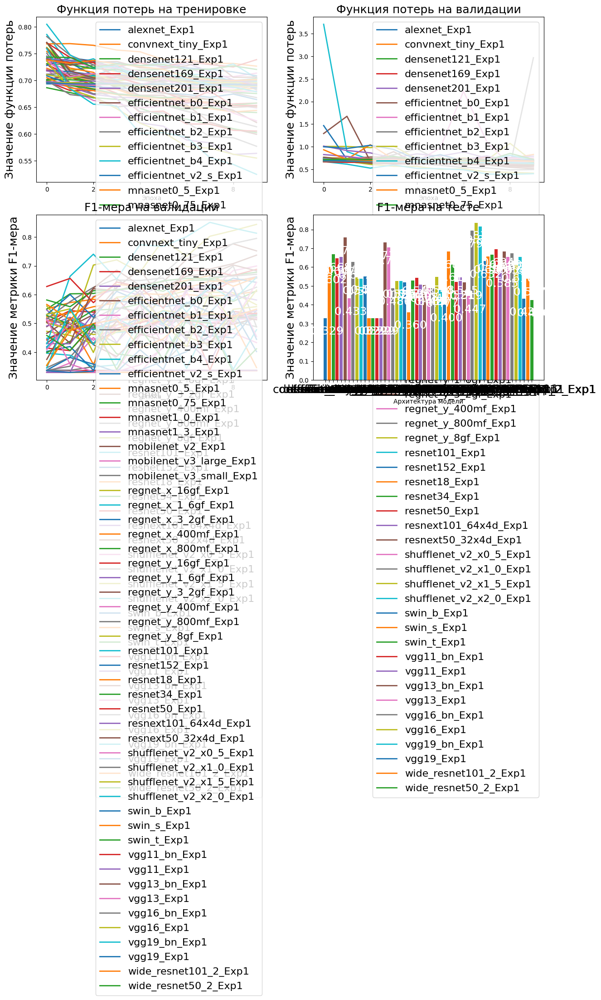

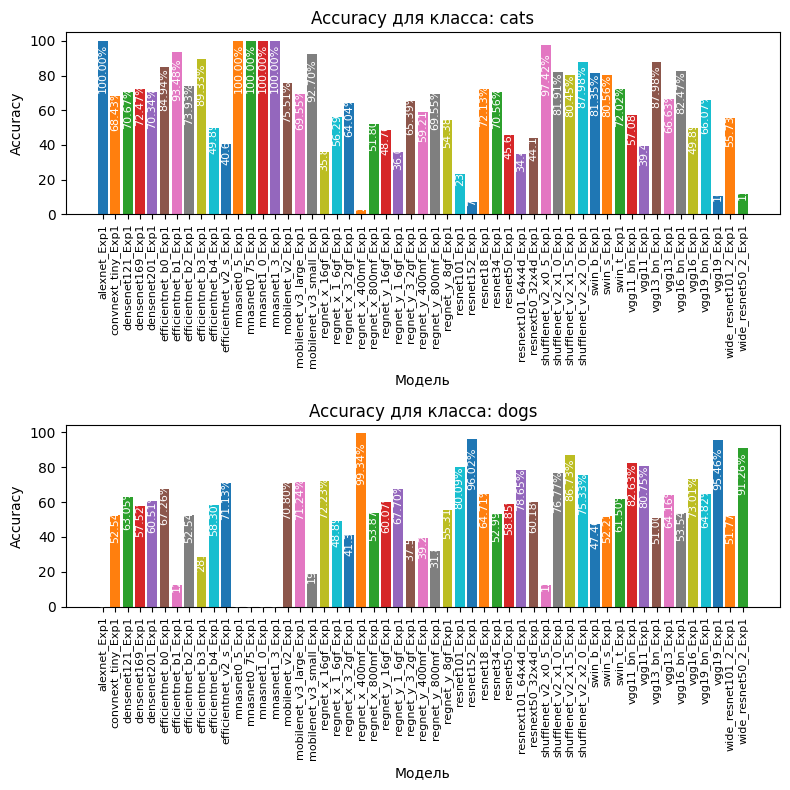

In [28]:
graduate_pipeline.graduate()

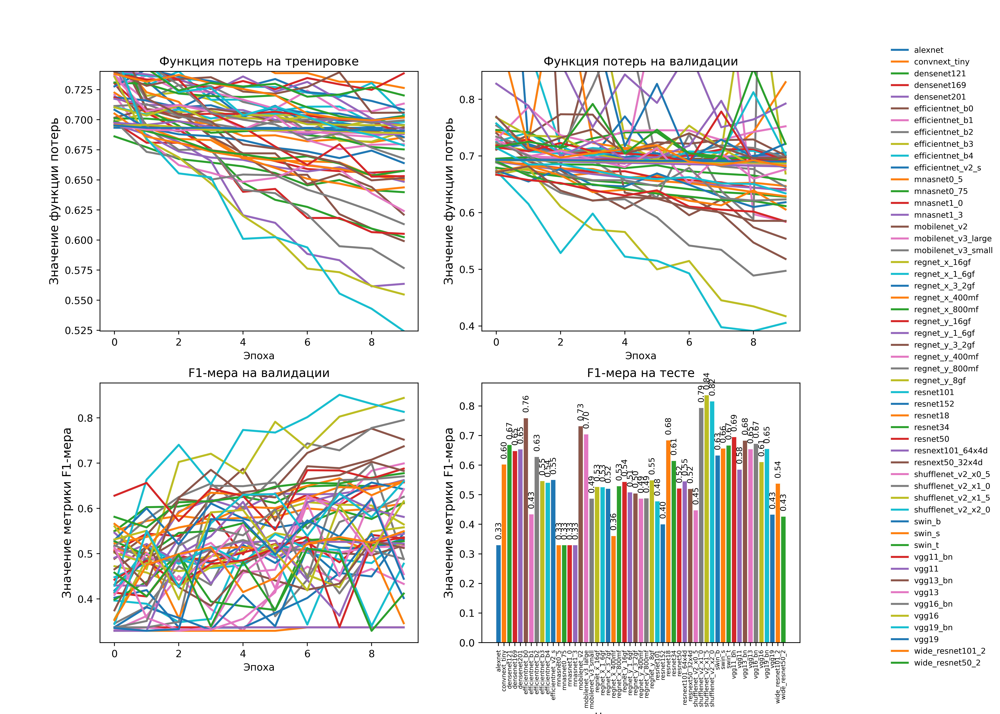

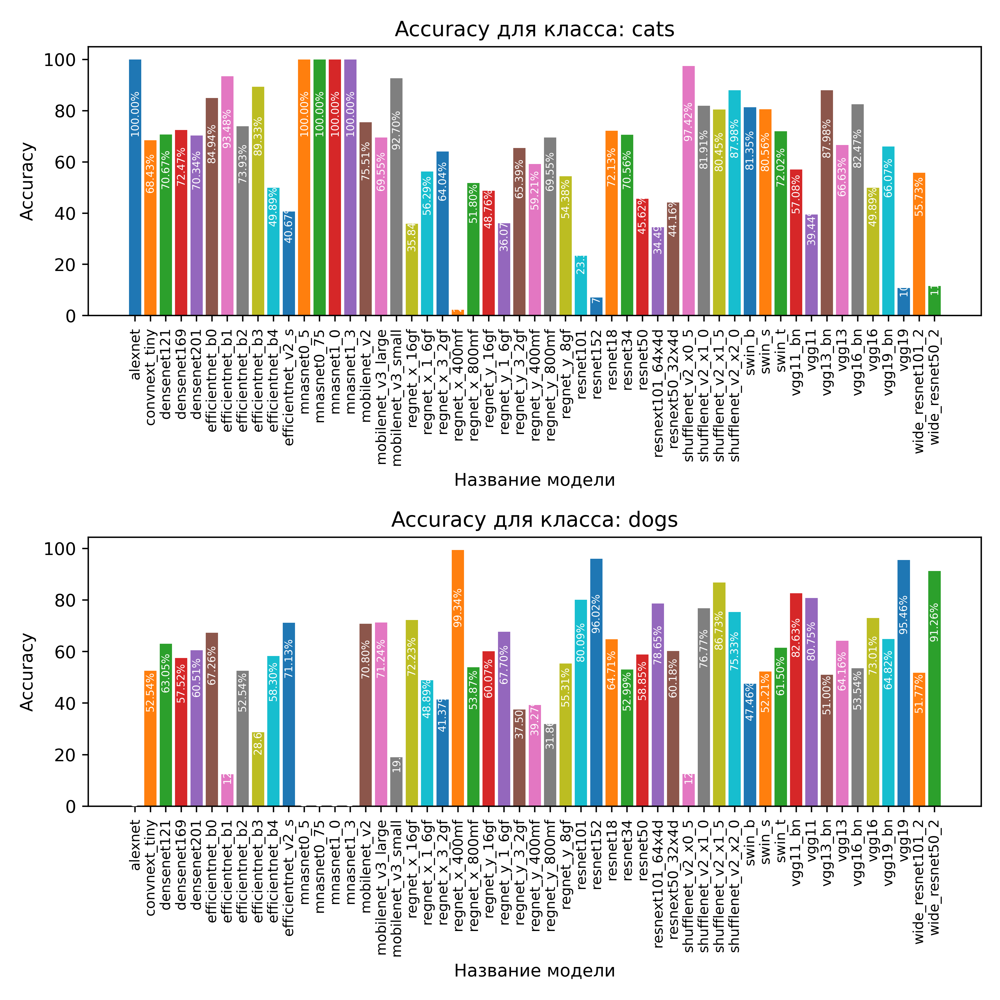

In [77]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_Exp1.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_Exp1.png"))

## Exp2 / Диcбаланс классов + кроссэнтропия + undersampling

In [198]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "Exp2",
        "models": model_list,
        "name_optimizers": optimizer_list,
        "name_loss": "CrossEntropyLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 10,
        "class_percentage": {"cats": 0.3, "dogs": 1.0},
        "resampling_method": "undersampling"
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1884.68image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.12image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: alexnet
        Пользовательское название модели: alexnet_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.10sample/s]



Epoch 1/10, Training Loss: 0.6931814674249629, Validation Loss: 0.693174991567256
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.60sample/s]



Epoch 2/10, Training Loss: 0.6932309001581776, Validation Loss: 0.6931709773459677
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.13sample/s]



Epoch 3/10, Training Loss: 0.6931721986978734, Validation Loss: 0.6931651495607559
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 26.07sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6931435929745743, Validation Loss: 0.6931603951642742
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.60sample/s]



Epoch 5/10, Training Loss: 0.6930850146152719, Validation Loss: 0.6931600863650694
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.47sample/s]



Epoch 6/10, Training Loss: 0.6931332054826402, Validation Loss: 0.6931593982176593
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 26.72sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6931772539296102, Validation Loss: 0.6931590190378286
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.29sample/s]



Epoch 8/10, Training Loss: 0.6931389806811342, Validation Loss: 0.6931589705459142
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.98sample/s]



Epoch 9/10, Training Loss: 0.6930486047800464, Validation Loss: 0.6931588898944316
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.97sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6932090878281806, Validation Loss: 0.693158784828617
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.76sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1800.27image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.79image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: convnext_tiny
        Пользовательское название модели: convnext_tiny_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.77sample/s]



Epoch 1/10, Training Loss: 0.7158413800791776, Validation Loss: 0.6807614916798759
Accuracy: 0.5610169491525424, Precision: 0.5622443110994702, Recall: 0.5610169491525424, F1-score: 0.5596448860591721


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.90sample/s]



Epoch 2/10, Training Loss: 0.7044256379719043, Validation Loss: 0.6567615241990925
Accuracy: 0.5909604519774011, Precision: 0.5927881060179118, Recall: 0.5909604519774011, F1-score: 0.5882382559112784


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.68sample/s]



Epoch 3/10, Training Loss: 0.6988545148233368, Validation Loss: 0.6667888031504249
Accuracy: 0.5734463276836158, Precision: 0.5734373677105425, Recall: 0.5734463276836158, F1-score: 0.5734402003594427


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.00sample/s]



Epoch 4/10, Training Loss: 0.7015762177529613, Validation Loss: 0.7177979339987545
Accuracy: 0.5502824858757062, Precision: 0.5505233651086012, Recall: 0.5502824858757062, F1-score: 0.5501216733081579


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.25sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.6945822881054633, Validation Loss: 0.6804404810155179
Accuracy: 0.5858757062146893, Precision: 0.5861572580919274, Recall: 0.5858757062146893, F1-score: 0.5851746512269195


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.46sample/s]



Epoch 6/10, Training Loss: 0.6849995908868272, Validation Loss: 0.6500731640953129
Accuracy: 0.6028248587570622, Precision: 0.6038244241634072, Recall: 0.6028248587570622, F1-score: 0.601426221636477


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.79sample/s]



Epoch 7/10, Training Loss: 0.6829290023374394, Validation Loss: 0.6510033440791955
Accuracy: 0.6022598870056497, Precision: 0.6027534068216616, Recall: 0.6022598870056497, F1-score: 0.6014500278344261


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.42sample/s]



Epoch 8/10, Training Loss: 0.6789975544226539, Validation Loss: 0.64969969284063
Accuracy: 0.6073446327683616, Precision: 0.6076198627008499, Recall: 0.6073446327683616, F1-score: 0.6068509483255277


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.96sample/s]



Epoch 9/10, Training Loss: 0.6767197316864512, Validation Loss: 0.6489175967240738
Accuracy: 0.6112994350282486, Precision: 0.6116342098911741, Recall: 0.6112994350282486, F1-score: 0.6107625619743402


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.76sample/s]



Epoch 10/10, Training Loss: 0.6728057529508453, Validation Loss: 0.6470754713998677
Accuracy: 0.6214689265536724, Precision: 0.621887771371943, Recall: 0.6214689265536724, F1-score: 0.6209136131184069
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.68sample/s]


Test Accuracy: 0.5964325529542921
Precision: 0.5977304408981428, Recall: 0.5964325529542921, F1-score: 0.5955733268495089
Accuracy of  cats : 64 %
Accuracy of  dogs : 54 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1827.25image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1766.86image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet121
        Пользовательское название модели: densenet121_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.24sample/s]



Epoch 1/10, Training Loss: 0.692605584859848, Validation Loss: 0.6922144824165409
Accuracy: 0.5316384180790961, Precision: 0.548890447346674, Recall: 0.5316384180790961, F1-score: 0.47962912970596244


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.02sample/s]



Epoch 2/10, Training Loss: 0.6836643526234578, Validation Loss: 0.6868502344452055
Accuracy: 0.5559322033898305, Precision: 0.5799290004732809, Recall: 0.5559322033898305, F1-score: 0.516332406008164


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.03sample/s]



Epoch 3/10, Training Loss: 0.6804119128337021, Validation Loss: 0.6783054503007123
Accuracy: 0.5790960451977402, Precision: 0.6051229832793638, Recall: 0.5790960451977402, F1-score: 0.5489815055494979


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.28sample/s]



Epoch 4/10, Training Loss: 0.675590928067866, Validation Loss: 0.676143494703002
Accuracy: 0.5740112994350283, Precision: 0.6285917839701236, Recall: 0.5740112994350283, F1-score: 0.5206318181572996


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.32sample/s]



Epoch 5/10, Training Loss: 0.670520141874392, Validation Loss: 0.6702922670181188
Accuracy: 0.6254237288135593, Precision: 0.6254887804559962, Recall: 0.6254237288135593, F1-score: 0.6252642583451794


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.44sample/s]



Epoch 6/10, Training Loss: 0.669218210420248, Validation Loss: 0.6627436657409883
Accuracy: 0.6276836158192091, Precision: 0.6388849692157749, Recall: 0.6276836158192091, F1-score: 0.6191420682157716


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.34sample/s]



Epoch 7/10, Training Loss: 0.664764586695281, Validation Loss: 0.6574968899373954
Accuracy: 0.6350282485875707, Precision: 0.6387807568452919, Recall: 0.6350282485875707, F1-score: 0.6329922909518388


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.18sample/s]



Epoch 8/10, Training Loss: 0.6608014130305588, Validation Loss: 0.6542335031396251
Accuracy: 0.6333333333333333, Precision: 0.6373114999424427, Recall: 0.6333333333333333, F1-score: 0.6311287948059834


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.12sample/s]



Epoch 9/10, Training Loss: 0.6583144326799923, Validation Loss: 0.6507946464975002
Accuracy: 0.6412429378531074, Precision: 0.6414852472650303, Recall: 0.6412429378531074, F1-score: 0.6409489076675031


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.22sample/s]



Epoch 10/10, Training Loss: 0.6540196797077599, Validation Loss: 0.6444001490786925
Accuracy: 0.6548022598870057, Precision: 0.65520657641057, Recall: 0.6548022598870057, F1-score: 0.6546862083622521
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.06sample/s]


Test Accuracy: 0.6655518394648829
Precision: 0.6657388524697335, Recall: 0.6655518394648829, F1-score: 0.6653463280711421
Accuracy of  cats : 64 %
Accuracy of  dogs : 68 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1781.30image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1734.38image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet169
        Пользовательское название модели: densenet169_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.36sample/s]



Epoch 1/10, Training Loss: 0.7024583691583876, Validation Loss: 0.7007991427418876
Accuracy: 0.5067796610169492, Precision: 0.5165206646406548, Recall: 0.5067796610169492, F1-score: 0.38861458192899584


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.18sample/s]



Epoch 2/10, Training Loss: 0.6866063569829226, Validation Loss: 0.6860766693697138
Accuracy: 0.5389830508474577, Precision: 0.5503930976115283, Recall: 0.5389830508474577, F1-score: 0.5064611007288953


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.14sample/s]



Epoch 3/10, Training Loss: 0.6827613051814312, Validation Loss: 0.6807093581574112
Accuracy: 0.5610169491525424, Precision: 0.5645837446451853, Recall: 0.5610169491525424, F1-score: 0.553137774608213


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.88sample/s]



Epoch 4/10, Training Loss: 0.6744223360957968, Validation Loss: 0.6733713411005203
Accuracy: 0.5807909604519774, Precision: 0.60693547566184, Recall: 0.5807909604519774, F1-score: 0.5512183048294612


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.07sample/s]



Epoch 5/10, Training Loss: 0.6755572517508084, Validation Loss: 0.6680725498051293
Accuracy: 0.5994350282485875, Precision: 0.6105439396785988, Recall: 0.5994350282485875, F1-score: 0.5878210991506957


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.88sample/s]



Epoch 6/10, Training Loss: 0.6676027775834926, Validation Loss: 0.6609179177189951
Accuracy: 0.6169491525423729, Precision: 0.6251891433794677, Recall: 0.6169491525423729, F1-score: 0.6096498007166884


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.42sample/s]



Epoch 7/10, Training Loss: 0.6605208959571275, Validation Loss: 0.6620398482023659
Accuracy: 0.6033898305084746, Precision: 0.6168497149875922, Recall: 0.6033898305084746, F1-score: 0.5903205653525253


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.59sample/s]



Epoch 8/10, Training Loss: 0.6580546911024966, Validation Loss: 0.6548001478284092
Accuracy: 0.6338983050847458, Precision: 0.6354801453961991, Recall: 0.6338983050847458, F1-score: 0.6324824595534724


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.62sample/s]



Epoch 9/10, Training Loss: 0.661219255211427, Validation Loss: 0.6485027317273415
Accuracy: 0.6508474576271186, Precision: 0.6523730642661807, Recall: 0.6508474576271186, F1-score: 0.6502067493172656


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.63sample/s]



Epoch 10/10, Training Loss: 0.6557479495649895, Validation Loss: 0.6476738697054696
Accuracy: 0.635593220338983, Precision: 0.6444975151151351, Recall: 0.635593220338983, F1-score: 0.6291655280317825
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:06<00:00, 11.30sample/s]


Test Accuracy: 0.6443701226309922
Precision: 0.6579691265428675, Recall: 0.6443701226309922, F1-score: 0.6373976939494619
Accuracy of  cats : 78 %
Accuracy of  dogs : 50 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1886.64image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1806.80image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet201
        Пользовательское название модели: densenet201_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.15sample/s]



Epoch 1/10, Training Loss: 0.6837973640751593, Validation Loss: 0.69367088655294
Accuracy: 0.5435028248587571, Precision: 0.5591396508809187, Recall: 0.5435028248587571, F1-score: 0.5152078160890846


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.31sample/s]



Epoch 2/10, Training Loss: 0.6855568926768614, Validation Loss: 0.675605859628505
Accuracy: 0.6028248587570622, Precision: 0.6131048871424559, Recall: 0.6028248587570622, F1-score: 0.5946865085904066


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.20sample/s]



Epoch 3/10, Training Loss: 0.6797584680347508, Validation Loss: 0.6706373044999979
Accuracy: 0.592090395480226, Precision: 0.633439646045957, Recall: 0.592090395480226, F1-score: 0.5557150090812906


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.08sample/s]



Epoch 4/10, Training Loss: 0.6692181281822244, Validation Loss: 0.6628867620128697
Accuracy: 0.6129943502824858, Precision: 0.639498627497378, Recall: 0.6129943502824858, F1-score: 0.5922465066591308


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.15sample/s]



Epoch 5/10, Training Loss: 0.6636424267414919, Validation Loss: 0.6529917149557232
Accuracy: 0.6406779661016949, Precision: 0.6413976795796607, Recall: 0.6406779661016949, F1-score: 0.640395187541633


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.12sample/s]



Epoch 6/10, Training Loss: 0.6601723334223953, Validation Loss: 0.6537566306227345
Accuracy: 0.6192090395480226, Precision: 0.6489550673132485, Recall: 0.6192090395480226, F1-score: 0.5978096836916396


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.10sample/s]



Epoch 7/10, Training Loss: 0.6613547665761509, Validation Loss: 0.6469698819400227
Accuracy: 0.6485875706214689, Precision: 0.6501645634229192, Recall: 0.6485875706214689, F1-score: 0.647908051645679


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.22sample/s]



Epoch 8/10, Training Loss: 0.6542108093750026, Validation Loss: 0.6415815733920383
Accuracy: 0.6468926553672316, Precision: 0.6615929787107666, Recall: 0.6468926553672316, F1-score: 0.6378898890342662


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.28sample/s]



Epoch 9/10, Training Loss: 0.6518344211414507, Validation Loss: 0.6328944321406089
Accuracy: 0.6627118644067796, Precision: 0.6627039553679127, Recall: 0.6627118644067796, F1-score: 0.6626975439714925


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.93sample/s]



Epoch 10/10, Training Loss: 0.646435863476029, Validation Loss: 0.6333757255036953
Accuracy: 0.6638418079096046, Precision: 0.6687606557165533, Recall: 0.6638418079096046, F1-score: 0.6609686406070856
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:07<00:00,  9.85sample/s]


Test Accuracy: 0.6555183946488294
Precision: 0.6657384449138043, Recall: 0.6555183946488294, F1-score: 0.6507883247714231
Accuracy of  cats : 77 %
Accuracy of  dogs : 53 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1805.60image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.74image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b0
        Пользовательское название модели: efficientnet_b0_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.15sample/s]



Epoch 1/10, Training Loss: 0.749138676628624, Validation Loss: 1.0664866049747683
Accuracy: 0.5045197740112994, Precision: 0.5282681760072581, Recall: 0.5045197740112994, F1-score: 0.3932839862168604


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.66sample/s]



Epoch 2/10, Training Loss: 0.7098214172620544, Validation Loss: 0.9153549043135455
Accuracy: 0.5, Precision: 0.47222844094206146, Recall: 0.5, F1-score: 0.357171881683621


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.23sample/s]



Epoch 3/10, Training Loss: 0.6947556214848745, Validation Loss: 0.708807325464184
Accuracy: 0.6192090395480226, Precision: 0.6396553886626918, Recall: 0.6192090395480226, F1-score: 0.6035112162819302


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.51sample/s]



Epoch 4/10, Training Loss: 0.6953255969941411, Validation Loss: 0.7896004819263847
Accuracy: 0.5384180790960452, Precision: 0.5873589003105626, Recall: 0.5384180790960452, F1-score: 0.45797740766518646


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.86sample/s]



Epoch 5/10, Training Loss: 0.6711475331963542, Validation Loss: 0.6317703136279758
Accuracy: 0.635593220338983, Precision: 0.6669509631182982, Recall: 0.635593220338983, F1-score: 0.6164675286468346


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.57sample/s]



Epoch 6/10, Training Loss: 0.6638246983084891, Validation Loss: 0.6117536687413178
Accuracy: 0.6858757062146893, Precision: 0.6929341114604445, Recall: 0.6858757062146893, F1-score: 0.682594453424754


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.11sample/s]



Epoch 7/10, Training Loss: 0.6527267315031327, Validation Loss: 0.5961678141759614
Accuracy: 0.7135593220338983, Precision: 0.7171035823911841, Recall: 0.7135593220338983, F1-score: 0.712172001803923


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.18sample/s]



Epoch 8/10, Training Loss: 0.6363657386237404, Validation Loss: 0.6257739584829848
Accuracy: 0.63954802259887, Precision: 0.7135703723448674, Recall: 0.63954802259887, F1-score: 0.6039710469617852


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.37sample/s]



Epoch 9/10, Training Loss: 0.6298258232906512, Validation Loss: 0.6044600235540315
Accuracy: 0.6954802259887005, Precision: 0.6961099035249187, Recall: 0.6954802259887005, F1-score: 0.6951215277974362


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.83sample/s]



Epoch 10/10, Training Loss: 0.6154163595020157, Validation Loss: 0.5407121828888769
Accuracy: 0.7418079096045198, Precision: 0.7446784006953499, Recall: 0.7418079096045198, F1-score: 0.740898695999815
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.04sample/s]


Test Accuracy: 0.7324414715719063
Precision: 0.7355970392959362, Recall: 0.7324414715719063, F1-score: 0.7317248802667585
Accuracy of  cats : 78 %
Accuracy of  dogs : 67 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1779.51image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1845.33image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b1
        Пользовательское название модели: efficientnet_b1_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.11sample/s]



Epoch 1/10, Training Loss: 0.7463788028640026, Validation Loss: 0.729595124216403
Accuracy: 0.503954802259887, Precision: 0.53732810158779, Recall: 0.503954802259887, F1-score: 0.341341765935156


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.32sample/s]



Epoch 2/10, Training Loss: 0.7001921878647559, Validation Loss: 0.6868365927267883
Accuracy: 0.5870056497175141, Precision: 0.6290907018331302, Recall: 0.5870056497175141, F1-score: 0.5480770539786264


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.30sample/s]



Epoch 3/10, Training Loss: 0.6923723389807436, Validation Loss: 0.6671227819502017
Accuracy: 0.5672316384180791, Precision: 0.6653311503027265, Recall: 0.5672316384180791, F1-score: 0.48890759474883366


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.52sample/s]



Epoch 4/10, Training Loss: 0.6874698134222391, Validation Loss: 0.6660603109726124
Accuracy: 0.6084745762711864, Precision: 0.6403870056497175, Recall: 0.6084745762711864, F1-score: 0.5832663594070051


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.33sample/s]



Epoch 5/10, Training Loss: 0.685835478027252, Validation Loss: 0.6483485058876081
Accuracy: 0.6485875706214689, Precision: 0.663595038316399, Recall: 0.6485875706214689, F1-score: 0.6395619577233772


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 6/10, Training Loss: 0.6797763992011342, Validation Loss: 1.1039432130627713
Accuracy: 0.6192090395480226, Precision: 0.6197367058622874, Recall: 0.6192090395480226, F1-score: 0.6189779959616337


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.43sample/s]



Epoch 7/10, Training Loss: 0.6907715296622404, Validation Loss: 0.6565896270975555
Accuracy: 0.6288135593220339, Precision: 0.6544811879816631, Recall: 0.6288135593220339, F1-score: 0.6115419091929483


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.90sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.6749170172665128, Validation Loss: 0.7003844647252627
Accuracy: 0.6259887005649718, Precision: 0.6665396481378033, Recall: 0.6259887005649718, F1-score: 0.6003455033098863


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.76sample/s]



Epoch 9/10, Training Loss: 0.6486331397520307, Validation Loss: 0.6429249465802295
Accuracy: 0.6740112994350282, Precision: 0.6813283556829671, Recall: 0.6740112994350282, F1-score: 0.6702525347742063


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.69sample/s]



Epoch 10/10, Training Loss: 0.6414099973194378, Validation Loss: 0.6210367494383774
Accuracy: 0.6898305084745763, Precision: 0.6920960600142521, Recall: 0.6898305084745763, F1-score: 0.688695952134865
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.80sample/s]


Test Accuracy: 0.6950947603121517
Precision: 0.6989034413742365, Recall: 0.6950947603121517, F1-score: 0.693906951524971
Accuracy of  cats : 75 %
Accuracy of  dogs : 63 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1854.06image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.93image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b2
        Пользовательское название модели: efficientnet_b2_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.71sample/s]



Epoch 1/10, Training Loss: 0.7654934352411028, Validation Loss: 0.7636379877389488
Accuracy: 0.5033898305084745, Precision: 0.5017083365288748, Recall: 0.5033898305084745, F1-score: 0.3381089121383465


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.57sample/s]



Epoch 2/10, Training Loss: 0.7376464948416576, Validation Loss: 0.6797716408799597
Accuracy: 0.5666666666666667, Precision: 0.6344283780589992, Recall: 0.5666666666666667, F1-score: 0.5010757505366963


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.68sample/s]



Epoch 3/10, Training Loss: 0.7124950366536367, Validation Loss: 0.876119735382371
Accuracy: 0.615819209039548, Precision: 0.6450365124905714, Recall: 0.615819209039548, F1-score: 0.5940048970514914


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.69sample/s]



Epoch 4/10, Training Loss: 0.6884466109611734, Validation Loss: 0.6766829199373385
Accuracy: 0.6254237288135593, Precision: 0.6275924250471667, Recall: 0.6254237288135593, F1-score: 0.6242048683288696


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.41sample/s]



Epoch 5/10, Training Loss: 0.6761509233323979, Validation Loss: 0.6273410900332833
Accuracy: 0.656497175141243, Precision: 0.6775699239443584, Recall: 0.656497175141243, F1-score: 0.6451779255474863


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.91sample/s]



Epoch 6/10, Training Loss: 0.6726289609658349, Validation Loss: 0.6529625534674542
Accuracy: 0.6644067796610169, Precision: 0.6667898503513464, Recall: 0.6644067796610169, F1-score: 0.6634617963261105


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.58sample/s]



Epoch 7/10, Training Loss: 0.6702549897928008, Validation Loss: 0.6457486974317476
Accuracy: 0.652542372881356, Precision: 0.6698460854264185, Recall: 0.652542372881356, F1-score: 0.6442146439781442


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.87sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.6704238657279522, Validation Loss: 0.6575164507001133
Accuracy: 0.6468926553672316, Precision: 0.6792798793511108, Recall: 0.6468926553672316, F1-score: 0.6291412060286666


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.94sample/s]



Epoch 9/10, Training Loss: 0.6466438635108397, Validation Loss: 0.6077124757618554
Accuracy: 0.6892655367231638, Precision: 0.6925257154883075, Recall: 0.6892655367231638, F1-score: 0.6876856709503879


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.30sample/s]



Epoch 10/10, Training Loss: 0.6344436240155262, Validation Loss: 0.5946963703901754
Accuracy: 0.7056497175141243, Precision: 0.7103927660838475, Recall: 0.7056497175141243, F1-score: 0.7037181348324233
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.52sample/s]


Test Accuracy: 0.7090301003344481
Precision: 0.7136954262640807, Recall: 0.7090301003344481, F1-score: 0.7077055293626253
Accuracy of  cats : 77 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1882.85image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1879.62image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b3
        Пользовательское название модели: efficientnet_b3_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.88sample/s]



Epoch 1/10, Training Loss: 0.7432301546290159, Validation Loss: 0.8333296460957177
Accuracy: 0.5028248587570622, Precision: 0.4850239026510213, Recall: 0.5028248587570622, F1-score: 0.3437506045530486


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.49sample/s]



Epoch 2/10, Training Loss: 0.7146007876420758, Validation Loss: 0.6953407004054657
Accuracy: 0.5649717514124294, Precision: 0.6270531528543283, Recall: 0.5649717514124294, F1-score: 0.5012321180103375


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.50sample/s]



Epoch 3/10, Training Loss: 0.718561224306572, Validation Loss: 0.734674283508527
Accuracy: 0.5497175141242938, Precision: 0.6018369890824378, Recall: 0.5497175141242938, F1-score: 0.48760609093400087


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 4/10, Training Loss: 0.7049319540307284, Validation Loss: 0.707861856047043
Accuracy: 0.5875706214689266, Precision: 0.6562359390400603, Recall: 0.5875706214689266, F1-score: 0.5342949448555728


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.62sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.7112829640149251, Validation Loss: 0.7105270305932578
Accuracy: 0.49491525423728816, Precision: 0.4950598511280519, Recall: 0.49491525423728816, F1-score: 0.4947346431375542


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.45sample/s]



Epoch 6/10, Training Loss: 0.7035585590654222, Validation Loss: 0.6876335298947696
Accuracy: 0.5485875706214689, Precision: 0.562277503212245, Recall: 0.5485875706214689, F1-score: 0.5257184801993483


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.56sample/s]



Epoch 7/10, Training Loss: 0.6994280426977426, Validation Loss: 0.6868569972151417
Accuracy: 0.5485875706214689, Precision: 0.5752276038223837, Recall: 0.5485875706214689, F1-score: 0.5086745209776353


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 8/10, Training Loss: 0.6935002343965969, Validation Loss: 0.6840530236562093
Accuracy: 0.5519774011299435, Precision: 0.5718856579011805, Recall: 0.5519774011299435, F1-score: 0.5220963950179407


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.58sample/s]



Epoch 9/10, Training Loss: 0.6886044501029339, Validation Loss: 0.6814884760622251
Accuracy: 0.5514124293785311, Precision: 0.5643821539610119, Recall: 0.5514124293785311, F1-score: 0.5307180805609676


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.50sample/s]



Epoch 10/10, Training Loss: 0.6899579857632876, Validation Loss: 0.6781816551577573
Accuracy: 0.5734463276836158, Precision: 0.5872907977004234, Recall: 0.5734463276836158, F1-score: 0.5578200198844703
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.23sample/s]


Test Accuracy: 0.5668896321070234
Precision: 0.5771975384578361, Recall: 0.5668896321070234, F1-score: 0.5493208445279179
Accuracy of  cats : 36 %
Accuracy of  dogs : 76 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1840.38image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1846.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b4
        Пользовательское название модели: efficientnet_b4_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.61sample/s]



Epoch 1/10, Training Loss: 0.7762936950241986, Validation Loss: 0.7024360393400246
Accuracy: 0.5028248587570622, Precision: 0.4824753880733353, Recall: 0.5028248587570622, F1-score: 0.3427810130363789


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.59sample/s]



Epoch 2/10, Training Loss: 0.7319332827202643, Validation Loss: 0.71291868986383
Accuracy: 0.5033898305084745, Precision: 0.5017083365288748, Recall: 0.5033898305084745, F1-score: 0.3381089121383465


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.52sample/s]



Epoch 3/10, Training Loss: 0.7594195352387183, Validation Loss: 1.563033408195959
Accuracy: 0.5129943502824859, Precision: 0.5507339855307269, Recall: 0.5129943502824859, F1-score: 0.38984125084732163


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.44sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7287507367502782, Validation Loss: 1.6695345297539974
Accuracy: 0.5152542372881356, Precision: 0.5763247096482286, Recall: 0.5152542372881356, F1-score: 0.38553596772059623


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.41sample/s]



Epoch 5/10, Training Loss: 0.6841389538905874, Validation Loss: 0.7280887976541357
Accuracy: 0.5966101694915255, Precision: 0.5987854360609387, Recall: 0.5966101694915255, F1-score: 0.5936950777795509


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.61sample/s]



Epoch 6/10, Training Loss: 0.6781663051790389, Validation Loss: 0.6889511990008381
Accuracy: 0.6152542372881356, Precision: 0.6188133158642651, Recall: 0.6152542372881356, F1-score: 0.6117165519180907


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.53sample/s]



Epoch 7/10, Training Loss: 0.6794775854476129, Validation Loss: 0.685285269035458
Accuracy: 0.6310734463276836, Precision: 0.6428035951812847, Recall: 0.6310734463276836, F1-score: 0.62247830737011


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.64sample/s]



Epoch 8/10, Training Loss: 0.6652305556326797, Validation Loss: 0.6721764459448346
Accuracy: 0.6367231638418079, Precision: 0.6395727962467483, Recall: 0.6367231638418079, F1-score: 0.6352412876391054


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.53sample/s]



Epoch 9/10, Training Loss: 0.6600066088524061, Validation Loss: 0.7178541087666473
Accuracy: 0.6440677966101694, Precision: 0.6605954431199429, Recall: 0.6440677966101694, F1-score: 0.6338193883626387


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.35sample/s]



Epoch 10/10, Training Loss: 0.6713954540052774, Validation Loss: 0.6713048148963411
Accuracy: 0.6711864406779661, Precision: 0.6727980451015185, Recall: 0.6711864406779661, F1-score: 0.670614641462452
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.10sample/s]


Test Accuracy: 0.6822742474916388
Precision: 0.6834474316298578, Recall: 0.6822742474916388, F1-score: 0.681563960922161
Accuracy of  cats : 63 %
Accuracy of  dogs : 72 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1881.36image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1863.72image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_v2_s
        Пользовательское название модели: efficientnet_v2_s_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.40sample/s]



Epoch 1/10, Training Loss: 0.7479674347077858, Validation Loss: 0.6993999417218785
Accuracy: 0.4966101694915254, Precision: 0.4982157718461383, Recall: 0.4966101694915254, F1-score: 0.3738168078672774


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.36sample/s]



Epoch 2/10, Training Loss: 0.7344732399248995, Validation Loss: 0.9756477293321641
Accuracy: 0.5220338983050847, Precision: 0.5434376369892495, Recall: 0.5220338983050847, F1-score: 0.44516740461689697


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.35sample/s]



Epoch 3/10, Training Loss: 0.7208067191015813, Validation Loss: 0.7722052441815198
Accuracy: 0.5163841807909605, Precision: 0.531384721373633, Recall: 0.5163841807909605, F1-score: 0.4618681840226658


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.37sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7073947141055799, Validation Loss: 0.7253563006718954
Accuracy: 0.5186440677966102, Precision: 0.5584517610449355, Recall: 0.5186440677966102, F1-score: 0.42847861685993566


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.35sample/s]



Epoch 5/10, Training Loss: 0.698939267609947, Validation Loss: 0.6997664585962133
Accuracy: 0.5288135593220339, Precision: 0.5663569866693307, Recall: 0.5288135593220339, F1-score: 0.45764040262539774


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.37sample/s]



Epoch 6/10, Training Loss: 0.7014646871188253, Validation Loss: 0.7048116506493024
Accuracy: 0.4994350282485876, Precision: 0.49470449592098803, Recall: 0.4994350282485876, F1-score: 0.43379143946948373


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.45sample/s]



Epoch 7/10, Training Loss: 0.6951975006213302, Validation Loss: 0.6962522541062307
Accuracy: 0.5389830508474577, Precision: 0.5685689541077505, Recall: 0.5389830508474577, F1-score: 0.488234275039217


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.43sample/s]



Epoch 8/10, Training Loss: 0.6974929886585248, Validation Loss: 0.6911638084441255
Accuracy: 0.5378531073446328, Precision: 0.56388638508578, Recall: 0.5378531073446328, F1-score: 0.49053656603678714


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.36sample/s]



Epoch 9/10, Training Loss: 0.7009995779425827, Validation Loss: 0.790858037559326
Accuracy: 0.5259887005649717, Precision: 0.5588868867082961, Recall: 0.5259887005649717, F1-score: 0.45616843810244645


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.38sample/s]



Epoch 10/10, Training Loss: 0.6927484234993401, Validation Loss: 0.6911541590582853
Accuracy: 0.5451977401129944, Precision: 0.5744517373478999, Recall: 0.5451977401129944, F1-score: 0.49995073167543186
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.65sample/s]


Test Accuracy: 0.5512820512820513
Precision: 0.573258717439517, Recall: 0.5512820512820513, F1-score: 0.5103756499901205
Accuracy of  cats : 26 %
Accuracy of  dogs : 83 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1750.58image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1890.23image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_5
        Пользовательское название модели: mnasnet0_5_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.09sample/s]



Epoch 1/10, Training Loss: 0.7360328554697463, Validation Loss: 0.6931283633924473
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.65sample/s]



Epoch 2/10, Training Loss: 0.70058133645156, Validation Loss: 0.6931272911823402
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.27sample/s]



Epoch 3/10, Training Loss: 0.7034945778830355, Validation Loss: 0.6932482380988234
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.07sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6839493295990724, Validation Loss: 0.6934812688558115
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.23sample/s]



Epoch 5/10, Training Loss: 0.6578062625275445, Validation Loss: 0.6935605339411288
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.20sample/s]



Epoch 6/10, Training Loss: 0.6516136817915743, Validation Loss: 0.6940888708594155
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.98sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6511596742364549, Validation Loss: 0.6942008536750988
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.30sample/s]



Epoch 8/10, Training Loss: 0.6395336311707382, Validation Loss: 0.6942943233554646
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.71sample/s]



Epoch 9/10, Training Loss: 0.6412743871769135, Validation Loss: 0.694412255522895
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.13sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6404752129131985, Validation Loss: 0.6947164587718618
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 22.08sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1879.58image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1846.13image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_75
        Пользовательское название модели: mnasnet0_75_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.50sample/s]



Epoch 1/10, Training Loss: 0.741831852500791, Validation Loss: 0.6932276330761991
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.03sample/s]



Epoch 2/10, Training Loss: 0.707395330122656, Validation Loss: 0.6932363193587395
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.90sample/s]



Epoch 3/10, Training Loss: 0.7102815359318789, Validation Loss: 0.6931463873992532
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.83sample/s]



Epoch 4/10, Training Loss: 0.682721359008776, Validation Loss: 0.6937459252648435
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.67sample/s]



Epoch 5/10, Training Loss: 0.6749208766160552, Validation Loss: 0.6933071727806566
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.78sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.685646894563924, Validation Loss: 0.6939103285134849
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.76sample/s]



Epoch 7/10, Training Loss: 0.6404635385446942, Validation Loss: 0.693784591505083
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.84sample/s]



Epoch 8/10, Training Loss: 0.6358194388065141, Validation Loss: 0.6938369806203465
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.77sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-05.

Epoch 9/10, Training Loss: 0.6230291797942722, Validation Loss: 0.6940717193703193
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.59sample/s]



Epoch 10/10, Training Loss: 0.6210896464455169, Validation Loss: 0.6942062381297182
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.47sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1890.85image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_0
        Пользовательское название модели: mnasnet1_0_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.04sample/s]



Epoch 1/10, Training Loss: 0.7366407425542877, Validation Loss: 0.6931415112678614
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.01sample/s]



Epoch 2/10, Training Loss: 0.726024547086139, Validation Loss: 0.693135691227886
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.79sample/s]



Epoch 3/10, Training Loss: 0.6981689213067805, Validation Loss: 0.69314988134271
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.32sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6755948097435469, Validation Loss: 0.693126154989846
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.20sample/s]



Epoch 5/10, Training Loss: 0.6508962635424539, Validation Loss: 0.6931478364319451
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.12sample/s]



Epoch 6/10, Training Loss: 0.6420721962689534, Validation Loss: 0.6931301698846332
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.40sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6372375625515312, Validation Loss: 0.6932251673970519
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.31sample/s]



Epoch 8/10, Training Loss: 0.6179029407984612, Validation Loss: 0.6931614118107294
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.15sample/s]



Epoch 9/10, Training Loss: 0.6230770162597964, Validation Loss: 0.693154837283711
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.31sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6088246873154264, Validation Loss: 0.6931323420866734
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.82sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1870.59image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1857.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_3
        Пользовательское название модели: mnasnet1_3_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.02sample/s]



Epoch 1/10, Training Loss: 0.7506316893084353, Validation Loss: 0.6931502313937171
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.55sample/s]



Epoch 2/10, Training Loss: 0.6932572006564779, Validation Loss: 0.6931291074402588
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.97sample/s]



Epoch 3/10, Training Loss: 0.6863441612712297, Validation Loss: 0.6938791312066849
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.93sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6626256482093195, Validation Loss: 0.6965127373482548
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.69sample/s]



Epoch 5/10, Training Loss: 0.6345065617581823, Validation Loss: 0.6952318867384377
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.22sample/s]



Epoch 6/10, Training Loss: 0.6206753893508944, Validation Loss: 0.6972145798516138
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6136506855795064, Validation Loss: 0.6952988629960745
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.13sample/s]



Epoch 8/10, Training Loss: 0.5791401780655294, Validation Loss: 0.6951461385535656
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 9/10, Training Loss: 0.593792302297153, Validation Loss: 0.6950678237750705
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.45sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.5869673106985813, Validation Loss: 0.6950130462646484
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.97sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1896.62image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.88image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v2
        Пользовательское название модели: mobilenet_v2_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.76sample/s]



Epoch 1/10, Training Loss: 0.7320565034433738, Validation Loss: 0.7304666081054062
Accuracy: 0.5050847457627119, Precision: 0.5594499632314475, Recall: 0.5050847457627119, F1-score: 0.3457683720680318


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.25sample/s]



Epoch 2/10, Training Loss: 0.7092050028215978, Validation Loss: 0.6700667844990552
Accuracy: 0.5983050847457627, Precision: 0.6005635482220714, Recall: 0.5983050847457627, F1-score: 0.5953630492583575


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.16sample/s]



Epoch 3/10, Training Loss: 0.7075694610982416, Validation Loss: 0.6561177974030122
Accuracy: 0.6124293785310735, Precision: 0.6145186826014426, Recall: 0.6124293785310735, F1-score: 0.6101309010269368


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 4/10, Training Loss: 0.6786547644236653, Validation Loss: 0.673161563900231
Accuracy: 0.5858757062146893, Precision: 0.6478947307736653, Recall: 0.5858757062146893, F1-score: 0.5349675977536887


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.23sample/s]



Epoch 5/10, Training Loss: 0.6766962575953441, Validation Loss: 0.615597955924643
Accuracy: 0.6570621468926554, Precision: 0.658571113754869, Recall: 0.6570621468926554, F1-score: 0.6559894620043772


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.47sample/s]



Epoch 6/10, Training Loss: 0.6737404671526447, Validation Loss: 0.6399109175818115
Accuracy: 0.6220338983050847, Precision: 0.6837292378733965, Recall: 0.6220338983050847, F1-score: 0.5858022315043465


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]



Epoch 7/10, Training Loss: 0.6416863148769563, Validation Loss: 0.629316720585365
Accuracy: 0.668361581920904, Precision: 0.6688278208851706, Recall: 0.668361581920904, F1-score: 0.668235684522708


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.654591704357121, Validation Loss: 0.6243270579199333
Accuracy: 0.6389830508474577, Precision: 0.6987648092511762, Recall: 0.6389830508474577, F1-score: 0.6082931545825532


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.40sample/s]



Epoch 9/10, Training Loss: 0.6228910915527966, Validation Loss: 0.5710814615427438
Accuracy: 0.7135593220338983, Precision: 0.7147122206822241, Recall: 0.7135593220338983, F1-score: 0.7132858285153121


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.64sample/s]



Epoch 10/10, Training Loss: 0.5996365385878947, Validation Loss: 0.5547128663224689
Accuracy: 0.7129943502824859, Precision: 0.7130173321842382, Recall: 0.7129943502824859, F1-score: 0.7129976482882052
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.03sample/s]


Test Accuracy: 0.717948717948718
Precision: 0.7181061773821955, Recall: 0.717948717948718, F1-score: 0.7179382014952485
Accuracy of  cats : 72 %
Accuracy of  dogs : 70 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1797.69image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1794.99image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_large
        Пользовательское название модели: mobilenet_v3_large_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.61sample/s]



Epoch 1/10, Training Loss: 0.7190499406090307, Validation Loss: 0.6943383188234211
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 2/10, Training Loss: 0.6932911173379708, Validation Loss: 0.6931287038460964
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.17sample/s]



Epoch 3/10, Training Loss: 0.6683997972724364, Validation Loss: 0.694543089401924
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.23sample/s]



Epoch 4/10, Training Loss: 0.6613989525132163, Validation Loss: 0.6849443134614976
Accuracy: 0.5333333333333333, Precision: 0.6351608751608752, Recall: 0.5333333333333333, F1-score: 0.42045402496278483


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.93sample/s]



Epoch 5/10, Training Loss: 0.6517814166357427, Validation Loss: 0.6487193904017324
Accuracy: 0.6779661016949152, Precision: 0.6837376509031001, Recall: 0.6779661016949152, F1-score: 0.675040355125101


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 6/10, Training Loss: 0.6401211997282874, Validation Loss: 0.6325412417872477
Accuracy: 0.6457627118644068, Precision: 0.6483889472791758, Recall: 0.6457627118644068, F1-score: 0.6438147162408051


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.38sample/s]



Epoch 7/10, Training Loss: 0.6422479624805582, Validation Loss: 0.6435029292005604
Accuracy: 0.6293785310734463, Precision: 0.6515351443118753, Recall: 0.6293785310734463, F1-score: 0.6163856834051549


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.75sample/s]



Epoch 8/10, Training Loss: 0.6398953695579902, Validation Loss: 0.7307008257356741
Accuracy: 0.6361581920903955, Precision: 0.6388625247615881, Recall: 0.6361581920903955, F1-score: 0.6347522761795419


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.6284788994957081, Validation Loss: 0.6674206380621862
Accuracy: 0.6259887005649718, Precision: 0.6575065439901941, Recall: 0.6259887005649718, F1-score: 0.6075484160438481


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 10/10, Training Loss: 0.6041308361844918, Validation Loss: 0.5654026834809848
Accuracy: 0.7067796610169491, Precision: 0.7070670293360645, Recall: 0.7067796610169491, F1-score: 0.7067335149659015
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.32sample/s]


Test Accuracy: 0.7146042363433668
Precision: 0.7147440351837924, Recall: 0.7146042363433668, F1-score: 0.7144998970081594
Accuracy of  cats : 69 %
Accuracy of  dogs : 73 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1850.94image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1880.42image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_small
        Пользовательское название модели: mobilenet_v3_small_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 1/10, Training Loss: 0.704105965460289, Validation Loss: 0.693124308929605
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.00sample/s]



Epoch 2/10, Training Loss: 0.6744349358212907, Validation Loss: 0.6939512055135716
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.87sample/s]



Epoch 3/10, Training Loss: 0.6626920186469645, Validation Loss: 0.6925999682165135
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.90sample/s]



Epoch 4/10, Training Loss: 0.6463404376174986, Validation Loss: 0.6841479608904844
Accuracy: 0.6141242937853107, Precision: 0.6952387650327027, Recall: 0.6141242937853107, F1-score: 0.5711385699532228


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.83sample/s]



Epoch 5/10, Training Loss: 0.642765417592632, Validation Loss: 0.6256456802793815
Accuracy: 0.672316384180791, Precision: 0.6730105598570438, Recall: 0.672316384180791, F1-score: 0.6718356650875762


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.01sample/s]



Epoch 6/10, Training Loss: 0.6318174627740768, Validation Loss: 0.6262328924432312
Accuracy: 0.6644067796610169, Precision: 0.6651064133267497, Recall: 0.6644067796610169, F1-score: 0.6638847903111451


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.06sample/s]



Epoch 7/10, Training Loss: 0.6435620805754285, Validation Loss: 0.5584930235383201
Accuracy: 0.7225988700564971, Precision: 0.7237400651178504, Recall: 0.7225988700564971, F1-score: 0.7221292684207605


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.80sample/s]



Epoch 8/10, Training Loss: 0.6180529479206223, Validation Loss: 0.5614878083184615
Accuracy: 0.7141242937853107, Precision: 0.7172285278248965, Recall: 0.7141242937853107, F1-score: 0.7132844515608321


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 9/10, Training Loss: 0.5993333897230142, Validation Loss: 0.5347648379998019
Accuracy: 0.7435028248587571, Precision: 0.7498356025093831, Recall: 0.7435028248587571, F1-score: 0.7420719815667721


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.79sample/s]



Epoch 10/10, Training Loss: 0.608772621685287, Validation Loss: 0.5770439675635537
Accuracy: 0.7299435028248588, Precision: 0.732161451019785, Recall: 0.7299435028248588, F1-score: 0.7291495486791792
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 21.05sample/s]


Test Accuracy: 0.7251950947603122
Precision: 0.7307314216180725, Recall: 0.7251950947603122, F1-score: 0.723793963249997
Accuracy of  cats : 79 %
Accuracy of  dogs : 65 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1890.74image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1884.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_16gf
        Пользовательское название модели: regnet_x_16gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.94sample/s]



Epoch 1/10, Training Loss: 0.7023256961832341, Validation Loss: 0.7073335332722314
Accuracy: 0.5135593220338983, Precision: 0.5145818292641208, Recall: 0.5135593220338983, F1-score: 0.510095184726317


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.85sample/s]



Epoch 2/10, Training Loss: 0.7056206407415908, Validation Loss: 0.6992385709016337
Accuracy: 0.5163841807909605, Precision: 0.522478823385406, Recall: 0.5163841807909605, F1-score: 0.4678540916159767


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.66sample/s]



Epoch 3/10, Training Loss: 0.7060567594270936, Validation Loss: 0.7156341597016922
Accuracy: 0.4966101694915254, Precision: 0.4839803171131766, Recall: 0.4966101694915254, F1-score: 0.40330580090713775


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.97sample/s]



Epoch 4/10, Training Loss: 0.6988448973783513, Validation Loss: 0.6978790418239637
Accuracy: 0.5220338983050847, Precision: 0.5233536435847111, Recall: 0.5220338983050847, F1-score: 0.5184904548261691


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.78sample/s]



Epoch 5/10, Training Loss: 0.7055629526626613, Validation Loss: 0.7094566980324223
Accuracy: 0.507909604519774, Precision: 0.5094838797447161, Recall: 0.507909604519774, F1-score: 0.45456009989043517


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.67sample/s]



Epoch 6/10, Training Loss: 0.6998572040259633, Validation Loss: 0.7222503762123949
Accuracy: 0.49887005649717514, Precision: 0.5150753601550866, Recall: 0.49887005649717514, F1-score: 0.36120059577648445


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.55sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6959600988327432, Validation Loss: 0.7052689366421457
Accuracy: 0.5135593220338983, Precision: 0.5320016491534059, Recall: 0.5135593220338983, F1-score: 0.44446244485169967


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.66sample/s]



Epoch 8/10, Training Loss: 0.6965336968603822, Validation Loss: 0.690109451443462
Accuracy: 0.5327683615819209, Precision: 0.5328955737643583, Recall: 0.5327683615819209, F1-score: 0.5327079567159327


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.61sample/s]



Epoch 9/10, Training Loss: 0.6909017374425409, Validation Loss: 0.6927538734708129
Accuracy: 0.5316384180790961, Precision: 0.5330104110369479, Recall: 0.5316384180790961, F1-score: 0.5288224513007093


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.51sample/s]



Epoch 10/10, Training Loss: 0.6945722864051045, Validation Loss: 0.6900677529432006
Accuracy: 0.5220338983050847, Precision: 0.5236375661396485, Recall: 0.5220338983050847, F1-score: 0.5174859505180178
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.01sample/s]


Test Accuracy: 0.5178372352285395
Precision: 0.5177156893941157, Recall: 0.5178372352285395, F1-score: 0.513877752921807
Accuracy of  cats : 42 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.77image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1825.15image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_1_6gf
        Пользовательское название модели: regnet_x_1_6gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]



Epoch 1/10, Training Loss: 0.7127156090695423, Validation Loss: 0.7182709281727419
Accuracy: 0.4971751412429379, Precision: 0.4930499895045118, Recall: 0.4971751412429379, F1-score: 0.45310453199381917


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.99sample/s]



Epoch 2/10, Training Loss: 0.7047429297797868, Validation Loss: 0.7142270795032803
Accuracy: 0.511864406779661, Precision: 0.5151911383345015, Recall: 0.511864406779661, F1-score: 0.46448065025535096


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.91sample/s]



Epoch 3/10, Training Loss: 0.7045325694215256, Validation Loss: 0.7000945510163818
Accuracy: 0.535593220338983, Precision: 0.5375471093235968, Recall: 0.535593220338983, F1-score: 0.5262899010894356


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.04sample/s]



Epoch 4/10, Training Loss: 0.7069449498481357, Validation Loss: 0.7053260887410008
Accuracy: 0.4966101694915254, Precision: 0.4961701015206309, Recall: 0.4966101694915254, F1-score: 0.4947688403500268


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.36sample/s]



Epoch 5/10, Training Loss: 0.7085331852493417, Validation Loss: 0.7148744898327326
Accuracy: 0.5192090395480226, Precision: 0.531763531408887, Recall: 0.5192090395480226, F1-score: 0.47596209223290464


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.18sample/s]



Epoch 6/10, Training Loss: 0.7057408729369697, Validation Loss: 0.6992738881690354
Accuracy: 0.5305084745762711, Precision: 0.5375686419592623, Recall: 0.5305084745762711, F1-score: 0.5122202157601092


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.24sample/s]



Epoch 7/10, Training Loss: 0.7044680329532558, Validation Loss: 0.6951388858132443
Accuracy: 0.5265536723163842, Precision: 0.5267163415732933, Recall: 0.5265536723163842, F1-score: 0.5264406164984127


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.71sample/s]



Epoch 8/10, Training Loss: 0.7051480981902158, Validation Loss: 0.7099774335063783
Accuracy: 0.5163841807909605, Precision: 0.5301257787224839, Recall: 0.5163841807909605, F1-score: 0.4652368053914517


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.84sample/s]



Epoch 9/10, Training Loss: 0.7027015650190439, Validation Loss: 0.7000994754713133
Accuracy: 0.5265536723163842, Precision: 0.5391899443934899, Recall: 0.5265536723163842, F1-score: 0.47705792317789425


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.26sample/s]



Epoch 10/10, Training Loss: 0.700655660268777, Validation Loss: 0.6910429773694378
Accuracy: 0.5282485875706214, Precision: 0.5293091041116862, Recall: 0.5282485875706214, F1-score: 0.5260400468160457
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.69sample/s]


Test Accuracy: 0.5178372352285395
Precision: 0.5176504397059662, Recall: 0.5178372352285395, F1-score: 0.5153761072708699
Accuracy of  cats : 44 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1850.24image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.67image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_3_2gf
        Пользовательское название модели: regnet_x_3_2gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.81sample/s]



Epoch 1/10, Training Loss: 0.7118202348550161, Validation Loss: 0.7270920146993325
Accuracy: 0.4830508474576271, Precision: 0.4812839028378252, Recall: 0.4830508474576271, F1-score: 0.47588261365923074


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.97sample/s]



Epoch 2/10, Training Loss: 0.7113351904854333, Validation Loss: 0.7124414614028176
Accuracy: 0.5, Precision: 0.5043935762224353, Recall: 0.5, F1-score: 0.4340346180868094


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.75sample/s]



Epoch 3/10, Training Loss: 0.7115627718750144, Validation Loss: 0.7431181228093509
Accuracy: 0.5242937853107345, Precision: 0.5304421764873571, Recall: 0.5242937853107345, F1-score: 0.49105155605347556


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.55sample/s]



Epoch 4/10, Training Loss: 0.7051988367977011, Validation Loss: 0.7151026538873123
Accuracy: 0.5169491525423728, Precision: 0.5407437185275362, Recall: 0.5169491525423728, F1-score: 0.44476497084694844


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.74sample/s]



Epoch 5/10, Training Loss: 0.7073403896949545, Validation Loss: 0.6962487344014443
Accuracy: 0.5440677966101695, Precision: 0.5462939182831801, Recall: 0.5440677966101695, F1-score: 0.5402716307673017


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.92sample/s]



Epoch 6/10, Training Loss: 0.7064626798596988, Validation Loss: 0.695101467650489
Accuracy: 0.5271186440677966, Precision: 0.5392123080208023, Recall: 0.5271186440677966, F1-score: 0.4798612699468191


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.03sample/s]



Epoch 7/10, Training Loss: 0.7118707336101335, Validation Loss: 0.6925012644401378
Accuracy: 0.519774011299435, Precision: 0.5196810232651962, Recall: 0.519774011299435, F1-score: 0.5175610138692918


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.56sample/s]



Epoch 8/10, Training Loss: 0.699365998871138, Validation Loss: 0.6945168271576617
Accuracy: 0.511864406779661, Precision: 0.5119996969486353, Recall: 0.511864406779661, F1-score: 0.5117646759641268


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.04sample/s]



Epoch 9/10, Training Loss: 0.703993490471463, Validation Loss: 0.6968789282491652
Accuracy: 0.5276836158192091, Precision: 0.5482967570699032, Recall: 0.5276836158192091, F1-score: 0.47813303411484476


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.14sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.6985836410030877, Validation Loss: 0.7046348343124498
Accuracy: 0.5322033898305085, Precision: 0.5653276685811974, Recall: 0.5322033898305085, F1-score: 0.47025564009043946
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.55sample/s]


Test Accuracy: 0.5278706800445931
Precision: 0.5462083223592924, Recall: 0.5278706800445931, F1-score: 0.46688578501240463
Accuracy of  cats : 18 %
Accuracy of  dogs : 86 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1882.28image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1865.49image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_400mf
        Пользовательское название модели: regnet_x_400mf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.70sample/s]



Epoch 1/10, Training Loss: 0.7885890664513578, Validation Loss: 0.7953020702984374
Accuracy: 0.5, Precision: 0.5043539807824297, Recall: 0.5, F1-score: 0.43452653006978953


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.85sample/s]



Epoch 2/10, Training Loss: 0.7756611257279452, Validation Loss: 0.7525678002564921
Accuracy: 0.480225988700565, Precision: 0.4801745502856943, Recall: 0.480225988700565, F1-score: 0.48017819833301223


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.62sample/s]



Epoch 3/10, Training Loss: 0.7552186042787283, Validation Loss: 0.7398586864188567
Accuracy: 0.4943502824858757, Precision: 0.4932949828672432, Recall: 0.4943502824858757, F1-score: 0.4880089125051192


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.80sample/s]



Epoch 4/10, Training Loss: 0.7464792869754673, Validation Loss: 0.7273511630667131
Accuracy: 0.5327683615819209, Precision: 0.5333159606713145, Recall: 0.5327683615819209, F1-score: 0.5319778461853996


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.11sample/s]



Epoch 5/10, Training Loss: 0.7345299292675818, Validation Loss: 0.7882489936668321
Accuracy: 0.507909604519774, Precision: 0.5203868143246224, Recall: 0.507909604519774, F1-score: 0.43902579174725


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.23sample/s]



Epoch 6/10, Training Loss: 0.7440628179979488, Validation Loss: 0.7916535243476178
Accuracy: 0.5022598870056497, Precision: 0.5065614876721032, Recall: 0.5022598870056497, F1-score: 0.45515233284863


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.60sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.7425132142923951, Validation Loss: 0.7682294630061435
Accuracy: 0.5180790960451978, Precision: 0.5295652690647393, Recall: 0.5180790960451978, F1-score: 0.47619872391655055


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.83sample/s]



Epoch 8/10, Training Loss: 0.7118472288973963, Validation Loss: 0.7044635078327804
Accuracy: 0.5338983050847458, Precision: 0.5342435959967358, Recall: 0.5338983050847458, F1-score: 0.5335164467073089


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.79sample/s]



Epoch 9/10, Training Loss: 0.7111799188495911, Validation Loss: 0.70281388640067
Accuracy: 0.5209039548022599, Precision: 0.5210277209473299, Recall: 0.5209039548022599, F1-score: 0.5208354391878943


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.56sample/s]



Epoch 10/10, Training Loss: 0.7118063420569364, Validation Loss: 0.6998632723665507
Accuracy: 0.5316384180790961, Precision: 0.5338128935192545, Recall: 0.5316384180790961, F1-score: 0.5266978074728921
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.13sample/s]


Test Accuracy: 0.5317725752508361
Precision: 0.5322004226407953, Recall: 0.5317725752508361, F1-score: 0.5273813394168704
Accuracy of  cats : 43 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1844.88image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1830.73image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_800mf
        Пользовательское название модели: regnet_x_800mf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.80sample/s]



Epoch 1/10, Training Loss: 0.7337097575779223, Validation Loss: 0.732370704580835
Accuracy: 0.49887005649717514, Precision: 0.4979504174045029, Recall: 0.49887005649717514, F1-score: 0.49136478796617367


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.32sample/s]



Epoch 2/10, Training Loss: 0.7175005394773385, Validation Loss: 0.7126249899971957
Accuracy: 0.5175141242937853, Precision: 0.5182552236304541, Recall: 0.5175141242937853, F1-score: 0.5156497575424359


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.29sample/s]



Epoch 3/10, Training Loss: 0.7197993323975003, Validation Loss: 0.711775040559176
Accuracy: 0.523728813559322, Precision: 0.52396026207093, Recall: 0.523728813559322, F1-score: 0.519244150786811


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.50sample/s]



Epoch 4/10, Training Loss: 0.7188544674837303, Validation Loss: 0.7056227243889523
Accuracy: 0.5135593220338983, Precision: 0.5133921142565142, Recall: 0.5135593220338983, F1-score: 0.5095040974472053


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.90sample/s]



Epoch 5/10, Training Loss: 0.7094313299533018, Validation Loss: 0.7133467227725659
Accuracy: 0.5305084745762711, Precision: 0.5319145891884806, Recall: 0.5305084745762711, F1-score: 0.5275171321980026


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.04sample/s]



Epoch 6/10, Training Loss: 0.7149866476296559, Validation Loss: 0.7399281596733351
Accuracy: 0.511864406779661, Precision: 0.5304052479104925, Recall: 0.511864406779661, F1-score: 0.4381310645903402


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.90sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.720662558406489, Validation Loss: 0.7141305511280641
Accuracy: 0.5254237288135594, Precision: 0.5259678987189932, Recall: 0.5254237288135594, F1-score: 0.5192867972389819


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.92sample/s]



Epoch 8/10, Training Loss: 0.7035664775732047, Validation Loss: 0.7126088671091586
Accuracy: 0.5141242937853108, Precision: 0.5155375985894326, Recall: 0.5141242937853108, F1-score: 0.4903566969497054


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.12sample/s]



Epoch 9/10, Training Loss: 0.6999357018069303, Validation Loss: 0.711326749648078
Accuracy: 0.4966101694915254, Precision: 0.4953875216455895, Recall: 0.4966101694915254, F1-score: 0.48725866366243176


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.07sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-05.

Epoch 10/10, Training Loss: 0.7064648129276394, Validation Loss: 0.712728749560771
Accuracy: 0.48983050847457626, Precision: 0.489335599815613, Recall: 0.48983050847457626, F1-score: 0.4881691423722873
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.06sample/s]


Test Accuracy: 0.5100334448160535
Precision: 0.5106398535775095, Recall: 0.5100334448160535, F1-score: 0.5085144477017168
Accuracy of  cats : 56 %
Accuracy of  dogs : 45 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1884.03image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1704.59image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_16gf
        Пользовательское название модели: regnet_y_16gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.97sample/s]



Epoch 1/10, Training Loss: 0.7064210875951957, Validation Loss: 0.7838898065399988
Accuracy: 0.49830508474576274, Precision: 0.5011240484940072, Recall: 0.49830508474576274, F1-score: 0.433832785128583


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.99sample/s]



Epoch 2/10, Training Loss: 0.7215914947470439, Validation Loss: 0.7448525795828824
Accuracy: 0.5169491525423728, Precision: 0.5493638423773965, Recall: 0.5169491525423728, F1-score: 0.41121843268905667


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.93sample/s]



Epoch 3/10, Training Loss: 0.7055773475940285, Validation Loss: 0.6947453151651695
Accuracy: 0.5033898305084745, Precision: 0.5027210261108566, Recall: 0.5033898305084745, F1-score: 0.49523178741682783


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.92sample/s]



Epoch 4/10, Training Loss: 0.7040569608154166, Validation Loss: 0.7057688017349458
Accuracy: 0.5220338983050847, Precision: 0.5240112647997343, Recall: 0.5220338983050847, F1-score: 0.5052345064271369


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.05sample/s]



Epoch 5/10, Training Loss: 0.7039866865295725, Validation Loss: 0.7454522716797004
Accuracy: 0.5327683615819209, Precision: 0.5327081053614143, Recall: 0.5327683615819209, F1-score: 0.5326482592504445


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.04sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.6970135352455873, Validation Loss: 0.7122189178641907
Accuracy: 0.5169491525423728, Precision: 0.5311581552604246, Recall: 0.5169491525423728, F1-score: 0.44170746786039183


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.01sample/s]



Epoch 7/10, Training Loss: 0.6917361481902525, Validation Loss: 0.7350844107778732
Accuracy: 0.519774011299435, Precision: 0.5197907619235801, Recall: 0.519774011299435, F1-score: 0.5160177243061459


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.65sample/s]



Epoch 8/10, Training Loss: 0.6924045112534487, Validation Loss: 0.7141005048307322
Accuracy: 0.5361581920903955, Precision: 0.5371855809383445, Recall: 0.5361581920903955, F1-score: 0.5304602479873649


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.77sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-05.

Epoch 9/10, Training Loss: 0.693902784299195, Validation Loss: 0.7140397719070737
Accuracy: 0.535593220338983, Precision: 0.540908194521427, Recall: 0.535593220338983, F1-score: 0.5155293578593902


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.84sample/s]



Epoch 10/10, Training Loss: 0.6866074947966743, Validation Loss: 0.7082672370018932
Accuracy: 0.5186440677966102, Precision: 0.519743864802865, Recall: 0.5186440677966102, F1-score: 0.5043956494016483
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.24sample/s]


Test Accuracy: 0.5156075808249722
Precision: 0.5196558738557373, Recall: 0.5156075808249722, F1-score: 0.49930652010560195
Accuracy of  cats : 69 %
Accuracy of  dogs : 33 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1796.12image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1757.35image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_1_6gf
        Пользовательское название модели: regnet_y_1_6gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.40sample/s]



Epoch 1/10, Training Loss: 0.7136571560938334, Validation Loss: 0.898057578647204
Accuracy: 0.47627118644067795, Precision: 0.47612741333428593, Recall: 0.47627118644067795, F1-score: 0.4722323094845743


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.63sample/s]



Epoch 2/10, Training Loss: 0.7029807072939332, Validation Loss: 1.0122434638314328
Accuracy: 0.5129943502824859, Precision: 0.5301307067186997, Recall: 0.5129943502824859, F1-score: 0.41611666529295105


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.54sample/s]



Epoch 3/10, Training Loss: 0.7100194298319801, Validation Loss: 0.7469198126240638
Accuracy: 0.5101694915254237, Precision: 0.5099491754371518, Recall: 0.5101694915254237, F1-score: 0.5024111988803311


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.74sample/s]



Epoch 4/10, Training Loss: 0.7128583063784334, Validation Loss: 0.8987342674853438
Accuracy: 0.5084745762711864, Precision: 0.5083695661363036, Recall: 0.5084745762711864, F1-score: 0.4909781984104773


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.84sample/s]



Epoch 5/10, Training Loss: 0.7060642767812788, Validation Loss: 0.7423597841949786
Accuracy: 0.4903954802259887, Precision: 0.48943971584780915, Recall: 0.4903954802259887, F1-score: 0.4859856936921195


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.57sample/s]



Epoch 6/10, Training Loss: 0.7027096547621632, Validation Loss: 0.8644887035512655
Accuracy: 0.5214689265536723, Precision: 0.5258814375550067, Recall: 0.5214689265536723, F1-score: 0.5064501723285981


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.79sample/s]



Epoch 7/10, Training Loss: 0.706716956551542, Validation Loss: 0.7943155029735997
Accuracy: 0.5101694915254237, Precision: 0.5318046403827515, Recall: 0.5101694915254237, F1-score: 0.4247416191042049


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.55sample/s]



Epoch 8/10, Training Loss: 0.6976088000736695, Validation Loss: 0.7382342817082916
Accuracy: 0.5384180790960452, Precision: 0.5688216320864992, Recall: 0.5384180790960452, F1-score: 0.4861804960449409


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.68sample/s]



Epoch 9/10, Training Loss: 0.7048814196357203, Validation Loss: 0.7478646662949169
Accuracy: 0.5180790960451978, Precision: 0.5315773724025663, Recall: 0.5180790960451978, F1-score: 0.4705283524704779


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.79sample/s]



Epoch 10/10, Training Loss: 0.6992566362279388, Validation Loss: 0.7954387115893391
Accuracy: 0.5225988700564972, Precision: 0.5438441957641115, Recall: 0.5225988700564972, F1-score: 0.46509744125875935
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.78sample/s]


Test Accuracy: 0.5206243032329989
Precision: 0.5331995596210476, Recall: 0.5206243032329989, F1-score: 0.45800750128881457
Accuracy of  cats : 17 %
Accuracy of  dogs : 85 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.87image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1840.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_3_2gf
        Пользовательское название модели: regnet_y_3_2gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.63sample/s]



Epoch 1/10, Training Loss: 0.7035984135780138, Validation Loss: 1.2482287882074798
Accuracy: 0.5033898305084745, Precision: 0.5035871009299892, Recall: 0.5033898305084745, F1-score: 0.50310231803062


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.39sample/s]



Epoch 2/10, Training Loss: 0.7056530541980389, Validation Loss: 1.049153928450272
Accuracy: 0.48926553672316386, Precision: 0.4890205959235194, Recall: 0.48926553672316386, F1-score: 0.4713607588388111


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.76sample/s]



Epoch 3/10, Training Loss: 0.7030336597735939, Validation Loss: 0.7537960064949962
Accuracy: 0.48926553672316386, Precision: 0.4893644041270963, Recall: 0.48926553672316386, F1-score: 0.48919249649275526


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.30sample/s]



Epoch 4/10, Training Loss: 0.7014831595404452, Validation Loss: 0.8225851521990394
Accuracy: 0.5124293785310734, Precision: 0.5132065164589608, Recall: 0.5124293785310734, F1-score: 0.5099922594204076


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.24sample/s]



Epoch 5/10, Training Loss: 0.6999834935689709, Validation Loss: 0.7614511512430374
Accuracy: 0.5033898305084745, Precision: 0.5023091276628829, Recall: 0.5033898305084745, F1-score: 0.47326289563269813


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.36sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.6939442171059114, Validation Loss: 0.7957376822576685
Accuracy: 0.5056497175141242, Precision: 0.5069678499486863, Recall: 0.5056497175141242, F1-score: 0.42642885365647876


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.35sample/s]



Epoch 7/10, Training Loss: 0.6979428468291292, Validation Loss: 0.7316689162941302
Accuracy: 0.5056497175141242, Precision: 0.5059127850373627, Recall: 0.5056497175141242, F1-score: 0.44854128054853737


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.14sample/s]



Epoch 8/10, Training Loss: 0.6977160074252033, Validation Loss: 0.7246021360664044
Accuracy: 0.5011299435028248, Precision: 0.49979774317517184, Recall: 0.5011299435028248, F1-score: 0.48140702464863305


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.46sample/s]



Epoch 9/10, Training Loss: 0.6960551015699852, Validation Loss: 0.7408152017216224
Accuracy: 0.4971751412429379, Precision: 0.49521246315449813, Recall: 0.4971751412429379, F1-score: 0.47812541416169935


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.31sample/s]



Epoch 10/10, Training Loss: 0.6944243707198048, Validation Loss: 0.7384681610737817
Accuracy: 0.5152542372881356, Precision: 0.5170164555843991, Recall: 0.5152542372881356, F1-score: 0.4907524414998138
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.87sample/s]


Test Accuracy: 0.5128205128205128
Precision: 0.5184110845007777, Recall: 0.5128205128205128, F1-score: 0.4867143336727968
Accuracy of  cats : 74 %
Accuracy of  dogs : 28 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1558.54image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1636.97image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_400mf
        Пользовательское название модели: regnet_y_400mf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.89sample/s]



Epoch 1/10, Training Loss: 0.7457938020171988, Validation Loss: 0.8150405092427959
Accuracy: 0.47909604519774013, Precision: 0.47922074121648767, Recall: 0.47909604519774013, F1-score: 0.47743465573656085


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.98sample/s]



Epoch 2/10, Training Loss: 0.7469976271960334, Validation Loss: 0.7699023791625674
Accuracy: 0.488135593220339, Precision: 0.4881131161013437, Recall: 0.488135593220339, F1-score: 0.47704112536599974


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.82sample/s]



Epoch 3/10, Training Loss: 0.7382871385702153, Validation Loss: 0.7389316267549655
Accuracy: 0.4937853107344633, Precision: 0.49428867175140556, Recall: 0.4937853107344633, F1-score: 0.4857075109827426


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.05sample/s]



Epoch 4/10, Training Loss: 0.7180683209314379, Validation Loss: 0.797668449370201
Accuracy: 0.5084745762711864, Precision: 0.5186647124938183, Recall: 0.5084745762711864, F1-score: 0.40400970336456843


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.47sample/s]



Epoch 5/10, Training Loss: 0.7343820401073731, Validation Loss: 0.7446400674722963
Accuracy: 0.507909604519774, Precision: 0.5201057330423421, Recall: 0.507909604519774, F1-score: 0.4400312486869697


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.82sample/s]



Epoch 6/10, Training Loss: 0.717108686560208, Validation Loss: 0.7149467569286541
Accuracy: 0.4943502824858757, Precision: 0.49424880966969925, Recall: 0.4943502824858757, F1-score: 0.4942009223202887


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.78sample/s]



Epoch 7/10, Training Loss: 0.72400508641787, Validation Loss: 0.7081013899401757
Accuracy: 0.5129943502824859, Precision: 0.513130841798589, Recall: 0.5129943502824859, F1-score: 0.5128948503253209


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.38sample/s]



Epoch 8/10, Training Loss: 0.7156621550571468, Validation Loss: 0.7030192952034837
Accuracy: 0.5175141242937853, Precision: 0.52043801560822, Recall: 0.5175141242937853, F1-score: 0.5063826196678292


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.17sample/s]



Epoch 9/10, Training Loss: 0.720270503529978, Validation Loss: 0.74903794146527
Accuracy: 0.5062146892655367, Precision: 0.5161689290105496, Recall: 0.5062146892655367, F1-score: 0.44082539787324165


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.36sample/s]



Epoch 10/10, Training Loss: 0.7194189258252632, Validation Loss: 0.7233394645364944
Accuracy: 0.5254237288135594, Precision: 0.5256275850994377, Recall: 0.5254237288135594, F1-score: 0.5216149000779442
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.52sample/s]


Test Accuracy: 0.5089186176142698
Precision: 0.5098566115453627, Recall: 0.5089186176142698, F1-score: 0.5056540185738485
Accuracy of  cats : 59 %
Accuracy of  dogs : 42 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1846.33image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.40image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_800mf
        Пользовательское название модели: regnet_y_800mf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.55sample/s]



Epoch 1/10, Training Loss: 0.7098497834402261, Validation Loss: 0.7178352599763601
Accuracy: 0.5112994350282486, Precision: 0.5117279432095231, Recall: 0.5112994350282486, F1-score: 0.4924416202911619


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.20sample/s]



Epoch 2/10, Training Loss: 0.7072125232916108, Validation Loss: 0.719849665454552
Accuracy: 0.523728813559322, Precision: 0.525681345483872, Recall: 0.523728813559322, F1-score: 0.5182452757877469


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.02sample/s]



Epoch 3/10, Training Loss: 0.6996633542567184, Validation Loss: 0.7096976329714565
Accuracy: 0.5152542372881356, Precision: 0.5223601550247173, Recall: 0.5152542372881356, F1-score: 0.45859327537436173


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.18sample/s]



Epoch 4/10, Training Loss: 0.7018718320069853, Validation Loss: 0.704713456543152
Accuracy: 0.5214689265536723, Precision: 0.5227938615953144, Recall: 0.5214689265536723, F1-score: 0.5081653556126919


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.71sample/s]



Epoch 5/10, Training Loss: 0.700004681176746, Validation Loss: 0.7226024904830307
Accuracy: 0.5254237288135594, Precision: 0.5317896882978452, Recall: 0.5254237288135594, F1-score: 0.49288553290076204


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.27sample/s]



Epoch 6/10, Training Loss: 0.701131054830715, Validation Loss: 0.748464231437209
Accuracy: 0.5316384180790961, Precision: 0.5328071519227368, Recall: 0.5316384180790961, F1-score: 0.5242201659420929


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.15sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6983529968360036, Validation Loss: 0.714964642699829
Accuracy: 0.5288135593220339, Precision: 0.5303379909304468, Recall: 0.5288135593220339, F1-score: 0.5187417141940789


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.55sample/s]



Epoch 8/10, Training Loss: 0.6927098345101085, Validation Loss: 0.6996500796854159
Accuracy: 0.5344632768361582, Precision: 0.5402037719891402, Recall: 0.5344632768361582, F1-score: 0.5124346564347966


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.55sample/s]



Epoch 9/10, Training Loss: 0.6891621611372302, Validation Loss: 0.7011313022530011
Accuracy: 0.5259887005649717, Precision: 0.5324138929758911, Recall: 0.5259887005649717, F1-score: 0.4939528394283604


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.55sample/s]



Epoch 10/10, Training Loss: 0.7004560116435244, Validation Loss: 0.7028921014171535
Accuracy: 0.5124293785310734, Precision: 0.5139018566027861, Recall: 0.5124293785310734, F1-score: 0.48373389869926825
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.83sample/s]


Test Accuracy: 0.512263099219621
Precision: 0.5189039080129892, Recall: 0.512263099219621, F1-score: 0.4805116044670431
Accuracy of  cats : 76 %
Accuracy of  dogs : 26 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.39image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1853.27image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_8gf
        Пользовательское название модели: regnet_y_8gf_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.63sample/s]



Epoch 1/10, Training Loss: 0.6976487213598493, Validation Loss: 0.7363222639607845
Accuracy: 0.48192090395480225, Precision: 0.46600062098188194, Recall: 0.48192090395480225, F1-score: 0.4230062421967408


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.19sample/s]



Epoch 2/10, Training Loss: 0.699202282014991, Validation Loss: 0.7228579601999057
Accuracy: 0.5209039548022599, Precision: 0.5207768841385224, Recall: 0.5209039548022599, F1-score: 0.520024282224825


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.32sample/s]



Epoch 3/10, Training Loss: 0.7008630642571401, Validation Loss: 0.72617601573804
Accuracy: 0.4943502824858757, Precision: 0.4725355044274979, Recall: 0.4943502824858757, F1-score: 0.3879376891115977


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.14sample/s]



Epoch 4/10, Training Loss: 0.7037571015226882, Validation Loss: 0.7076958855666683
Accuracy: 0.515819209039548, Precision: 0.516422775930791, Recall: 0.515819209039548, F1-score: 0.5143667994645975


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.17sample/s]



Epoch 5/10, Training Loss: 0.6961052069549298, Validation Loss: 0.7355101398155515
Accuracy: 0.507909604519774, Precision: 0.5079287056351349, Recall: 0.507909604519774, F1-score: 0.5079151021204713


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.11sample/s]



Epoch 6/10, Training Loss: 0.6997178761205313, Validation Loss: 0.7348264630904979
Accuracy: 0.5022598870056497, Precision: 0.509660745788233, Recall: 0.5022598870056497, F1-score: 0.42947239144798255


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.76sample/s]



Epoch 7/10, Training Loss: 0.698017696129907, Validation Loss: 0.6973152973894345
Accuracy: 0.5457627118644067, Precision: 0.546083563644096, Recall: 0.5457627118644067, F1-score: 0.5454871049750053


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.49sample/s]



Epoch 8/10, Training Loss: 0.6910477799853099, Validation Loss: 0.8374044836240974
Accuracy: 0.519774011299435, Precision: 0.5237168209749201, Recall: 0.519774011299435, F1-score: 0.5055926354986845


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.74sample/s]



Epoch 9/10, Training Loss: 0.6951577870296859, Validation Loss: 0.7201186165971271
Accuracy: 0.535593220338983, Precision: 0.5369135656455776, Recall: 0.535593220338983, F1-score: 0.5331582995323233


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.96sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.6973420670352031, Validation Loss: 0.8420416620996712
Accuracy: 0.5372881355932203, Precision: 0.5609051568698161, Recall: 0.5372881355932203, F1-score: 0.4927564215149417
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.86sample/s]


Test Accuracy: 0.5217391304347826
Precision: 0.5305871840274542, Recall: 0.5217391304347826, F1-score: 0.47299339815741465
Accuracy of  cats : 21 %
Accuracy of  dogs : 82 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1733.41image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1698.66image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet101
        Пользовательское название модели: resnet101_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.35sample/s]



Epoch 1/10, Training Loss: 0.7414857725712032, Validation Loss: 0.7675083953108491
Accuracy: 0.5220338983050847, Precision: 0.5371902325105744, Recall: 0.5220338983050847, F1-score: 0.4762257879392498


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.58sample/s]



Epoch 2/10, Training Loss: 0.7266845915120902, Validation Loss: 0.7202493996269959
Accuracy: 0.5350282485875706, Precision: 0.53512280018183, Recall: 0.5350282485875706, F1-score: 0.5350001972826542


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.47sample/s]



Epoch 3/10, Training Loss: 0.725536196809454, Validation Loss: 1.0609750429452476
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.31sample/s]



Epoch 4/10, Training Loss: 0.7379009351902401, Validation Loss: 0.7311212991253805
Accuracy: 0.5050847457627119, Precision: 0.5049948656850366, Recall: 0.5050847457627119, F1-score: 0.4463256745944398


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.74sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.7244574821896569, Validation Loss: 0.7364553414327276
Accuracy: 0.5016949152542373, Precision: 0.4941266938318771, Recall: 0.5016949152542373, F1-score: 0.38039200244007304


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.66sample/s]



Epoch 6/10, Training Loss: 0.7116243996980673, Validation Loss: 0.7105925406439829
Accuracy: 0.5067796610169492, Precision: 0.5096597592620913, Recall: 0.5067796610169492, F1-score: 0.48686192462410116


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.46sample/s]



Epoch 7/10, Training Loss: 0.7026774045528006, Validation Loss: 0.6989417197340626
Accuracy: 0.5175141242937853, Precision: 0.5204774279370769, Recall: 0.5175141242937853, F1-score: 0.5062106639937328


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.05sample/s]



Epoch 8/10, Training Loss: 0.7058225022148841, Validation Loss: 0.6947077125479273
Accuracy: 0.5316384180790961, Precision: 0.5360280766048672, Recall: 0.5316384180790961, F1-score: 0.5207494868391567


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.55sample/s]



Epoch 9/10, Training Loss: 0.6965079527745133, Validation Loss: 0.6988504293274744
Accuracy: 0.5141242937853108, Precision: 0.51505689740422, Recall: 0.5141242937853108, F1-score: 0.5111598910989383


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.19sample/s]



Epoch 10/10, Training Loss: 0.6958430604017067, Validation Loss: 0.696174668221824
Accuracy: 0.5209039548022599, Precision: 0.521680781898919, Recall: 0.5209039548022599, F1-score: 0.5191198279967942
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.45sample/s]


Test Accuracy: 0.5312151616499443
Precision: 0.5311841693770527, Recall: 0.5312151616499443, F1-score: 0.5296408555646931
Accuracy of  cats : 47 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1790.79image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1794.27image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet152
        Пользовательское название модели: resnet152_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.65sample/s]



Epoch 1/10, Training Loss: 0.7376031918624013, Validation Loss: 0.7743579498623724
Accuracy: 0.503954802259887, Precision: 0.5089803294932, Recall: 0.503954802259887, F1-score: 0.35464217289784633


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.23sample/s]



Epoch 2/10, Training Loss: 0.7369906571517695, Validation Loss: 0.8444986818200451
Accuracy: 0.5186440677966102, Precision: 0.5200697029147162, Recall: 0.5186440677966102, F1-score: 0.5019398708635997


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.64sample/s]



Epoch 3/10, Training Loss: 0.7349334128738678, Validation Loss: 0.780479732627249
Accuracy: 0.5050847457627119, Precision: 0.5345487094625633, Recall: 0.5050847457627119, F1-score: 0.3505440009851479


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.56sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7393941680590311, Validation Loss: 0.7806654185225061
Accuracy: 0.5175141242937853, Precision: 0.5924207985224934, Recall: 0.5175141242937853, F1-score: 0.40167062557874605


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.00sample/s]



Epoch 5/10, Training Loss: 0.7096556195688412, Validation Loss: 0.7331882508124336
Accuracy: 0.5141242937853108, Precision: 0.5321488360667375, Recall: 0.5141242937853108, F1-score: 0.44734982245382077


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.95sample/s]



Epoch 6/10, Training Loss: 0.702221881892673, Validation Loss: 0.7000017927191352
Accuracy: 0.5384180790960452, Precision: 0.5384923785259945, Recall: 0.5384180790960452, F1-score: 0.5384055556269388


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.95sample/s]



Epoch 7/10, Training Loss: 0.7071476437381863, Validation Loss: 0.696909116823121
Accuracy: 0.5129943502824859, Precision: 0.5130934861366002, Recall: 0.512994350282486, F1-score: 0.512949578960647


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.89sample/s]



Epoch 8/10, Training Loss: 0.7033949058080456, Validation Loss: 0.703416484055546
Accuracy: 0.5180790960451978, Precision: 0.5231930161511772, Recall: 0.5180790960451978, F1-score: 0.4981506272901503


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.81sample/s]



Epoch 9/10, Training Loss: 0.7013166519169954, Validation Loss: 0.6993631725594148
Accuracy: 0.5282485875706214, Precision: 0.5281618469774052, Recall: 0.5282485875706214, F1-score: 0.5275769132778403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.97sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-05.

Epoch 10/10, Training Loss: 0.7073101581576764, Validation Loss: 0.6972638166556924
Accuracy: 0.5254237288135594, Precision: 0.5260387516373682, Recall: 0.5254237288135594, F1-score: 0.5243065430288377
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.39sample/s]


Test Accuracy: 0.5167224080267558
Precision: 0.5165223075227541, Recall: 0.5167224080267558, F1-score: 0.5157176228360866
Accuracy of  cats : 47 %
Accuracy of  dogs : 56 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1769.40image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1784.31image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet18
        Пользовательское название модели: resnet18_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.81sample/s]



Epoch 1/10, Training Loss: 0.7001312871774038, Validation Loss: 0.7048603343424824
Accuracy: 0.5, Precision: 0.49622845779938135, Recall: 0.5, F1-score: 0.440867816032331


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.35sample/s]



Epoch 2/10, Training Loss: 0.6929999112673232, Validation Loss: 0.6914673373524078
Accuracy: 0.5525423728813559, Precision: 0.5723166165608734, Recall: 0.5525423728813559, F1-score: 0.5159883818488867


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.88sample/s]



Epoch 3/10, Training Loss: 0.6860889997269279, Validation Loss: 0.6801537561551326
Accuracy: 0.5711864406779661, Precision: 0.5785356167078995, Recall: 0.5711864406779661, F1-score: 0.5590958245923023


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.41sample/s]



Epoch 4/10, Training Loss: 0.6764239465043307, Validation Loss: 0.6685810567295484
Accuracy: 0.5937853107344633, Precision: 0.6006426363317953, Recall: 0.5937853107344633, F1-score: 0.5855805783968228


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.57sample/s]



Epoch 5/10, Training Loss: 0.6736968158651463, Validation Loss: 0.6788950438721705
Accuracy: 0.5581920903954802, Precision: 0.6361560572462888, Recall: 0.5581920903954802, F1-score: 0.4809312404407709


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.15sample/s]



Epoch 6/10, Training Loss: 0.6651532624390527, Validation Loss: 0.660049526031408
Accuracy: 0.6135593220338983, Precision: 0.6135718011338432, Recall: 0.6135593220338983, F1-score: 0.6134527042285299


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.28sample/s]



Epoch 7/10, Training Loss: 0.6632801000400097, Validation Loss: 0.6579971206558626
Accuracy: 0.6028248587570622, Precision: 0.6733832395874684, Recall: 0.6028248587570622, F1-score: 0.5558531917183375


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.81sample/s]



Epoch 8/10, Training Loss: 0.6659099819119444, Validation Loss: 0.646936023302671
Accuracy: 0.6338983050847458, Precision: 0.6517315371542451, Recall: 0.6338983050847458, F1-score: 0.6218343680177156


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 9/10, Training Loss: 0.64965837415551, Validation Loss: 0.6362409076448214
Accuracy: 0.6497175141242938, Precision: 0.6757994916135985, Recall: 0.6497175141242938, F1-score: 0.6352773799626064


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.31sample/s]



Epoch 10/10, Training Loss: 0.6472875366301062, Validation Loss: 0.6403975636608856
Accuracy: 0.631638418079096, Precision: 0.6725669757225845, Recall: 0.631638418079096, F1-score: 0.6071000410151323
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.78sample/s]


Test Accuracy: 0.6204013377926422
Precision: 0.6607679005699524, Recall: 0.6204013377926422, F1-score: 0.5966267181546181
Accuracy of  cats : 86 %
Accuracy of  dogs : 37 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1739.47image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.75image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet34
        Пользовательское название модели: resnet34_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 1/10, Training Loss: 0.7033062827136508, Validation Loss: 0.7059330313892688
Accuracy: 0.5333333333333333, Precision: 0.5416946397832513, Recall: 0.5333333333333333, F1-score: 0.5031397742870216


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.43sample/s]



Epoch 2/10, Training Loss: 0.7003586038281417, Validation Loss: 0.6944945907525424
Accuracy: 0.5338983050847458, Precision: 0.53581336117784, Recall: 0.5338983050847458, F1-score: 0.5241723807138636


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.25sample/s]



Epoch 3/10, Training Loss: 0.6948073964143536, Validation Loss: 0.6990724446746589
Accuracy: 0.5175141242937853, Precision: 0.5308623996999138, Recall: 0.5175141242937853, F1-score: 0.4463061328261388


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.16sample/s]



Epoch 4/10, Training Loss: 0.7044809813966456, Validation Loss: 0.7062416824243837
Accuracy: 0.5112994350282486, Precision: 0.5228209859668307, Recall: 0.5112994350282486, F1-score: 0.42071775284475216


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.47sample/s]



Epoch 5/10, Training Loss: 0.6862456486192355, Validation Loss: 0.6880646898584851
Accuracy: 0.5350282485875706, Precision: 0.5373571286544896, Recall: 0.5350282485875706, F1-score: 0.5241954777421141


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.38sample/s]



Epoch 6/10, Training Loss: 0.6899015528639567, Validation Loss: 0.6824466370593356
Accuracy: 0.5661016949152542, Precision: 0.5670067408448975, Recall: 0.5661016949152542, F1-score: 0.563752204927138


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.49sample/s]



Epoch 7/10, Training Loss: 0.6841139965450641, Validation Loss: 0.6821676874901615
Accuracy: 0.5548022598870056, Precision: 0.6107136008613462, Recall: 0.5548022598870056, F1-score: 0.48668556020250936


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.33sample/s]



Epoch 8/10, Training Loss: 0.6862867406963074, Validation Loss: 0.6801967445739918
Accuracy: 0.5570621468926553, Precision: 0.5701071600726557, Recall: 0.5570621468926553, F1-score: 0.5324275484469136


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.36sample/s]



Epoch 9/10, Training Loss: 0.6748983322345105, Validation Loss: 0.6704016706701053
Accuracy: 0.584180790960452, Precision: 0.5848623441843781, Recall: 0.584180790960452, F1-score: 0.5837073126100779


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.18sample/s]



Epoch 10/10, Training Loss: 0.6706553052381142, Validation Loss: 0.6723760578591945
Accuracy: 0.572316384180791, Precision: 0.6258885158031795, Recall: 0.572316384180791, F1-score: 0.5185195721591493
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.15sample/s]


Test Accuracy: 0.5696767001114827
Precision: 0.6318957481086698, Recall: 0.5696767001114827, F1-score: 0.5154429897536735
Accuracy of  cats : 90 %
Accuracy of  dogs : 23 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1869.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1744.96image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet50
        Пользовательское название модели: resnet50_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 1/10, Training Loss: 0.7382384162793045, Validation Loss: 0.7867051430341214
Accuracy: 0.5050847457627119, Precision: 0.5385813833186258, Recall: 0.5050847457627119, F1-score: 0.38397607178464604


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.28sample/s]



Epoch 2/10, Training Loss: 0.7416687420348531, Validation Loss: 0.7271059168934149
Accuracy: 0.503954802259887, Precision: 0.5099403002703367, Recall: 0.503954802259887, F1-score: 0.45106875411501607


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 3/10, Training Loss: 0.7267517513016245, Validation Loss: 0.7063692919278549
Accuracy: 0.49830508474576274, Precision: 0.49813123503740275, Recall: 0.49830508474576274, F1-score: 0.4979101104693679


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.74sample/s]



Epoch 4/10, Training Loss: 0.7230568197379816, Validation Loss: 0.7332597845523371
Accuracy: 0.5112994350282486, Precision: 0.5269147464573944, Recall: 0.5112994350282486, F1-score: 0.4098002947333999


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.54sample/s]



Epoch 5/10, Training Loss: 0.7227402139979949, Validation Loss: 0.6922876851706855
Accuracy: 0.5259887005649717, Precision: 0.5260452667232329, Recall: 0.5259887005649717, F1-score: 0.5234616447318211


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.17sample/s]



Epoch 6/10, Training Loss: 0.7225084748259935, Validation Loss: 0.9279878784370961
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.37sample/s]



Epoch 7/10, Training Loss: 0.7293583095278527, Validation Loss: 0.7240362938514537
Accuracy: 0.5028248587570622, Precision: 0.5005855722864478, Recall: 0.5028248587570622, F1-score: 0.4176680805869504


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.01sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7375026521404174, Validation Loss: 0.6937961906699811
Accuracy: 0.5231638418079096, Precision: 0.5230646560560216, Recall: 0.5231638418079096, F1-score: 0.5219328572461994


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.97sample/s]



Epoch 9/10, Training Loss: 0.6965532851792693, Validation Loss: 0.6973016632478789
Accuracy: 0.5271186440677966, Precision: 0.5272412126722483, Recall: 0.5271186440677966, F1-score: 0.524272499199756


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.34sample/s]



Epoch 10/10, Training Loss: 0.7019776593368897, Validation Loss: 0.6984165576891711
Accuracy: 0.5152542372881356, Precision: 0.5192573364324777, Recall: 0.5152542372881356, F1-score: 0.4978260050366443
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.37sample/s]


Test Accuracy: 0.5206243032329989
Precision: 0.522441396620063, Recall: 0.5206243032329989, F1-score: 0.5019707563732339
Accuracy of  cats : 32 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1738.09image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1776.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext101_64x4d
        Пользовательское название модели: resnext101_64x4d_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.14sample/s]



Epoch 1/10, Training Loss: 0.7359484263097298, Validation Loss: 0.7272845301250953
Accuracy: 0.5214689265536723, Precision: 0.522088979376443, Recall: 0.5214689265536723, F1-score: 0.5202066428227774


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.64sample/s]



Epoch 2/10, Training Loss: 0.7374026369802731, Validation Loss: 1.0498202461644082
Accuracy: 0.49830508474576274, Precision: 0.6066016681339177, Recall: 0.49830508474576274, F1-score: 0.33530069529848466


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.07sample/s]



Epoch 3/10, Training Loss: 0.7316729855496449, Validation Loss: 0.8818125145583503
Accuracy: 0.5022598870056497, Precision: 0.48370878425899927, Recall: 0.5022598870056497, F1-score: 0.349191730524904


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.15sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7335274558501554, Validation Loss: 0.7828679759118516
Accuracy: 0.5056497175141242, Precision: 0.5207397749770631, Recall: 0.5056497175141242, F1-score: 0.36530647113295356


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.12sample/s]



Epoch 5/10, Training Loss: 0.7016424033854836, Validation Loss: 0.6868476477046471
Accuracy: 0.5615819209039548, Precision: 0.5674140824626922, Recall: 0.5615819209039548, F1-score: 0.5536590799031477


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.04sample/s]



Epoch 6/10, Training Loss: 0.6963406855502898, Validation Loss: 0.6986765880032447
Accuracy: 0.5310734463276836, Precision: 0.5360219238638527, Recall: 0.5310734463276836, F1-score: 0.5185216587918354


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.98sample/s]



Epoch 7/10, Training Loss: 0.7000529059429759, Validation Loss: 0.6963679990862722
Accuracy: 0.5559322033898305, Precision: 0.5633945257680942, Recall: 0.5559322033898305, F1-score: 0.5447179859505342


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.08sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-05.

Epoch 8/10, Training Loss: 0.6957963512525526, Validation Loss: 0.6963093787600092
Accuracy: 0.5468926553672316, Precision: 0.5597788515608123, Recall: 0.5468926553672316, F1-score: 0.5245526127902813


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.88sample/s]



Epoch 9/10, Training Loss: 0.6940685532142207, Validation Loss: 0.6960893498975679
Accuracy: 0.5338983050847458, Precision: 0.543551260571704, Recall: 0.5338983050847458, F1-score: 0.511292425453169


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.00sample/s]



Epoch 10/10, Training Loss: 0.6960003325824475, Validation Loss: 0.6995753959073858
Accuracy: 0.5412429378531074, Precision: 0.5511144608372479, Recall: 0.5412429378531074, F1-score: 0.5217083074120044
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.28sample/s]


Test Accuracy: 0.544593088071349
Precision: 0.5507747447587312, Recall: 0.544593088071349, F1-score: 0.5263366002998339
Accuracy of  cats : 34 %
Accuracy of  dogs : 73 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1801.55image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1768.06image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext50_32x4d
        Пользовательское название модели: resnext50_32x4d_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.04sample/s]



Epoch 1/10, Training Loss: 0.7395662473853921, Validation Loss: 0.8155602032350282
Accuracy: 0.5067796610169492, Precision: 0.6089964811066313, Recall: 0.5067796610169492, F1-score: 0.3484904632671514


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.06sample/s]



Epoch 2/10, Training Loss: 0.7410138963219226, Validation Loss: 0.7069249856943465
Accuracy: 0.5141242937853108, Precision: 0.5139461530447438, Recall: 0.5141242937853108, F1-score: 0.5131349771841001


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.03sample/s]



Epoch 3/10, Training Loss: 0.7214991384765127, Validation Loss: 0.8313399333569963
Accuracy: 0.49887005649717514, Precision: 0.7505700904082769, Recall: 0.49887005649717514, F1-score: 0.3345716638722668


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.77sample/s]



Epoch 4/10, Training Loss: 0.7274558372104291, Validation Loss: 0.7132719404953348
Accuracy: 0.5112994350282486, Precision: 0.511539054821768, Recall: 0.5112994350282486, F1-score: 0.5109602871348295


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.98sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.7217235729047113, Validation Loss: 0.8427972018634532
Accuracy: 0.5028248587570622, Precision: 0.253260005173851, Recall: 0.5028248587570622, F1-score: 0.33685484898687396


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.03sample/s]



Epoch 6/10, Training Loss: 0.7141289913777223, Validation Loss: 0.7036060165550749
Accuracy: 0.5107344632768361, Precision: 0.5140310089447824, Recall: 0.5107344632768361, F1-score: 0.49292214468012513


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.03sample/s]



Epoch 7/10, Training Loss: 0.7064273538663215, Validation Loss: 0.7009373655763723
Accuracy: 0.5112994350282486, Precision: 0.5115605690154525, Recall: 0.5112994350282486, F1-score: 0.5108990623052391


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.03sample/s]



Epoch 8/10, Training Loss: 0.7048016662655008, Validation Loss: 0.7000416177140791
Accuracy: 0.523728813559322, Precision: 0.5242442553568581, Recall: 0.523728813559322, F1-score: 0.5228315013397831


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.54sample/s]



Epoch 9/10, Training Loss: 0.6998105477221643, Validation Loss: 0.6939089109668624
Accuracy: 0.5333333333333333, Precision: 0.5335209924037172, Recall: 0.5333333333333333, F1-score: 0.5309606621909462


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.17sample/s]



Epoch 10/10, Training Loss: 0.698872748928791, Validation Loss: 0.696500680877664
Accuracy: 0.536723163841808, Precision: 0.5373112727689084, Recall: 0.536723163841808, F1-score: 0.5359175360811178
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.65sample/s]


Test Accuracy: 0.5351170568561873
Precision: 0.5350516056098924, Recall: 0.5351170568561873, F1-score: 0.5342206011334475
Accuracy of  cats : 49 %
Accuracy of  dogs : 57 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.69image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1813.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x0_5
        Пользовательское название модели: shufflenet_v2_x0_5_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.47sample/s]



Epoch 1/10, Training Loss: 0.7254883222973224, Validation Loss: 0.6925357509467561
Accuracy: 0.535593220338983, Precision: 0.5355479037062263, Recall: 0.535593220338983, F1-score: 0.535526794243242


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.63sample/s]



Epoch 2/10, Training Loss: 0.7189739336262864, Validation Loss: 0.724422333267449
Accuracy: 0.515819209039548, Precision: 0.5632199387720148, Recall: 0.515819209039548, F1-score: 0.3945370764777331


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.53sample/s]



Epoch 3/10, Training Loss: 0.7139188591966924, Validation Loss: 0.6829131530166346
Accuracy: 0.5610169491525424, Precision: 0.5636939583659156, Recall: 0.5610169491525424, F1-score: 0.5548098119404169


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 4/10, Training Loss: 0.7005047727491438, Validation Loss: 0.685928480436573
Accuracy: 0.5485875706214689, Precision: 0.5803333581255629, Recall: 0.5485875706214689, F1-score: 0.49478468984043816


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.55sample/s]



Epoch 5/10, Training Loss: 0.6939385636770439, Validation Loss: 0.6876897702446092
Accuracy: 0.5310734463276836, Precision: 0.6250969613681476, Recall: 0.5310734463276836, F1-score: 0.4176475069238637


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.6968127547465649, Validation Loss: 0.6908554937374793
Accuracy: 0.5152542372881356, Precision: 0.5850931572528073, Recall: 0.5152542372881356, F1-score: 0.3822572536627406


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.55sample/s]



Epoch 7/10, Training Loss: 0.6768098792054809, Validation Loss: 0.6638418260940724
Accuracy: 0.6129943502824858, Precision: 0.6231299195326309, Recall: 0.6129943502824858, F1-score: 0.6038390784748077


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.79sample/s]



Epoch 8/10, Training Loss: 0.6734051596872586, Validation Loss: 0.6632383303285319
Accuracy: 0.5870056497175141, Precision: 0.6229722114424476, Recall: 0.5870056497175141, F1-score: 0.5522045016727324


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 9/10, Training Loss: 0.6669355344116893, Validation Loss: 0.6488708038788057
Accuracy: 0.6418079096045197, Precision: 0.642012648298655, Recall: 0.6418079096045197, F1-score: 0.641548362060182


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 10/10, Training Loss: 0.6611422480586469, Validation Loss: 0.6444847984502544
Accuracy: 0.6367231638418079, Precision: 0.6527198808978469, Recall: 0.6367231638418079, F1-score: 0.6260437002246273
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.82sample/s]


Test Accuracy: 0.624860646599777
Precision: 0.6477000141806943, Recall: 0.624860646599777, F1-score: 0.6110810515817919
Accuracy of  cats : 81 %
Accuracy of  dogs : 43 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1887.60image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1864.29image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_0
        Пользовательское название модели: shufflenet_v2_x1_0_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.66sample/s]



Epoch 1/10, Training Loss: 0.7408177376407938, Validation Loss: 0.6983024225396625
Accuracy: 0.5327683615819209, Precision: 0.55722051482701, Recall: 0.5327683615819209, F1-score: 0.4827537550437681


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.43sample/s]



Epoch 2/10, Training Loss: 0.7069699944499432, Validation Loss: 0.6650916923910885
Accuracy: 0.6112994350282486, Precision: 0.6156613876235499, Recall: 0.6112994350282486, F1-score: 0.6068654870522366


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.46sample/s]



Epoch 3/10, Training Loss: 0.6939665886135036, Validation Loss: 0.661952395392003
Accuracy: 0.5909604519774011, Precision: 0.6615555407099588, Recall: 0.5909604519774011, F1-score: 0.5385212256920476


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.38sample/s]



Epoch 4/10, Training Loss: 0.6672505476220777, Validation Loss: 0.632167416693127
Accuracy: 0.6632768361581921, Precision: 0.6706183735955386, Recall: 0.6632768361581921, F1-score: 0.6600728445729772


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.38sample/s]



Epoch 5/10, Training Loss: 0.6517140391663587, Validation Loss: 0.5914628320494614
Accuracy: 0.6875706214689266, Precision: 0.6908549532085172, Recall: 0.6875706214689266, F1-score: 0.6859566293545238


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.95sample/s]



Epoch 6/10, Training Loss: 0.6538150577815538, Validation Loss: 0.6191981294229205
Accuracy: 0.6531073446327683, Precision: 0.7280861708555386, Recall: 0.6531073446327683, F1-score: 0.6208219138730942


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.07sample/s]



Epoch 7/10, Training Loss: 0.6310357886184123, Validation Loss: 0.5764907662477871
Accuracy: 0.707909604519774, Precision: 0.7174312208302627, Recall: 0.707909604519774, F1-score: 0.7043214959920435


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.02sample/s]



Epoch 8/10, Training Loss: 0.6103270704701185, Validation Loss: 0.5697174225065668
Accuracy: 0.6858757062146893, Precision: 0.7672318108935352, Recall: 0.6858757062146893, F1-score: 0.6590547818268214


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.79sample/s]



Epoch 9/10, Training Loss: 0.6060830695727437, Validation Loss: 0.4957368351982138
Accuracy: 0.7745762711864407, Precision: 0.7766906042877657, Recall: 0.7745762711864407, F1-score: 0.7742358587201242


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 10/10, Training Loss: 0.5852062988936696, Validation Loss: 0.5185669681615075
Accuracy: 0.7621468926553673, Precision: 0.7795501956385081, Recall: 0.7621468926553673, F1-score: 0.7580968574533411
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.43sample/s]


Test Accuracy: 0.7586399108138239
Precision: 0.7781455429963912, Recall: 0.7586399108138239, F1-score: 0.7546851354460297
Accuracy of  cats : 88 %
Accuracy of  dogs : 63 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1810.50image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1825.78image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_5
        Пользовательское название модели: shufflenet_v2_x1_5_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.35sample/s]



Epoch 1/10, Training Loss: 0.7275803649855643, Validation Loss: 0.6902893939092334
Accuracy: 0.5497175141242938, Precision: 0.6058677187353066, Recall: 0.5497175141242938, F1-score: 0.4848181098297793


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.40sample/s]



Epoch 2/10, Training Loss: 0.6871405564427785, Validation Loss: 0.6472441005167988
Accuracy: 0.6129943502824858, Precision: 0.6958421538106768, Recall: 0.6129943502824858, F1-score: 0.565419924230937


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.54sample/s]



Epoch 3/10, Training Loss: 0.6722009174295307, Validation Loss: 0.6279469202298903
Accuracy: 0.6649717514124294, Precision: 0.6941835831478933, Recall: 0.6649717514124294, F1-score: 0.6526983732337628


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.37sample/s]



Epoch 4/10, Training Loss: 0.6487512315056988, Validation Loss: 0.5722244097351354
Accuracy: 0.7169491525423729, Precision: 0.721782531362539, Recall: 0.7169491525423729, F1-score: 0.7156240280896274


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.28sample/s]



Epoch 5/10, Training Loss: 0.6177061654345686, Validation Loss: 0.521852917169447
Accuracy: 0.7418079096045198, Precision: 0.7590627807934222, Recall: 0.7418079096045198, F1-score: 0.7370929456683467


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.87sample/s]



Epoch 6/10, Training Loss: 0.6007303178720048, Validation Loss: 0.5810774482239438
Accuracy: 0.7, Precision: 0.7462464985994397, Recall: 0.7, F1-score: 0.6859258013460632


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.22sample/s]



Epoch 7/10, Training Loss: 0.5804556042365602, Validation Loss: 0.5132596954955893
Accuracy: 0.768361581920904, Precision: 0.7764796210280229, Recall: 0.768361581920904, F1-score: 0.7664546741774224


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.01sample/s]



Epoch 8/10, Training Loss: 0.5960310805601763, Validation Loss: 0.47344827348903074
Accuracy: 0.8084745762711865, Precision: 0.808684310832166, Recall: 0.8084745762711865, F1-score: 0.8084180029794167


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 9/10, Training Loss: 0.547547578709232, Validation Loss: 0.4360180721528786
Accuracy: 0.8231638418079096, Precision: 0.8266501177594259, Recall: 0.8231638418079096, F1-score: 0.822610711050033


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 10/10, Training Loss: 0.5573337745318299, Validation Loss: 0.4382321735223134
Accuracy: 0.827683615819209, Precision: 0.8305561440677965, Recall: 0.827683615819209, F1-score: 0.8273757406668624
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.90sample/s]


Test Accuracy: 0.8244147157190636
Precision: 0.8279542031251083, Recall: 0.8244147157190636, F1-score: 0.82384769422131
Accuracy of  cats : 76 %
Accuracy of  dogs : 87 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1893.58image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1791.24image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_Exp2
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.58sample/s]



Epoch 1/10, Training Loss: 0.7818373362837788, Validation Loss: 0.6694855243809479
Accuracy: 0.5694915254237288, Precision: 0.6259043600036523, Recall: 0.5694915254237288, F1-score: 0.5121810434321343


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 2/10, Training Loss: 0.6892301994295874, Validation Loss: 0.5868471929077375
Accuracy: 0.6949152542372882, Precision: 0.70726470729754, Recall: 0.6949152542372882, F1-score: 0.6907329032979306


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.63sample/s]



Epoch 3/10, Training Loss: 0.6723110473033079, Validation Loss: 0.6207994846469265
Accuracy: 0.7220338983050848, Precision: 0.7373563794846172, Recall: 0.7220338983050848, F1-score: 0.7170879401596207


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.00sample/s]



Epoch 4/10, Training Loss: 0.6442985593555719, Validation Loss: 0.57820005058232
Accuracy: 0.7220338983050848, Precision: 0.7642705665649281, Recall: 0.7220338983050848, F1-score: 0.7098850827513163


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.42sample/s]



Epoch 5/10, Training Loss: 0.6076265445484739, Validation Loss: 0.48135274160379743
Accuracy: 0.7977401129943503, Precision: 0.8075697836585299, Recall: 0.7977401129943503, F1-score: 0.7959464857612887


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.29sample/s]



Epoch 6/10, Training Loss: 0.5862973091221347, Validation Loss: 0.5020454996554865
Accuracy: 0.772316384180791, Precision: 0.7874293999458878, Recall: 0.772316384180791, F1-score: 0.7690341009658702


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.89sample/s]



Epoch 7/10, Training Loss: 0.5642907366002958, Validation Loss: 0.4461560648376659
Accuracy: 0.7932203389830509, Precision: 0.7936494699986005, Recall: 0.7932203389830509, F1-score: 0.793106202488199


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.39sample/s]



Epoch 8/10, Training Loss: 0.5617299373309637, Validation Loss: 0.5760649809729581
Accuracy: 0.6802259887005649, Precision: 0.707756734136366, Recall: 0.6802259887005649, F1-score: 0.6685534898278673


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.04sample/s]



Epoch 9/10, Training Loss: 0.5528948945073328, Validation Loss: 0.420026018542085
Accuracy: 0.8355932203389831, Precision: 0.8393900195963833, Recall: 0.8355932203389831, F1-score: 0.8350578299339264


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.25sample/s]



Epoch 10/10, Training Loss: 0.5245235834744378, Validation Loss: 0.39620387457353246
Accuracy: 0.8502824858757062, Precision: 0.8587402561526826, Recall: 0.8502824858757062, F1-score: 0.8493000109992174
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.02sample/s]


Test Accuracy: 0.855072463768116
Precision: 0.8614637496773242, Recall: 0.855072463768116, F1-score: 0.8545179870144364
Accuracy of  cats : 92 %
Accuracy of  dogs : 79 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1728.34image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1787.85image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_b
        Пользовательское название модели: swin_b_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.47sample/s]



Epoch 1/10, Training Loss: 0.7135328924942672, Validation Loss: 0.6758842665260121
Accuracy: 0.5790960451977402, Precision: 0.5810291292930367, Recall: 0.5790960451977402, F1-score: 0.5756746568235596


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.37sample/s]



Epoch 2/10, Training Loss: 0.6977162754412779, Validation Loss: 0.6632744991509928
Accuracy: 0.6073446327683616, Precision: 0.6123334998669681, Recall: 0.6073446327683616, F1-score: 0.6021113361212064


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.31sample/s]



Epoch 3/10, Training Loss: 0.6939569696323159, Validation Loss: 0.6584344309265331
Accuracy: 0.6129943502824858, Precision: 0.6255860384946855, Recall: 0.6129943502824858, F1-score: 0.6019286284506485


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.00sample/s]



Epoch 4/10, Training Loss: 0.6836255292097727, Validation Loss: 0.6465733921797262
Accuracy: 0.615819209039548, Precision: 0.6160426371167427, Recall: 0.615819209039548, F1-score: 0.6154385957005802


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.42sample/s]



Epoch 5/10, Training Loss: 0.6787540421043474, Validation Loss: 0.6505283922125391
Accuracy: 0.6209039548022599, Precision: 0.6427010454460588, Recall: 0.6209039548022599, F1-score: 0.6046206474627972


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.31sample/s]



Epoch 6/10, Training Loss: 0.6786812960691878, Validation Loss: 0.6420589486757914
Accuracy: 0.6259887005649718, Precision: 0.6555655763539492, Recall: 0.6259887005649718, F1-score: 0.6060433388803862


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.42sample/s]



Epoch 7/10, Training Loss: 0.6758919189271239, Validation Loss: 0.6554664817065169
Accuracy: 0.6016949152542372, Precision: 0.6697491452464193, Recall: 0.6016949152542372, F1-score: 0.5553196316700351


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.99sample/s]



Epoch 8/10, Training Loss: 0.6755467462785465, Validation Loss: 0.6291542703149009
Accuracy: 0.6429378531073446, Precision: 0.6468785060082984, Recall: 0.6429378531073446, F1-score: 0.640946018392511


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.40sample/s]



Epoch 9/10, Training Loss: 0.6693866882742066, Validation Loss: 0.6531203149233834
Accuracy: 0.6005649717514124, Precision: 0.6729663815454048, Recall: 0.6005649717514124, F1-score: 0.551839122541721


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.64sample/s]



Epoch 10/10, Training Loss: 0.6646194295170381, Validation Loss: 0.6134481406481253
Accuracy: 0.6508474576271186, Precision: 0.6522487131229829, Recall: 0.6508474576271186, F1-score: 0.6497774378821587
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.64sample/s]


Test Accuracy: 0.6471571906354515
Precision: 0.6495241537257953, Recall: 0.6471571906354515, F1-score: 0.6461069569104512
Accuracy of  cats : 70 %
Accuracy of  dogs : 59 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.40image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1664.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_s
        Пользовательское название модели: swin_s_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.08sample/s]



Epoch 1/10, Training Loss: 0.7044486243700244, Validation Loss: 0.6832598656584314
Accuracy: 0.5457627118644067, Precision: 0.5483834579383019, Recall: 0.5457627118644067, F1-score: 0.541338373996874


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.11sample/s]



Epoch 2/10, Training Loss: 0.6902549480859357, Validation Loss: 0.6563661096796478
Accuracy: 0.6033898305084746, Precision: 0.6041126603088686, Recall: 0.6033898305084746, F1-score: 0.602319605173292


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.16sample/s]



Epoch 3/10, Training Loss: 0.6843828977792943, Validation Loss: 0.6685626799777403
Accuracy: 0.5887005649717514, Precision: 0.6517088997035297, Recall: 0.5887005649717514, F1-score: 0.5387205197030807


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.29sample/s]



Epoch 4/10, Training Loss: 0.6761333074971163, Validation Loss: 0.6421362915955021
Accuracy: 0.6367231638418079, Precision: 0.6376520397037791, Recall: 0.6367231638418079, F1-score: 0.6358472532933982


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.30sample/s]



Epoch 5/10, Training Loss: 0.6787735129549741, Validation Loss: 0.6325838335153073
Accuracy: 0.6502824858757063, Precision: 0.6514534543950427, Recall: 0.6502824858757063, F1-score: 0.6493593454203777


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.15sample/s]



Epoch 6/10, Training Loss: 0.6715296823339364, Validation Loss: 0.6350028261458133
Accuracy: 0.6305084745762712, Precision: 0.6691021988575693, Recall: 0.6305084745762712, F1-score: 0.6068352720900342


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.23sample/s]



Epoch 7/10, Training Loss: 0.665621120085831, Validation Loss: 0.6233016286192641
Accuracy: 0.6576271186440678, Precision: 0.6674300690530461, Recall: 0.6576271186440678, F1-score: 0.6519518083027814


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.93sample/s]



Epoch 8/10, Training Loss: 0.6647637881773854, Validation Loss: 0.6245809497132813
Accuracy: 0.6559322033898305, Precision: 0.6559374649231114, Recall: 0.6559322033898305, F1-score: 0.6558877142934091


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.51sample/s]



Epoch 9/10, Training Loss: 0.657615260774737, Validation Loss: 0.6153301270836491
Accuracy: 0.6677966101694915, Precision: 0.6689115779018161, Recall: 0.6677966101694915, F1-score: 0.667050300710771


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.18sample/s]



Epoch 10/10, Training Loss: 0.6555253074750867, Validation Loss: 0.6099015321098479
Accuracy: 0.6779661016949152, Precision: 0.6805137636011822, Recall: 0.6779661016949152, F1-score: 0.6770592995048534
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.32sample/s]


Test Accuracy: 0.6666666666666666
Precision: 0.6688046932125661, Recall: 0.6666666666666666, F1-score: 0.6652956884524845
Accuracy of  cats : 60 %
Accuracy of  dogs : 72 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1756.92image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1778.07image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_t
        Пользовательское название модели: swin_t_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.69sample/s]



Epoch 1/10, Training Loss: 0.7009894656356668, Validation Loss: 0.6910210273696877
Accuracy: 0.5694915254237288, Precision: 0.5821055582067091, Recall: 0.5694915254237288, F1-score: 0.5500176817940311


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.13sample/s]



Epoch 2/10, Training Loss: 0.6932308799827221, Validation Loss: 0.6671412913812755
Accuracy: 0.5796610169491525, Precision: 0.5810153925398726, Recall: 0.5796610169491525, F1-score: 0.5784774014589666


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.04sample/s]



Epoch 3/10, Training Loss: 0.6851298253970457, Validation Loss: 0.6546560049393756
Accuracy: 0.5949152542372881, Precision: 0.6105376391809597, Recall: 0.5949152542372881, F1-score: 0.5785111323273994


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.42sample/s]



Epoch 4/10, Training Loss: 0.6758141298474315, Validation Loss: 0.6630090113076786
Accuracy: 0.6084745762711864, Precision: 0.6085393979791762, Recall: 0.6084745762711864, F1-score: 0.6082688519368354


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 5/10, Training Loss: 0.6808163448912171, Validation Loss: 0.6422904494118555
Accuracy: 0.6293785310734463, Precision: 0.6299142442038096, Recall: 0.6293785310734463, F1-score: 0.628768338685396


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.41sample/s]



Epoch 6/10, Training Loss: 0.6722907174084195, Validation Loss: 0.6383570309749431
Accuracy: 0.6344632768361582, Precision: 0.6345415896949597, Recall: 0.6344632768361582, F1-score: 0.6343076548255371


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.97sample/s]



Epoch 7/10, Training Loss: 0.664116823693731, Validation Loss: 0.6444557994435736
Accuracy: 0.6276836158192091, Precision: 0.6316963957649487, Recall: 0.6276836158192091, F1-score: 0.624260216907521


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.87sample/s]



Epoch 8/10, Training Loss: 0.6732276863453724, Validation Loss: 0.6316001130699438
Accuracy: 0.6468926553672316, Precision: 0.6502298653763193, Recall: 0.6468926553672316, F1-score: 0.6445096540362459


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.31sample/s]



Epoch 9/10, Training Loss: 0.6615358262332445, Validation Loss: 0.6297939413853284
Accuracy: 0.6480225988700565, Precision: 0.6590615780927985, Recall: 0.6480225988700565, F1-score: 0.6424573038318205


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.84sample/s]



Epoch 10/10, Training Loss: 0.6582334004726607, Validation Loss: 0.6207369739389689
Accuracy: 0.6598870056497175, Precision: 0.6639874409693, Recall: 0.6598870056497175, F1-score: 0.6581037668107768
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.28sample/s]


Test Accuracy: 0.6521739130434783
Precision: 0.6541633408754581, Recall: 0.6521739130434783, F1-score: 0.6506927207379681
Accuracy of  cats : 58 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.29image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1775.26image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11
        Пользовательское название модели: vgg11_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.51sample/s]



Epoch 1/10, Training Loss: 0.6942040427648735, Validation Loss: 0.6913207245748595
Accuracy: 0.5259887005649717, Precision: 0.5832342798444493, Recall: 0.5259887005649717, F1-score: 0.420876993997328


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.09sample/s]



Epoch 2/10, Training Loss: 0.6952513509599614, Validation Loss: 0.6909728301110241
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.83sample/s]



Epoch 3/10, Training Loss: 0.6956300153765073, Validation Loss: 0.6891412532935708
Accuracy: 0.5242937853107345, Precision: 0.6331208230315069, Recall: 0.5242937853107345, F1-score: 0.39699450445307927


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.46sample/s]



Epoch 4/10, Training Loss: 0.6924722504984472, Validation Loss: 0.6881853640079498
Accuracy: 0.5169491525423728, Precision: 0.6259599261877804, Recall: 0.5169491525423728, F1-score: 0.3890975315915526


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.41sample/s]



Epoch 5/10, Training Loss: 0.6884940539029046, Validation Loss: 0.6869129530117337
Accuracy: 0.5316384180790961, Precision: 0.6375667693888032, Recall: 0.5316384180790961, F1-score: 0.42444270115008703


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.33sample/s]



Epoch 6/10, Training Loss: 0.6889966454907381, Validation Loss: 0.6850432125525286
Accuracy: 0.5858757062146893, Precision: 0.6180106795906656, Recall: 0.5858757062146893, F1-score: 0.5577208200182778


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.47sample/s]



Epoch 7/10, Training Loss: 0.6875413794492938, Validation Loss: 0.6842238753192169
Accuracy: 0.5531073446327683, Precision: 0.6285041006014216, Recall: 0.5531073446327683, F1-score: 0.4798806251943516


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.42sample/s]



Epoch 8/10, Training Loss: 0.6883922145538723, Validation Loss: 0.6828662318698431
Accuracy: 0.5644067796610169, Precision: 0.6289437095921847, Recall: 0.5644067796610169, F1-score: 0.5052027107671834


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.31sample/s]



Epoch 9/10, Training Loss: 0.685567582595799, Validation Loss: 0.6803906927001004
Accuracy: 0.6282485875706215, Precision: 0.6288974325907614, Recall: 0.6282485875706215, F1-score: 0.6275293090198132


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.59sample/s]



Epoch 10/10, Training Loss: 0.6844140471461713, Validation Loss: 0.6790921634199929
Accuracy: 0.5870056497175141, Precision: 0.6415650860116677, Recall: 0.5870056497175141, F1-score: 0.5452369903389724
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.65sample/s]


Test Accuracy: 0.584726867335563
Precision: 0.6286258768198444, Recall: 0.584726867335563, F1-score: 0.5432524300610896
Accuracy of  cats : 28 %
Accuracy of  dogs : 88 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1763.35image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11_bn
        Пользовательское название модели: vgg11_bn_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.07sample/s]



Epoch 1/10, Training Loss: 0.7501083822389648, Validation Loss: 0.7595618680372076
Accuracy: 0.503954802259887, Precision: 0.5846201068554383, Recall: 0.503954802259887, F1-score: 0.3393605141996859


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.17sample/s]



Epoch 2/10, Training Loss: 0.7543212062714436, Validation Loss: 0.6555876560130361
Accuracy: 0.6615819209039548, Precision: 0.6681653138561479, Recall: 0.6615819209039548, F1-score: 0.6577630282842563


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.67sample/s]



Epoch 3/10, Training Loss: 0.729715908515904, Validation Loss: 0.72951173294062
Accuracy: 0.5045197740112994, Precision: 0.75029814402945, Recall: 0.5045197740112994, F1-score: 0.3396149214395107


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.07sample/s]



Epoch 4/10, Training Loss: 0.6974870219468251, Validation Loss: 0.6363084051905379
Accuracy: 0.6745762711864407, Precision: 0.6779872707217541, Recall: 0.6745762711864407, F1-score: 0.6727031483841605


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.32sample/s]



Epoch 5/10, Training Loss: 0.6791507558724315, Validation Loss: 0.6286773557885218
Accuracy: 0.6615819209039548, Precision: 0.7023352865868371, Recall: 0.6615819209039548, F1-score: 0.6426622143170363


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.13sample/s]



Epoch 6/10, Training Loss: 0.6794158944354434, Validation Loss: 0.6308527961794266
Accuracy: 0.6344632768361582, Precision: 0.7044068145319529, Recall: 0.6344632768361582, F1-score: 0.5988319242243012


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.58sample/s]



Epoch 7/10, Training Loss: 0.6627568029046468, Validation Loss: 0.6024321839634308
Accuracy: 0.6937853107344633, Precision: 0.6961554914240664, Recall: 0.6937853107344633, F1-score: 0.6926440370264325


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.69sample/s]



Epoch 8/10, Training Loss: 0.6812761243675992, Validation Loss: 0.6045046042924547
Accuracy: 0.6870056497175141, Precision: 0.7035200351659463, Recall: 0.6870056497175141, F1-score: 0.6810525399031069


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.96sample/s]



Epoch 9/10, Training Loss: 0.6513898444339582, Validation Loss: 0.5889166410865083
Accuracy: 0.7107344632768362, Precision: 0.7132394022212182, Recall: 0.7107344632768362, F1-score: 0.7096961926399924


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 10/10, Training Loss: 0.6543351576705159, Validation Loss: 0.6140841158938273
Accuracy: 0.656497175141243, Precision: 0.7332015744575839, Recall: 0.656497175141243, F1-score: 0.6245272371902951
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.66sample/s]


Test Accuracy: 0.6594202898550725
Precision: 0.7399402589025756, Recall: 0.6594202898550725, F1-score: 0.6295533957440731
Accuracy of  cats : 94 %
Accuracy of  dogs : 37 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1768.28image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1751.91image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13
        Пользовательское название модели: vgg13_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 1/10, Training Loss: 0.6958320167466128, Validation Loss: 0.6926645336851562
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.71sample/s]



Epoch 2/10, Training Loss: 0.6929879194682407, Validation Loss: 0.6921162660849296
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.99sample/s]



Epoch 3/10, Training Loss: 0.6936786586476356, Validation Loss: 0.6902100427002557
Accuracy: 0.5909604519774011, Precision: 0.6133783379560027, Recall: 0.5909604519774011, F1-score: 0.5714479560161398


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.84sample/s]



Epoch 4/10, Training Loss: 0.6945854797191227, Validation Loss: 0.6892847913806721
Accuracy: 0.6135593220338983, Precision: 0.6157409285997775, Recall: 0.6135593220338983, F1-score: 0.612173387295924


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 5/10, Training Loss: 0.6897609108911756, Validation Loss: 0.688798623064817
Accuracy: 0.519774011299435, Precision: 0.6316645091368877, Recall: 0.519774011299435, F1-score: 0.395416424661633


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.55sample/s]



Epoch 6/10, Training Loss: 0.6902968326385078, Validation Loss: 0.6871582178746239
Accuracy: 0.6237288135593221, Precision: 0.6237720192489843, Recall: 0.6237288135593221, F1-score: 0.6235942292879927


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.81sample/s]



Epoch 7/10, Training Loss: 0.6903055736289401, Validation Loss: 0.6872356956624716
Accuracy: 0.5146892655367231, Precision: 0.6249482772340256, Recall: 0.5146892655367231, F1-score: 0.38300677020296126


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.02sample/s]



Epoch 8/10, Training Loss: 0.6900825299757862, Validation Loss: 0.6849559806497757
Accuracy: 0.6259887005649718, Precision: 0.6289070208675425, Recall: 0.6259887005649718, F1-score: 0.623358145700401


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.55sample/s]



Epoch 9/10, Training Loss: 0.6871944821577302, Validation Loss: 0.6837462326564357
Accuracy: 0.6050847457627119, Precision: 0.6277405111331158, Recall: 0.6050847457627119, F1-score: 0.5852315248224608


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.74sample/s]



Epoch 10/10, Training Loss: 0.6863546376580635, Validation Loss: 0.682316010281191
Accuracy: 0.5836158192090396, Precision: 0.6321167645825707, Recall: 0.5836158192090396, F1-score: 0.543876245778779
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.03sample/s]


Test Accuracy: 0.5791527313266444
Precision: 0.6161949685802467, Recall: 0.5791527313266444, F1-score: 0.5398083002904223
Accuracy of  cats : 28 %
Accuracy of  dogs : 86 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1768.68image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1758.08image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13_bn
        Пользовательское название модели: vgg13_bn_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.13sample/s]



Epoch 1/10, Training Loss: 0.7632632950941721, Validation Loss: 0.6822936739456855
Accuracy: 0.5293785310734463, Precision: 0.624667534065385, Recall: 0.5293785310734463, F1-score: 0.42304098697420883


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.79sample/s]



Epoch 2/10, Training Loss: 0.7291031253501722, Validation Loss: 0.6849127683767491
Accuracy: 0.5248587570621469, Precision: 0.6628925132885368, Recall: 0.5248587570621469, F1-score: 0.40143265070970646


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.80sample/s]



Epoch 3/10, Training Loss: 0.7193226628901622, Validation Loss: 0.644100360193495
Accuracy: 0.6124293785310735, Precision: 0.6840128638215979, Recall: 0.6124293785310735, F1-score: 0.5724236913367818


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 4/10, Training Loss: 0.6976524949893099, Validation Loss: 0.6240055877610114
Accuracy: 0.6638418079096046, Precision: 0.6764116659031914, Recall: 0.6638418079096046, F1-score: 0.6583292493858667


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.66sample/s]



Epoch 5/10, Training Loss: 0.6817355245044551, Validation Loss: 0.6157738100000694
Accuracy: 0.6627118644067796, Precision: 0.6679802667568012, Recall: 0.6627118644067796, F1-score: 0.6604381656575377


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 6/10, Training Loss: 0.672553958556906, Validation Loss: 0.6124722688211559
Accuracy: 0.6853107344632768, Precision: 0.6915887753406447, Recall: 0.6853107344632768, F1-score: 0.6823475587049272


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 7/10, Training Loss: 0.6580564562500137, Validation Loss: 0.6210165059162398
Accuracy: 0.6429378531073446, Precision: 0.6846000847285414, Recall: 0.6429378531073446, F1-score: 0.6227305540629456


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.56sample/s]



Epoch 8/10, Training Loss: 0.6695412525401492, Validation Loss: 0.6152434038408732
Accuracy: 0.6790960451977401, Precision: 0.7119372114885717, Recall: 0.6790960451977401, F1-score: 0.6653922966622416


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.07sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.6394560920311413, Validation Loss: 0.6150788828983145
Accuracy: 0.6587570621468927, Precision: 0.7222819972667888, Recall: 0.6587570621468927, F1-score: 0.6313742224367331


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.62sample/s]



Epoch 10/10, Training Loss: 0.6360229120119331, Validation Loss: 0.586057418062862
Accuracy: 0.7073446327683616, Precision: 0.710710769995111, Recall: 0.7073446327683616, F1-score: 0.7059503364154291
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.58sample/s]


Test Accuracy: 0.701783723522854
Precision: 0.7054518894689836, Recall: 0.701783723522854, F1-score: 0.7007040700525557
Accuracy of  cats : 76 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.05image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1763.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16
        Пользовательское название модели: vgg16_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.99sample/s]



Epoch 1/10, Training Loss: 0.693501518968864, Validation Loss: 0.6928150170603714
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 2/10, Training Loss: 0.6941775200293236, Validation Loss: 0.6922213979023325
Accuracy: 0.5163841807909605, Precision: 0.6634995305628305, Recall: 0.5163841807909605, F1-score: 0.380623852564163


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.58sample/s]



Epoch 3/10, Training Loss: 0.6921791949427825, Validation Loss: 0.6918216852818505
Accuracy: 0.611864406779661, Precision: 0.6118551298484525, Recall: 0.611864406779661, F1-score: 0.6118033125130915


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.05sample/s]



Epoch 4/10, Training Loss: 0.6936369113291252, Validation Loss: 0.6914297928244381
Accuracy: 0.5638418079096045, Precision: 0.6377558104580928, Recall: 0.5638418079096045, F1-score: 0.4993650014867677


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.01sample/s]



Epoch 5/10, Training Loss: 0.6930282356607955, Validation Loss: 0.6910762950188696
Accuracy: 0.5915254237288136, Precision: 0.6528597262605489, Recall: 0.5915254237288136, F1-score: 0.5481506074630149


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]



Epoch 6/10, Training Loss: 0.6905504045207885, Validation Loss: 0.6908662837777434
Accuracy: 0.49887005649717514, Precision: 0.7505700904082769, Recall: 0.49887005649717514, F1-score: 0.3345716638722668


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.74sample/s]



Epoch 7/10, Training Loss: 0.6923962051106483, Validation Loss: 0.690435687364158
Accuracy: 0.5005649717514125, Precision: 0.695057700266605, Recall: 0.5005649717514125, F1-score: 0.33927015921931175


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.06sample/s]



Epoch 8/10, Training Loss: 0.6916577211769995, Validation Loss: 0.6897746110703312
Accuracy: 0.6429378531073446, Precision: 0.6434908720191833, Recall: 0.6429378531073446, F1-score: 0.6427408283909914


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 9/10, Training Loss: 0.6914410042189241, Validation Loss: 0.6893438639613868
Accuracy: 0.6463276836158192, Precision: 0.648569955443733, Recall: 0.6463276836158192, F1-score: 0.6446426845483758


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.04sample/s]



Epoch 10/10, Training Loss: 0.6909317066988994, Validation Loss: 0.6888152312087474
Accuracy: 0.6135593220338983, Precision: 0.6575542002455892, Recall: 0.6135593220338983, F1-score: 0.5861429225836006
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.99sample/s]


Test Accuracy: 0.6237458193979933
Precision: 0.6671027451250204, Recall: 0.6237458193979933, F1-score: 0.5959629053722033
Accuracy of  cats : 36 %
Accuracy of  dogs : 88 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.60image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1812.69image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16_bn
        Пользовательское название модели: vgg16_bn_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.58sample/s]



Epoch 1/10, Training Loss: 0.7790136704944663, Validation Loss: 0.7911404320749186
Accuracy: 0.5028248587570622, Precision: 0.4519076199164546, Recall: 0.5028248587570622, F1-score: 0.3388511481311395


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.59sample/s]



Epoch 2/10, Training Loss: 0.7478211042807275, Validation Loss: 0.6728886773357283
Accuracy: 0.5757062146892655, Precision: 0.6319791165742857, Recall: 0.5757062146892655, F1-score: 0.5223357974788919


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.86sample/s]



Epoch 3/10, Training Loss: 0.7260859797091009, Validation Loss: 0.660672726940974
Accuracy: 0.6310734463276836, Precision: 0.6532398766954175, Recall: 0.6310734463276836, F1-score: 0.6161335696091935


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.79sample/s]



Epoch 4/10, Training Loss: 0.7119776093468224, Validation Loss: 0.6522315132752651
Accuracy: 0.6242937853107344, Precision: 0.6351419227166983, Recall: 0.6242937853107344, F1-score: 0.61744551453087


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.01sample/s]



Epoch 5/10, Training Loss: 0.7103005839172507, Validation Loss: 0.6702621846886004
Accuracy: 0.5677966101694916, Precision: 0.6617336176184822, Recall: 0.5677966101694916, F1-score: 0.4914301021829228


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.55sample/s]



Epoch 6/10, Training Loss: 0.6878413866270858, Validation Loss: 0.6356535986655176
Accuracy: 0.6632768361581921, Precision: 0.6719124250788983, Recall: 0.6632768361581921, F1-score: 0.6584692546800182


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.86sample/s]



Epoch 7/10, Training Loss: 0.6900126217157161, Validation Loss: 0.6404040234405443
Accuracy: 0.6384180790960452, Precision: 0.6848722670284857, Recall: 0.6384180790960452, F1-score: 0.6129106672383493


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 8/10, Training Loss: 0.6739041175936505, Validation Loss: 0.6335289210586225
Accuracy: 0.6412429378531074, Precision: 0.6533186970836717, Recall: 0.6412429378531074, F1-score: 0.6332647934787009


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.07sample/s]



Epoch 9/10, Training Loss: 0.6844419186672395, Validation Loss: 0.6199416647859886
Accuracy: 0.6757062146892655, Precision: 0.6757006964977875, Recall: 0.6757062146892655, F1-score: 0.6756896506012687


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.60sample/s]



Epoch 10/10, Training Loss: 0.6613279162198817, Validation Loss: 0.6179805205198331
Accuracy: 0.6700564971751413, Precision: 0.6751156304910504, Recall: 0.6700564971751413, F1-score: 0.6672712921096099
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.88sample/s]


Test Accuracy: 0.6705685618729097
Precision: 0.6754250104894627, Recall: 0.6705685618729097, F1-score: 0.6686705572414045
Accuracy of  cats : 74 %
Accuracy of  dogs : 59 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1813.42image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19
        Пользовательское название модели: vgg19_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.22sample/s]



Epoch 1/10, Training Loss: 0.693270394175323, Validation Loss: 0.6929523628310296
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.79sample/s]



Epoch 2/10, Training Loss: 0.6918124323038711, Validation Loss: 0.692699471941102
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.70sample/s]



Epoch 3/10, Training Loss: 0.6934800744056702, Validation Loss: 0.6924767042957457
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.34sample/s]



Epoch 4/10, Training Loss: 0.6920819735199315, Validation Loss: 0.692040083266921
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.74sample/s]



Epoch 5/10, Training Loss: 0.6933163295906434, Validation Loss: 0.6919779521597307
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 6/10, Training Loss: 0.6930485010351922, Validation Loss: 0.691725401891827
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.08sample/s]



Epoch 7/10, Training Loss: 0.6920795195905614, Validation Loss: 0.6913450026916246
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.73sample/s]



Epoch 8/10, Training Loss: 0.6925016565830847, Validation Loss: 0.6910592684638028
Accuracy: 0.4994350282485876, Precision: 0.750710135881308, Recall: 0.4994350282485876, F1-score: 0.3358151181990014


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.34sample/s]



Epoch 9/10, Training Loss: 0.6927372594059947, Validation Loss: 0.6907242048258162
Accuracy: 0.5067796610169492, Precision: 0.7067845091727106, Recall: 0.5067796610169492, F1-score: 0.3536318740861908


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.79sample/s]



Epoch 10/10, Training Loss: 0.6909206350849256, Validation Loss: 0.6901896087463293
Accuracy: 0.5418079096045197, Precision: 0.6379148714612516, Recall: 0.5418079096045197, F1-score: 0.4491382406726746
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.65sample/s]


Test Accuracy: 0.5429208472686734
Precision: 0.6163696879443712, Recall: 0.5429208472686734, F1-score: 0.45218054184931805
Accuracy of  cats : 13 %
Accuracy of  dogs : 94 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.90image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1771.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19_bn
        Пользовательское название модели: vgg19_bn_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.38sample/s]



Epoch 1/10, Training Loss: 0.7653489095443713, Validation Loss: 0.6865889766795487
Accuracy: 0.5418079096045197, Precision: 0.5576855176894009, Recall: 0.5418079096045197, F1-score: 0.5031981543865746


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.35sample/s]



Epoch 2/10, Training Loss: 0.7309655675158877, Validation Loss: 0.7041485874497958
Accuracy: 0.5016949152542373, Precision: 0.4787309292095452, Recall: 0.5016949152542373, F1-score: 0.3507797893270441


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.53sample/s]



Epoch 3/10, Training Loss: 0.7241322255830994, Validation Loss: 0.6832724607596963
Accuracy: 0.5644067796610169, Precision: 0.5870491258045794, Recall: 0.5644067796610169, F1-score: 0.5311522471977659


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.64sample/s]



Epoch 4/10, Training Loss: 0.7323266380431316, Validation Loss: 0.6740283738758605
Accuracy: 0.6141242937853107, Precision: 0.6158055454932541, Recall: 0.6141242937853107, F1-score: 0.6122553791559753


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 5/10, Training Loss: 0.7162848901502865, Validation Loss: 0.6746488956071562
Accuracy: 0.5576271186440678, Precision: 0.635717644169605, Recall: 0.5576271186440678, F1-score: 0.486650266378752


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.41sample/s]



Epoch 6/10, Training Loss: 0.7071455303336337, Validation Loss: 0.664618533378267
Accuracy: 0.619774011299435, Precision: 0.6599028409391748, Recall: 0.619774011299435, F1-score: 0.5928245649518408


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.54sample/s]



Epoch 7/10, Training Loss: 0.6985864078056362, Validation Loss: 0.6561052364818121
Accuracy: 0.6457627118644068, Precision: 0.6660422194831827, Recall: 0.6457627118644068, F1-score: 0.633704363696362


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.72sample/s]



Epoch 8/10, Training Loss: 0.7045647277659977, Validation Loss: 0.657269462690515
Accuracy: 0.6045197740112994, Precision: 0.66327062155088, Recall: 0.6045197740112994, F1-score: 0.5635101786368765


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.62sample/s]



Epoch 9/10, Training Loss: 0.6981170901523013, Validation Loss: 0.6559675985810447
Accuracy: 0.6322033898305085, Precision: 0.6324804432855281, Recall: 0.6322033898305085, F1-score: 0.6321220214707479


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.67sample/s]



Epoch 10/10, Training Loss: 0.6819913219340479, Validation Loss: 0.6545449863214278
Accuracy: 0.6107344632768361, Precision: 0.6601324807056568, Recall: 0.6107344632768361, F1-score: 0.576468675966825
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.55sample/s]


Test Accuracy: 0.6036789297658863
Precision: 0.6560115623066224, Recall: 0.6036789297658863, F1-score: 0.5695131568811389
Accuracy of  cats : 88 %
Accuracy of  dogs : 32 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1764.52image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1783.79image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_16
        Пользовательское название модели: vit_b_16_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


06:46:29-247112 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1734.54image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1731.11image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_32
        Пользовательское название модели: vit_b_32_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


06:46:36-714967 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1783.27image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1788.06image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet101_2
        Пользовательское название модели: wide_resnet101_2_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.18sample/s]



Epoch 1/10, Training Loss: 0.7341173126320659, Validation Loss: 0.8124274554225684
Accuracy: 0.503954802259887, Precision: 0.5076691714221873, Recall: 0.503954802259887, F1-score: 0.35826712610850436


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.07sample/s]



Epoch 2/10, Training Loss: 0.7389494878115114, Validation Loss: 0.7487983163972359
Accuracy: 0.4994350282485876, Precision: 0.5076095131052466, Recall: 0.4994350282485876, F1-score: 0.3937773013868211


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.78sample/s]



Epoch 3/10, Training Loss: 0.7424020796911823, Validation Loss: 0.708954110657428
Accuracy: 0.5169491525423728, Precision: 0.5205850219828903, Recall: 0.5169491525423728, F1-score: 0.5023890459753259


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.64sample/s]



Epoch 4/10, Training Loss: 0.7375236752721452, Validation Loss: 0.6904905630370318
Accuracy: 0.5372881355932203, Precision: 0.5378114826372772, Recall: 0.5372881355932203, F1-score: 0.5338079906955415


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.83sample/s]



Epoch 5/10, Training Loss: 0.7240483496606964, Validation Loss: 0.8415589753517323
Accuracy: 0.4966101694915254, Precision: 0.4983127627310594, Recall: 0.4966101694915254, F1-score: 0.3315708596507212


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.70sample/s]



Epoch 6/10, Training Loss: 0.7192975829557046, Validation Loss: 0.7024761115090322
Accuracy: 0.5327683615819209, Precision: 0.5546227137795653, Recall: 0.5327683615819209, F1-score: 0.4866669958887283


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.83sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.7236346212244525, Validation Loss: 0.7660138580085194
Accuracy: 0.511864406779661, Precision: 0.569310613647122, Recall: 0.511864406779661, F1-score: 0.3745672588756241


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.94sample/s]



Epoch 8/10, Training Loss: 0.6964522866448996, Validation Loss: 0.6851364251247234
Accuracy: 0.5451977401129944, Precision: 0.5518748937135083, Recall: 0.5451977401129944, F1-score: 0.5329364492151484


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.83sample/s]



Epoch 9/10, Training Loss: 0.6996333326670722, Validation Loss: 0.6909290249064818
Accuracy: 0.5378531073446328, Precision: 0.5407829711444226, Recall: 0.5378531073446328, F1-score: 0.5318861725635998


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.66sample/s]



Epoch 10/10, Training Loss: 0.6998929979465262, Validation Loss: 0.6806814714340167
Accuracy: 0.5423728813559322, Precision: 0.5437338589885904, Recall: 0.5423728813559322, F1-score: 0.5401946574616654
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.30sample/s]


Test Accuracy: 0.5301003344481605
Precision: 0.5300429894021919, Recall: 0.5301003344481605, F1-score: 0.528642276909447
Accuracy of  cats : 47 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1776.65image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1789.31image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet50_2
        Пользовательское название модели: wide_resnet50_2_Exp2
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.95sample/s]



Epoch 1/10, Training Loss: 0.7240147006880376, Validation Loss: 0.7521856350582198
Accuracy: 0.5, Precision: 0.5037229065959768, Recall: 0.5, F1-score: 0.4429679590969914


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.76sample/s]



Epoch 2/10, Training Loss: 0.7378491977440942, Validation Loss: 0.7190479120965731
Accuracy: 0.4937853107344633, Precision: 0.4858178329205038, Recall: 0.4937853107344633, F1-score: 0.4355355475231934


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.06sample/s]



Epoch 3/10, Training Loss: 0.7275325398879362, Validation Loss: 0.7126074251482042
Accuracy: 0.5033898305084745, Precision: 0.5048872799078492, Recall: 0.5033898305084745, F1-score: 0.49184414828904555


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.66sample/s]



Epoch 4/10, Training Loss: 0.7291866550126027, Validation Loss: 0.723405659703885
Accuracy: 0.5090395480225989, Precision: 0.5206488749209527, Recall: 0.5090395480225989, F1-score: 0.4043518616871648


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.90sample/s]



Epoch 5/10, Training Loss: 0.7309774504494422, Validation Loss: 0.6979796076561772
Accuracy: 0.5203389830508475, Precision: 0.5219164973853354, Recall: 0.5203389830508475, F1-score: 0.5156125820851483


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.99sample/s]



Epoch 6/10, Training Loss: 0.7248031183616402, Validation Loss: 0.7565301390690992
Accuracy: 0.5062146892655367, Precision: 0.5360237622778332, Recall: 0.5062146892655367, F1-score: 0.35849144937909666


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.91sample/s]



Epoch 7/10, Training Loss: 0.7185076900159371, Validation Loss: 0.7637097951719316
Accuracy: 0.5067796610169492, Precision: 0.6089964811066313, Recall: 0.5067796610169492, F1-score: 0.3484904632671514


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.89sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7266650618761266, Validation Loss: 0.8141984440344202
Accuracy: 0.4971751412429379, Precision: 0.5487914726076728, Recall: 0.4971751412429379, F1-score: 0.33281654085452744


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.64sample/s]



Epoch 9/10, Training Loss: 0.7099576041460857, Validation Loss: 0.6974037348550591
Accuracy: 0.5310734463276836, Precision: 0.5328931936646439, Recall: 0.5310734463276836, F1-score: 0.5270207994161518


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.18sample/s]



Epoch 10/10, Training Loss: 0.7005605008389122, Validation Loss: 0.6977975801222742
Accuracy: 0.5146892655367231, Precision: 0.5162964830308113, Recall: 0.5146892655367231, F1-score: 0.5086122607426871
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.08sample/s]


Test Accuracy: 0.5150501672240803
Precision: 0.5150613603638674, Recall: 0.5150501672240803, F1-score: 0.5065822318225057
Accuracy of  cats : 38 %
Accuracy of  dogs : 64 %


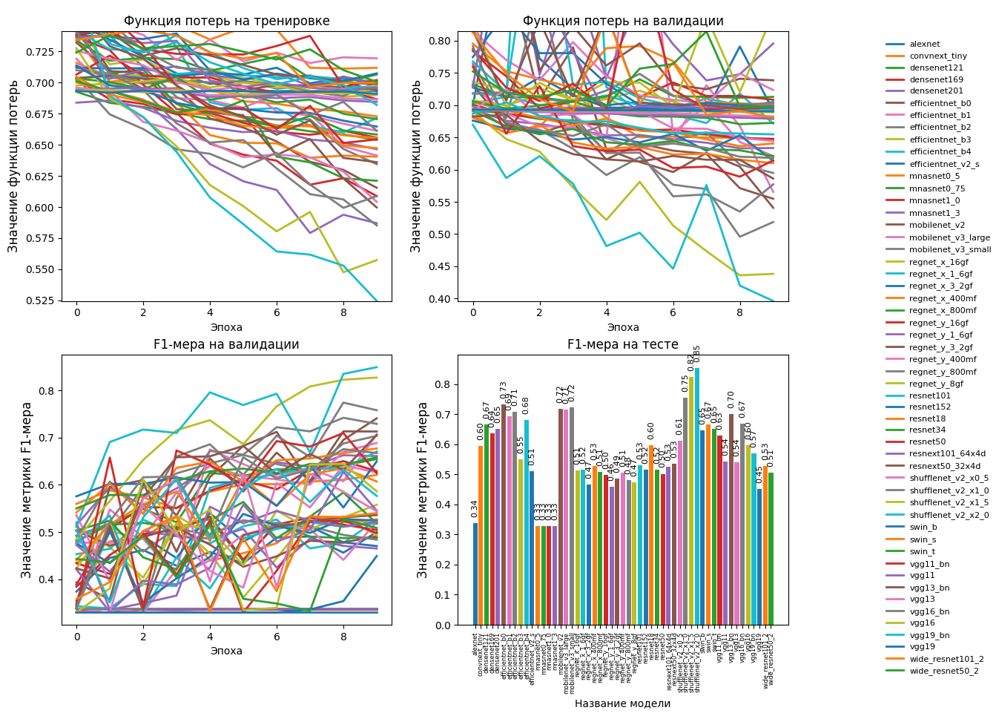

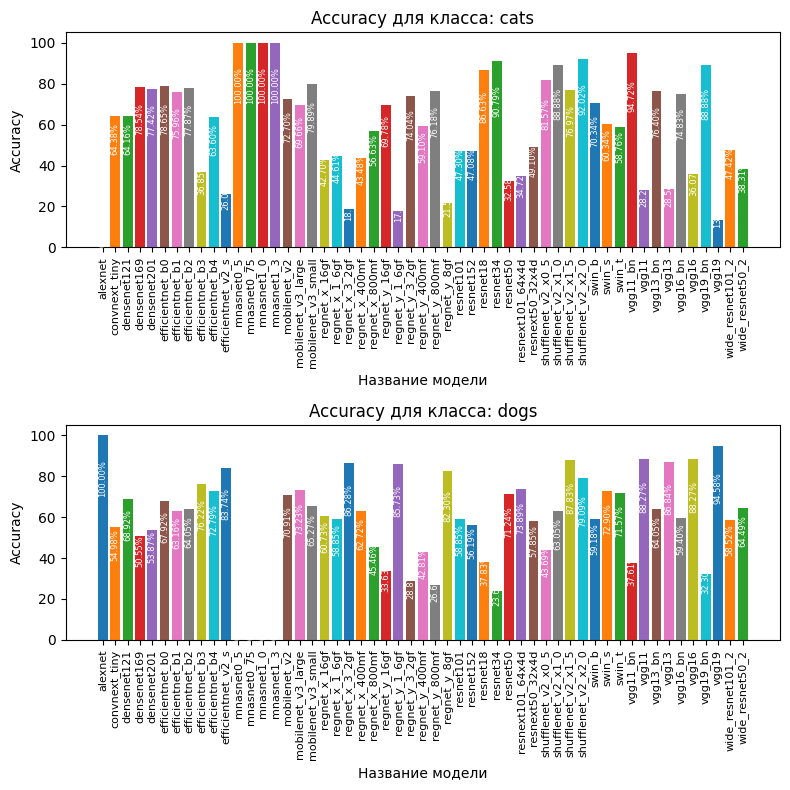

In [199]:
graduate_pipeline.graduate()

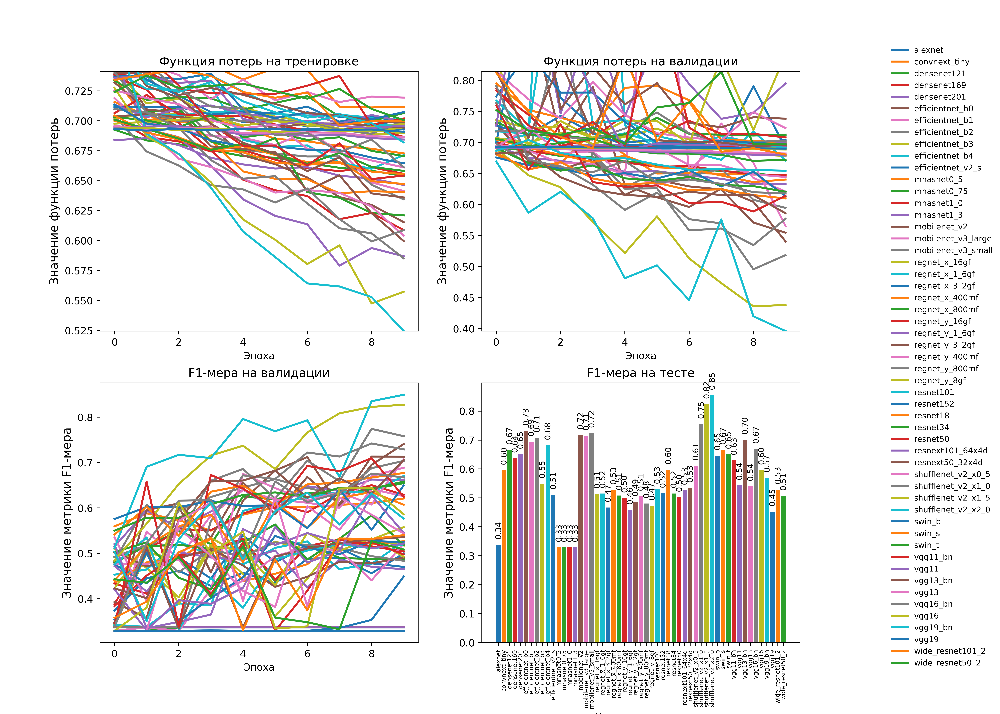

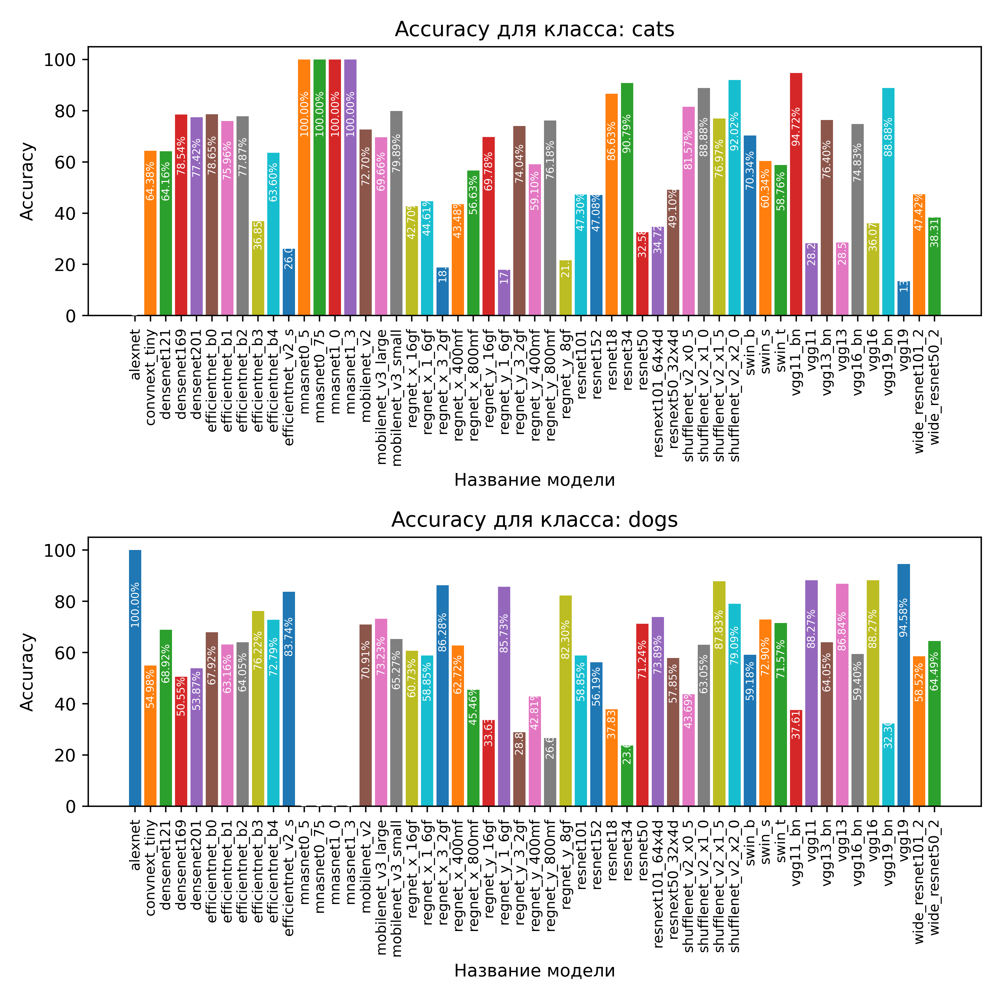

In [200]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_Exp2.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_Exp2.png"))

## Exp3 / Диcбаланс классов + кроссэнтропия + oversampling

In [201]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "Exp3",
        "models": model_list,
        "name_optimizers": optimizer_list,
        "name_loss": "CrossEntropyLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 10,
        "class_percentage": {"cats": 0.3, "dogs": 1.0},
        "resampling_method": "oversampling"
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1581.45image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1795.42image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: alexnet
        Пользовательское название модели: alexnet_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.49sample/s]



Epoch 1/10, Training Loss: 0.6932017837007487, Validation Loss: 0.6931827024551435
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.54sample/s]



Epoch 2/10, Training Loss: 0.6932622427330878, Validation Loss: 0.6931674884537519
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.02sample/s]



Epoch 3/10, Training Loss: 0.6930515760440005, Validation Loss: 0.6931550096994066
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.83sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6931298087902943, Validation Loss: 0.6931441847213917
Accuracy: 0.49830508474576274, Precision: 0.6497508042444904, Recall: 0.49830508474576274, F1-score: 0.3343158295267644


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.34sample/s]



Epoch 5/10, Training Loss: 0.692986300320798, Validation Loss: 0.6931432972183336
Accuracy: 0.4977401129943503, Precision: 0.5824906798877743, Recall: 0.4977401129943503, F1-score: 0.33405981658444817


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.42sample/s]



Epoch 6/10, Training Loss: 0.6931437788478985, Validation Loss: 0.6931436065226625
Accuracy: 0.4977401129943503, Precision: 0.6244414265696681, Recall: 0.4977401129943503, F1-score: 0.33307126176149393


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.18sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6930578311501671, Validation Loss: 0.6931439383892016
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.64sample/s]



Epoch 8/10, Training Loss: 0.6932054604884296, Validation Loss: 0.6931439515224285
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.78sample/s]



Epoch 9/10, Training Loss: 0.693161254029362, Validation Loss: 0.6931440023715887
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.27sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6929924607032468, Validation Loss: 0.693143883835798
Accuracy: 0.4966101694915254, Precision: 0.49831467137050384, Recall: 0.4966101694915254, F1-score: 0.3305748845483462
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.60sample/s]


Test Accuracy: 0.5027870680044593
Precision: 0.25363811912724954, Recall: 0.5027870680044593, F1-score: 0.33718064501189254
Accuracy of  cats :  0 %
Accuracy of  dogs : 99 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1756.67image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: convnext_tiny
        Пользовательское название модели: convnext_tiny_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.47sample/s]



Epoch 1/10, Training Loss: 0.7233959969517636, Validation Loss: 1.015580299547163
Accuracy: 0.507909604519774, Precision: 0.5081384126682098, Recall: 0.507909604519774, F1-score: 0.507568104155418


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.73sample/s]



Epoch 2/10, Training Loss: 0.6925649058712889, Validation Loss: 0.8389011653466413
Accuracy: 0.5084745762711864, Precision: 0.5093814958196342, Recall: 0.5084745762711864, F1-score: 0.5047332271875173


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.57sample/s]



Epoch 3/10, Training Loss: 0.6914106284765372, Validation Loss: 0.7434138096658524
Accuracy: 0.5480225988700564, Precision: 0.5482765991302996, Recall: 0.5480225988700564, F1-score: 0.5478407688810962


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.90sample/s]



Epoch 4/10, Training Loss: 0.6851130623525735, Validation Loss: 0.955540308676197
Accuracy: 0.5163841807909605, Precision: 0.5169070171871485, Recall: 0.5163841807909605, F1-score: 0.515245715277006


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.40sample/s]



Epoch 5/10, Training Loss: 0.686723942656429, Validation Loss: 0.7359262780617859
Accuracy: 0.5468926553672316, Precision: 0.5470651872972009, Recall: 0.5468926553672316, F1-score: 0.5468000811611454


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 6/10, Training Loss: 0.6697602474925783, Validation Loss: 0.6700952883999226
Accuracy: 0.592090395480226, Precision: 0.5938263467903704, Recall: 0.592090395480226, F1-score: 0.589525674906131


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.90sample/s]



Epoch 7/10, Training Loss: 0.6840148137516953, Validation Loss: 0.7866677378362181
Accuracy: 0.5418079096045197, Precision: 0.541750979757917, Recall: 0.5418079096045197, F1-score: 0.5415425518261314


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.87sample/s]



Epoch 8/10, Training Loss: 0.6671698139248363, Validation Loss: 0.6889776651468654
Accuracy: 0.5774011299435028, Precision: 0.5777119388641012, Recall: 0.5774011299435028, F1-score: 0.577231118903825


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.83sample/s]



Epoch 9/10, Training Loss: 0.6754542739115915, Validation Loss: 0.6619217987619551
Accuracy: 0.5977401129943503, Precision: 0.6006849657451792, Recall: 0.5977401129943503, F1-score: 0.5954271143846396


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.94sample/s]



Epoch 10/10, Training Loss: 0.6663858142623491, Validation Loss: 0.6715278893204059
Accuracy: 0.5824858757062147, Precision: 0.5824651337363203, Recall: 0.5824858757062147, F1-score: 0.5823934891323966
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.75sample/s]


Test Accuracy: 0.5819397993311036
Precision: 0.5822486410962334, Recall: 0.5819397993311036, F1-score: 0.5818046796799502
Accuracy of  cats : 60 %
Accuracy of  dogs : 56 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1814.82image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.58image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet121
        Пользовательское название модели: densenet121_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.72sample/s]



Epoch 1/10, Training Loss: 0.6936994475692572, Validation Loss: 0.6952323475799992
Accuracy: 0.5180790960451978, Precision: 0.5368735642888185, Recall: 0.5180790960451978, F1-score: 0.4358211609163549


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.59sample/s]



Epoch 2/10, Training Loss: 0.6813208430048056, Validation Loss: 0.6940627064408555
Accuracy: 0.535593220338983, Precision: 0.5410798212878305, Recall: 0.535593220338983, F1-score: 0.5231624138878177


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.87sample/s]



Epoch 3/10, Training Loss: 0.6834936174357173, Validation Loss: 0.6815655009221222
Accuracy: 0.5457627118644067, Precision: 0.5922227213017814, Recall: 0.5457627118644067, F1-score: 0.4757632969922302


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.81sample/s]



Epoch 4/10, Training Loss: 0.6733749905678807, Validation Loss: 0.6781051953633627
Accuracy: 0.6028248587570622, Precision: 0.6043138026820141, Recall: 0.6028248587570622, F1-score: 0.6018230305521388


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.77sample/s]



Epoch 5/10, Training Loss: 0.6683272430323121, Validation Loss: 0.671274029434064
Accuracy: 0.588135593220339, Precision: 0.6308060999850386, Recall: 0.588135593220339, F1-score: 0.5493135052673306


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.85sample/s]



Epoch 6/10, Training Loss: 0.6618808580642682, Validation Loss: 0.6739338505066047
Accuracy: 0.5864406779661017, Precision: 0.6174792510321483, Recall: 0.5864406779661017, F1-score: 0.5592547379325449


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.09sample/s]



Epoch 7/10, Training Loss: 0.6604541296512397, Validation Loss: 0.6588523246474185
Accuracy: 0.6214689265536724, Precision: 0.6316430670450996, Recall: 0.6214689265536724, F1-score: 0.6148623100244575


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.18sample/s]



Epoch 8/10, Training Loss: 0.6553157123285699, Validation Loss: 0.6625796788829869
Accuracy: 0.6141242937853107, Precision: 0.6405657079297897, Recall: 0.6141242937853107, F1-score: 0.5936550876320629


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.23sample/s]



Epoch 9/10, Training Loss: 0.6506503837938107, Validation Loss: 0.6575129416029332
Accuracy: 0.6271186440677966, Precision: 0.6589680825462733, Recall: 0.6271186440677966, F1-score: 0.6061637852173325


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.29sample/s]



Epoch 10/10, Training Loss: 0.6504289770036712, Validation Loss: 0.652266410111034
Accuracy: 0.6299435028248588, Precision: 0.6335242689817304, Recall: 0.6299435028248588, F1-score: 0.6279105678049699
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.75sample/s]


Test Accuracy: 0.6465997770345596
Precision: 0.6487349617368056, Recall: 0.6465997770345596, F1-score: 0.6449351774916156
Accuracy of  cats : 57 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1818.21image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1804.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet169
        Пользовательское название модели: densenet169_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.32sample/s]



Epoch 1/10, Training Loss: 0.7002758771608891, Validation Loss: 0.7130982990318773
Accuracy: 0.5028248587570622, Precision: 0.49488665364925793, Recall: 0.5028248587570622, F1-score: 0.354087500518999


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.21sample/s]



Epoch 2/10, Training Loss: 0.6857811151631303, Validation Loss: 0.6918454197167003
Accuracy: 0.5282485875706214, Precision: 0.5354915527170501, Recall: 0.5282485875706214, F1-score: 0.5082774001821602


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.32sample/s]



Epoch 3/10, Training Loss: 0.6799710864940899, Validation Loss: 0.6836784047595525
Accuracy: 0.5717514124293785, Precision: 0.5821253916056732, Recall: 0.5717514124293785, F1-score: 0.559619867591977


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.28sample/s]



Epoch 4/10, Training Loss: 0.6741972790135966, Validation Loss: 0.6795146913178223
Accuracy: 0.5864406779661017, Precision: 0.5950410528844436, Recall: 0.5864406779661017, F1-score: 0.5781720097376519


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.08sample/s]



Epoch 5/10, Training Loss: 0.6686672573617608, Validation Loss: 0.6757930759656228
Accuracy: 0.5836158192090396, Precision: 0.6160768348914392, Recall: 0.5836158192090396, F1-score: 0.5544892794851021


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.35sample/s]



Epoch 6/10, Training Loss: 0.6667906951798369, Validation Loss: 0.6709578956587839
Accuracy: 0.603954802259887, Precision: 0.6155656215085459, Recall: 0.603954802259887, F1-score: 0.5948877254415292


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.38sample/s]



Epoch 7/10, Training Loss: 0.6701227977148735, Validation Loss: 0.6616862086252978
Accuracy: 0.615819209039548, Precision: 0.6250640933026717, Recall: 0.615819209039548, F1-score: 0.6094620725277563


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.24sample/s]



Epoch 8/10, Training Loss: 0.6573886462498102, Validation Loss: 0.6778079055796908
Accuracy: 0.5644067796610169, Precision: 0.6061251614060851, Recall: 0.5644067796610169, F1-score: 0.5199906016098337


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.27sample/s]



Epoch 9/10, Training Loss: 0.665978509293626, Validation Loss: 0.6856025185457058
Accuracy: 0.5508474576271186, Precision: 0.6503913103174724, Recall: 0.5508474576271186, F1-score: 0.4581762758698667


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.45sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.662015070816628, Validation Loss: 0.6665947832966929
Accuracy: 0.5943502824858757, Precision: 0.6427968747684758, Recall: 0.5943502824858757, F1-score: 0.5546437472574187
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:07<00:00,  9.85sample/s]


Test Accuracy: 0.5914158305462653
Precision: 0.6484253181710549, Recall: 0.5914158305462653, F1-score: 0.5504885919092424
Accuracy of  cats : 89 %
Accuracy of  dogs : 29 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.22image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1841.44image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet201
        Пользовательское название модели: densenet201_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.18sample/s]



Epoch 1/10, Training Loss: 0.6969302922018733, Validation Loss: 0.6913870759939743
Accuracy: 0.5214689265536723, Precision: 0.5688208365160304, Recall: 0.5214689265536723, F1-score: 0.41396855666413845


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.45sample/s]



Epoch 2/10, Training Loss: 0.6801430490517242, Validation Loss: 0.6933931752113299
Accuracy: 0.5418079096045197, Precision: 0.5929312344638193, Recall: 0.5418079096045197, F1-score: 0.47333846942324587


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.14sample/s]



Epoch 3/10, Training Loss: 0.676533403436533, Validation Loss: 0.6878322219781283
Accuracy: 0.5700564971751413, Precision: 0.6107303014751722, Recall: 0.5700564971751413, F1-score: 0.529365408964594


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.04sample/s]



Epoch 4/10, Training Loss: 0.6729105180937871, Validation Loss: 0.6927577875091531
Accuracy: 0.5203389830508475, Precision: 0.6157573987789862, Recall: 0.5203389830508475, F1-score: 0.3899614925422192


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.22sample/s]



Epoch 5/10, Training Loss: 0.6675141331926243, Validation Loss: 0.673996524285462
Accuracy: 0.6124293785310735, Precision: 0.6349515459294794, Recall: 0.6124293785310735, F1-score: 0.5968712234508595


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.25sample/s]



Epoch 6/10, Training Loss: 0.6632976736911583, Validation Loss: 0.6589326538608573
Accuracy: 0.6237288135593221, Precision: 0.6446932156384445, Recall: 0.6237288135593221, F1-score: 0.6107047978322088


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.21sample/s]



Epoch 7/10, Training Loss: 0.6531882416647913, Validation Loss: 0.6588417798449091
Accuracy: 0.6338983050847458, Precision: 0.6444379028062523, Recall: 0.6338983050847458, F1-score: 0.6278403279382149


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.09sample/s]



Epoch 8/10, Training Loss: 0.6521706787063418, Validation Loss: 0.6534243751380403
Accuracy: 0.6231638418079096, Precision: 0.648828878549986, Recall: 0.6231638418079096, F1-score: 0.6073964390308958


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.15sample/s]



Epoch 9/10, Training Loss: 0.65329984773615, Validation Loss: 0.6611741822486543
Accuracy: 0.5949152542372881, Precision: 0.67712317819572, Recall: 0.5949152542372881, F1-score: 0.5395631983586535


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.11sample/s]



Epoch 10/10, Training Loss: 0.6437749744113471, Validation Loss: 0.6459148167553594
Accuracy: 0.632768361581921, Precision: 0.6687651690830364, Recall: 0.632768361581921, F1-score: 0.610824228621707
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:08<00:00,  8.71sample/s]


Test Accuracy: 0.6321070234113713
Precision: 0.6764106241193784, Recall: 0.6321070234113713, F1-score: 0.6089531438825635
Accuracy of  cats : 87 %
Accuracy of  dogs : 38 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.78image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.50image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b0
        Пользовательское название модели: efficientnet_b0_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.99sample/s]



Epoch 1/10, Training Loss: 0.7379316492840108, Validation Loss: 0.6911301749237513
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.91sample/s]



Epoch 2/10, Training Loss: 0.7265227592651435, Validation Loss: 0.7124394974802847
Accuracy: 0.5299435028248588, Precision: 0.588539783844864, Recall: 0.5299435028248588, F1-score: 0.43069557627646954


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.71sample/s]



Epoch 3/10, Training Loss: 0.6742176899988197, Validation Loss: 0.6555216450475704
Accuracy: 0.6096045197740113, Precision: 0.6805957773232029, Recall: 0.6096045197740113, F1-score: 0.5652097201286237


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.15sample/s]



Epoch 4/10, Training Loss: 0.6488470809148422, Validation Loss: 0.639534140037278
Accuracy: 0.6587570621468927, Precision: 0.7022006875184605, Recall: 0.6587570621468927, F1-score: 0.6383658985961709


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.91sample/s]



Epoch 5/10, Training Loss: 0.6371143187917591, Validation Loss: 0.6010832661962778
Accuracy: 0.6926553672316385, Precision: 0.7061017791353319, Recall: 0.6926553672316385, F1-score: 0.6880165408978969


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.10sample/s]



Epoch 6/10, Training Loss: 0.6208969870008024, Validation Loss: 0.5740864459572539
Accuracy: 0.7192090395480226, Precision: 0.7192051049511512, Recall: 0.7192090395480226, F1-score: 0.7192050060644277


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.63sample/s]



Epoch 7/10, Training Loss: 0.6099449862520416, Validation Loss: 0.6669783121616827
Accuracy: 0.6943502824858757, Precision: 0.7008593016153793, Recall: 0.6943502824858757, F1-score: 0.6921736294273374


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.88sample/s]



Epoch 8/10, Training Loss: 0.5909805712293291, Validation Loss: 0.5660241110681814
Accuracy: 0.735593220338983, Precision: 0.7365599415110189, Recall: 0.735593220338983, F1-score: 0.7352280218081267


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.15sample/s]



Epoch 9/10, Training Loss: 0.5621243715795522, Validation Loss: 0.8441610294630972
Accuracy: 0.7203389830508474, Precision: 0.7208511398511821, Recall: 0.7203389830508474, F1-score: 0.7202449642214646


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.03sample/s]



Epoch 10/10, Training Loss: 0.5542467855278629, Validation Loss: 0.7202532767912763
Accuracy: 0.7367231638418079, Precision: 0.7465799607538963, Recall: 0.7367231638418079, F1-score: 0.7343343420805226
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.35sample/s]


Test Accuracy: 0.7486064659977704
Precision: 0.7583075185848059, Recall: 0.7486064659977704, F1-score: 0.7459355101847518
Accuracy of  cats : 64 %
Accuracy of  dogs : 84 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.73image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.87image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b1
        Пользовательское название модели: efficientnet_b1_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 1/10, Training Loss: 0.7629931305298965, Validation Loss: 0.7263802050028817
Accuracy: 0.503954802259887, Precision: 0.5164727153394352, Recall: 0.503954802259887, F1-score: 0.34620439557974014


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.29sample/s]



Epoch 2/10, Training Loss: 0.7078191230986433, Validation Loss: 0.699703036055053
Accuracy: 0.5056497175141242, Precision: 0.6016101694915253, Recall: 0.5056497175141242, F1-score: 0.34505953827998803


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.39sample/s]



Epoch 3/10, Training Loss: 0.7000973176361353, Validation Loss: 1.5860588171724546
Accuracy: 0.5468926553672316, Precision: 0.5892004919094855, Recall: 0.5468926553672316, F1-score: 0.48146400683352203


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 4/10, Training Loss: 0.7111127179775512, Validation Loss: 0.7926435221386494
Accuracy: 0.615819209039548, Precision: 0.6188456091322643, Recall: 0.615819209039548, F1-score: 0.6138678145457807


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.48sample/s]



Epoch 5/10, Training Loss: 0.6917373319032334, Validation Loss: 0.6714550052995736
Accuracy: 0.6067796610169491, Precision: 0.65695539250396, Recall: 0.6067796610169491, F1-score: 0.570800096638078


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.41sample/s]



Epoch 6/10, Training Loss: 0.6863273654543042, Validation Loss: 0.8850408964237925
Accuracy: 0.5689265536723164, Precision: 0.6244913629198693, Recall: 0.5689265536723164, F1-score: 0.5117554636082078


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.25sample/s]



Epoch 7/10, Training Loss: 0.6634791545361097, Validation Loss: 0.828098550691443
Accuracy: 0.5666666666666667, Precision: 0.567431867013457, Recall: 0.5666666666666667, F1-score: 0.5659734552166652


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.62sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.6619618196277202, Validation Loss: 0.7141224207346049
Accuracy: 0.5813559322033899, Precision: 0.5959322845898587, Recall: 0.5813559322033899, F1-score: 0.5665862282868105


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 9/10, Training Loss: 0.6516465405772504, Validation Loss: 0.6641283450321963
Accuracy: 0.6209039548022599, Precision: 0.6329997277638288, Recall: 0.6209039548022599, F1-score: 0.6130091723052784


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.36sample/s]



Epoch 10/10, Training Loss: 0.6355113297782364, Validation Loss: 0.6622332796706991
Accuracy: 0.6480225988700565, Precision: 0.6497749882193242, Recall: 0.6480225988700565, F1-score: 0.6472512130369472
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.63sample/s]


Test Accuracy: 0.644927536231884
Precision: 0.6458158028321018, Recall: 0.644927536231884, F1-score: 0.644114797756931
Accuracy of  cats : 59 %
Accuracy of  dogs : 69 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1853.64image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1866.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b2
        Пользовательское название модели: efficientnet_b2_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.89sample/s]



Epoch 1/10, Training Loss: 0.7496337472210987, Validation Loss: 0.7233480103945328
Accuracy: 0.5005649717514125, Precision: 0.32363858105611853, Recall: 0.5005649717514125, F1-score: 0.3368406846089726


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.78sample/s]



Epoch 2/10, Training Loss: 0.7251845198140434, Validation Loss: 0.7358518164541762
Accuracy: 0.5028248587570622, Precision: 0.4850239026510213, Recall: 0.5028248587570622, F1-score: 0.3437506045530486


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.73sample/s]



Epoch 3/10, Training Loss: 0.7387536098226977, Validation Loss: 0.7338538025058595
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.86sample/s]



Epoch 4/10, Training Loss: 0.7144967213283234, Validation Loss: 0.7145794067679152
Accuracy: 0.5016949152542373, Precision: 0.4839880595216277, Recall: 0.5016949152542373, F1-score: 0.35534351392676633


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.41sample/s]



Epoch 5/10, Training Loss: 0.6996620759031826, Validation Loss: 0.7057443754484425
Accuracy: 0.5282485875706214, Precision: 0.5484790451273218, Recall: 0.5282485875706214, F1-score: 0.465682584682639


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.50sample/s]



Epoch 6/10, Training Loss: 0.7048601120690002, Validation Loss: 0.7042741267021093
Accuracy: 0.492090395480226, Precision: 0.44706693092764715, Recall: 0.492090395480226, F1-score: 0.3656681991811341


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.46sample/s]



Epoch 7/10, Training Loss: 0.701059964447908, Validation Loss: 0.7105825496258709
Accuracy: 0.5011299435028248, Precision: 0.4459703841291953, Recall: 0.5011299435028248, F1-score: 0.3429631806327411


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.43sample/s]



Epoch 8/10, Training Loss: 0.7003163817355833, Validation Loss: 0.7137120564778646
Accuracy: 0.47401129943502823, Precision: 0.424955902660794, Recall: 0.47401129943502823, F1-score: 0.37717877564215213


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.86sample/s]



Epoch 9/10, Training Loss: 0.7152770795972072, Validation Loss: 0.6995420395317724
Accuracy: 0.5022598870056497, Precision: 0.4980487828482577, Recall: 0.5022598870056497, F1-score: 0.3954287039015114


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.43sample/s]



Epoch 10/10, Training Loss: 0.7059213210480391, Validation Loss: 0.6941817076192738
Accuracy: 0.5073446327683616, Precision: 0.5312922726893613, Recall: 0.5073446327683616, F1-score: 0.3704856167993564
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.55sample/s]


Test Accuracy: 0.5027870680044593
Precision: 0.5518420114650225, Recall: 0.5027870680044593, F1-score: 0.36424989817486253
Accuracy of  cats : 97 %
Accuracy of  dogs :  3 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1841.49image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1857.91image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b3
        Пользовательское название модели: efficientnet_b3_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.68sample/s]



Epoch 1/10, Training Loss: 0.7689464438556403, Validation Loss: 0.7193466832408797
Accuracy: 0.5050847457627119, Precision: 0.5345487094625633, Recall: 0.5050847457627119, F1-score: 0.3505440009851479


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.90sample/s]



Epoch 2/10, Training Loss: 0.7315147685743894, Validation Loss: 2.5766330994455156
Accuracy: 0.5124293785310734, Precision: 0.5183739973288284, Recall: 0.5124293785310734, F1-score: 0.45063051377298313


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.61sample/s]



Epoch 3/10, Training Loss: 0.7105554972131694, Validation Loss: 0.7103605022874929
Accuracy: 0.5056497175141242, Precision: 0.5239276621864458, Recall: 0.5056497175141242, F1-score: 0.36179534364711147


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.37sample/s]



Epoch 4/10, Training Loss: 0.6968583157025049, Validation Loss: 1.0079783487454645
Accuracy: 0.5327683615819209, Precision: 0.534338697841058, Recall: 0.5327683615819209, F1-score: 0.5295304795980355


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.59sample/s]



Epoch 5/10, Training Loss: 0.713410136130112, Validation Loss: 0.724391358552006
Accuracy: 0.5169491525423728, Precision: 0.5185946237650567, Recall: 0.5169491525423728, F1-score: 0.5112677602906546


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.68sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.7165578210590151, Validation Loss: 6.251671911969697
Accuracy: 0.4966101694915254, Precision: 0.48928179490306056, Recall: 0.4966101694915254, F1-score: 0.42934627901003625


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.63sample/s]



Epoch 7/10, Training Loss: 0.6997016506780115, Validation Loss: 0.829558098720292
Accuracy: 0.5045197740112994, Precision: 0.5043866814327626, Recall: 0.5045197740112994, F1-score: 0.4278911635216402


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.46sample/s]



Epoch 8/10, Training Loss: 0.6964392247301051, Validation Loss: 1.0183175468848924
Accuracy: 0.5316384180790961, Precision: 0.5466500578288415, Recall: 0.5316384180790961, F1-score: 0.48405502370034814


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.41sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-05.

Epoch 9/10, Training Loss: 0.6976986660056137, Validation Loss: 0.7346006126727088
Accuracy: 0.5259887005649717, Precision: 0.5371555549330268, Recall: 0.5259887005649717, F1-score: 0.47939724504636916


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.67sample/s]



Epoch 10/10, Training Loss: 0.6961127023784901, Validation Loss: 0.7298551159726698
Accuracy: 0.5220338983050847, Precision: 0.5315734598461083, Recall: 0.5220338983050847, F1-score: 0.47327500902791314
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.59sample/s]


Test Accuracy: 0.5217391304347826
Precision: 0.5395466074714079, Recall: 0.5217391304347826, F1-score: 0.4708612916416368
Accuracy of  cats : 83 %
Accuracy of  dogs : 21 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1829.04image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b4
        Пользовательское название модели: efficientnet_b4_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.63sample/s]



Epoch 1/10, Training Loss: 0.7520789758888565, Validation Loss: 0.7511376188804875
Accuracy: 0.503954802259887, Precision: 0.5846201068554383, Recall: 0.503954802259887, F1-score: 0.3393605141996859


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.43sample/s]



Epoch 2/10, Training Loss: 0.726737882939415, Validation Loss: 1.2949765623457687
Accuracy: 0.5028248587570622, Precision: 0.48697319336912254, Recall: 0.5028248587570622, F1-score: 0.34471511174279196


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.64sample/s]



Epoch 3/10, Training Loss: 0.7286053304792836, Validation Loss: 1.7581655645774583
Accuracy: 0.503954802259887, Precision: 0.5294475083173723, Recall: 0.503954802259887, F1-score: 0.3423245682218763


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.49sample/s]



Epoch 4/10, Training Loss: 0.7087547726526867, Validation Loss: 0.7124000208526008
Accuracy: 0.5062146892655367, Precision: 0.5278234903608968, Recall: 0.5062146892655367, F1-score: 0.36384838823288285


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.51sample/s]



Epoch 5/10, Training Loss: 0.6963615191773201, Validation Loss: 0.6772590520354987
Accuracy: 0.5423728813559322, Precision: 0.6217670726866396, Recall: 0.5423728813559322, F1-score: 0.4488859445200486


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.45sample/s]



Epoch 6/10, Training Loss: 0.7200374431953964, Validation Loss: 0.6885962764085349
Accuracy: 0.5610169491525424, Precision: 0.5907029090034861, Recall: 0.5610169491525424, F1-score: 0.5185821934457384


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.78sample/s]



Epoch 7/10, Training Loss: 0.7054852250701177, Validation Loss: 0.6776553592776174
Accuracy: 0.5751412429378531, Precision: 0.6002109952669873, Recall: 0.5751412429378531, F1-score: 0.5443138389959788


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.58sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7067077648370785, Validation Loss: 0.6788996389019961
Accuracy: 0.5740112994350283, Precision: 0.5795662447718549, Recall: 0.5740112994350283, F1-score: 0.5649055785399706


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.55sample/s]



Epoch 9/10, Training Loss: 0.6792577571723857, Validation Loss: 0.6772089961726787
Accuracy: 0.584180790960452, Precision: 0.5979586368594847, Recall: 0.584180790960452, F1-score: 0.5672413014263417


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.78sample/s]



Epoch 10/10, Training Loss: 0.6724152342961899, Validation Loss: 0.6481687605886136
Accuracy: 0.6429378531073446, Precision: 0.6484725103522692, Recall: 0.6429378531073446, F1-score: 0.6390383950190246
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.85sample/s]


Test Accuracy: 0.649386845039019
Precision: 0.6547187127441558, Recall: 0.649386845039019, F1-score: 0.6468587414303102
Accuracy of  cats : 73 %
Accuracy of  dogs : 56 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1821.95image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.60image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_v2_s
        Пользовательское название модели: efficientnet_v2_s_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.76sample/s]



Epoch 1/10, Training Loss: 0.7386375120137542, Validation Loss: 0.7076020740856559
Accuracy: 0.4971751412429379, Precision: 0.5020420169851104, Recall: 0.4971751412429379, F1-score: 0.36200441794770727


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.83sample/s]



Epoch 2/10, Training Loss: 0.7390416694763011, Validation Loss: 1.4977716212555514
Accuracy: 0.48983050847457626, Precision: 0.48371637017272523, Recall: 0.48983050847457626, F1-score: 0.41304459632541474


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.76sample/s]



Epoch 3/10, Training Loss: 0.7223492575196966, Validation Loss: 0.8182473559837556
Accuracy: 0.5067796610169492, Precision: 0.5274799286351473, Recall: 0.5067796610169492, F1-score: 0.3693375052440873


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.91sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7098403243438397, Validation Loss: 0.9009946766546217
Accuracy: 0.5028248587570622, Precision: 0.48851249012288633, Recall: 0.5028248587570622, F1-score: 0.3456745668640237


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.95sample/s]



Epoch 5/10, Training Loss: 0.7008109771667567, Validation Loss: 0.7315631534083414
Accuracy: 0.5011299435028248, Precision: 0.45148958837772396, Recall: 0.5011299435028248, F1-score: 0.3439233840244508


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.88sample/s]



Epoch 6/10, Training Loss: 0.7005961471767517, Validation Loss: 0.7967457321740813
Accuracy: 0.507909604519774, Precision: 0.5330517517017875, Recall: 0.507909604519774, F1-score: 0.37331730532475127


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.85sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6981039986533819, Validation Loss: 0.7597973333240229
Accuracy: 0.49265536723163844, Precision: 0.4730847906390208, Recall: 0.49265536723163844, F1-score: 0.35795507956941525


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.90sample/s]



Epoch 8/10, Training Loss: 0.6988660190216255, Validation Loss: 0.722140645913485
Accuracy: 0.503954802259887, Precision: 0.5098914020519828, Recall: 0.503954802259887, F1-score: 0.35280123112049383


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.71sample/s]



Epoch 9/10, Training Loss: 0.6956556149524772, Validation Loss: 0.7095884493852066
Accuracy: 0.5112994350282486, Precision: 0.5599003115304686, Recall: 0.5112994350282486, F1-score: 0.3759602598810133


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.76sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.7031337099171467, Validation Loss: 0.7134226146390883
Accuracy: 0.5062146892655367, Precision: 0.5186510627138536, Recall: 0.5062146892655367, F1-score: 0.3757218928987097
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.09sample/s]


Test Accuracy: 0.4944258639910814
Precision: 0.4893935178076262, Recall: 0.4944258639910814, F1-score: 0.3679226811234214
Accuracy of  cats : 94 %
Accuracy of  dogs :  4 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1832.77image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1859.93image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_5
        Пользовательское название модели: mnasnet0_5_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 1/10, Training Loss: 0.7636850132611379, Validation Loss: 0.6931246471943828
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]



Epoch 2/10, Training Loss: 0.6880694549945797, Validation Loss: 0.6931241801229574
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.63sample/s]



Epoch 3/10, Training Loss: 0.6850889189880512, Validation Loss: 0.6931279843809914
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.99sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6697331219504161, Validation Loss: 0.6934376865793757
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.41sample/s]



Epoch 5/10, Training Loss: 0.6492721141810622, Validation Loss: 0.6932736615003166
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.28sample/s]



Epoch 6/10, Training Loss: 0.6406856125560593, Validation Loss: 0.6931685667253483
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.57sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.6363989950163431, Validation Loss: 0.6931687667544952
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.17sample/s]



Epoch 8/10, Training Loss: 0.6185577236273805, Validation Loss: 0.6931634164799405
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 9/10, Training Loss: 0.6092888467925425, Validation Loss: 0.6931950017220556
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.30sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.6213861159567791, Validation Loss: 0.6932327664841367
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.93sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1871.33image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1871.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_75
        Пользовательское название модели: mnasnet0_75_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.94sample/s]



Epoch 1/10, Training Loss: 0.7344195654110311, Validation Loss: 0.6931500163792217
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.49sample/s]



Epoch 2/10, Training Loss: 0.7130252367327332, Validation Loss: 0.6931645440853248
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.64sample/s]



Epoch 3/10, Training Loss: 0.7037823107946596, Validation Loss: 0.6934622923533121
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.69sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.680700796133675, Validation Loss: 0.6956699384471118
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 5/10, Training Loss: 0.617811970865979, Validation Loss: 0.6971597152914705
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.28sample/s]



Epoch 6/10, Training Loss: 0.601558727622847, Validation Loss: 0.6999144303259877
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.26sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.5915022523372204, Validation Loss: 0.7004243941967097
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 8/10, Training Loss: 0.5753276320104312, Validation Loss: 0.702459658438203
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 9/10, Training Loss: 0.5663908668784189, Validation Loss: 0.7044125975525312
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.39sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.5708303486168262, Validation Loss: 0.7060393283596147
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.79sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1736.52image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1790.73image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_0
        Пользовательское название модели: mnasnet1_0_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 1/10, Training Loss: 0.7371840662770457, Validation Loss: 0.693126400816912
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.86sample/s]



Epoch 2/10, Training Loss: 0.6848557935906695, Validation Loss: 0.693484757916402
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.20sample/s]



Epoch 3/10, Training Loss: 0.674951211055989, Validation Loss: 0.6962474333701161
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.35sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6419444314458154, Validation Loss: 0.6960245788434131
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.82sample/s]



Epoch 5/10, Training Loss: 0.6194846429037706, Validation Loss: 0.6956943862855771
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.60sample/s]



Epoch 6/10, Training Loss: 0.592426934015319, Validation Loss: 0.6964104577983167
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.12sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.5602392709711522, Validation Loss: 0.6960281658980806
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.57sample/s]



Epoch 8/10, Training Loss: 0.5422665812813575, Validation Loss: 0.6957682622017833
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.20sample/s]



Epoch 9/10, Training Loss: 0.526100354443571, Validation Loss: 0.6957246782416004
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.63sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.5341475886978356, Validation Loss: 0.6956725248509208
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.96sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.25image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1841.73image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_3
        Пользовательское название модели: mnasnet1_3_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 1/10, Training Loss: 0.7266751962496822, Validation Loss: 0.6931420168970938
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.42sample/s]



Epoch 2/10, Training Loss: 0.6835700941366931, Validation Loss: 0.6934248219102116
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.58sample/s]



Epoch 3/10, Training Loss: 0.6503402646567344, Validation Loss: 0.6937848460876336
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.52sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.6340497219635866, Validation Loss: 0.6940135238534313
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.08sample/s]



Epoch 5/10, Training Loss: 0.5700780131070482, Validation Loss: 0.6933485075915601
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 6/10, Training Loss: 0.5437499511368211, Validation Loss: 0.6944254909531545
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.61sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.5175093691375919, Validation Loss: 0.6940456776969177
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.12sample/s]



Epoch 8/10, Training Loss: 0.4859808297981893, Validation Loss: 0.694452359683096
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.82sample/s]



Epoch 9/10, Training Loss: 0.4665236627697048, Validation Loss: 0.6949096210932327
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.4944485465824726, Validation Loss: 0.6949030076716579
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.55sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1852.45image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.17image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v2
        Пользовательское название модели: mobilenet_v2_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.69sample/s]



Epoch 1/10, Training Loss: 0.7438180291196376, Validation Loss: 0.6823238674866952
Accuracy: 0.5745762711864407, Precision: 0.5781909905529313, Recall: 0.5745762711864407, F1-score: 0.568324694121771


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 2/10, Training Loss: 0.6818749297585947, Validation Loss: 0.689194147869692
Accuracy: 0.536723163841808, Precision: 0.5374032392683552, Recall: 0.536723163841808, F1-score: 0.5325141950922504


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.66sample/s]



Epoch 3/10, Training Loss: 0.678183871695055, Validation Loss: 0.6360829263757177
Accuracy: 0.6531073446327683, Precision: 0.6661243744235625, Recall: 0.6531073446327683, F1-score: 0.6468384987893462


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.07sample/s]



Epoch 4/10, Training Loss: 0.6552016642084695, Validation Loss: 0.6107054156603786
Accuracy: 0.6638418079096046, Precision: 0.6787794484668971, Recall: 0.6638418079096046, F1-score: 0.6560100963020143


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.01sample/s]



Epoch 5/10, Training Loss: 0.654818589627865, Validation Loss: 0.6495419946094018
Accuracy: 0.6242937853107344, Precision: 0.6437941212991063, Recall: 0.6242937853107344, F1-score: 0.6099723524462075


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.28sample/s]



Epoch 6/10, Training Loss: 0.6437654951542758, Validation Loss: 0.6016057047803524
Accuracy: 0.6909604519774011, Precision: 0.7015297734820518, Recall: 0.6909604519774011, F1-score: 0.6864191337112997


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.48sample/s]



Epoch 7/10, Training Loss: 0.6333524343479356, Validation Loss: 0.5814592043558756
Accuracy: 0.6966101694915254, Precision: 0.7064100084277958, Recall: 0.6966101694915254, F1-score: 0.6925666007152343


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.71sample/s]



Epoch 8/10, Training Loss: 0.6106479131882108, Validation Loss: 0.5412526968340415
Accuracy: 0.7231638418079096, Precision: 0.7249821460361152, Recall: 0.7231638418079096, F1-score: 0.7227334757404136


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.62sample/s]



Epoch 9/10, Training Loss: 0.5938294598564088, Validation Loss: 0.5422724010580677
Accuracy: 0.731638418079096, Precision: 0.7317477030655718, Recall: 0.731638418079096, F1-score: 0.7315694354824196


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 10/10, Training Loss: 0.5873166880661383, Validation Loss: 0.5742704406969965
Accuracy: 0.7016949152542373, Precision: 0.7056130084730918, Recall: 0.7016949152542373, F1-score: 0.7004996552903205
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.77sample/s]


Test Accuracy: 0.6978818283166109
Precision: 0.7010577570650648, Recall: 0.6978818283166109, F1-score: 0.6964117330335753
Accuracy of  cats : 62 %
Accuracy of  dogs : 76 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1848.72image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1812.79image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_large
        Пользовательское название модели: mobilenet_v3_large_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.08sample/s]



Epoch 1/10, Training Loss: 0.7067476261868024, Validation Loss: 0.6945030736384419
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.80sample/s]



Epoch 2/10, Training Loss: 0.6825161505788463, Validation Loss: 0.6931745441956708
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 3/10, Training Loss: 0.6654654881845006, Validation Loss: 0.6932853608481628
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.52sample/s]



Epoch 4/10, Training Loss: 0.6411127284607167, Validation Loss: 0.6916799009856531
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.83sample/s]



Epoch 5/10, Training Loss: 0.6842296282803451, Validation Loss: 0.7097434586724319
Accuracy: 0.5, Precision: 0.4988697551559484, Recall: 0.5, F1-score: 0.48780825509425507


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 6/10, Training Loss: 0.682906394145787, Validation Loss: 0.765380528266147
Accuracy: 0.5203389830508475, Precision: 0.5409817559758067, Recall: 0.5203389830508475, F1-score: 0.44071922508597344


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.12sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.685549633782446, Validation Loss: 0.7475612672035303
Accuracy: 0.5531073446327683, Precision: 0.6053399975478468, Recall: 0.5531073446327683, F1-score: 0.4859494636862359


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.74sample/s]



Epoch 8/10, Training Loss: 0.640003777434381, Validation Loss: 0.6355474559263995
Accuracy: 0.6474576271186441, Precision: 0.6488193765619784, Recall: 0.6474576271186441, F1-score: 0.6463772188324709


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 9/10, Training Loss: 0.6234994003687994, Validation Loss: 0.6208847674441202
Accuracy: 0.6661016949152543, Precision: 0.6662978460596587, Recall: 0.6661016949152543, F1-score: 0.6659083207512253


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.61sample/s]



Epoch 10/10, Training Loss: 0.6122946925996023, Validation Loss: 0.6132384507501193
Accuracy: 0.6632768361581921, Precision: 0.6648282349643063, Recall: 0.6632768361581921, F1-score: 0.6626912823223734
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.96sample/s]


Test Accuracy: 0.6711259754738016
Precision: 0.6717232939027931, Recall: 0.6711259754738016, F1-score: 0.6706715033767645
Accuracy of  cats : 63 %
Accuracy of  dogs : 70 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1802.00image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1795.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_small
        Пользовательское название модели: mobilenet_v3_small_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.96sample/s]



Epoch 1/10, Training Loss: 0.6996575971620994, Validation Loss: 0.6931633045107631
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 2/10, Training Loss: 0.6640090061757797, Validation Loss: 0.6934584901157745
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 3/10, Training Loss: 0.6399706636930441, Validation Loss: 0.692787175629772
Accuracy: 0.56045197740113, Precision: 0.6697133860384296, Recall: 0.56045197740113, F1-score: 0.47301480927832473


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 4/10, Training Loss: 0.6217155390032659, Validation Loss: 0.682410335810171
Accuracy: 0.5734463276836158, Precision: 0.6907306287189309, Recall: 0.5734463276836158, F1-score: 0.49330421483688913


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.12sample/s]



Epoch 5/10, Training Loss: 0.6115237640360814, Validation Loss: 0.6419814972385849
Accuracy: 0.6847457627118644, Precision: 0.6952676117125829, Recall: 0.6847457627118644, F1-score: 0.6799795555893262


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.33sample/s]



Epoch 6/10, Training Loss: 0.5778575124637932, Validation Loss: 0.5499180539348031
Accuracy: 0.727683615819209, Precision: 0.7324976829615457, Recall: 0.727683615819209, F1-score: 0.7264715970804809


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.43sample/s]



Epoch 7/10, Training Loss: 0.5743528298539653, Validation Loss: 0.5996577627746399
Accuracy: 0.7, Precision: 0.7186682639512829, Recall: 0.7, F1-score: 0.6939523743994098


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 8/10, Training Loss: 0.5800381537707636, Validation Loss: 0.7819048793891729
Accuracy: 0.6627118644067796, Precision: 0.6731666729133438, Recall: 0.6627118644067796, F1-score: 0.6569687028495123


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.45sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.5844218136917135, Validation Loss: 0.6805282314281679
Accuracy: 0.6440677966101694, Precision: 0.65080577031729, Recall: 0.6440677966101694, F1-score: 0.6394650979292364


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 10/10, Training Loss: 0.5746840789190971, Validation Loss: 0.5777701116719488
Accuracy: 0.6977401129943502, Precision: 0.6979112543677035, Recall: 0.6977401129943502, F1-score: 0.6976114301880407
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.32sample/s]


Test Accuracy: 0.6911928651059086
Precision: 0.6913942857953894, Recall: 0.6911928651059086, F1-score: 0.6911698365245627
Accuracy of  cats : 70 %
Accuracy of  dogs : 68 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.85image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_16gf
        Пользовательское название модели: regnet_x_16gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.55sample/s]



Epoch 1/10, Training Loss: 0.7036085782887099, Validation Loss: 12.20993006508777
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.40sample/s]



Epoch 2/10, Training Loss: 0.7077775777649243, Validation Loss: 3.013585940308574
Accuracy: 0.5056497175141242, Precision: 0.6016101694915253, Recall: 0.5056497175141242, F1-score: 0.34505953827998803


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.43sample/s]



Epoch 3/10, Training Loss: 0.7047114557015595, Validation Loss: 1.5063452810722555
Accuracy: 0.5124293785310734, Precision: 0.51264493698392, Recall: 0.5124293785310734, F1-score: 0.4994429851038162


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.40sample/s]



Epoch 4/10, Training Loss: 0.7068735872811026, Validation Loss: 2.1074949495578554
Accuracy: 0.5033898305084745, Precision: 0.5017278827134158, Recall: 0.5033898305084745, F1-score: 0.3478462736437673


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.38sample/s]



Epoch 5/10, Training Loss: 0.7012382448330695, Validation Loss: 1.1041222056005635
Accuracy: 0.5096045197740113, Precision: 0.6044826062387835, Recall: 0.5096045197740113, F1-score: 0.358333467568351


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.38sample/s]



Epoch 6/10, Training Loss: 0.6988090932450715, Validation Loss: 0.9727718959757163
Accuracy: 0.49265536723163844, Precision: 0.4830371232806141, Recall: 0.49265536723163844, F1-score: 0.3783885509201086


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.35sample/s]



Epoch 7/10, Training Loss: 0.6981753385686255, Validation Loss: 0.7986609606587954
Accuracy: 0.5129943502824859, Precision: 0.5671417575771784, Recall: 0.5129943502824859, F1-score: 0.39900627932583416


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.29sample/s]



Epoch 8/10, Training Loss: 0.6920104721027617, Validation Loss: 0.7420682728627307
Accuracy: 0.507909604519774, Precision: 0.5236991981046109, Recall: 0.507909604519774, F1-score: 0.38542491822777286


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.31sample/s]



Epoch 9/10, Training Loss: 0.6910615071440428, Validation Loss: 0.7575320509699105
Accuracy: 0.5169491525423728, Precision: 0.6196889419031504, Recall: 0.5169491525423728, F1-score: 0.390682096068853


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.24sample/s]



Epoch 10/10, Training Loss: 0.693879063701434, Validation Loss: 0.8137713624427547
Accuracy: 0.5073446327683616, Precision: 0.5588188633010241, Recall: 0.5073446327683616, F1-score: 0.35722400175064994
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.58sample/s]


Test Accuracy: 0.5016722408026756
Precision: 0.5694219851364828, Recall: 0.5016722408026756, F1-score: 0.3532678188721463
Accuracy of  cats : 98 %
Accuracy of  dogs :  2 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.12image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1832.15image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_1_6gf
        Пользовательское название модели: regnet_x_1_6gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.52sample/s]



Epoch 1/10, Training Loss: 0.7080405716283307, Validation Loss: 65.98734498540246
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.53sample/s]



Epoch 2/10, Training Loss: 0.7043667002361439, Validation Loss: 0.9494624940183877
Accuracy: 0.496045197740113, Precision: 0.48697387951235643, Recall: 0.496045197740113, F1-score: 0.4216687007973253


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.31sample/s]



Epoch 3/10, Training Loss: 0.7084168848197752, Validation Loss: 10.850013694427329
Accuracy: 0.4966101694915254, Precision: 0.4983127627310594, Recall: 0.4966101694915254, F1-score: 0.3315708596507212


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.36sample/s]



Epoch 4/10, Training Loss: 0.7093120570347395, Validation Loss: 4.035850488712306
Accuracy: 0.5022598870056497, Precision: 0.6141226777333902, Recall: 0.5022598870056497, F1-score: 0.347708683928905


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.61sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.7044237144826132, Validation Loss: 1.2971360278079065
Accuracy: 0.5050847457627119, Precision: 0.5212814562578097, Recall: 0.5050847457627119, F1-score: 0.357929973111431


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.53sample/s]



Epoch 6/10, Training Loss: 0.7119794080131933, Validation Loss: 0.7124936011551464
Accuracy: 0.49491525423728816, Precision: 0.4952873926447486, Recall: 0.49491525423728816, F1-score: 0.4928914617983838


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.08sample/s]



Epoch 7/10, Training Loss: 0.6983193829910281, Validation Loss: 0.698221819043833
Accuracy: 0.5056497175141242, Precision: 0.505862167721107, Recall: 0.5056497175141242, F1-score: 0.5053357144145747


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.60sample/s]



Epoch 8/10, Training Loss: 0.7014025406363233, Validation Loss: 0.6981093930659321
Accuracy: 0.5333333333333333, Precision: 0.534308499263182, Recall: 0.5333333333333333, F1-score: 0.5315954928365


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.88sample/s]



Epoch 9/10, Training Loss: 0.6950183734450532, Validation Loss: 0.7087907368517191
Accuracy: 0.5169491525423728, Precision: 0.5169761162769722, Recall: 0.5169491525423728, F1-score: 0.5169545491125076


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.51sample/s]



Epoch 10/10, Training Loss: 0.699141113890904, Validation Loss: 0.7207900071884953
Accuracy: 0.5022598870056497, Precision: 0.5033538338706872, Recall: 0.5022598870056497, F1-score: 0.4942444254511254
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.10sample/s]


Test Accuracy: 0.512263099219621
Precision: 0.5119897919630283, Recall: 0.512263099219621, F1-score: 0.5064945765665878
Accuracy of  cats : 40 %
Accuracy of  dogs : 61 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1801.40image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1820.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_3_2gf
        Пользовательское название модели: regnet_x_3_2gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.53sample/s]



Epoch 1/10, Training Loss: 0.7088177651268769, Validation Loss: 97.09722637456689
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.32sample/s]



Epoch 2/10, Training Loss: 0.7132540119280981, Validation Loss: 808.622695146981
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.26sample/s]



Epoch 3/10, Training Loss: 0.7055055797303774, Validation Loss: 2.4371459673100944
Accuracy: 0.49887005649717514, Precision: 0.5228213837324007, Recall: 0.49887005649717514, F1-score: 0.3524633986276775


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.36sample/s]



Epoch 4/10, Training Loss: 0.7055509563838466, Validation Loss: 1.2356152845978063
Accuracy: 0.5011299435028248, Precision: 0.47957621134377554, Recall: 0.5011299435028248, F1-score: 0.3559603296461708


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.58sample/s]



Epoch 5/10, Training Loss: 0.7003845938532954, Validation Loss: 0.7943771350181709
Accuracy: 0.5485875706214689, Precision: 0.5794407737240256, Recall: 0.5485875706214689, F1-score: 0.5040470734160749


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.75sample/s]



Epoch 6/10, Training Loss: 0.7047142422492587, Validation Loss: 4.071226851046506
Accuracy: 0.5028248587570622, Precision: 0.4519076199164546, Recall: 0.5028248587570622, F1-score: 0.3388511481311395


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.62sample/s]



Epoch 7/10, Training Loss: 0.7094552303146844, Validation Loss: 4.053728629303517
Accuracy: 0.4966101694915254, Precision: 0.49830508474576274, Recall: 0.4966101694915254, F1-score: 0.33550312517596714


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.34sample/s]



Epoch 8/10, Training Loss: 0.698454862270792, Validation Loss: 0.7891513786073459
Accuracy: 0.5050847457627119, Precision: 0.5666703640576105, Recall: 0.5050847457627119, F1-score: 0.3670064641985904


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.11sample/s]



Epoch 9/10, Training Loss: 0.6967557542998744, Validation Loss: 1.1351992606611576
Accuracy: 0.4994350282485876, Precision: 0.5493429168083143, Recall: 0.4994350282485876, F1-score: 0.3454151010197653


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.50sample/s]



Epoch 10/10, Training Loss: 0.6934483930702823, Validation Loss: 0.757216407754327
Accuracy: 0.5248587570621469, Precision: 0.5855036353076023, Recall: 0.5248587570621469, F1-score: 0.42876111024133085
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.93sample/s]


Test Accuracy: 0.5284280936454849
Precision: 0.5747240810100948, Recall: 0.5284280936454849, F1-score: 0.43419244314309224
Accuracy of  cats : 11 %
Accuracy of  dogs : 93 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1805.83image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1753.73image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_400mf
        Пользовательское название модели: regnet_x_400mf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.04sample/s]



Epoch 1/10, Training Loss: 0.785356114681502, Validation Loss: nan
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.80sample/s]



Epoch 2/10, Training Loss: 0.7541666831859398, Validation Loss: 2.0534841485668793
Accuracy: 0.503954802259887, Precision: 0.7501547364689425, Recall: 0.503954802259887, F1-score: 0.3383619970573583


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.09sample/s]



Epoch 3/10, Training Loss: 0.7602923539959235, Validation Loss: 3.1526946133985265
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.92sample/s]



Epoch 4/10, Training Loss: 0.7478496842162705, Validation Loss: 1.387355114633249
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.04sample/s]



Epoch 5/10, Training Loss: 0.7247768518497744, Validation Loss: 1.2187429840366046
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.01sample/s]



Epoch 6/10, Training Loss: 0.7325375297463926, Validation Loss: 1.1168453741376683
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.23sample/s]



Epoch 7/10, Training Loss: 0.7442151506062819, Validation Loss: 1.3420080411442592
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.99sample/s]



Epoch 8/10, Training Loss: 0.7364424713368458, Validation Loss: 1.247936279655008
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.26sample/s]



Epoch 9/10, Training Loss: 0.7222774494655803, Validation Loss: 1.0637829235339231
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.95sample/s]



Epoch 10/10, Training Loss: 0.7176418717968407, Validation Loss: 1.21557705590533
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.71sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1852.96image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.75image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_800mf
        Пользовательское название модели: regnet_x_800mf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.11sample/s]



Epoch 1/10, Training Loss: 0.7258630368250001, Validation Loss: 110529.2455861582
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.23sample/s]



Epoch 2/10, Training Loss: 0.7316228451789119, Validation Loss: 969.882969398283
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.68sample/s]



Epoch 3/10, Training Loss: 0.7171698763447107, Validation Loss: 1.667389785881433
Accuracy: 0.5022598870056497, Precision: 0.46004753089990547, Recall: 0.5022598870056497, F1-score: 0.34154690765372125


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.06sample/s]



Epoch 4/10, Training Loss: 0.7148835942790839, Validation Loss: 0.8445210772550712
Accuracy: 0.5050847457627119, Precision: 0.5157453269663578, Recall: 0.5050847457627119, F1-score: 0.3650154189682961


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.94sample/s]



Epoch 5/10, Training Loss: 0.7040132343443143, Validation Loss: 1.8977726364539842
Accuracy: 0.49830508474576274, Precision: 0.7504302034473829, Recall: 0.49830508474576274, F1-score: 0.3333258014084184


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.16sample/s]



Epoch 6/10, Training Loss: 0.7101171093898038, Validation Loss: 1.31652970106925
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.98sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.708317747791581, Validation Loss: 0.8460972445075121
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.01sample/s]



Epoch 8/10, Training Loss: 0.707079411245582, Validation Loss: 0.6981954190690639
Accuracy: 0.5214689265536723, Precision: 0.5273033000814963, Recall: 0.5214689265536723, F1-score: 0.501446452562472


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.94sample/s]



Epoch 9/10, Training Loss: 0.6919311093534416, Validation Loss: 0.6911149508198776
Accuracy: 0.5378531073446328, Precision: 0.5403316827910112, Recall: 0.5378531073446328, F1-score: 0.532923419710706


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.92sample/s]



Epoch 10/10, Training Loss: 0.6941716746157843, Validation Loss: 0.6892669987207078
Accuracy: 0.5378531073446328, Precision: 0.5381516867898294, Recall: 0.5378531073446328, F1-score: 0.5375727013302916
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.71sample/s]


Test Accuracy: 0.5468227424749164
Precision: 0.546756326720539, Recall: 0.5468227424749164, F1-score: 0.5466261935033305
Accuracy of  cats : 52 %
Accuracy of  dogs : 56 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.89image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.87image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_16gf
        Пользовательское название модели: regnet_y_16gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.13sample/s]



Epoch 1/10, Training Loss: 0.7003505794218119, Validation Loss: 2.719915042657637
Accuracy: 0.4977401129943503, Precision: 0.6244414265696681, Recall: 0.4977401129943503, F1-score: 0.33307126176149393


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.99sample/s]



Epoch 2/10, Training Loss: 0.7017039484303045, Validation Loss: 13.412632862832082
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.87sample/s]



Epoch 3/10, Training Loss: 0.7063914712414053, Validation Loss: 219.74135896969665
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.90sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7064058180956994, Validation Loss: 230.4018332898609
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.01sample/s]



Epoch 5/10, Training Loss: 0.7168698995103595, Validation Loss: 0.7010912194763873
Accuracy: 0.5163841807909605, Precision: 0.5178326908380045, Recall: 0.5163841807909605, F1-score: 0.5114522069132349


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.91sample/s]



Epoch 6/10, Training Loss: 0.6984034220567731, Validation Loss: 0.7044187585512797
Accuracy: 0.5186440677966102, Precision: 0.5206186180254555, Recall: 0.5186440677966102, F1-score: 0.49808844499336236


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.77sample/s]



Epoch 7/10, Training Loss: 0.6963058508021002, Validation Loss: 0.7026083762362852
Accuracy: 0.5271186440677966, Precision: 0.5279949463468241, Recall: 0.5271186440677966, F1-score: 0.5196288044554062


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.73sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-05.

Epoch 8/10, Training Loss: 0.6945526683607577, Validation Loss: 0.7048792791905376
Accuracy: 0.515819209039548, Precision: 0.5162368739820625, Recall: 0.515819209039548, F1-score: 0.5048822889017981


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.95sample/s]



Epoch 9/10, Training Loss: 0.6931042106528031, Validation Loss: 0.7130405887708826
Accuracy: 0.5186440677966102, Precision: 0.5189507878327229, Recall: 0.5186440677966102, F1-score: 0.5112289925227698


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.71sample/s]



Epoch 10/10, Training Loss: 0.6914895602634975, Validation Loss: 0.7043759137560419
Accuracy: 0.5180790960451978, Precision: 0.5218082949945344, Recall: 0.5180790960451978, F1-score: 0.48582065146902736
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.28sample/s]


Test Accuracy: 0.5150501672240803
Precision: 0.5222663048750005, Recall: 0.5150501672240803, F1-score: 0.48482504273187427
Accuracy of  cats : 75 %
Accuracy of  dogs : 27 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1799.02image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1785.29image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_1_6gf
        Пользовательское название модели: regnet_y_1_6gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.30sample/s]



Epoch 1/10, Training Loss: 0.710109683396632, Validation Loss: 9322.156037777157
Accuracy: 0.48700564971751414, Precision: 0.3861268968280689, Recall: 0.48700564971751414, F1-score: 0.33575125322339744


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.54sample/s]



Epoch 2/10, Training Loss: 0.7085042340007451, Validation Loss: 3628.678047221459
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.46sample/s]



Epoch 3/10, Training Loss: 0.7099558830627903, Validation Loss: 2418.833759973174
Accuracy: 0.4943502824858757, Precision: 0.43481123050460935, Recall: 0.4943502824858757, F1-score: 0.3344642699774107


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.34sample/s]



Epoch 4/10, Training Loss: 0.7059691471346258, Validation Loss: 8.482505131323459
Accuracy: 0.4943502824858757, Precision: 0.49213348603086565, Recall: 0.4943502824858757, F1-score: 0.4018485039620387


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.58sample/s]



Epoch 5/10, Training Loss: 0.7037492204185063, Validation Loss: 11.61106456765684
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.32sample/s]



Epoch 6/10, Training Loss: 0.7097611950833913, Validation Loss: 2.5557888214197537
Accuracy: 0.5016949152542373, Precision: 0.5176691978774922, Recall: 0.5016949152542373, F1-score: 0.38946403330905993


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.43sample/s]



Epoch 7/10, Training Loss: 0.7035686384099685, Validation Loss: 231.86863012906522
Accuracy: 0.48135593220338985, Precision: 0.4761979533035405, Recall: 0.48135593220338985, F1-score: 0.44064167888840167


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.52sample/s]



Epoch 8/10, Training Loss: 0.7012325581303216, Validation Loss: 0.9481784516977052
Accuracy: 0.5056497175141242, Precision: 0.5535747198223883, Recall: 0.5056497175141242, F1-score: 0.37562028104195794


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.62sample/s]



Epoch 9/10, Training Loss: 0.701555715325102, Validation Loss: 24.704219656712297
Accuracy: 0.49491525423728816, Precision: 0.4779978428987093, Recall: 0.49491525423728816, F1-score: 0.3970953390607584


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.62sample/s]



Epoch 10/10, Training Loss: 0.7008196402924238, Validation Loss: 1.201395778753663
Accuracy: 0.5152542372881356, Precision: 0.524918010889848, Recall: 0.5152542372881356, F1-score: 0.448276391096367
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.73sample/s]


Test Accuracy: 0.5139353400222966
Precision: 0.5356583983122246, Recall: 0.5139353400222966, F1-score: 0.4404713917414991
Accuracy of  cats : 87 %
Accuracy of  dogs : 15 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1821.97image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1747.82image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_3_2gf
        Пользовательское название модели: regnet_y_3_2gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.30sample/s]



Epoch 1/10, Training Loss: 0.7081543364634029, Validation Loss: 676.8360127598802
Accuracy: 0.507909604519774, Precision: 0.564972645355074, Recall: 0.507909604519774, F1-score: 0.3584194813471668


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.55sample/s]



Epoch 2/10, Training Loss: 0.7052487385900397, Validation Loss: 14.415082415576371
Accuracy: 0.4966101694915254, Precision: 0.49830508474576274, Recall: 0.4966101694915254, F1-score: 0.33550312517596714


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.51sample/s]



Epoch 3/10, Training Loss: 0.7039540675268219, Validation Loss: 53.5723452110075
Accuracy: 0.4847457627118644, Precision: 0.48427187523062165, Recall: 0.4847457627118644, F1-score: 0.4834155992992108


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.47sample/s]



Epoch 4/10, Training Loss: 0.7011953391649098, Validation Loss: 319.877535202241
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.41sample/s]



Epoch 5/10, Training Loss: 0.7001045681765368, Validation Loss: 2.017725637403585
Accuracy: 0.5096045197740113, Precision: 0.517822986630673, Recall: 0.5096045197740113, F1-score: 0.4208509037101666


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.32sample/s]



Epoch 6/10, Training Loss: 0.7051042650590102, Validation Loss: 1.7467946397551035
Accuracy: 0.4915254237288136, Precision: 0.4739981133797888, Recall: 0.4915254237288136, F1-score: 0.367098703888335


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.29sample/s]



Epoch 7/10, Training Loss: 0.7018225389397152, Validation Loss: 4.678416413860132
Accuracy: 0.4977401129943503, Precision: 0.5179373796394866, Recall: 0.4977401129943503, F1-score: 0.34366730170969345


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.34sample/s]



Epoch 8/10, Training Loss: 0.7060643458154539, Validation Loss: 4.87433994626679
Accuracy: 0.496045197740113, Precision: 0.4469352467877186, Recall: 0.496045197740113, F1-score: 0.356047213514938


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.23sample/s]



Epoch 9/10, Training Loss: 0.702567569193413, Validation Loss: 0.8248288117896365
Accuracy: 0.49830508474576274, Precision: 0.5147686243205406, Recall: 0.49830508474576274, F1-score: 0.35396221291400487


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.57sample/s]



Epoch 10/10, Training Loss: 0.7015294633087685, Validation Loss: 0.903772476197636
Accuracy: 0.5101694915254237, Precision: 0.5318046403827515, Recall: 0.5101694915254237, F1-score: 0.4247416191042049
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.65sample/s]


Test Accuracy: 0.512263099219621
Precision: 0.5214809037533628, Recall: 0.512263099219621, F1-score: 0.43128037721847906
Accuracy of  cats : 13 %
Accuracy of  dogs : 88 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1817.38image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1812.46image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_400mf
        Пользовательское название модели: regnet_y_400mf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.79sample/s]



Epoch 1/10, Training Loss: 0.7400878786185141, Validation Loss: 50751111812252.2
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.97sample/s]



Epoch 2/10, Training Loss: 0.7242894297744505, Validation Loss: 15.319984215674763
Accuracy: 0.496045197740113, Precision: 0.49608180404720675, Recall: 0.496045197740113, F1-score: 0.3839964234281284


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.95sample/s]



Epoch 3/10, Training Loss: 0.7235118279250126, Validation Loss: 205.90647657220458
Accuracy: 0.5022598870056497, Precision: 0.4971636672743022, Recall: 0.5022598870056497, F1-score: 0.3852811568745487


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.69sample/s]



Epoch 4/10, Training Loss: 0.7213995433269261, Validation Loss: 1.2968749190959554
Accuracy: 0.49548022598870056, Precision: 0.24633886801135058, Recall: 0.49548022598870056, F1-score: 0.32907224680322467


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.99sample/s]



Epoch 5/10, Training Loss: 0.7152872710136705, Validation Loss: 1.3010215543757724
Accuracy: 0.5090395480225989, Precision: 0.5199717514124294, Recall: 0.5090395480225989, F1-score: 0.4063963537457473


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.21sample/s]



Epoch 6/10, Training Loss: 0.7017318753453045, Validation Loss: 1.2233888232438577
Accuracy: 0.5022598870056497, Precision: 0.6141226777333902, Recall: 0.5022598870056497, F1-score: 0.347708683928905


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.81sample/s]



Epoch 7/10, Training Loss: 0.7116656901692986, Validation Loss: 1.013818112722898
Accuracy: 0.5005649717514125, Precision: 0.5920206676852428, Recall: 0.5005649717514125, F1-score: 0.34407129507728845


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.50sample/s]



Epoch 8/10, Training Loss: 0.7070098135745126, Validation Loss: 2.0268291511104604
Accuracy: 0.496045197740113, Precision: 0.4702008681508003, Recall: 0.496045197740113, F1-score: 0.3332907036466358


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.74sample/s]



Epoch 9/10, Training Loss: 0.7170317453712286, Validation Loss: 0.7657149757369089
Accuracy: 0.5129943502824859, Precision: 0.5295365554486524, Recall: 0.5129943502824859, F1-score: 0.4174026414867854


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.50sample/s]



Epoch 10/10, Training Loss: 0.7072237886676866, Validation Loss: 0.7900571051963978
Accuracy: 0.5022598870056497, Precision: 0.4766077481840194, Recall: 0.5022598870056497, F1-score: 0.34540940127467845
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.27sample/s]


Test Accuracy: 0.4955406911928651
Precision: 0.48590378208564033, Recall: 0.4955406911928651, F1-score: 0.3383981683121261
Accuracy of  cats : 98 %
Accuracy of  dogs :  1 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1859.88image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1833.69image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_800mf
        Пользовательское название модели: regnet_y_800mf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.76sample/s]



Epoch 1/10, Training Loss: 0.7098415530428688, Validation Loss: 12.152641647911004
Accuracy: 0.5028248587570622, Precision: 0.500823069632859, Recall: 0.5028248587570622, F1-score: 0.4289156453577766


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.57sample/s]



Epoch 2/10, Training Loss: 0.7055877171512833, Validation Loss: 24.13632422325231
Accuracy: 0.496045197740113, Precision: 0.41427488897202003, Recall: 0.496045197740113, F1-score: 0.33032276447782566


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.71sample/s]



Epoch 3/10, Training Loss: 0.7106509167326694, Validation Loss: 2.0866272177568264
Accuracy: 0.5073446327683616, Precision: 0.5221934403492524, Recall: 0.5073446327683616, F1-score: 0.4285778782473937


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.94sample/s]



Epoch 4/10, Training Loss: 0.7067213057045731, Validation Loss: 16.517388097557113
Accuracy: 0.5045197740112994, Precision: 0.5103374962830807, Recall: 0.5045197740112994, F1-score: 0.3664478718202343


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.89sample/s]



Epoch 5/10, Training Loss: 0.7058160917569901, Validation Loss: 2.5689071226591444
Accuracy: 0.49322033898305084, Precision: 0.4694292995140452, Recall: 0.49322033898305084, F1-score: 0.3505185516942155


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.86sample/s]



Epoch 6/10, Training Loss: 0.7064214125326539, Validation Loss: 1.356674546660003
Accuracy: 0.4966101694915254, Precision: 0.49824312440038376, Recall: 0.4966101694915254, F1-score: 0.3633753223954075


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 7/10, Training Loss: 0.6978445057989552, Validation Loss: 2.4633548327295456
Accuracy: 0.5180790960451978, Precision: 0.5729627984326591, Recall: 0.5180790960451978, F1-score: 0.39812566618632633


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.86sample/s]



Epoch 8/10, Training Loss: 0.7036509849767691, Validation Loss: 0.788572389695604
Accuracy: 0.5096045197740113, Precision: 0.5214320756551207, Recall: 0.5096045197740113, F1-score: 0.4080890539316364


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.97sample/s]



Epoch 9/10, Training Loss: 0.7035287519024401, Validation Loss: 1.9220589934348387
Accuracy: 0.5141242937853108, Precision: 0.5382493247501725, Recall: 0.5141242937853108, F1-score: 0.40949769738403835


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.71sample/s]



Epoch 10/10, Training Loss: 0.7011971827940181, Validation Loss: 0.7453379467719019
Accuracy: 0.5033898305084745, Precision: 0.5017141537928779, Recall: 0.5033898305084745, F1-score: 0.34108419574612403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.95sample/s]


Test Accuracy: 0.49665551839464883
Precision: 0.5261880300243472, Recall: 0.49665551839464883, F1-score: 0.3341494095316373
Accuracy of  cats : 99 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1827.72image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1829.18image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_8gf
        Пользовательское название модели: regnet_y_8gf_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.78sample/s]



Epoch 1/10, Training Loss: 0.70878397843973, Validation Loss: 17.15514365219548
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.86sample/s]



Epoch 2/10, Training Loss: 0.709142899908436, Validation Loss: 4.644213405958677
Accuracy: 0.5005649717514125, Precision: 0.5367659164244218, Recall: 0.5005649717514125, F1-score: 0.3568722930360138


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.74sample/s]



Epoch 3/10, Training Loss: 0.7000800598099552, Validation Loss: 2.2549235480653365
Accuracy: 0.5011299435028248, Precision: 0.5431969148541463, Recall: 0.5011299435028248, F1-score: 0.35715882171718544


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.51sample/s]



Epoch 4/10, Training Loss: 0.697044515458998, Validation Loss: 1.058891467287042
Accuracy: 0.5209039548022599, Precision: 0.5545367603053436, Recall: 0.5209039548022599, F1-score: 0.4243218774445893


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.52sample/s]



Epoch 5/10, Training Loss: 0.6990703446809674, Validation Loss: 20.206972150400407
Accuracy: 0.5022598870056497, Precision: 0.25311852902829973, Recall: 0.5022598870056497, F1-score: 0.3366029028371823


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.07sample/s]



Epoch 6/10, Training Loss: 0.700176763008982, Validation Loss: 14.350255575399363
Accuracy: 0.5107344632768361, Precision: 0.5370391324777831, Recall: 0.5107344632768361, F1-score: 0.38933855673204415


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.66sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6992305333860427, Validation Loss: 2.6717621987148865
Accuracy: 0.5096045197740113, Precision: 0.5272487961047896, Recall: 0.5096045197740113, F1-score: 0.3947212587037798


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.48sample/s]



Epoch 8/10, Training Loss: 0.6965601312242301, Validation Loss: 0.7069085142706747
Accuracy: 0.5124293785310734, Precision: 0.5149462665543956, Recall: 0.5124293785310734, F1-score: 0.5005661476029494


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.54sample/s]



Epoch 9/10, Training Loss: 0.6960268164039555, Validation Loss: 0.7171243329842886
Accuracy: 0.5288135593220339, Precision: 0.5288621741216176, Recall: 0.528813559322034, F1-score: 0.5288135593220339


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.53sample/s]



Epoch 10/10, Training Loss: 0.6900323072444553, Validation Loss: 0.7092069380700925
Accuracy: 0.5333333333333333, Precision: 0.5350467209736817, Recall: 0.5333333333333333, F1-score: 0.5297812019044704
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.46sample/s]


Test Accuracy: 0.5289855072463768
Precision: 0.5293526332541593, Recall: 0.5289855072463768, F1-score: 0.5243059984204036
Accuracy of  cats : 42 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.23image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1792.26image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet101
        Пользовательское название модели: resnet101_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.26sample/s]



Epoch 1/10, Training Loss: 0.7403611362347111, Validation Loss: 2797172574.3728814
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.21sample/s]



Epoch 2/10, Training Loss: 0.728514591472571, Validation Loss: 69.67272373690781
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.39sample/s]



Epoch 3/10, Training Loss: 0.7365824765973277, Validation Loss: 2.463010139405559
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.43sample/s]



Epoch 4/10, Training Loss: 0.731863917611025, Validation Loss: 0.9775800065132184
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.29sample/s]



Epoch 5/10, Training Loss: 0.7239620206458717, Validation Loss: 1.1334011510519657
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.23sample/s]



Epoch 6/10, Training Loss: 0.727608502664879, Validation Loss: 0.9504999216582816
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.34sample/s]



Epoch 7/10, Training Loss: 0.7266404148820159, Validation Loss: 0.9539132508854408
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.30sample/s]



Epoch 8/10, Training Loss: 0.7197282513118491, Validation Loss: 0.866443762671476
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.25sample/s]



Epoch 9/10, Training Loss: 0.7284031141032442, Validation Loss: 0.899925103800445
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.31sample/s]



Epoch 10/10, Training Loss: 0.7238442308472511, Validation Loss: 1.055055345308646
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.20sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.87image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1792.98image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet152
        Пользовательское название модели: resnet152_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.55sample/s]



Epoch 1/10, Training Loss: 0.7347267285977336, Validation Loss: 3802844246.779661
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.42sample/s]



Epoch 2/10, Training Loss: 0.7342682596925018, Validation Loss: 1648879.3827683616
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.54sample/s]



Epoch 3/10, Training Loss: 0.7302612660482006, Validation Loss: 2.565646645965549
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.65sample/s]



Epoch 4/10, Training Loss: 0.7469322562462161, Validation Loss: 1.7374138375796842
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.47sample/s]



Epoch 5/10, Training Loss: 0.7242831384695644, Validation Loss: 1.0865458573746143
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.60sample/s]



Epoch 6/10, Training Loss: 0.7308489550732621, Validation Loss: 2.2493374504275243
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.57sample/s]



Epoch 7/10, Training Loss: 0.7259784383636912, Validation Loss: 2.3641496965356468
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.62sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7221931339084328, Validation Loss: 1.5591469239548774
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.50sample/s]



Epoch 9/10, Training Loss: 0.7341880262794351, Validation Loss: 0.7055293872194776
Accuracy: 0.5440677966101695, Precision: 0.5616921541927347, Recall: 0.5440677966101695, F1-score: 0.5130705344539567


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.80sample/s]



Epoch 10/10, Training Loss: 0.6996342498434788, Validation Loss: 0.6965520829804199
Accuracy: 0.5497175141242938, Precision: 0.555773572713188, Recall: 0.5497175141242938, F1-score: 0.5395672397562057
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.08sample/s]


Test Accuracy: 0.5641025641025641
Precision: 0.5692033749726058, Recall: 0.5641025641025641, F1-score: 0.5537633065190074
Accuracy of  cats : 41 %
Accuracy of  dogs : 71 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1802.96image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1794.48image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet18
        Пользовательское название модели: resnet18_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.71sample/s]



Epoch 1/10, Training Loss: 0.6998615747881686, Validation Loss: 0.6908786610021429
Accuracy: 0.5457627118644067, Precision: 0.5465001333655519, Recall: 0.5457627118644067, F1-score: 0.544838383694739


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.64sample/s]



Epoch 2/10, Training Loss: 0.684514456429224, Validation Loss: 0.7076939367136713
Accuracy: 0.5242937853107345, Precision: 0.5533413971654197, Recall: 0.5242937853107345, F1-score: 0.45696805886778524


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.82sample/s]



Epoch 3/10, Training Loss: 0.6778382600087135, Validation Loss: 0.6869916042028847
Accuracy: 0.5542372881355933, Precision: 0.558869635836385, Recall: 0.5542372881355933, F1-score: 0.5471891054948738


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.93sample/s]



Epoch 4/10, Training Loss: 0.6736663238324291, Validation Loss: 0.7008834520807374
Accuracy: 0.5468926553672316, Precision: 0.6054541471260715, Recall: 0.5468926553672316, F1-score: 0.47795885408821726


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.91sample/s]



Epoch 5/10, Training Loss: 0.6640307813251336, Validation Loss: 0.6801366976930596
Accuracy: 0.5627118644067797, Precision: 0.5899622465181577, Recall: 0.5627118644067797, F1-score: 0.5237166440843752


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.04sample/s]



Epoch 6/10, Training Loss: 0.6608176312255925, Validation Loss: 0.6844681509807284
Accuracy: 0.5632768361581921, Precision: 0.5927066831045659, Recall: 0.5632768361581921, F1-score: 0.5224582170611198


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.42sample/s]



Epoch 7/10, Training Loss: 0.6519378571378313, Validation Loss: 0.6668678586092373
Accuracy: 0.5903954802259888, Precision: 0.600640573371051, Recall: 0.5903954802259888, F1-score: 0.581017975670626


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 8/10, Training Loss: 0.6559356966413054, Validation Loss: 0.6664398012861694
Accuracy: 0.588135593220339, Precision: 0.6132074827405244, Recall: 0.588135593220339, F1-score: 0.5658930128782244


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.65sample/s]



Epoch 9/10, Training Loss: 0.6431404765916865, Validation Loss: 0.6686099445247381
Accuracy: 0.5796610169491525, Precision: 0.6548867976580032, Recall: 0.5796610169491525, F1-score: 0.518964116065013


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.30sample/s]



Epoch 10/10, Training Loss: 0.638582516902127, Validation Loss: 0.6676203994932821
Accuracy: 0.5757062146892655, Precision: 0.6543959733020228, Recall: 0.5757062146892655, F1-score: 0.5110203602981009
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.68sample/s]


Test Accuracy: 0.568561872909699
Precision: 0.6517324647981384, Recall: 0.568561872909699, F1-score: 0.5033541940457802
Accuracy of  cats : 93 %
Accuracy of  dogs : 20 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1861.96image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1874.23image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet34
        Пользовательское название модели: resnet34_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]



Epoch 1/10, Training Loss: 0.715479465783335, Validation Loss: 0.9583159476350256
Accuracy: 0.4937853107344633, Precision: 0.4802731817946118, Recall: 0.4937853107344633, F1-score: 0.3593850237129132


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.67sample/s]



Epoch 2/10, Training Loss: 0.7067324788865371, Validation Loss: 0.7513302754884386
Accuracy: 0.5028248587570622, Precision: 0.49582861547190754, Recall: 0.5028248587570622, F1-score: 0.3568053200176353


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.57sample/s]



Epoch 3/10, Training Loss: 0.6962287612182998, Validation Loss: 0.7303530716963407
Accuracy: 0.5016949152542373, Precision: 0.4965967293366082, Recall: 0.5016949152542373, F1-score: 0.3992217635155219


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.59sample/s]



Epoch 4/10, Training Loss: 0.6885352596508177, Validation Loss: 0.7007587991528592
Accuracy: 0.5231638418079096, Precision: 0.5289986842951943, Recall: 0.5231638418079096, F1-score: 0.4895259424205731


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 5/10, Training Loss: 0.6924093031793609, Validation Loss: 0.7114451790260057
Accuracy: 0.5180790960451978, Precision: 0.5453208616715839, Recall: 0.5180790960451978, F1-score: 0.4218927633452


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 6/10, Training Loss: 0.6826922334144968, Validation Loss: 0.6954802927997826
Accuracy: 0.5457627118644067, Precision: 0.5648791314059657, Recall: 0.5457627118644067, F1-score: 0.5052560488938471


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.63sample/s]



Epoch 7/10, Training Loss: 0.6811630329854343, Validation Loss: 0.774952118090317
Accuracy: 0.5192090395480226, Precision: 0.562884478676785, Recall: 0.5192090395480226, F1-score: 0.4263882353556864


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.85sample/s]



Epoch 8/10, Training Loss: 0.6746122280131931, Validation Loss: 0.6812387600456927
Accuracy: 0.5598870056497175, Precision: 0.563900437053619, Recall: 0.5598870056497175, F1-score: 0.5509975946747218


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.57sample/s]



Epoch 9/10, Training Loss: 0.6738577286062873, Validation Loss: 0.695301428942357
Accuracy: 0.5423728813559322, Precision: 0.5785384829119199, Recall: 0.5423728813559322, F1-score: 0.48746527974604614


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.56sample/s]



Epoch 10/10, Training Loss: 0.6563119514503466, Validation Loss: 0.7162131875921778
Accuracy: 0.5248587570621469, Precision: 0.5903678457381479, Recall: 0.5248587570621469, F1-score: 0.4131912065056702
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.11sample/s]


Test Accuracy: 0.5133779264214047
Precision: 0.5754947395039048, Recall: 0.5133779264214047, F1-score: 0.3968187918267438
Accuracy of  cats : 95 %
Accuracy of  dogs :  7 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1780.92image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1807.53image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet50
        Пользовательское название модели: resnet50_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]



Epoch 1/10, Training Loss: 0.7465245577870211, Validation Loss: 333.05983453955355
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.02sample/s]



Epoch 2/10, Training Loss: 0.733287570599571, Validation Loss: 4.188845433974849
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.98sample/s]



Epoch 3/10, Training Loss: 0.7373235471755449, Validation Loss: 51.96482477080573
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.48sample/s]



Epoch 4/10, Training Loss: 0.7461495975558268, Validation Loss: 42.466906851013114
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.60sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.7293078623666229, Validation Loss: 5.554686370584587
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.83sample/s]



Epoch 6/10, Training Loss: 0.7338661019189343, Validation Loss: 0.7218633167824503
Accuracy: 0.5045197740112994, Precision: 0.5130081321410813, Recall: 0.5045197740112994, F1-score: 0.43866076244576685


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.53sample/s]



Epoch 7/10, Training Loss: 0.7078901782316128, Validation Loss: 0.7132346771531186
Accuracy: 0.49491525423728816, Precision: 0.49551943336136334, Recall: 0.49491525423728816, F1-score: 0.46453212295957236


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.77sample/s]



Epoch 8/10, Training Loss: 0.7036881918012484, Validation Loss: 0.7096885435998777
Accuracy: 0.5225988700564972, Precision: 0.5283729584793633, Recall: 0.5225988700564972, F1-score: 0.5035489979265765


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.82sample/s]



Epoch 9/10, Training Loss: 0.7067849141070065, Validation Loss: 0.7137499729455528
Accuracy: 0.5028248587570622, Precision: 0.5065536486473078, Recall: 0.5028248587570622, F1-score: 0.4644960404652702


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.86sample/s]



Epoch 10/10, Training Loss: 0.7032202619929389, Validation Loss: 0.7152102784921894
Accuracy: 0.503954802259887, Precision: 0.5030352127631037, Recall: 0.503954802259887, F1-score: 0.4468752351845579
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.36sample/s]


Test Accuracy: 0.4944258639910814
Precision: 0.49477168491729007, Recall: 0.4944258639910814, F1-score: 0.43603845268600755
Accuracy of  cats : 81 %
Accuracy of  dogs : 17 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.40image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1799.56image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext101_64x4d
        Пользовательское название модели: resnext101_64x4d_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.34sample/s]



Epoch 1/10, Training Loss: 0.7525832757954718, Validation Loss: 2551716.066384181
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.40sample/s]



Epoch 2/10, Training Loss: 0.7378329703519382, Validation Loss: 2528.501655880341
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.37sample/s]



Epoch 3/10, Training Loss: 0.7380246431429909, Validation Loss: 245.16204705372044
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.47sample/s]



Epoch 4/10, Training Loss: 0.7411700479192271, Validation Loss: 1.4338667079553766
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.16sample/s]



Epoch 5/10, Training Loss: 0.7216403984852384, Validation Loss: 1.4921670048839628
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.25sample/s]



Epoch 6/10, Training Loss: 0.7316995968333028, Validation Loss: 4.351535974628171
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.47sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.7275608374252762, Validation Loss: 1.443393467509814
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.24sample/s]



Epoch 8/10, Training Loss: 0.7204732645356484, Validation Loss: 0.6913365393371905
Accuracy: 0.5265536723163842, Precision: 0.5266171302521137, Recall: 0.5265536723163842, F1-score: 0.5240689083639756


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.09sample/s]



Epoch 9/10, Training Loss: 0.6913572142406107, Validation Loss: 0.7007685512472681
Accuracy: 0.5248587570621469, Precision: 0.5303384507395518, Recall: 0.5248587570621469, F1-score: 0.508095840741171


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.25sample/s]



Epoch 10/10, Training Loss: 0.6918840687403676, Validation Loss: 0.6969541132786853
Accuracy: 0.5124293785310734, Precision: 0.5138740603068046, Recall: 0.5124293785310734, F1-score: 0.4840247832309685
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:06<00:00, 11.68sample/s]


Test Accuracy: 0.5379041248606466
Precision: 0.5515564576107098, Recall: 0.5379041248606466, F1-score: 0.5103523298184883
Accuracy of  cats : 77 %
Accuracy of  dogs : 30 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1753.34image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1756.54image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext50_32x4d
        Пользовательское название модели: resnext50_32x4d_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.12sample/s]



Epoch 1/10, Training Loss: 0.7278767473593365, Validation Loss: 277.2474249715859
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.06sample/s]



Epoch 2/10, Training Loss: 0.7368057032439779, Validation Loss: 127.2274599236957
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.20sample/s]



Epoch 3/10, Training Loss: 0.728734463840336, Validation Loss: 32.58077715507227
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.99sample/s]



Epoch 4/10, Training Loss: 0.7401756029461478, Validation Loss: 15.218810721011518
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.08sample/s]



Epoch 5/10, Training Loss: 0.7315976783093409, Validation Loss: 33.85943356737221
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.96sample/s]



Epoch 6/10, Training Loss: 0.7291170672977615, Validation Loss: 6.690927338568062
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.04sample/s]



Epoch 7/10, Training Loss: 0.7237424132193268, Validation Loss: 3.025086563333111
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.25sample/s]



Epoch 8/10, Training Loss: 0.7241785890911021, Validation Loss: 11.658465178258517
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.21sample/s]



Epoch 9/10, Training Loss: 0.734132651629223, Validation Loss: 6.665991349587753
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.11sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.728002811203407, Validation Loss: 6.899737000929739
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.72sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1791.01image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x0_5
        Пользовательское название модели: shufflenet_v2_x0_5_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.62sample/s]



Epoch 1/10, Training Loss: 0.7366899135824921, Validation Loss: 0.7295490292000906
Accuracy: 0.5084745762711864, Precision: 0.5175109206283638, Recall: 0.5084745762711864, F1-score: 0.4080626811511633


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.33sample/s]



Epoch 2/10, Training Loss: 0.7172180818761772, Validation Loss: 0.7438432384850615
Accuracy: 0.5135593220338983, Precision: 0.5617638492052484, Recall: 0.5135593220338983, F1-score: 0.3854099144572552


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.18sample/s]



Epoch 3/10, Training Loss: 0.7156953329674935, Validation Loss: 0.6972340852190546
Accuracy: 0.5084745762711864, Precision: 0.5082179990321389, Recall: 0.5084745762711864, F1-score: 0.4963992553359728


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.33sample/s]



Epoch 4/10, Training Loss: 0.689063129731424, Validation Loss: 0.6998073446043467
Accuracy: 0.5254237288135594, Precision: 0.5696389966575016, Recall: 0.5254237288135594, F1-score: 0.42847431283560594


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 5/10, Training Loss: 0.6959170303928143, Validation Loss: 0.6827906028362317
Accuracy: 0.5598870056497175, Precision: 0.5601756096894913, Recall: 0.5598870056497175, F1-score: 0.5586732454646133


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.02sample/s]



Epoch 6/10, Training Loss: 0.6876586054134108, Validation Loss: 0.6808339680655527
Accuracy: 0.5615819209039548, Precision: 0.5829890881306199, Recall: 0.5615819209039548, F1-score: 0.5282646546179286


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.20sample/s]



Epoch 7/10, Training Loss: 0.6822257993446176, Validation Loss: 0.6697666055738589
Accuracy: 0.5875706214689266, Precision: 0.5893099296947901, Recall: 0.5875706214689266, F1-score: 0.5848258657668969


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.41sample/s]



Epoch 8/10, Training Loss: 0.6817863535082511, Validation Loss: 0.6740937271697373
Accuracy: 0.5813559322033899, Precision: 0.6075365985998159, Recall: 0.5813559322033899, F1-score: 0.5519623585793617


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 9/10, Training Loss: 0.6660352242538885, Validation Loss: 0.6661441088733027
Accuracy: 0.5875706214689266, Precision: 0.5973006013551285, Recall: 0.5875706214689266, F1-score: 0.578345777334921


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 10/10, Training Loss: 0.6577773833837073, Validation Loss: 0.6722947061903732
Accuracy: 0.596045197740113, Precision: 0.6667450777227698, Recall: 0.596045197740113, F1-score: 0.5460044930762744
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.10sample/s]


Test Accuracy: 0.5886287625418061
Precision: 0.6562785608291773, Recall: 0.5886287625418061, F1-score: 0.5413035322612484
Accuracy of  cats : 91 %
Accuracy of  dogs : 26 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1861.41image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1805.81image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_0
        Пользовательское название модели: shufflenet_v2_x1_0_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 1/10, Training Loss: 0.7489076540821314, Validation Loss: 0.720770964346363
Accuracy: 0.5067796610169492, Precision: 0.5621015252940821, Recall: 0.5067796610169492, F1-score: 0.37623642699348003


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.07sample/s]



Epoch 2/10, Training Loss: 0.6927572245151313, Validation Loss: 0.6989079728133261
Accuracy: 0.5378531073446328, Precision: 0.6978736531234752, Recall: 0.5378531073446328, F1-score: 0.417244859414006


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.01sample/s]



Epoch 3/10, Training Loss: 0.6707042255633022, Validation Loss: 0.6921959343434727
Accuracy: 0.5225988700564972, Precision: 0.7288524453381074, Recall: 0.5225988700564972, F1-score: 0.38021498353675365


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 4/10, Training Loss: 0.6412140945213263, Validation Loss: 0.6109038350609063
Accuracy: 0.6621468926553672, Precision: 0.6939193330401308, Recall: 0.6621468926553672, F1-score: 0.6485845358944812


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 5/10, Training Loss: 0.5958284138410938, Validation Loss: 0.6235372152200527
Accuracy: 0.6384180790960452, Precision: 0.7211736862842228, Recall: 0.6384180790960452, F1-score: 0.5996876773612352


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 6/10, Training Loss: 0.5862367821631982, Validation Loss: 0.5813650227030792
Accuracy: 0.7, Precision: 0.7186682639512829, Recall: 0.7, F1-score: 0.6939523743994098


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.20sample/s]



Epoch 7/10, Training Loss: 0.5711074072717398, Validation Loss: 0.529723634490859
Accuracy: 0.7564971751412429, Precision: 0.7597943173411591, Recall: 0.7564971751412429, F1-score: 0.7558548560290639


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.89sample/s]



Epoch 8/10, Training Loss: 0.5544239301654629, Validation Loss: 0.5057156123010452
Accuracy: 0.7610169491525424, Precision: 0.7664530408773679, Recall: 0.7610169491525424, F1-score: 0.7596205995922395


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 9/10, Training Loss: 0.516968219596396, Validation Loss: 0.4758077704973814
Accuracy: 0.7717514124293785, Precision: 0.7788996335453857, Recall: 0.7717514124293785, F1-score: 0.7701019767828272


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 10/10, Training Loss: 0.4964944348095707, Validation Loss: 0.4772176186075318
Accuracy: 0.7824858757062146, Precision: 0.7826385092967483, Recall: 0.7824858757062146, F1-score: 0.7824299634962771
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.55sample/s]


Test Accuracy: 0.7697881828316611
Precision: 0.76981882776045, Recall: 0.7697881828316611, F1-score: 0.7697630704308658
Accuracy of  cats : 76 %
Accuracy of  dogs : 77 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1859.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_5
        Пользовательское название модели: shufflenet_v2_x1_5_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 1/10, Training Loss: 0.7269133725397732, Validation Loss: 0.7139619754701011
Accuracy: 0.5209039548022599, Precision: 0.6367908547880613, Recall: 0.5209039548022599, F1-score: 0.3869826617360331


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.61sample/s]



Epoch 2/10, Training Loss: 0.6551946337224682, Validation Loss: 0.6580734661238342
Accuracy: 0.6220338983050847, Precision: 0.6699745048952125, Recall: 0.6220338983050847, F1-score: 0.5918401377401095


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.17sample/s]



Epoch 3/10, Training Loss: 0.6309005353581962, Validation Loss: 0.6232021618529228
Accuracy: 0.6468926553672316, Precision: 0.6887359227169912, Recall: 0.6468926553672316, F1-score: 0.6250386603984001


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.10sample/s]



Epoch 4/10, Training Loss: 0.612297336562643, Validation Loss: 0.527089755666458
Accuracy: 0.7440677966101695, Precision: 0.7443116859745927, Recall: 0.7440677966101695, F1-score: 0.7440412453467187


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.58sample/s]



Epoch 5/10, Training Loss: 0.5777328033624083, Validation Loss: 0.5222016739222289
Accuracy: 0.7536723163841808, Precision: 0.7599264256634946, Recall: 0.7536723163841808, F1-score: 0.7519867225036353


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.37sample/s]



Epoch 6/10, Training Loss: 0.5355319495243482, Validation Loss: 0.4932120109850404
Accuracy: 0.7677966101694915, Precision: 0.7712224585894626, Recall: 0.7677966101694915, F1-score: 0.7671840970485969


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.76sample/s]



Epoch 7/10, Training Loss: 0.5358988773676115, Validation Loss: 0.4740849988440336
Accuracy: 0.784180790960452, Precision: 0.7900694266613458, Recall: 0.784180790960452, F1-score: 0.7832202283915844


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.31sample/s]



Epoch 8/10, Training Loss: 0.4983661939795508, Validation Loss: 0.42904513830182245
Accuracy: 0.7966101694915254, Precision: 0.8042384357839749, Recall: 0.7966101694915254, F1-score: 0.7951796562721214


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.63sample/s]



Epoch 9/10, Training Loss: 0.48673986133776215, Validation Loss: 0.4563450085493804
Accuracy: 0.7836158192090396, Precision: 0.7869339597161977, Recall: 0.7836158192090396, F1-score: 0.7830944355606577


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 10/10, Training Loss: 0.48255436577702415, Validation Loss: 0.4455234140241887
Accuracy: 0.7943502824858757, Precision: 0.7977071762117212, Recall: 0.7943502824858757, F1-score: 0.7936671632756697
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.01sample/s]


Test Accuracy: 0.7971014492753623
Precision: 0.8002784384771963, Recall: 0.7971014492753623, F1-score: 0.796669462670195
Accuracy of  cats : 84 %
Accuracy of  dogs : 74 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.49image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1817.81image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_Exp3
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 1/10, Training Loss: 0.7935737030846732, Validation Loss: 0.7314102878678317
Accuracy: 0.5305084745762711, Precision: 0.669967058920129, Recall: 0.5305084745762711, F1-score: 0.405264637383079


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 2/10, Training Loss: 0.6555172749581764, Validation Loss: 0.6848155547164928
Accuracy: 0.5937853107344633, Precision: 0.7242866860622416, Recall: 0.5937853107344633, F1-score: 0.5225034066745872


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.94sample/s]



Epoch 3/10, Training Loss: 0.6187150940675892, Validation Loss: 0.5425091476763709
Accuracy: 0.7259887005649718, Precision: 0.7342571889381317, Recall: 0.7259887005649718, F1-score: 0.7238202036415637


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.77sample/s]



Epoch 4/10, Training Loss: 0.584555035796951, Validation Loss: 0.6021950020123337
Accuracy: 0.7220338983050848, Precision: 0.722748844375963, Recall: 0.7220338983050848, F1-score: 0.7217172426382824


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.20sample/s]



Epoch 5/10, Training Loss: 0.5430417240928967, Validation Loss: 0.47839818023524044
Accuracy: 0.7548022598870057, Precision: 0.7615973742787818, Recall: 0.7548022598870057, F1-score: 0.7533923702850192


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.60sample/s]



Epoch 6/10, Training Loss: 0.5269244475900027, Validation Loss: 0.556466382649322
Accuracy: 0.7598870056497176, Precision: 0.7745750721099777, Recall: 0.7598870056497176, F1-score: 0.7563585590992731


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.27sample/s]



Epoch 7/10, Training Loss: 0.4974479139136355, Validation Loss: 0.44319223625175025
Accuracy: 0.796045197740113, Precision: 0.796244756152997, Recall: 0.796045197740113, F1-score: 0.7960328933402651


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.34sample/s]



Epoch 8/10, Training Loss: 0.4849415850136187, Validation Loss: 0.49013834130966055
Accuracy: 0.7757062146892655, Precision: 0.7775098516394516, Recall: 0.7757062146892655, F1-score: 0.775424347012126


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 9/10, Training Loss: 0.4721363989645214, Validation Loss: 0.4705480290839901
Accuracy: 0.7909604519774012, Precision: 0.792681348916647, Recall: 0.7909604519774012, F1-score: 0.7905766325745109


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.39sample/s]



Epoch 10/10, Training Loss: 0.4524522041946507, Validation Loss: 0.42057042998277533
Accuracy: 0.8090395480225989, Precision: 0.8090382004488157, Recall: 0.8090395480225989, F1-score: 0.809037841224684
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.44sample/s]


Test Accuracy: 0.8060200668896321
Precision: 0.8062797349164013, Recall: 0.8060200668896321, F1-score: 0.8060056012825773
Accuracy of  cats : 81 %
Accuracy of  dogs : 79 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1869.90image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1884.15image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_b
        Пользовательское название модели: swin_b_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.47sample/s]



Epoch 1/10, Training Loss: 0.7080182571445356, Validation Loss: 0.7573025676153474
Accuracy: 0.5310734463276836, Precision: 0.6522523823189186, Recall: 0.5310734463276836, F1-score: 0.410225999985148


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.18sample/s]



Epoch 2/10, Training Loss: 0.6975098136998331, Validation Loss: 0.678034632892932
Accuracy: 0.56045197740113, Precision: 0.5769269698369159, Recall: 0.56045197740113, F1-score: 0.5383039943623272


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.49sample/s]



Epoch 3/10, Training Loss: 0.6821801683630588, Validation Loss: 0.664742749963103
Accuracy: 0.5909604519774011, Precision: 0.5957596474386649, Recall: 0.5909604519774011, F1-score: 0.5866936907030078


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.40sample/s]



Epoch 4/10, Training Loss: 0.677459497750824, Validation Loss: 0.7161367315020265
Accuracy: 0.559322033898305, Precision: 0.6663899889117694, Recall: 0.559322033898305, F1-score: 0.4716600915643873


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.46sample/s]



Epoch 5/10, Training Loss: 0.6722089286259568, Validation Loss: 0.6458900169295779
Accuracy: 0.6248587570621469, Precision: 0.6278059354275483, Recall: 0.6248587570621469, F1-score: 0.6231316113507533


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.49sample/s]



Epoch 6/10, Training Loss: 0.6709864178668613, Validation Loss: 0.6654033112829014
Accuracy: 0.5887005649717514, Precision: 0.6430919921512365, Recall: 0.5887005649717514, F1-score: 0.5432092872456736


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.46sample/s]



Epoch 7/10, Training Loss: 0.6644090741607969, Validation Loss: 0.6366631600816371
Accuracy: 0.6299435028248588, Precision: 0.6299571488576841, Recall: 0.6299435028248588, F1-score: 0.6298616175666033


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.52sample/s]



Epoch 8/10, Training Loss: 0.663513226219423, Validation Loss: 0.6373173143230589
Accuracy: 0.6203389830508474, Precision: 0.6519613974133479, Recall: 0.6203389830508474, F1-score: 0.5981078359497953


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.23sample/s]



Epoch 9/10, Training Loss: 0.6502956387651186, Validation Loss: 0.6301212607130493
Accuracy: 0.6412429378531074, Precision: 0.6534336384785039, Recall: 0.6412429378531074, F1-score: 0.6347036116197031


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.17sample/s]



Epoch 10/10, Training Loss: 0.6509624587821374, Validation Loss: 0.6191338747739792
Accuracy: 0.6491525423728813, Precision: 0.6492524047082752, Recall: 0.6491525423728813, F1-score: 0.6490031741061182
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.59sample/s]


Test Accuracy: 0.6488294314381271
Precision: 0.6497864666855644, Recall: 0.6488294314381271, F1-score: 0.6484800010329828
Accuracy of  cats : 68 %
Accuracy of  dogs : 61 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1833.02image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1817.77image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_s
        Пользовательское название модели: swin_s_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.33sample/s]



Epoch 1/10, Training Loss: 0.7041649575805469, Validation Loss: 0.7061386359276745
Accuracy: 0.5423728813559322, Precision: 0.5986461634806793, Recall: 0.5423728813559322, F1-score: 0.47074090677227115


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.82sample/s]



Epoch 2/10, Training Loss: 0.6859964698003077, Validation Loss: 0.7760645865047046
Accuracy: 0.5073446327683616, Precision: 0.5412393605719141, Recall: 0.5073446327683616, F1-score: 0.3942265029745421


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.60sample/s]



Epoch 3/10, Training Loss: 0.6786832737335993, Validation Loss: 0.6907868790256102
Accuracy: 0.5259887005649717, Precision: 0.6342696132226822, Recall: 0.5259887005649717, F1-score: 0.41109174454557157


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.47sample/s]



Epoch 4/10, Training Loss: 0.6748480725923957, Validation Loss: 0.6755115241654175
Accuracy: 0.5717514124293785, Precision: 0.6612713955642978, Recall: 0.5717514124293785, F1-score: 0.4999162728621489


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.67sample/s]



Epoch 5/10, Training Loss: 0.6636252487390235, Validation Loss: 0.6605640401442846
Accuracy: 0.5915254237288136, Precision: 0.6612655767289489, Recall: 0.5915254237288136, F1-score: 0.5397518672744691


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.28sample/s]



Epoch 6/10, Training Loss: 0.6554027668678508, Validation Loss: 0.6316716723186148
Accuracy: 0.6480225988700565, Precision: 0.6487414992676291, Recall: 0.6480225988700565, F1-score: 0.6473933639422654


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.11sample/s]



Epoch 7/10, Training Loss: 0.6566709152289799, Validation Loss: 0.6490745424887555
Accuracy: 0.6288135593220339, Precision: 0.647936027858378, Recall: 0.6288135593220339, F1-score: 0.6153489226474679


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.75sample/s]



Epoch 8/10, Training Loss: 0.6516063859303032, Validation Loss: 0.6396588810251258
Accuracy: 0.6163841807909605, Precision: 0.6530238198379462, Recall: 0.6163841807909605, F1-score: 0.5934236595439685


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.72sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.642211486155744, Validation Loss: 0.6479213237762451
Accuracy: 0.6209039548022599, Precision: 0.6277875094171541, Recall: 0.6209039548022599, F1-score: 0.6164452247427243


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.34sample/s]



Epoch 10/10, Training Loss: 0.6420243648902569, Validation Loss: 0.616802729792514
Accuracy: 0.6655367231638418, Precision: 0.6675879342035492, Recall: 0.6655367231638418, F1-score: 0.6642432346537895
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.70sample/s]


Test Accuracy: 0.6555183946488294
Precision: 0.6578612940084786, Recall: 0.6555183946488294, F1-score: 0.6545553415469959
Accuracy of  cats : 71 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.63image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.34image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_t
        Пользовательское название модели: swin_t_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.76sample/s]



Epoch 1/10, Training Loss: 0.6996185745145064, Validation Loss: 0.7168670934809129
Accuracy: 0.5451977401129944, Precision: 0.5465165506666078, Recall: 0.5451977401129944, F1-score: 0.5400655054571392


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]



Epoch 2/10, Training Loss: 0.6883309222783279, Validation Loss: 0.6875440782241229
Accuracy: 0.5661016949152542, Precision: 0.6029375889696083, Recall: 0.5661016949152542, F1-score: 0.5203706328602691


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.51sample/s]



Epoch 3/10, Training Loss: 0.678649846853985, Validation Loss: 0.7135196406457384
Accuracy: 0.5045197740112994, Precision: 0.5841856952291274, Recall: 0.5045197740112994, F1-score: 0.3597636985304095


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.07sample/s]



Epoch 4/10, Training Loss: 0.6676621032307104, Validation Loss: 0.6853821829887433
Accuracy: 0.5610169491525424, Precision: 0.6122634689899661, Recall: 0.5610169491525424, F1-score: 0.5077343591615529


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.78sample/s]



Epoch 5/10, Training Loss: 0.6655199199772337, Validation Loss: 0.6458185707445199
Accuracy: 0.6141242937853107, Precision: 0.6149356711946485, Recall: 0.6141242937853107, F1-score: 0.6136995962899633


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.51sample/s]



Epoch 6/10, Training Loss: 0.665768563421475, Validation Loss: 0.6898078489101539
Accuracy: 0.6011299435028249, Precision: 0.6130978881037318, Recall: 0.6011299435028249, F1-score: 0.5889962449322214


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.18sample/s]



Epoch 7/10, Training Loss: 0.6576417562942023, Validation Loss: 0.6552351746013609
Accuracy: 0.6016949152542372, Precision: 0.6197717854103383, Recall: 0.6016949152542372, F1-score: 0.5845865222969777


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.60sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.6515894457443234, Validation Loss: 0.6688495642889691
Accuracy: 0.6016949152542372, Precision: 0.6519920546459351, Recall: 0.6016949152542372, F1-score: 0.5638330878801768


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.87sample/s]



Epoch 9/10, Training Loss: 0.6576145008583225, Validation Loss: 0.6311699476955974
Accuracy: 0.635593220338983, Precision: 0.6360698510476256, Recall: 0.635593220338983, F1-score: 0.6350743821128226


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.23sample/s]



Epoch 10/10, Training Loss: 0.6384208066896959, Validation Loss: 0.6267363120943813
Accuracy: 0.6491525423728813, Precision: 0.649700335772285, Recall: 0.6491525423728813, F1-score: 0.6486530097551363
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.16sample/s]


Test Accuracy: 0.6443701226309922
Precision: 0.6458405854364809, Recall: 0.6443701226309922, F1-score: 0.6437531007901971
Accuracy of  cats : 68 %
Accuracy of  dogs : 60 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1827.42image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.87image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11
        Пользовательское название модели: vgg11_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.23sample/s]



Epoch 1/10, Training Loss: 0.6963448899499537, Validation Loss: 0.6933825578393236
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.88sample/s]



Epoch 2/10, Training Loss: 0.6929576871375556, Validation Loss: 0.690832753471062
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.33sample/s]



Epoch 3/10, Training Loss: 0.6930301941101142, Validation Loss: 0.6892975752299788
Accuracy: 0.5067796610169492, Precision: 0.6341084465497516, Recall: 0.5067796610169492, F1-score: 0.35911890683177594


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.28sample/s]



Epoch 4/10, Training Loss: 0.6920469501249935, Validation Loss: 0.689716427002923
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.41sample/s]



Epoch 5/10, Training Loss: 0.688729759710583, Validation Loss: 0.6909130160081185
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.38sample/s]



Epoch 6/10, Training Loss: 0.6905788963002369, Validation Loss: 0.6851901760545828
Accuracy: 0.5819209039548022, Precision: 0.61928281392382, Recall: 0.5819209039548022, F1-score: 0.5439924684623245


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.20sample/s]



Epoch 7/10, Training Loss: 0.6846484189276327, Validation Loss: 0.6832062075030332
Accuracy: 0.6214689265536724, Precision: 0.6219925294620888, Recall: 0.6214689265536724, F1-score: 0.6208102958037769


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.49sample/s]



Epoch 8/10, Training Loss: 0.6884549409456637, Validation Loss: 0.6827307190261992
Accuracy: 0.5779661016949152, Precision: 0.638262683272719, Recall: 0.5779661016949152, F1-score: 0.5236556350662085


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.61sample/s]



Epoch 9/10, Training Loss: 0.6857704597430447, Validation Loss: 0.683532290539499
Accuracy: 0.5310734463276836, Precision: 0.6670810743412783, Recall: 0.5310734463276836, F1-score: 0.40715008135689823


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.18sample/s]



Epoch 10/10, Training Loss: 0.6819921626428668, Validation Loss: 0.6788975362387081
Accuracy: 0.5949152542372881, Precision: 0.6363517705811139, Recall: 0.5949152542372881, F1-score: 0.5595649898389103
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.07sample/s]


Test Accuracy: 0.5880713489409142
Precision: 0.6340417049410002, Recall: 0.5880713489409142, F1-score: 0.5519475604826023
Accuracy of  cats : 87 %
Accuracy of  dogs : 30 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.17image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11_bn
        Пользовательское название модели: vgg11_bn_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.17sample/s]



Epoch 1/10, Training Loss: 0.7724611272122546, Validation Loss: 1.0005299039395517
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.17sample/s]



Epoch 2/10, Training Loss: 0.7302441276146464, Validation Loss: 0.8571174845604573
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.10sample/s]



Epoch 3/10, Training Loss: 0.7154276725655945, Validation Loss: 1.0551860452666457
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.98sample/s]



Epoch 4/10, Training Loss: 0.7101686857818987, Validation Loss: 0.6953502917020334
Accuracy: 0.5124293785310734, Precision: 0.6877532226463917, Recall: 0.5124293785310734, F1-score: 0.36823113493427273


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.19sample/s]



Epoch 5/10, Training Loss: 0.6801336068387562, Validation Loss: 0.8369604836581117
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.10sample/s]



Epoch 6/10, Training Loss: 0.672065196883491, Validation Loss: 0.9563512926931772
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.92sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6653962093249463, Validation Loss: 1.020592167868284
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.96sample/s]



Epoch 8/10, Training Loss: 0.7067468054006952, Validation Loss: 0.6114212865546599
Accuracy: 0.6875706214689266, Precision: 0.6977213276132528, Recall: 0.6875706214689266, F1-score: 0.683066644749693


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.87sample/s]



Epoch 9/10, Training Loss: 0.6553929947973601, Validation Loss: 0.6107092472793019
Accuracy: 0.6717514124293785, Precision: 0.6915383510485493, Recall: 0.6717514124293785, F1-score: 0.6623657417953676


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.95sample/s]



Epoch 10/10, Training Loss: 0.6406065475753294, Validation Loss: 0.6078356393313004
Accuracy: 0.6875706214689266, Precision: 0.699762553594635, Recall: 0.6875706214689266, F1-score: 0.6822507415004697
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.29sample/s]


Test Accuracy: 0.6811594202898551
Precision: 0.6945346145812215, Recall: 0.6811594202898551, F1-score: 0.6761653790890152
Accuracy of  cats : 80 %
Accuracy of  dogs : 55 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.41image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13
        Пользовательское название модели: vgg13_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.69sample/s]



Epoch 1/10, Training Loss: 0.6948941076608529, Validation Loss: 0.6920797631228711
Accuracy: 0.511864406779661, Precision: 0.579960489696228, Recall: 0.511864406779661, F1-score: 0.37112701079314736


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.87sample/s]



Epoch 2/10, Training Loss: 0.6958760022913358, Validation Loss: 0.6923521359761556
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.87sample/s]



Epoch 3/10, Training Loss: 0.6947597374634146, Validation Loss: 0.6905545721956565
Accuracy: 0.49887005649717514, Precision: 0.6666705100119144, Recall: 0.49887005649717514, F1-score: 0.33555799472486564


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.91sample/s]



Epoch 4/10, Training Loss: 0.691346105185585, Validation Loss: 0.690162891048496
Accuracy: 0.49830508474576274, Precision: 0.7504302034473829, Recall: 0.49830508474576274, F1-score: 0.3333258014084184


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.88sample/s]



Epoch 5/10, Training Loss: 0.6917975902638855, Validation Loss: 0.6892239459827121
Accuracy: 0.4994350282485876, Precision: 0.6388434922376539, Recall: 0.4994350282485876, F1-score: 0.3377752953261428


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 6/10, Training Loss: 0.6892654808595909, Validation Loss: 0.6885898662152263
Accuracy: 0.5022598870056497, Precision: 0.6570261919486694, Recall: 0.5022598870056497, F1-score: 0.34487488474871375


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.84sample/s]



Epoch 7/10, Training Loss: 0.6878906373731584, Validation Loss: 0.685923561874756
Accuracy: 0.5310734463276836, Precision: 0.6363895248579778, Recall: 0.5310734463276836, F1-score: 0.4234036668220985


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.75sample/s]



Epoch 8/10, Training Loss: 0.6857041240105137, Validation Loss: 0.6832005371481685
Accuracy: 0.5983050847457627, Precision: 0.610555164590249, Recall: 0.5983050847457627, F1-score: 0.5854974960378481


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.88sample/s]



Epoch 9/10, Training Loss: 0.6838410519730613, Validation Loss: 0.6816366235751891
Accuracy: 0.5977401129943503, Precision: 0.6250506271901929, Recall: 0.5977401129943503, F1-score: 0.5727199082409791


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.90sample/s]



Epoch 10/10, Training Loss: 0.6842471686480229, Validation Loss: 0.6793695880194842
Accuracy: 0.603954802259887, Precision: 0.6143626336096611, Recall: 0.603954802259887, F1-score: 0.5935577324910293
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.34sample/s]


Test Accuracy: 0.5958751393534002
Precision: 0.607690610141521, Recall: 0.5958751393534002, F1-score: 0.5859506136825995
Accuracy of  cats : 75 %
Accuracy of  dogs : 44 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1816.34image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1806.28image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13_bn
        Пользовательское название модели: vgg13_bn_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 1/10, Training Loss: 0.768027925432258, Validation Loss: 0.984925048836207
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.38sample/s]



Epoch 2/10, Training Loss: 0.7350381330032505, Validation Loss: 0.7765030538463323
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.39sample/s]



Epoch 3/10, Training Loss: 0.710478312691759, Validation Loss: 1.0774950707531246
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 4/10, Training Loss: 0.6844054300106314, Validation Loss: 0.7976521682099434
Accuracy: 0.49887005649717514, Precision: 0.6666705100119144, Recall: 0.49887005649717514, F1-score: 0.33555799472486564


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.65sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.6836410410096201, Validation Loss: 0.7943950590945906
Accuracy: 0.5005649717514125, Precision: 0.6594636783226218, Recall: 0.5005649717514125, F1-score: 0.34024040786532944


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 6/10, Training Loss: 0.7002005545512829, Validation Loss: 0.6208327880686959
Accuracy: 0.692090395480226, Precision: 0.6962167976737516, Recall: 0.692090395480226, F1-score: 0.6901822093470542


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.64sample/s]



Epoch 7/10, Training Loss: 0.6630795822311409, Validation Loss: 0.6163071806484697
Accuracy: 0.688135593220339, Precision: 0.6887581472467535, Recall: 0.688135593220339, F1-score: 0.6877559656999358


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.49sample/s]



Epoch 8/10, Training Loss: 0.6526479177884834, Validation Loss: 0.6195784237256832
Accuracy: 0.6768361581920904, Precision: 0.6940379515552972, Recall: 0.6768361581920904, F1-score: 0.6688969816691683


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 9/10, Training Loss: 0.6669626115367417, Validation Loss: 0.6225080215661539
Accuracy: 0.6740112994350282, Precision: 0.6907785136243544, Recall: 0.6740112994350282, F1-score: 0.6660625572761415


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-05.

Epoch 10/10, Training Loss: 0.6584455198057694, Validation Loss: 0.623330621901205
Accuracy: 0.6610169491525424, Precision: 0.6955362523400127, Recall: 0.6610169491525424, F1-score: 0.6444349048486316
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.51sample/s]


Test Accuracy: 0.6622073578595318
Precision: 0.7020828289848535, Recall: 0.6622073578595318, F1-score: 0.6457552686903513
Accuracy of  cats : 88 %
Accuracy of  dogs : 44 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.41image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1781.07image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16
        Пользовательское название модели: vgg16_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.67sample/s]



Epoch 1/10, Training Loss: 0.6938507452413634, Validation Loss: 0.692836779827452
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.13sample/s]



Epoch 2/10, Training Loss: 0.6938475473686513, Validation Loss: 0.6925139755515729
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.90sample/s]



Epoch 3/10, Training Loss: 0.6921407607061278, Validation Loss: 0.6918295177362733
Accuracy: 0.515819209039548, Precision: 0.6237184265824538, Recall: 0.515819209039548, F1-score: 0.374924125149228


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.04sample/s]



Epoch 4/10, Training Loss: 0.6924511718367031, Validation Loss: 0.6918020042995948
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.07sample/s]



Epoch 5/10, Training Loss: 0.692845807039648, Validation Loss: 0.6912080711227352
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.04sample/s]



Epoch 6/10, Training Loss: 0.6913864266684996, Validation Loss: 0.6905322792166371
Accuracy: 0.5689265536723164, Precision: 0.658777191857516, Recall: 0.5689265536723164, F1-score: 0.5007310177125117


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.05sample/s]



Epoch 7/10, Training Loss: 0.6925691856925649, Validation Loss: 0.6904868372416092
Accuracy: 0.4971751412429379, Precision: 0.7501509039867397, Recall: 0.4971751412429379, F1-score: 0.3308268179758882


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.86sample/s]



Epoch 8/10, Training Loss: 0.6918870704840571, Validation Loss: 0.6900051899548978
Accuracy: 0.5005649717514125, Precision: 0.7509907034427065, Recall: 0.5005649717514125, F1-score: 0.33829483631065366


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]



Epoch 9/10, Training Loss: 0.6911937227741302, Validation Loss: 0.6893095022204232
Accuracy: 0.592090395480226, Precision: 0.6610142923436915, Recall: 0.592090395480226, F1-score: 0.5453796650216107


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.32sample/s]



Epoch 10/10, Training Loss: 0.6906360130520284, Validation Loss: 0.6888162313544818
Accuracy: 0.6474576271186441, Precision: 0.6488886146898816, Recall: 0.6474576271186441, F1-score: 0.6468445640422164
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.52sample/s]


Test Accuracy: 0.6438127090301003
Precision: 0.6445922050233012, Recall: 0.6438127090301003, F1-score: 0.6430721580072196
Accuracy of  cats : 59 %
Accuracy of  dogs : 68 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1813.38image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1796.01image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16_bn
        Пользовательское название модели: vgg16_bn_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 1/10, Training Loss: 0.7671111038467775, Validation Loss: 1.2507489760337913
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 2/10, Training Loss: 0.7613356988762473, Validation Loss: 0.9046241869613275
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 3/10, Training Loss: 0.732171085258909, Validation Loss: 1.0830366689354012
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.81sample/s]



Epoch 4/10, Training Loss: 0.715748984394665, Validation Loss: 0.6556066695579701
Accuracy: 0.6225988700564972, Precision: 0.653702273126979, Recall: 0.6225988700564972, F1-score: 0.6037875358365259


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.91sample/s]



Epoch 5/10, Training Loss: 0.6968906252598486, Validation Loss: 0.7018324622495026
Accuracy: 0.515819209039548, Precision: 0.6677494448685821, Recall: 0.515819209039548, F1-score: 0.3786390242393676


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]



Epoch 6/10, Training Loss: 0.6840515142829957, Validation Loss: 0.7547792485457355
Accuracy: 0.5084745762711864, Precision: 0.6749118259686158, Recall: 0.5084745762711864, F1-score: 0.35024941061551096


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.39sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.6759970934217463, Validation Loss: 0.6889802187176074
Accuracy: 0.5440677966101695, Precision: 0.6786712854138315, Recall: 0.5440677966101695, F1-score: 0.44171057796693997


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.45sample/s]



Epoch 8/10, Training Loss: 0.6776064972680315, Validation Loss: 0.6248657632682283
Accuracy: 0.651412429378531, Precision: 0.6536190635960384, Recall: 0.651412429378531, F1-score: 0.6498329089849091


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 9/10, Training Loss: 0.6672877914597544, Validation Loss: 0.6237956927826176
Accuracy: 0.6610169491525424, Precision: 0.6655153778609257, Recall: 0.6610169491525424, F1-score: 0.6582963571985315


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.22sample/s]



Epoch 10/10, Training Loss: 0.6743837767322016, Validation Loss: 0.6263562619349378
Accuracy: 0.6463276836158192, Precision: 0.6533390769488708, Recall: 0.6463276836158192, F1-score: 0.6416609484423714
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.36sample/s]


Test Accuracy: 0.6505016722408027
Precision: 0.6594203007789677, Recall: 0.6505016722408027, F1-score: 0.6462009806774677
Accuracy of  cats : 76 %
Accuracy of  dogs : 53 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1842.34image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1833.33image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19
        Пользовательское название модели: vgg19_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.31sample/s]



Epoch 1/10, Training Loss: 0.6936373863616221, Validation Loss: 0.6930254984036678
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 2/10, Training Loss: 0.6940103532391221, Validation Loss: 0.6927601240449033
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.31sample/s]



Epoch 3/10, Training Loss: 0.6941849543921196, Validation Loss: 0.6925856028236238
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.27sample/s]



Epoch 4/10, Training Loss: 0.6919293875003301, Validation Loss: 0.6924917901639884
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.80sample/s]



Epoch 5/10, Training Loss: 0.691864139929424, Validation Loss: 0.6918327168556256
Accuracy: 0.5344632768361582, Precision: 0.5909876417657338, Recall: 0.5344632768361582, F1-score: 0.4541058166368445


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.34sample/s]



Epoch 6/10, Training Loss: 0.6920256716945933, Validation Loss: 0.6917014977352768
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.17sample/s]



Epoch 7/10, Training Loss: 0.6921605969933884, Validation Loss: 0.6912904221796047
Accuracy: 0.5169491525423728, Precision: 0.5960235444433227, Recall: 0.5169491525423728, F1-score: 0.3983694601643667


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.10sample/s]



Epoch 8/10, Training Loss: 0.6927735911439074, Validation Loss: 0.6909269256106878
Accuracy: 0.6169491525423729, Precision: 0.6259464674560848, Recall: 0.6169491525423729, F1-score: 0.6108367103195307


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 9/10, Training Loss: 0.6910845768101315, Validation Loss: 0.6905700401060999
Accuracy: 0.6299435028248588, Precision: 0.6338347969789262, Recall: 0.6299435028248588, F1-score: 0.6277185833558075


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 10/10, Training Loss: 0.6908743114033058, Validation Loss: 0.69054317609065
Accuracy: 0.49887005649717514, Precision: 0.6666705100119144, Recall: 0.49887005649717514, F1-score: 0.33555799472486564
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.18sample/s]


Test Accuracy: 0.5089186176142698
Precision: 0.706199292997313, Recall: 0.5089186176142698, F1-score: 0.34969725134525154
Accuracy of  cats :  1 %
Accuracy of  dogs : 99 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.57image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1778.96image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19_bn
        Пользовательское название модели: vgg19_bn_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.10sample/s]



Epoch 1/10, Training Loss: 0.7646344296751328, Validation Loss: 1.4614790981309225
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 2/10, Training Loss: 0.7502198137409135, Validation Loss: 0.8036059676590612
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.13sample/s]



Epoch 3/10, Training Loss: 0.7369629455729045, Validation Loss: 0.8660748052479184
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.95sample/s]



Epoch 4/10, Training Loss: 0.713674051237693, Validation Loss: 0.9420542152082853
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.717456551830164, Validation Loss: 1.0170864792025023
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.91sample/s]



Epoch 6/10, Training Loss: 0.7401203692713096, Validation Loss: 0.6808098729720897
Accuracy: 0.5751412429378531, Precision: 0.6083565309337651, Recall: 0.5751412429378531, F1-score: 0.5372544138907626


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.94sample/s]



Epoch 7/10, Training Loss: 0.7014212665171633, Validation Loss: 0.6785450443036138
Accuracy: 0.5728813559322034, Precision: 0.6330169643983822, Recall: 0.5728813559322034, F1-score: 0.515595249388038


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 8/10, Training Loss: 0.7019087988386721, Validation Loss: 0.678755540463884
Accuracy: 0.572316384180791, Precision: 0.622654971199706, Recall: 0.572316384180791, F1-score: 0.5205456609670196


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 9/10, Training Loss: 0.705193249700987, Validation Loss: 0.6788045944130353
Accuracy: 0.5700564971751413, Precision: 0.6352063273082194, Recall: 0.5700564971751413, F1-score: 0.5081989827460096


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 10/10, Training Loss: 0.6847763118357668, Validation Loss: 0.6752897482470605
Accuracy: 0.6045197740112994, Precision: 0.6254449308012172, Recall: 0.6045197740112994, F1-score: 0.5858061401751914
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.51sample/s]


Test Accuracy: 0.5947603121516165
Precision: 0.6173568099620843, Recall: 0.5947603121516165, F1-score: 0.5761794556853542
Accuracy of  cats : 80 %
Accuracy of  dogs : 38 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.08image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1841.85image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_16
        Пользовательское название модели: vit_b_16_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/118 [00:00<?, ?sample/s]


09:51:08-660810 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1802.48image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1802.48image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_32
        Пользовательское название модели: vit_b_32_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/118 [00:00<?, ?sample/s]


09:51:15-899437 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.19image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1828.86image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet101_2
        Пользовательское название модели: wide_resnet101_2_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.97sample/s]



Epoch 1/10, Training Loss: 0.7386239807612262, Validation Loss: 2361987885.559322
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.93sample/s]



Epoch 2/10, Training Loss: 0.734031939661348, Validation Loss: 194.87758056883175
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.93sample/s]



Epoch 3/10, Training Loss: 0.7338140118187287, Validation Loss: 1.1445690379136026
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.79sample/s]



Epoch 4/10, Training Loss: 0.730365456759889, Validation Loss: 1.2609843672332117
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.79sample/s]



Epoch 5/10, Training Loss: 0.722691817961567, Validation Loss: 1.5124709703407044
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.94sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.7260328164389096, Validation Loss: 1.1631909140338332
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.81sample/s]



Epoch 7/10, Training Loss: 0.7251089372336661, Validation Loss: 0.6988914149292444
Accuracy: 0.5259887005649717, Precision: 0.550104003452407, Recall: 0.5259887005649717, F1-score: 0.46845447533660595


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.98sample/s]



Epoch 8/10, Training Loss: 0.6882766158672041, Validation Loss: 0.688672840258496
Accuracy: 0.5305084745762711, Precision: 0.5393296937805273, Recall: 0.5305084745762711, F1-score: 0.4962833029340408


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.73sample/s]



Epoch 9/10, Training Loss: 0.6921082560077402, Validation Loss: 0.689037522353695
Accuracy: 0.5322033898305085, Precision: 0.5439369320258433, Recall: 0.5322033898305085, F1-score: 0.5040633085128926


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.21sample/s]



Epoch 10/10, Training Loss: 0.6902887092537857, Validation Loss: 0.6883145601062451
Accuracy: 0.5344632768361582, Precision: 0.5384045553231955, Recall: 0.5344632768361582, F1-score: 0.5254590083265644
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.44sample/s]


Test Accuracy: 0.5574136008918618
Precision: 0.5610034200052224, Recall: 0.5574136008918618, F1-score: 0.5485738704089438
Accuracy of  cats : 41 %
Accuracy of  dogs : 69 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.82image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1780.43image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet50_2
        Пользовательское название модели: wide_resnet50_2_Exp3
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.71sample/s]



Epoch 1/10, Training Loss: 0.739040683045912, Validation Loss: 411.0818102130782
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.19sample/s]



Epoch 2/10, Training Loss: 0.7262439750496524, Validation Loss: 17.189892346882736
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.37sample/s]



Epoch 3/10, Training Loss: 0.739258738164615, Validation Loss: 12.873249745532137
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.33sample/s]



Epoch 4/10, Training Loss: 0.7267758898024517, Validation Loss: 11.037037145777862
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.16sample/s]



Epoch 5/10, Training Loss: 0.732670702187883, Validation Loss: 7.421102724574759
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.90sample/s]



Epoch 6/10, Training Loss: 0.7322747714089272, Validation Loss: 1.3241790116127938
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.24sample/s]



Epoch 7/10, Training Loss: 0.7270233834433539, Validation Loss: 12.582478697374883
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.51sample/s]



Epoch 8/10, Training Loss: 0.725543797932825, Validation Loss: 1.1339996898662572
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.89sample/s]



Epoch 9/10, Training Loss: 0.7120199904446722, Validation Loss: 14.106627434602608
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.60sample/s]



Epoch 10/10, Training Loss: 0.7370987809731059, Validation Loss: 1.200941012446153
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.57sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %


09:58:05-192648 ERROR    MetricsVisualiser                                                                         
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:65                                                                         │
                         │                                                                                        │
                         │   62 │   │                                                                             │
                         │   63 │   │   # Построение графиков                                                     │
                         │   64 │   │   try:                                                                      │
                         │ ❱ 65 │   │   │   metrics_visualizer = MetricsVisualizer(prefix=prefix,                 │
                         │   66 │   │   │   │   │   │   │   │   │   │   │   │                                     │
                         │      path_to_metrics_train=path_to_metrics_train,                                      │
                         │   67 │   │   │   │   │   │   │   │   │   │   │   │                                     │
                         │      path_to_metrics_test=path_to_metrics_test,                                        │
                         │   68 │   │   │   │   │   │   │   │   │   │   │   │                                     │
                         │      path_to_save_plots=path_to_save_plots)                                            │
                         │                                                                                        │
                         │ in __init__:23                                                                         │
                         │                                                                                        │
                         │    20 │   │   # Инициализируем сохранение графиков                                     │
                         │    21 │   │   self.load_train_metrics()                                                │
                         │    22 │   │   self.load_test_metrics()                                                 │
                         │ ❱  23 │   │   self.plot_metrics()                                                      │
                         │    24 │                                                                                │
                         │    25 │   def _load_metrics(self, directory, files_dict, key_name):                    │
                         │    26 │   │   for file in os.listdir(directory):                                       │
                         │                                                                                        │
                         │ in plot_metrics:71                                                                     │
                         │                                                                                        │
                         │    68 │   │   upper_limit = np.percentile(all_values, 95)  # верхний предел (например, │
                         │       перцентиль)                                                                      │
                         │    69 │   │                                                                            │
                         │    70 │   │   # Применение ограничений                                                 │
                         │ ❱  71 │   │   axs[0, 1].set_ylim(lower_limit, upper_limit)                             │
                         │    72 │   │                                                                            │
                         │    73 │   │   for model, f1_v

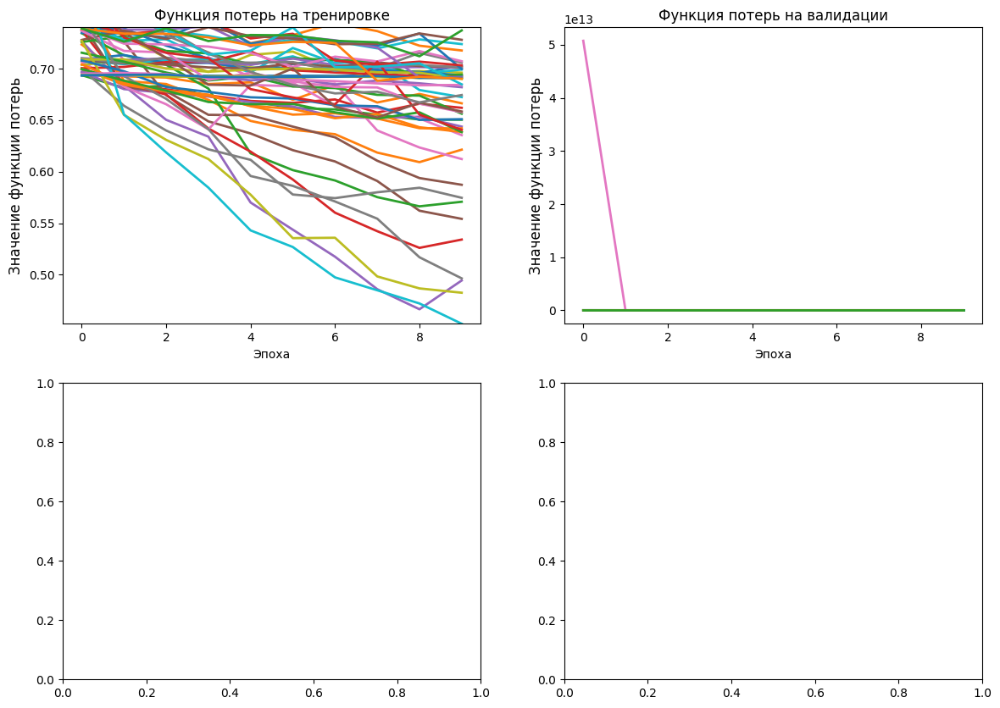

In [202]:
graduate_pipeline.graduate()

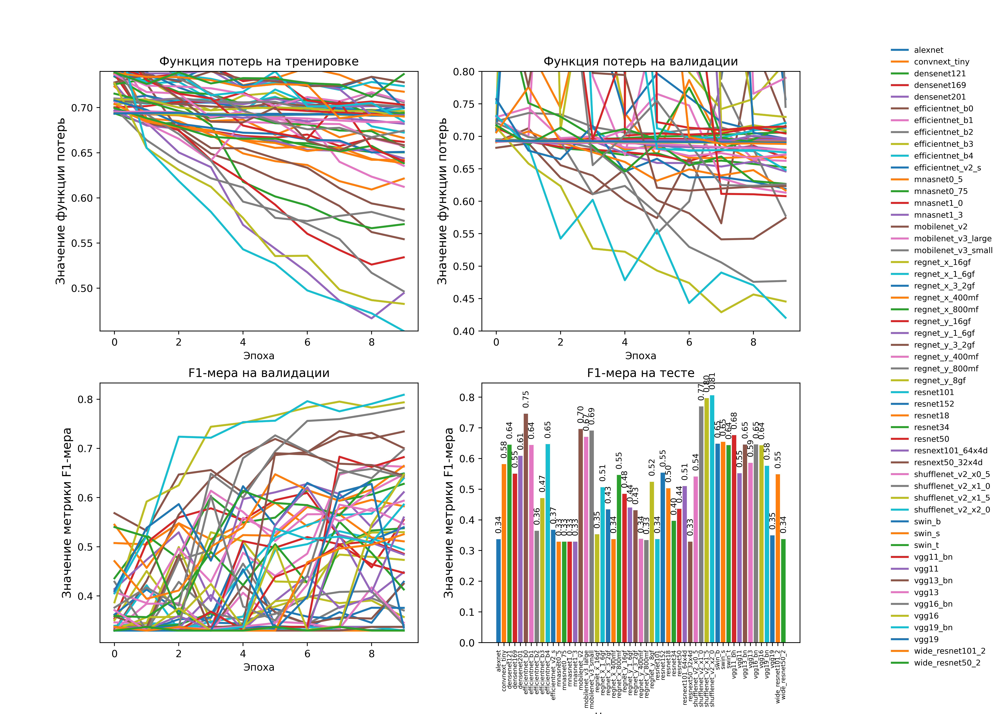

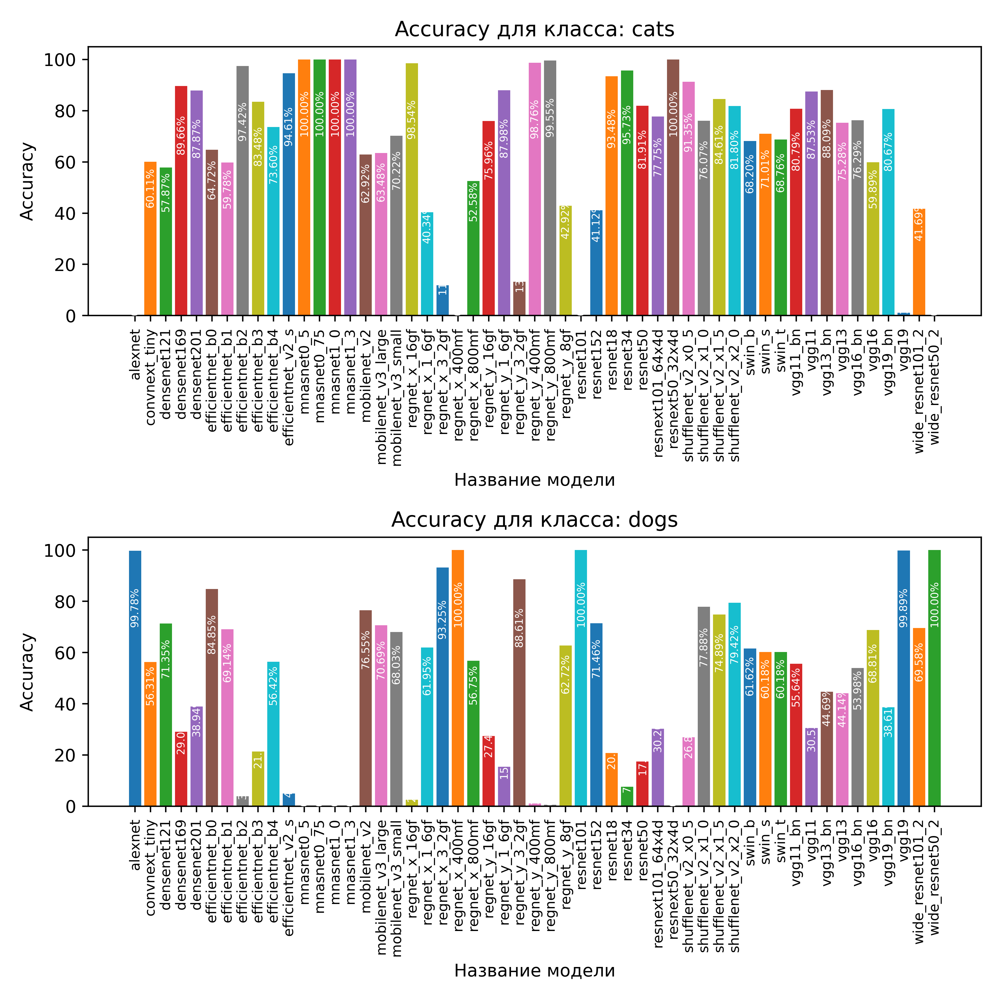

In [221]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_Exp3.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_Exp3.png"))

## Exp4 / Диcбаланс классов + focal_loss + class_weights

In [222]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "Exp4",
        "models": model_list,
        "name_optimizers": optimizer_list,
        "name_loss": "FocalLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 10,
        "class_percentage": {"cats": 0.3, "dogs": 1.0},
        "is_use_class_weights": True
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1872.98image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1863.21image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: alexnet
        Пользовательское название модели: alexnet_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.38sample/s]



Epoch 1/10, Training Loss: 0.7801671731014461, Validation Loss: 0.7797609333601375
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.73sample/s]



Epoch 2/10, Training Loss: 0.7797855815714234, Validation Loss: 0.7797391980381335
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.95sample/s]



Epoch 3/10, Training Loss: 0.7796317368970496, Validation Loss: 0.7797300046109884
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.87sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7798285931042402, Validation Loss: 0.7797202705326727
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.69sample/s]



Epoch 5/10, Training Loss: 0.7800075752102732, Validation Loss: 0.7797201799470826
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.09sample/s]



Epoch 6/10, Training Loss: 0.7797988199713788, Validation Loss: 0.7797203020187421
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.21sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.7798408128939074, Validation Loss: 0.7797196019167281
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.43sample/s]



Epoch 8/10, Training Loss: 0.779847922494266, Validation Loss: 0.7797195653794176
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 25.32sample/s]



Epoch 9/10, Training Loss: 0.7797744958632772, Validation Loss: 0.7797194529051161
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.76sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.7797051409771378, Validation Loss: 0.7797194049183258
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.70sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.66image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1856.37image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: convnext_tiny
        Пользовательское название модели: convnext_tiny_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.58sample/s]



Epoch 1/10, Training Loss: 0.9228719096832524, Validation Loss: 0.7965814787789253
Accuracy: 0.5677966101694916, Precision: 0.568242941534733, Recall: 0.5677966101694916, F1-score: 0.5664447091158956


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.03sample/s]



Epoch 2/10, Training Loss: 0.846862689733015, Validation Loss: 0.789280262707317
Accuracy: 0.5706214689265536, Precision: 0.5705968679124241, Recall: 0.5706214689265536, F1-score: 0.5704859964853951


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.58sample/s]



Epoch 3/10, Training Loss: 0.8285165374576433, Validation Loss: 0.7614365164506234
Accuracy: 0.5790960451977402, Precision: 0.5791800582540544, Recall: 0.5790960451977402, F1-score: 0.5790846253880898


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.88sample/s]



Epoch 4/10, Training Loss: 0.8168501593708747, Validation Loss: 0.7452808717886606
Accuracy: 0.5988700564971752, Precision: 0.5992223794388024, Recall: 0.5988700564971752, F1-score: 0.5987086823819728


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.98sample/s]



Epoch 5/10, Training Loss: 0.7879930176377051, Validation Loss: 0.7668869842243733
Accuracy: 0.5740112994350283, Precision: 0.5740162965938702, Recall: 0.5740112994350283, F1-score: 0.5737761657816995


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.60sample/s]



Epoch 6/10, Training Loss: 0.794936619101525, Validation Loss: 0.7785108616459842
Accuracy: 0.5649717514124294, Precision: 0.5653704312757756, Recall: 0.5649717514124294, F1-score: 0.5646827791781937


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.49sample/s]



Epoch 7/10, Training Loss: 0.7886794328771282, Validation Loss: 0.7385444617540823
Accuracy: 0.5954802259887005, Precision: 0.5982154759094003, Recall: 0.5954802259887005, F1-score: 0.5932920082014673


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.30sample/s]



Epoch 8/10, Training Loss: 0.7932455197354553, Validation Loss: 0.7320069529242434
Accuracy: 0.6067796610169491, Precision: 0.6068354433831382, Recall: 0.6067796610169491, F1-score: 0.6067796610169491


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.85sample/s]



Epoch 9/10, Training Loss: 0.7836749801454355, Validation Loss: 0.7639435400060341
Accuracy: 0.5700564971751413, Precision: 0.5714977361525703, Recall: 0.5700564971751413, F1-score: 0.5686011407629193


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.69sample/s]



Epoch 10/10, Training Loss: 0.7988857948837255, Validation Loss: 0.7398980423218786
Accuracy: 0.5926553672316384, Precision: 0.5943753736382174, Recall: 0.5926553672316384, F1-score: 0.5901309595215157
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.07sample/s]


Test Accuracy: 0.5964325529542921
Precision: 0.5992597970292122, Recall: 0.5964325529542921, F1-score: 0.5942765377207821
Accuracy of  cats : 67 %
Accuracy of  dogs : 52 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.17image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1833.69image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet121
        Пользовательское название модели: densenet121_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.13sample/s]



Epoch 1/10, Training Loss: 0.7730617888419901, Validation Loss: 0.7496111305420008
Accuracy: 0.5954802259887005, Precision: 0.601724253535256, Recall: 0.5954802259887005, F1-score: 0.5901509167575355


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.20sample/s]



Epoch 2/10, Training Loss: 0.7464611356474097, Validation Loss: 0.7224622917714092
Accuracy: 0.6463276836158192, Precision: 0.647217389428251, Recall: 0.6463276836158192, F1-score: 0.6459774458887585


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.97sample/s]



Epoch 3/10, Training Loss: 0.733722072296391, Validation Loss: 0.7101284487772797
Accuracy: 0.655367231638418, Precision: 0.6554667248279141, Recall: 0.655367231638418, F1-score: 0.6552285480142843


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.70sample/s]



Epoch 4/10, Training Loss: 0.7283825937242357, Validation Loss: 0.6986859617596965
Accuracy: 0.6615819209039548, Precision: 0.6730114302158144, Recall: 0.6615819209039548, F1-score: 0.6552951060985371


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.68sample/s]



Epoch 5/10, Training Loss: 0.7255005326027573, Validation Loss: 0.6938800159315605
Accuracy: 0.6700564971751413, Precision: 0.6844292525229821, Recall: 0.6700564971751413, F1-score: 0.6628906403285414


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.82sample/s]



Epoch 6/10, Training Loss: 0.7187755601180589, Validation Loss: 0.6930461039314162
Accuracy: 0.6610169491525424, Precision: 0.6899781531702894, Recall: 0.6610169491525424, F1-score: 0.6467094165652454


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.53sample/s]



Epoch 7/10, Training Loss: 0.7049831664668443, Validation Loss: 0.6762857912792324
Accuracy: 0.6853107344632768, Precision: 0.6919192449226862, Recall: 0.6853107344632768, F1-score: 0.6822057027393758


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.50sample/s]



Epoch 8/10, Training Loss: 0.7084274304248112, Validation Loss: 0.6824089755109475
Accuracy: 0.6700564971751413, Precision: 0.6986701954485387, Recall: 0.6700564971751413, F1-score: 0.6569333031203538


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.56sample/s]



Epoch 9/10, Training Loss: 0.691221164065816, Validation Loss: 0.6579191479305763
Accuracy: 0.6892655367231638, Precision: 0.6892655367231638, Recall: 0.6892655367231638, F1-score: 0.6892655367231638


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.97sample/s]



Epoch 10/10, Training Loss: 0.692688052093762, Validation Loss: 0.6483338030718141
Accuracy: 0.6988700564971752, Precision: 0.6988680034342563, Recall: 0.6988700564971752, F1-score: 0.6988688068880432
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.40sample/s]


Test Accuracy: 0.705685618729097
Precision: 0.7057531581496221, Recall: 0.705685618729097, F1-score: 0.7056878134453908
Accuracy of  cats : 71 %
Accuracy of  dogs : 70 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1815.84image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1845.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet169
        Пользовательское название модели: densenet169_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.41sample/s]



Epoch 1/10, Training Loss: 0.799696193973523, Validation Loss: 0.762102083634522
Accuracy: 0.5570621468926553, Precision: 0.5711804715778499, Recall: 0.5570621468926553, F1-score: 0.530860765682921


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.36sample/s]



Epoch 2/10, Training Loss: 0.7579416374869343, Validation Loss: 0.7459789317543224
Accuracy: 0.6016949152542372, Precision: 0.6029019946225798, Recall: 0.6016949152542372, F1-score: 0.6009046908114196


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.44sample/s]



Epoch 3/10, Training Loss: 0.7629806659170991, Validation Loss: 0.731297225096805
Accuracy: 0.6271186440677966, Precision: 0.6276405546054292, Recall: 0.6271186440677966, F1-score: 0.6265047309944534


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.45sample/s]



Epoch 4/10, Training Loss: 0.7412699135792754, Validation Loss: 0.7192691170563132
Accuracy: 0.631638418079096, Precision: 0.6319776946217623, Recall: 0.631638418079096, F1-score: 0.631218784959675


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.46sample/s]



Epoch 5/10, Training Loss: 0.7431505520185271, Validation Loss: 0.741195965621431
Accuracy: 0.5915254237288136, Precision: 0.6502106224430158, Recall: 0.5915254237288136, F1-score: 0.5450747144037553


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.64sample/s]



Epoch 6/10, Training Loss: 0.7369572667327133, Validation Loss: 0.7005003672198388
Accuracy: 0.6587570621468927, Precision: 0.6629365925546323, Recall: 0.6587570621468927, F1-score: 0.6561565302483436


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.62sample/s]



Epoch 7/10, Training Loss: 0.7185982333175771, Validation Loss: 0.6954427864928704
Accuracy: 0.6531073446327683, Precision: 0.6588464300768311, Recall: 0.6531073446327683, F1-score: 0.6503972457627119


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.65sample/s]



Epoch 8/10, Training Loss: 0.7163707253825101, Validation Loss: 0.6844359878766335
Accuracy: 0.6700564971751413, Precision: 0.6923892836181322, Recall: 0.6700564971751413, F1-score: 0.6594666177206957


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.27sample/s]



Epoch 9/10, Training Loss: 0.7133025520463935, Validation Loss: 0.6782011366159902
Accuracy: 0.6711864406779661, Precision: 0.6716375691069436, Recall: 0.6711864406779661, F1-score: 0.6710688616398843


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 11.27sample/s]



Epoch 10/10, Training Loss: 0.7265668775301588, Validation Loss: 0.6760563958162642
Accuracy: 0.6830508474576271, Precision: 0.6863578533720507, Recall: 0.6830508474576271, F1-score: 0.6818924454861383
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:06<00:00, 10.86sample/s]


Test Accuracy: 0.6800445930880713
Precision: 0.6822084965961501, Recall: 0.6800445930880713, F1-score: 0.6788192917774122
Accuracy of  cats : 61 %
Accuracy of  dogs : 74 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1845.06image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1743.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: densenet201
        Пользовательское название модели: densenet201_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.01sample/s]



Epoch 1/10, Training Loss: 0.7984904138048353, Validation Loss: 0.7717779740101873
Accuracy: 0.5525423728813559, Precision: 0.595931382236653, Recall: 0.5525423728813559, F1-score: 0.4992681550261885


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.10sample/s]



Epoch 2/10, Training Loss: 0.7760636770741591, Validation Loss: 0.7551147890629741
Accuracy: 0.5621468926553672, Precision: 0.6341697624738056, Recall: 0.5621468926553672, F1-score: 0.49098220813500626


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00,  9.90sample/s]



Epoch 3/10, Training Loss: 0.749527522580439, Validation Loss: 0.7299871431232172
Accuracy: 0.6062146892655367, Precision: 0.6210586038494685, Recall: 0.6062146892655367, F1-score: 0.594981257673242


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.16sample/s]



Epoch 4/10, Training Loss: 0.7422617619947834, Validation Loss: 0.7112896854931352
Accuracy: 0.6451977401129944, Precision: 0.6515439334948725, Recall: 0.6451977401129944, F1-score: 0.6408844532392669


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.14sample/s]



Epoch 5/10, Training Loss: 0.7356096765535837, Validation Loss: 0.7041709450005138
Accuracy: 0.6666666666666666, Precision: 0.6671515151515153, Recall: 0.6666666666666666, F1-score: 0.6662869373101353


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.11sample/s]



Epoch 6/10, Training Loss: 0.7240406920069943, Validation Loss: 0.6905851892832309
Accuracy: 0.6638418079096046, Precision: 0.6688683086124887, Recall: 0.6638418079096046, F1-score: 0.6616999923680041


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.15sample/s]



Epoch 7/10, Training Loss: 0.7185218633242549, Validation Loss: 0.6833903468766455
Accuracy: 0.692090395480226, Precision: 0.6954652704728536, Recall: 0.692090395480226, F1-score: 0.6904997522571709


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.26sample/s]



Epoch 8/10, Training Loss: 0.720265725547112, Validation Loss: 0.6768892267666294
Accuracy: 0.6932203389830508, Precision: 0.7004947940264066, Recall: 0.6932203389830508, F1-score: 0.6900517320620774


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:07<00:00, 10.04sample/s]



Epoch 9/10, Training Loss: 0.7146959704761231, Validation Loss: 0.6722396009385923
Accuracy: 0.6875706214689266, Precision: 0.6885527176187487, Recall: 0.6875706214689266, F1-score: 0.6870120870948199


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:06<00:00, 10.20sample/s]



Epoch 10/10, Training Loss: 0.7067124310668974, Validation Loss: 0.6778177698958392
Accuracy: 0.655367231638418, Precision: 0.6858782711614057, Recall: 0.655367231638418, F1-score: 0.64153272056126
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:07<00:00,  9.95sample/s]


Test Accuracy: 0.6677814938684504
Precision: 0.6942175041242894, Recall: 0.6677814938684504, F1-score: 0.6551620804435377
Accuracy of  cats : 47 %
Accuracy of  dogs : 85 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1863.34image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1877.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b0
        Пользовательское название модели: efficientnet_b0_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.20sample/s]



Epoch 1/10, Training Loss: 0.9143156784294892, Validation Loss: 0.7975543904102455
Accuracy: 0.503954802259887, Precision: 0.5082570534851474, Recall: 0.503954802259887, F1-score: 0.3564640598080325


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.05sample/s]



Epoch 2/10, Training Loss: 0.7835251204439677, Validation Loss: 0.760985804142925
Accuracy: 0.6062146892655367, Precision: 0.6088340530955715, Recall: 0.6062146892655367, F1-score: 0.6043711528512382


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.24sample/s]



Epoch 3/10, Training Loss: 0.7897805637942348, Validation Loss: 0.7507124558343725
Accuracy: 0.603954802259887, Precision: 0.6441978420863753, Recall: 0.603954802259887, F1-score: 0.5759887027814551


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.83sample/s]



Epoch 4/10, Training Loss: 0.7869535770581306, Validation Loss: 0.7205252795569641
Accuracy: 0.6237288135593221, Precision: 0.6297232134932963, Recall: 0.6237288135593221, F1-score: 0.6199782238336536


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]



Epoch 5/10, Training Loss: 0.7588665019656959, Validation Loss: 1.1038722998678347
Accuracy: 0.632768361581921, Precision: 0.6338013128132151, Recall: 0.632768361581921, F1-score: 0.6322919457643756


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.06sample/s]



Epoch 6/10, Training Loss: 0.7738499239424143, Validation Loss: 1.0649092948369387
Accuracy: 0.6084745762711864, Precision: 0.6111050837821038, Recall: 0.6084745762711864, F1-score: 0.605529838280843


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.96sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.7632751735086879, Validation Loss: 0.7781061339849806
Accuracy: 0.655367231638418, Precision: 0.6698431071477785, Recall: 0.655367231638418, F1-score: 0.6471521222487912


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.22sample/s]



Epoch 8/10, Training Loss: 0.7190776439543208, Validation Loss: 0.6784260901017377
Accuracy: 0.7028248587570621, Precision: 0.7149461044281845, Recall: 0.7028248587570621, F1-score: 0.6981611990117058


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.24sample/s]



Epoch 9/10, Training Loss: 0.6990015333527323, Validation Loss: 0.6498478231793743
Accuracy: 0.715819209039548, Precision: 0.7186734851638852, Recall: 0.715819209039548, F1-score: 0.7146999641353242


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.78sample/s]



Epoch 10/10, Training Loss: 0.6995274097217609, Validation Loss: 0.6494959087695106
Accuracy: 0.7305084745762712, Precision: 0.7418836854755112, Recall: 0.7305084745762712, F1-score: 0.7269881361016866
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.87sample/s]


Test Accuracy: 0.717948717948718
Precision: 0.7275228944821551, Recall: 0.717948717948718, F1-score: 0.7153075367361081
Accuracy of  cats : 81 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1681.54image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1839.25image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b1
        Пользовательское название модели: efficientnet_b1_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.67sample/s]



Epoch 1/10, Training Loss: 0.9062403456612431, Validation Loss: 0.7905057390867654
Accuracy: 0.5016949152542373, Precision: 0.6738263559655956, Recall: 0.5016949152542373, F1-score: 0.3426960992618048


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.52sample/s]



Epoch 2/10, Training Loss: 0.8152887195532579, Validation Loss: 0.8344274430961932
Accuracy: 0.5045197740112994, Precision: 0.5516631355932203, Recall: 0.5045197740112994, F1-score: 0.3435625315103423


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.65sample/s]



Epoch 3/10, Training Loss: 0.8399524989807908, Validation Loss: 0.8695599165676677
Accuracy: 0.5028248587570622, Precision: 0.4980290322957972, Recall: 0.5028248587570622, F1-score: 0.36810770220982625


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.78sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8186440260505088, Validation Loss: 0.8832091963560568
Accuracy: 0.5045197740112994, Precision: 0.5521113217339756, Recall: 0.5045197740112994, F1-score: 0.3709093307759471


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.47sample/s]



Epoch 5/10, Training Loss: 0.7982244828819329, Validation Loss: 0.779959964886897
Accuracy: 0.5169491525423728, Precision: 0.6088994520058011, Recall: 0.5169491525423728, F1-score: 0.3938035959074289


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.69sample/s]



Epoch 6/10, Training Loss: 0.7872626763692533, Validation Loss: 0.7847204974478921
Accuracy: 0.5101694915254237, Precision: 0.6225459203783996, Recall: 0.5101694915254237, F1-score: 0.37053250927528936


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.53sample/s]



Epoch 7/10, Training Loss: 0.7891809960764675, Validation Loss: 0.7783689131844516
Accuracy: 0.5288135593220339, Precision: 0.5553777146331507, Recall: 0.5288135593220339, F1-score: 0.4572361867701655


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.40sample/s]



Epoch 8/10, Training Loss: 0.7868669949997934, Validation Loss: 0.774340138260254
Accuracy: 0.5169491525423728, Precision: 0.5559876061886978, Recall: 0.5169491525423728, F1-score: 0.4048724149881879


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.75sample/s]



Epoch 9/10, Training Loss: 0.7748404509037468, Validation Loss: 0.8061753696641006
Accuracy: 0.5954802259887005, Precision: 0.6015341020176725, Recall: 0.5954802259887005, F1-score: 0.5882824495005861


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.71sample/s]



Epoch 10/10, Training Loss: 0.7830105846143897, Validation Loss: 0.7697037845681616
Accuracy: 0.6056497175141243, Precision: 0.6131409055734706, Recall: 0.6056497175141243, F1-score: 0.5980077679935701
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.67sample/s]


Test Accuracy: 0.612597547380156
Precision: 0.62465946600979, Recall: 0.612597547380156, F1-score: 0.6041705230444578
Accuracy of  cats : 76 %
Accuracy of  dogs : 46 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.62image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1829.67image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b2
        Пользовательское название модели: efficientnet_b2_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.90sample/s]



Epoch 1/10, Training Loss: 0.9243827693424786, Validation Loss: 1.1374340838631667
Accuracy: 0.5016949152542373, Precision: 0.48546545444118616, Recall: 0.5016949152542373, F1-score: 0.3571361194739346


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.77sample/s]



Epoch 2/10, Training Loss: 0.8551657555281421, Validation Loss: 0.7964797573911269
Accuracy: 0.5033898305084745, Precision: 0.5017239377757139, Recall: 0.5033898305084745, F1-score: 0.3459395648654354


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.84sample/s]



Epoch 3/10, Training Loss: 0.821446811707564, Validation Loss: 0.7718756963304207
Accuracy: 0.5305084745762711, Precision: 0.60938659510521, Recall: 0.5305084745762711, F1-score: 0.4323778170498819


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.81sample/s]



Epoch 4/10, Training Loss: 0.8240683583914212, Validation Loss: 0.7999730192672061
Accuracy: 0.5146892655367231, Precision: 0.5903270208709996, Recall: 0.5146892655367231, F1-score: 0.37860926666656886


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.73sample/s]



Epoch 5/10, Training Loss: 0.8441560307416792, Validation Loss: 1.3076047030209148
Accuracy: 0.48135593220338985, Precision: 0.4612111619260477, Recall: 0.48135593220338985, F1-score: 0.41334146888598877


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.86sample/s]



Epoch 6/10, Training Loss: 0.824655080572884, Validation Loss: 0.761694035119256
Accuracy: 0.5932203389830508, Precision: 0.6163522503005109, Recall: 0.5932203389830508, F1-score: 0.5701228321721673


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.81sample/s]



Epoch 7/10, Training Loss: 0.7943830748303775, Validation Loss: 0.7980292739167725
Accuracy: 0.631638418079096, Precision: 0.6488842763311794, Recall: 0.631638418079096, F1-score: 0.6196583100064597


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.81sample/s]



Epoch 8/10, Training Loss: 0.7767759533554336, Validation Loss: 0.7060757516804388
Accuracy: 0.6497175141242938, Precision: 0.6554826533388765, Recall: 0.6497175141242938, F1-score: 0.6469096637675792


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.63sample/s]



Epoch 9/10, Training Loss: 0.7578334354471883, Validation Loss: 0.725034347361764
Accuracy: 0.6649717514124294, Precision: 0.7010896303216334, Recall: 0.6649717514124294, F1-score: 0.6483116223562241


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.89sample/s]



Epoch 10/10, Training Loss: 0.7434037713828031, Validation Loss: 1.0035038665357956
Accuracy: 0.635593220338983, Precision: 0.6595620609261685, Recall: 0.635593220338983, F1-score: 0.6203026165737826
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.91sample/s]


Test Accuracy: 0.6415830546265329
Precision: 0.6682835139886615, Recall: 0.6415830546265329, F1-score: 0.6279283424545168
Accuracy of  cats : 83 %
Accuracy of  dogs : 45 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1887.21image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1881.70image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b3
        Пользовательское название модели: efficientnet_b3_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.82sample/s]



Epoch 1/10, Training Loss: 0.9182629471286018, Validation Loss: 0.7816628578019007
Accuracy: 0.503954802259887, Precision: 0.53732810158779, Recall: 0.503954802259887, F1-score: 0.341341765935156


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.02sample/s]



Epoch 2/10, Training Loss: 0.9125154902667032, Validation Loss: 6.073355712291211
Accuracy: 0.5056497175141242, Precision: 0.5151136878507957, Recall: 0.5056497175141242, F1-score: 0.375416579732983


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.95sample/s]



Epoch 3/10, Training Loss: 0.8630570017409047, Validation Loss: 0.7886546122825752
Accuracy: 0.5033898305084745, Precision: 0.5017083365288748, Recall: 0.5033898305084745, F1-score: 0.3381089121383465


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.05sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8125835265338707, Validation Loss: 0.8096701800823212
Accuracy: 0.5, Precision: 0.45948673587081895, Recall: 0.5, F1-score: 0.34995784543325525


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.67sample/s]



Epoch 5/10, Training Loss: 0.7844477723607305, Validation Loss: 0.7993910290763877
Accuracy: 0.5045197740112994, Precision: 0.5158268658078053, Recall: 0.5045197740112994, F1-score: 0.355833932706175


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.00sample/s]



Epoch 6/10, Training Loss: 0.7828272430965392, Validation Loss: 0.8071145299127547
Accuracy: 0.507909604519774, Precision: 0.5371893383658243, Recall: 0.507909604519774, F1-score: 0.3699286045012591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.03sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.7661886029736974, Validation Loss: 0.7945576882631765
Accuracy: 0.5610169491525424, Precision: 0.59667469183359, Recall: 0.5610169491525424, F1-score: 0.513042015393027


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.01sample/s]



Epoch 8/10, Training Loss: 0.7731052535376048, Validation Loss: 0.7743802543750591
Accuracy: 0.5700564971751413, Precision: 0.5984897012850551, Recall: 0.5700564971751413, F1-score: 0.5338271214404233


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.07sample/s]



Epoch 9/10, Training Loss: 0.7770605499079327, Validation Loss: 0.7836107601553707
Accuracy: 0.5480225988700564, Precision: 0.6043386405439273, Recall: 0.5480225988700564, F1-score: 0.4732604235243857


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.97sample/s]



Epoch 10/10, Training Loss: 0.7750931748018598, Validation Loss: 0.7683082999145917
Accuracy: 0.5570621468926553, Precision: 0.6026109393130546, Recall: 0.5570621468926553, F1-score: 0.4980970315627208
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.34sample/s]


Test Accuracy: 0.5652173913043478
Precision: 0.6296003347637373, Recall: 0.5652173913043478, F1-score: 0.5070739914478611
Accuracy of  cats : 91 %
Accuracy of  dogs : 22 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.21image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.71image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_b4
        Пользовательское название модели: efficientnet_b4_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.79sample/s]



Epoch 1/10, Training Loss: 0.9780655880346946, Validation Loss: 1.6611128799659385
Accuracy: 0.5033898305084745, Precision: 0.5017519367651108, Recall: 0.5033898305084745, F1-score: 0.35887783664664114


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.83sample/s]



Epoch 2/10, Training Loss: 0.9048073427819323, Validation Loss: 2.157119084044365
Accuracy: 0.5112994350282486, Precision: 0.5452655970404328, Recall: 0.5112994350282486, F1-score: 0.38495887466496553


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.02sample/s]



Epoch 3/10, Training Loss: 0.8613026292459698, Validation Loss: 2.6856072521479115
Accuracy: 0.5231638418079096, Precision: 0.5716106590185271, Recall: 0.5231638418079096, F1-score: 0.41845276876973314


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.79sample/s]



Epoch 4/10, Training Loss: 0.8779511874754843, Validation Loss: 0.814086088184583
Accuracy: 0.5067796610169492, Precision: 0.5120139650148504, Recall: 0.5067796610169492, F1-score: 0.4076803407339588


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.93sample/s]



Epoch 5/10, Training Loss: 0.8643351580648899, Validation Loss: 0.8107300749269583
Accuracy: 0.5067796610169492, Precision: 0.5292473533724548, Recall: 0.5067796610169492, F1-score: 0.3676217343432971


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.98sample/s]



Epoch 6/10, Training Loss: 0.8452833848019182, Validation Loss: 1.6489306553608953
Accuracy: 0.5265536723163842, Precision: 0.5264645858709242, Recall: 0.5265536723163842, F1-score: 0.5262663135051783


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.93sample/s]



Epoch 7/10, Training Loss: 0.845060050630504, Validation Loss: 0.7840717507284239
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.71sample/s]



Epoch 8/10, Training Loss: 0.8210307889764157, Validation Loss: 0.786914057987558
Accuracy: 0.5073446327683616, Precision: 0.5322549009896086, Recall: 0.5073446327683616, F1-score: 0.3696331144266755


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.94sample/s]



Epoch 9/10, Training Loss: 0.8237938265060218, Validation Loss: 0.784946678216848
Accuracy: 0.4977401129943503, Precision: 0.4949863304212819, Recall: 0.4977401129943503, F1-score: 0.4669636173032874


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.70sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.8233976532858965, Validation Loss: 0.788033319226766
Accuracy: 0.48983050847457626, Precision: 0.4425885246411124, Recall: 0.48983050847457626, F1-score: 0.34705678072501056
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.75sample/s]


Test Accuracy: 0.5022296544035675
Precision: 0.48427703937916505, Recall: 0.5022296544035675, F1-score: 0.3556851917435482
Accuracy of  cats :  2 %
Accuracy of  dogs : 97 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.13image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.72image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: efficientnet_v2_s
        Пользовательское название модели: efficientnet_v2_s_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.74sample/s]



Epoch 1/10, Training Loss: 0.8797583227250738, Validation Loss: 1.0847187304900865
Accuracy: 0.4943502824858757, Precision: 0.463920619667793, Recall: 0.4943502824858757, F1-score: 0.3747481011169264


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.62sample/s]



Epoch 2/10, Training Loss: 0.841824402847545, Validation Loss: 0.7837987823338158
Accuracy: 0.5163841807909605, Precision: 0.5739463190974189, Recall: 0.5163841807909605, F1-score: 0.4074616921911058


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.90sample/s]



Epoch 3/10, Training Loss: 0.8260153886020143, Validation Loss: 1.0617158771571467
Accuracy: 0.4937853107344633, Precision: 0.4471414867517265, Recall: 0.4937853107344633, F1-score: 0.36167652082512153


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.88sample/s]



Epoch 4/10, Training Loss: 0.8514501057600958, Validation Loss: 0.8286539550218205
Accuracy: 0.49548022598870056, Precision: 0.4328556218154884, Recall: 0.49548022598870056, F1-score: 0.3513610060378232


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.74sample/s]



Epoch 5/10, Training Loss: 0.8237298134257321, Validation Loss: 0.7831953322820071
Accuracy: 0.503954802259887, Precision: 0.5515148605175973, Recall: 0.503954802259887, F1-score: 0.3403537591581141


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.91sample/s]



Epoch 6/10, Training Loss: 0.8417968249345495, Validation Loss: 0.9637161070680887
Accuracy: 0.4847457627118644, Precision: 0.46125378391147337, Recall: 0.4847457627118644, F1-score: 0.3801905935972729


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 14.04sample/s]



Epoch 7/10, Training Loss: 0.8167425107473866, Validation Loss: 0.9997593038162943
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.88sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.8118155570043285, Validation Loss: 0.7926080346444232
Accuracy: 0.5203389830508475, Precision: 0.5452877961777494, Recall: 0.5203389830508475, F1-score: 0.45270133352076153


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.84sample/s]



Epoch 9/10, Training Loss: 0.7858888750373705, Validation Loss: 0.780321408631438
Accuracy: 0.5225988700564972, Precision: 0.5307560307406344, Recall: 0.5225988700564972, F1-score: 0.49599685130364496


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.85sample/s]



Epoch 10/10, Training Loss: 0.7844128092320672, Validation Loss: 0.7801664367233966
Accuracy: 0.5361581920903955, Precision: 0.5579048818794582, Recall: 0.5361581920903955, F1-score: 0.49335600267006663
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.42sample/s]


Test Accuracy: 0.5406911928651059
Precision: 0.5569285201064226, Recall: 0.5406911928651059, F1-score: 0.4996966686010422
Accuracy of  cats : 25 %
Accuracy of  dogs : 82 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.30image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.50image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_5
        Пользовательское название модели: mnasnet0_5_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.71sample/s]



Epoch 1/10, Training Loss: 0.9077123717096589, Validation Loss: 0.7803136926923094
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.42sample/s]



Epoch 2/10, Training Loss: 0.8348892591153211, Validation Loss: 0.7803333101973022
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.41sample/s]



Epoch 3/10, Training Loss: 0.8486660463381827, Validation Loss: 0.7818902670326879
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.19sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8009098243680697, Validation Loss: 0.7821059550269175
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.41sample/s]



Epoch 5/10, Training Loss: 0.7590340712529654, Validation Loss: 0.7820689819626889
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.46sample/s]



Epoch 6/10, Training Loss: 0.7468715086017593, Validation Loss: 0.7825785383666303
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.42sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.739101299629218, Validation Loss: 0.7821286721418133
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.18sample/s]



Epoch 8/10, Training Loss: 0.7287895828791887, Validation Loss: 0.7823704141007979
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.89sample/s]



Epoch 9/10, Training Loss: 0.7314657138340108, Validation Loss: 0.7825948813204038
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.53sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.7377664586752551, Validation Loss: 0.7828767232302218
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.61sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1867.87image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.61image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet0_75
        Пользовательское название модели: mnasnet0_75_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.05sample/s]



Epoch 1/10, Training Loss: 0.9333866514148085, Validation Loss: 0.7797584402359138
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.96sample/s]



Epoch 2/10, Training Loss: 0.8451152845063056, Validation Loss: 0.7798207127778544
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.04sample/s]



Epoch 3/10, Training Loss: 0.8002920171796173, Validation Loss: 0.7797585777980459
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.21sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8021445635902792, Validation Loss: 0.7803836163491179
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.17sample/s]



Epoch 5/10, Training Loss: 0.7549560332110354, Validation Loss: 0.7812336993082768
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.31sample/s]



Epoch 6/10, Training Loss: 0.7463640149241036, Validation Loss: 0.7814582567767235
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.07sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.7326545507798381, Validation Loss: 0.781089225731327
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.01sample/s]



Epoch 8/10, Training Loss: 0.7211707280750876, Validation Loss: 0.7821263546324045
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.05sample/s]



Epoch 9/10, Training Loss: 0.7233144078784156, Validation Loss: 0.7830410598024811
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.00sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.7205206442769869, Validation Loss: 0.7836008124095571
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.64sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.49image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1833.27image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_0
        Пользовательское название модели: mnasnet1_0_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.59sample/s]



Epoch 1/10, Training Loss: 0.876587830335821, Validation Loss: 0.7798474454610361
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 2/10, Training Loss: 0.8201867670045477, Validation Loss: 0.7798966024555055
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.20sample/s]



Epoch 3/10, Training Loss: 0.7937356396804859, Validation Loss: 0.7809168019537198
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.36sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7768963944675009, Validation Loss: 0.782093447480498
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.37sample/s]



Epoch 5/10, Training Loss: 0.714381155737301, Validation Loss: 0.7798011269273057
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 6/10, Training Loss: 0.7071053634529819, Validation Loss: 0.7799138755111371
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.78sample/s]



Epoch 7/10, Training Loss: 0.6937726785296688, Validation Loss: 0.7797599648688472
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.51sample/s]



Epoch 8/10, Training Loss: 0.6904483285768952, Validation Loss: 0.7797584205360736
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.31sample/s]



Epoch 9/10, Training Loss: 0.6724738966242102, Validation Loss: 0.7800085670867208
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.06sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-05.

Epoch 10/10, Training Loss: 0.6552127431095096, Validation Loss: 0.779878698331488
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.24sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1800.26image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.74image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mnasnet1_3
        Пользовательское название модели: mnasnet1_3_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 1/10, Training Loss: 0.8835095853083259, Validation Loss: 0.7804842678840551
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.06sample/s]



Epoch 2/10, Training Loss: 0.8265827975508446, Validation Loss: 0.7892906515948517
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.21sample/s]



Epoch 3/10, Training Loss: 0.7919351874638126, Validation Loss: 0.7809129195698237
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.46sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.7629028297884158, Validation Loss: 0.7861360343499372
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.29sample/s]



Epoch 5/10, Training Loss: 0.7013617556253633, Validation Loss: 0.7851417620303267
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 6/10, Training Loss: 0.7024444350442959, Validation Loss: 0.7863762316393987
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.13sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-05.

Epoch 7/10, Training Loss: 0.664923411769112, Validation Loss: 0.7894675511088075
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 8/10, Training Loss: 0.6662241308206234, Validation Loss: 0.7880828434464622
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 9/10, Training Loss: 0.6492712734046253, Validation Loss: 0.7881960784648098
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.33sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-06.

Epoch 10/10, Training Loss: 0.63009977055748, Validation Loss: 0.7887014724777244
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.14sample/s]


Test Accuracy: 0.496098104793757
Precision: 0.2461133295799575, Recall: 0.496098104793757, F1-score: 0.32900693984086715
Accuracy of  cats : 100 %
Accuracy of  dogs :  0 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1861.18image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1869.41image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v2
        Пользовательское название модели: mobilenet_v2_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.26sample/s]



Epoch 1/10, Training Loss: 0.9188247506057996, Validation Loss: 0.7973849938414191
Accuracy: 0.5372881355932203, Precision: 0.5419719298949819, Recall: 0.5372881355932203, F1-score: 0.5271794295658142


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 2/10, Training Loss: 0.8508754801962619, Validation Loss: 0.7606097288050894
Accuracy: 0.559322033898305, Precision: 0.5646129734090743, Recall: 0.559322033898305, F1-score: 0.548003741196518


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 3/10, Training Loss: 0.8111040358309717, Validation Loss: 0.7386683358647729
Accuracy: 0.5949152542372881, Precision: 0.6052848778473279, Recall: 0.5949152542372881, F1-score: 0.5859252546723599


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.29sample/s]



Epoch 4/10, Training Loss: 0.7781362592397773, Validation Loss: 0.716819156361165
Accuracy: 0.6440677966101694, Precision: 0.6486173921107614, Recall: 0.6440677966101694, F1-score: 0.6408340767172168


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 5/10, Training Loss: 0.7602416809860201, Validation Loss: 0.6914804288222964
Accuracy: 0.6632768361581921, Precision: 0.6717289566726821, Recall: 0.6632768361581921, F1-score: 0.658561779935093


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.89sample/s]



Epoch 6/10, Training Loss: 0.7662835067841515, Validation Loss: 0.7118956308580388
Accuracy: 0.688135593220339, Precision: 0.6884236631305013, Recall: 0.688135593220339, F1-score: 0.688081833381899


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.26sample/s]



Epoch 7/10, Training Loss: 0.759431854043618, Validation Loss: 0.7331884312259276
Accuracy: 0.5141242937853108, Precision: 0.6142341749747056, Recall: 0.5141242937853108, F1-score: 0.3714233809263255


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.83sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.7300360815891915, Validation Loss: 0.8777326441417306
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.37sample/s]



Epoch 9/10, Training Loss: 0.7064430647880104, Validation Loss: 0.6366559645045275
Accuracy: 0.7141242937853107, Precision: 0.7206546415120599, Recall: 0.7141242937853107, F1-score: 0.7117110852867509


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.36sample/s]



Epoch 10/10, Training Loss: 0.6635710677927369, Validation Loss: 0.6046775754562206
Accuracy: 0.7333333333333333, Precision: 0.7333426993916745, Recall: 0.7333333333333333, F1-score: 0.7333146044458974
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.43sample/s]


Test Accuracy: 0.7363433667781494
Precision: 0.7363878037137912, Recall: 0.7363433667781494, F1-score: 0.7363470532397279
Accuracy of  cats : 73 %
Accuracy of  dogs : 73 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1849.98image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1810.03image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_large
        Пользовательское название модели: mobilenet_v3_large_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.43sample/s]



Epoch 1/10, Training Loss: 0.8458104862220652, Validation Loss: 0.7879905148414569
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.52sample/s]



Epoch 2/10, Training Loss: 0.786070786411424, Validation Loss: 0.7827675244902487
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.38sample/s]



Epoch 3/10, Training Loss: 0.7889468109795621, Validation Loss: 0.7811159533632677
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.04sample/s]



Epoch 4/10, Training Loss: 0.7873870264062169, Validation Loss: 0.7798350392761877
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.67sample/s]



Epoch 5/10, Training Loss: 0.7854235609603958, Validation Loss: 0.7888698367412481
Accuracy: 0.4887005649717514, Precision: 0.44406497175141235, Recall: 0.4887005649717514, F1-score: 0.370831099644659


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.39sample/s]



Epoch 6/10, Training Loss: 0.7814208161471395, Validation Loss: 0.7695773632849677
Accuracy: 0.5875706214689266, Precision: 0.6168185036684333, Recall: 0.5875706214689266, F1-score: 0.5579236958749924


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.18sample/s]



Epoch 7/10, Training Loss: 0.7536915148505615, Validation Loss: 0.7550021910061271
Accuracy: 0.6344632768361582, Precision: 0.6388385438921332, Recall: 0.6344632768361582, F1-score: 0.6310213114579677


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.79sample/s]



Epoch 8/10, Training Loss: 0.7369251448132552, Validation Loss: 0.7301967209678585
Accuracy: 0.6107344632768361, Precision: 0.6139533165020258, Recall: 0.6107344632768361, F1-score: 0.6085297121033384


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 9/10, Training Loss: 0.7307344875039917, Validation Loss: 0.761792996256365
Accuracy: 0.615819209039548, Precision: 0.6389720768688422, Recall: 0.615819209039548, F1-score: 0.6003971311174701


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 10/10, Training Loss: 0.7288619588710741, Validation Loss: 0.7059009029703626
Accuracy: 0.6451977401129944, Precision: 0.6453262862680302, Recall: 0.6451977401129944, F1-score: 0.6451796196746497
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.74sample/s]


Test Accuracy: 0.6354515050167224
Precision: 0.6354415109164012, Recall: 0.6354515050167224, F1-score: 0.6354433488395481
Accuracy of  cats : 63 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.45image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1752.57image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: mobilenet_v3_small
        Пользовательское название модели: mobilenet_v3_small_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.03sample/s]



Epoch 1/10, Training Loss: 0.8017121222919598, Validation Loss: 0.7801743015057623
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.78sample/s]



Epoch 2/10, Training Loss: 0.760504745207395, Validation Loss: 0.7809639030930686
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.72sample/s]



Epoch 3/10, Training Loss: 0.7701325194936979, Validation Loss: 0.7801942954965904
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.40sample/s]



Epoch 4/10, Training Loss: 0.7548686255527899, Validation Loss: 0.7762775611405992
Accuracy: 0.5480225988700564, Precision: 0.5663186440677966, Recall: 0.5480225988700564, F1-score: 0.5104376100638354


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.00sample/s]



Epoch 5/10, Training Loss: 0.7557353644112841, Validation Loss: 0.7811131777062927
Accuracy: 0.4971751412429379, Precision: 0.48339983923148955, Recall: 0.4971751412429379, F1-score: 0.39648174507594625


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.49sample/s]



Epoch 6/10, Training Loss: 0.7510778591435114, Validation Loss: 0.7975448777446639
Accuracy: 0.63954802259887, Precision: 0.6442963758028853, Recall: 0.63954802259887, F1-score: 0.6360324387263947


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.10sample/s]



Epoch 7/10, Training Loss: 0.7322223633425623, Validation Loss: 0.7115084938915436
Accuracy: 0.6163841807909605, Precision: 0.6204911225343331, Recall: 0.6163841807909605, F1-score: 0.6124219632967781


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 8/10, Training Loss: 0.7171346404276293, Validation Loss: 0.7330422993265303
Accuracy: 0.5994350282485875, Precision: 0.6003005629487329, Recall: 0.5994350282485875, F1-score: 0.598130589083003


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.37sample/s]



Epoch 9/10, Training Loss: 0.7086887422839283, Validation Loss: 0.6810945633609417
Accuracy: 0.7096045197740113, Precision: 0.7112377077111617, Recall: 0.7096045197740113, F1-score: 0.7088880272944776


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.25sample/s]



Epoch 10/10, Training Loss: 0.7365699774030956, Validation Loss: 1.3879288536007122
Accuracy: 0.5084745762711864, Precision: 0.5084523693340899, Recall: 0.5084745762711864, F1-score: 0.5084576302351564
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.85sample/s]


Test Accuracy: 0.49498327759197325
Precision: 0.49496560083882596, Recall: 0.49498327759197325, F1-score: 0.4949719786676309
Accuracy of  cats : 48 %
Accuracy of  dogs : 50 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1832.02image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.81image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_16gf
        Пользовательское название модели: regnet_x_16gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.81sample/s]



Epoch 1/10, Training Loss: 0.8434193231129663, Validation Loss: 0.8601255283012228
Accuracy: 0.5248587570621469, Precision: 0.5368213706581607, Recall: 0.5248587570621469, F1-score: 0.4900308939289119


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.57sample/s]



Epoch 2/10, Training Loss: 0.8450245103295165, Validation Loss: 0.8655756629456235
Accuracy: 0.5282485875706214, Precision: 0.5610610293661141, Recall: 0.5282485875706214, F1-score: 0.4477264588102654


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.72sample/s]



Epoch 3/10, Training Loss: 0.8255017541752359, Validation Loss: 0.9054771819188769
Accuracy: 0.5186440677966102, Precision: 0.5416809479395913, Recall: 0.5186440677966102, F1-score: 0.4303294055871004


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.75sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8274139176295832, Validation Loss: 0.923819213853044
Accuracy: 0.5050847457627119, Precision: 0.5278552703710256, Recall: 0.5050847457627119, F1-score: 0.3533499103669136


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.78sample/s]



Epoch 5/10, Training Loss: 0.7889413185892569, Validation Loss: 0.77705662701763
Accuracy: 0.5553672316384181, Precision: 0.5596035266440869, Recall: 0.5553672316384181, F1-score: 0.5490904086392434


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.64sample/s]



Epoch 6/10, Training Loss: 0.7854753334772269, Validation Loss: 0.773031828935537
Accuracy: 0.5570621468926553, Precision: 0.5668391275928214, Recall: 0.5570621468926553, F1-score: 0.5426923518006092


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.59sample/s]



Epoch 7/10, Training Loss: 0.784509492806983, Validation Loss: 0.7751436487766309
Accuracy: 0.53954802259887, Precision: 0.5420792325182052, Recall: 0.53954802259887, F1-score: 0.5346908481187056


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.57sample/s]



Epoch 8/10, Training Loss: 0.7894177086513446, Validation Loss: 0.7638049975963636
Accuracy: 0.5598870056497175, Precision: 0.5639994205199749, Recall: 0.5598870056497175, F1-score: 0.5542619947484663


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.79sample/s]



Epoch 9/10, Training Loss: 0.7888665127786894, Validation Loss: 0.7664363550937782
Accuracy: 0.5440677966101695, Precision: 0.5450991238108335, Recall: 0.5440677966101695, F1-score: 0.5425842062464521


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.69sample/s]



Epoch 10/10, Training Loss: 0.7767929691129387, Validation Loss: 0.7678897244445348
Accuracy: 0.559322033898305, Precision: 0.5645209386039811, Recall: 0.559322033898305, F1-score: 0.5520300243700734
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.12sample/s]


Test Accuracy: 0.5652173913043478
Precision: 0.5686657980830044, Recall: 0.5652173913043478, F1-score: 0.5578863807777912
Accuracy of  cats : 43 %
Accuracy of  dogs : 69 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1620.27image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.41image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_1_6gf
        Пользовательское название модели: regnet_x_1_6gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.89sample/s]



Epoch 1/10, Training Loss: 0.881872154389284, Validation Loss: 0.9826265046488767
Accuracy: 0.4994350282485876, Precision: 0.4739975606678723, Recall: 0.4994350282485876, F1-score: 0.3620978167193335


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.67sample/s]



Epoch 2/10, Training Loss: 0.8502252476316678, Validation Loss: 0.9736544491544281
Accuracy: 0.47853107344632767, Precision: 0.47809877162968223, Recall: 0.47853107344632767, F1-score: 0.4711695643888459


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.08sample/s]



Epoch 3/10, Training Loss: 0.8555047968383355, Validation Loss: 0.8338446372983146
Accuracy: 0.5067796610169492, Precision: 0.5067923757776568, Recall: 0.5067796610169492, F1-score: 0.47344556474488514


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.11sample/s]



Epoch 4/10, Training Loss: 0.8420694444463872, Validation Loss: 0.9961910612333966
Accuracy: 0.5062146892655367, Precision: 0.5386148676875149, Recall: 0.5062146892655367, F1-score: 0.39063977741389677


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.23sample/s]



Epoch 5/10, Training Loss: 0.8230867851385113, Validation Loss: 0.8032778646312865
Accuracy: 0.5067796610169492, Precision: 0.5065346136044585, Recall: 0.5067796610169492, F1-score: 0.48278520629976934


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.10sample/s]



Epoch 6/10, Training Loss: 0.8337155184858543, Validation Loss: 0.844898744491534
Accuracy: 0.5305084745762711, Precision: 0.5395641646489104, Recall: 0.5305084745762711, F1-score: 0.49564181492085696


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.16sample/s]



Epoch 7/10, Training Loss: 0.8303162455150246, Validation Loss: 0.9955005293848824
Accuracy: 0.5062146892655367, Precision: 0.5075234692707514, Recall: 0.5062146892655367, F1-score: 0.4987618690161063


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.09sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.8301323733565087, Validation Loss: 0.8793731128933739
Accuracy: 0.5062146892655367, Precision: 0.5168127800506527, Recall: 0.5062146892655367, F1-score: 0.37976035264170854


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.20sample/s]



Epoch 9/10, Training Loss: 0.800136425035142, Validation Loss: 0.7795966663266306
Accuracy: 0.53954802259887, Precision: 0.5399038660663303, Recall: 0.53954802259887, F1-score: 0.5370159389732954


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.77sample/s]



Epoch 10/10, Training Loss: 0.7988136151296134, Validation Loss: 0.8037195660300174
Accuracy: 0.5372881355932203, Precision: 0.5372535694802385, Recall: 0.5372881355932203, F1-score: 0.5365890242073262
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.72sample/s]


Test Accuracy: 0.5362318840579711
Precision: 0.5370683684488614, Recall: 0.5362318840579711, F1-score: 0.5350430683057291
Accuracy of  cats : 58 %
Accuracy of  dogs : 48 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1816.88image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1811.12image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_3_2gf
        Пользовательское название модели: regnet_x_3_2gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.37sample/s]



Epoch 1/10, Training Loss: 0.8791294423907975, Validation Loss: 1.0415068957428475
Accuracy: 0.5175141242937853, Precision: 0.5197672091439143, Recall: 0.5175141242937853, F1-score: 0.493390122017632


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.95sample/s]



Epoch 2/10, Training Loss: 0.8766394730215615, Validation Loss: 0.8308049731672147
Accuracy: 0.4943502824858757, Precision: 0.4941330658935529, Recall: 0.4943502824858757, F1-score: 0.4938310468292336


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.80sample/s]



Epoch 3/10, Training Loss: 0.8463022693572917, Validation Loss: 0.829815050134551
Accuracy: 0.5265536723163842, Precision: 0.5287005520724988, Recall: 0.5265536723163842, F1-score: 0.5123460872837315


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.54sample/s]



Epoch 4/10, Training Loss: 0.8424269700597785, Validation Loss: 0.7951849343749763
Accuracy: 0.5384180790960452, Precision: 0.5383580879755127, Recall: 0.5384180790960452, F1-score: 0.5380397756918897


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.50sample/s]



Epoch 5/10, Training Loss: 0.8560467725792023, Validation Loss: 0.8241822486375011
Accuracy: 0.5214689265536723, Precision: 0.5451621835171477, Recall: 0.5214689265536723, F1-score: 0.457862788815923


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.61sample/s]



Epoch 6/10, Training Loss: 0.8355155157217675, Validation Loss: 0.8289444500443626
Accuracy: 0.5141242937853108, Precision: 0.5418969654696585, Recall: 0.5141242937853108, F1-score: 0.40461983759423575


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.52sample/s]



Epoch 7/10, Training Loss: 0.8432666647916301, Validation Loss: 0.7803758384480988
Accuracy: 0.523728813559322, Precision: 0.526742941785104, Recall: 0.523728813559322, F1-score: 0.514593731056034


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.66sample/s]



Epoch 8/10, Training Loss: 0.8373418165201026, Validation Loss: 0.784470148005728
Accuracy: 0.5536723163841808, Precision: 0.5562112198300331, Recall: 0.5536723163841808, F1-score: 0.5500025686613201


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.20sample/s]



Epoch 9/10, Training Loss: 0.8268777279922453, Validation Loss: 0.901202614024534
Accuracy: 0.5101694915254237, Precision: 0.5655842142561862, Recall: 0.5101694915254237, F1-score: 0.36850686630895346


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.52sample/s]


Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.

Epoch 10/10, Training Loss: 0.8307282381306126, Validation Loss: 0.8087468862870318
Accuracy: 0.5350282485875706, Precision: 0.5363523265087803, Recall: 0.5350282485875706, F1-score: 0.5325518460768656
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.00sample/s]


Test Accuracy: 0.5412486064659978
Precision: 0.5416141934100346, Recall: 0.5412486064659978, F1-score: 0.5385232819080419
Accuracy of  cats : 46 %
Accuracy of  dogs : 61 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.22image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1754.98image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_400mf
        Пользовательское название модели: regnet_x_400mf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.29sample/s]



Epoch 1/10, Training Loss: 1.536970369757815, Validation Loss: 2.2874388620257378
Accuracy: 0.5028248587570622, Precision: 0.253260005173851, Recall: 0.5028248587570622, F1-score: 0.33685484898687396


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.19sample/s]



Epoch 2/10, Training Loss: 1.5599198642865364, Validation Loss: 1.8765810974847295
Accuracy: 0.503954802259887, Precision: 0.5515148605175973, Recall: 0.503954802259887, F1-score: 0.3403537591581141


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.13sample/s]



Epoch 3/10, Training Loss: 1.6035347429140534, Validation Loss: 4.344405454927862
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.32sample/s]



Epoch 4/10, Training Loss: 1.5900489848472223, Validation Loss: 0.9922575192094523
Accuracy: 0.5310734463276836, Precision: 0.5673317470196851, Recall: 0.5310734463276836, F1-score: 0.46422091556873857


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.09sample/s]



Epoch 5/10, Training Loss: 1.5445006907272207, Validation Loss: 1.677424509625482
Accuracy: 0.503954802259887, Precision: 0.7501547364689425, Recall: 0.503954802259887, F1-score: 0.3383619970573583


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.04sample/s]



Epoch 6/10, Training Loss: 1.3668588998997513, Validation Loss: 0.9780698045667282
Accuracy: 0.5378531073446328, Precision: 0.612166712066519, Recall: 0.5378531073446328, F1-score: 0.45070111093938287


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.38sample/s]



Epoch 7/10, Training Loss: 1.3269486107427506, Validation Loss: 2.2220517397558286
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.22sample/s]



Epoch 8/10, Training Loss: 1.4371600539779075, Validation Loss: 0.8715475969395395
Accuracy: 0.5457627118644067, Precision: 0.5546720454807078, Recall: 0.5457627118644067, F1-score: 0.5228029871396856


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.92sample/s]



Epoch 9/10, Training Loss: 1.30375360727637, Validation Loss: 0.98791789116159
Accuracy: 0.535593220338983, Precision: 0.5836081206928664, Recall: 0.535593220338983, F1-score: 0.4521162768677209


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.36sample/s]



Epoch 10/10, Training Loss: 1.2154927277111534, Validation Loss: 2.0997117528965497
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.68sample/s]


Test Accuracy: 0.5039018952062431
Precision: 0.25391711999244354, Recall: 0.5039018952062431, F1-score: 0.33767777113895014
Accuracy of  cats :  0 %
Accuracy of  dogs : 100 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1889.37image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_x_800mf
        Пользовательское название модели: regnet_x_800mf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.25sample/s]



Epoch 1/10, Training Loss: 1.0830413646858141, Validation Loss: 1.7469501497834332
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.00sample/s]



Epoch 2/10, Training Loss: 1.041890750934687, Validation Loss: 1.4284073545644849
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.95sample/s]



Epoch 3/10, Training Loss: 1.0330829381779336, Validation Loss: 0.8559879181580355
Accuracy: 0.5090395480225989, Precision: 0.5155239119340874, Recall: 0.5090395480225989, F1-score: 0.46997498531226967


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.74sample/s]



Epoch 4/10, Training Loss: 1.008681089727743, Validation Loss: 1.0707014348294774
Accuracy: 0.5062146892655367, Precision: 0.6050793661420062, Recall: 0.5062146892655367, F1-score: 0.361511663894543


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.59sample/s]



Epoch 5/10, Training Loss: 0.9673735500403347, Validation Loss: 1.2181881140854398
Accuracy: 0.5028248587570622, Precision: 0.4739827460642867, Recall: 0.5028248587570622, F1-score: 0.3408264465093977


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 1.094164513148536, Validation Loss: 1.0908327215051248
Accuracy: 0.5056497175141242, Precision: 0.6678196702409778, Recall: 0.5056497175141242, F1-score: 0.34310064157809056


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.65sample/s]



Epoch 7/10, Training Loss: 0.8073012983047284, Validation Loss: 0.7977624909352448
Accuracy: 0.5423728813559322, Precision: 0.544379530120608, Recall: 0.5423728813559322, F1-score: 0.5388895563469989


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.91sample/s]



Epoch 8/10, Training Loss: 0.8013232447988289, Validation Loss: 0.7869283428973397
Accuracy: 0.5683615819209039, Precision: 0.5689042782189281, Recall: 0.5683615819209039, F1-score: 0.5679341352380375


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.26sample/s]



Epoch 9/10, Training Loss: 0.7991563969887308, Validation Loss: 0.7854050246335692
Accuracy: 0.5480225988700564, Precision: 0.5494195379961809, Recall: 0.5480225988700564, F1-score: 0.5460109495111716


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.62sample/s]



Epoch 10/10, Training Loss: 0.7980990095486618, Validation Loss: 0.7859697075886914
Accuracy: 0.5485875706214689, Precision: 0.5499757106549613, Recall: 0.5485875706214689, F1-score: 0.5466125737063756
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.80sample/s]


Test Accuracy: 0.5440356744704571
Precision: 0.5445207869438062, Recall: 0.5440356744704571, F1-score: 0.5411252055997404
Accuracy of  cats : 46 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1847.72image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1853.81image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_16gf
        Пользовательское название модели: regnet_y_16gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.79sample/s]



Epoch 1/10, Training Loss: 0.9230622273140202, Validation Loss: 0.8735778170116877
Accuracy: 0.5180790960451978, Precision: 0.5180680767007304, Recall: 0.5180790960451978, F1-score: 0.5139600847694856


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.94sample/s]



Epoch 2/10, Training Loss: 0.8918250176782392, Validation Loss: 1.1126021386708242
Accuracy: 0.5225988700564972, Precision: 0.5461865108118376, Recall: 0.5225988700564972, F1-score: 0.44335423462620444


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.59sample/s]



Epoch 3/10, Training Loss: 0.9102937172054019, Validation Loss: 0.9464134206879611
Accuracy: 0.5338983050847458, Precision: 0.5507461821374643, Recall: 0.5338983050847458, F1-score: 0.4971434840989619


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.70sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8866803605234566, Validation Loss: 0.8766953564633084
Accuracy: 0.5327683615819209, Precision: 0.5966389990490234, Recall: 0.5327683615819209, F1-score: 0.4455430790162753


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.81sample/s]



Epoch 5/10, Training Loss: 0.792063921301883, Validation Loss: 0.8697946905079534
Accuracy: 0.5468926553672316, Precision: 0.562640992832651, Recall: 0.5468926553672316, F1-score: 0.5201804553280812


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.98sample/s]



Epoch 6/10, Training Loss: 0.786491107703726, Validation Loss: 0.8802576154302069
Accuracy: 0.5570621468926553, Precision: 0.5572789712541983, Recall: 0.5570621468926553, F1-score: 0.5569399697790859


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.70sample/s]



Epoch 7/10, Training Loss: 0.7853883006255703, Validation Loss: 0.785031958656796
Accuracy: 0.5536723163841808, Precision: 0.5632045793506548, Recall: 0.5536723163841808, F1-score: 0.5388090185628407


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.45sample/s]



Epoch 8/10, Training Loss: 0.7715911168689349, Validation Loss: 0.8238873921208463
Accuracy: 0.5694915254237288, Precision: 0.5704016671799561, Recall: 0.5694915254237288, F1-score: 0.5686590600546745


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.07sample/s]



Epoch 9/10, Training Loss: 0.7802507827100564, Validation Loss: 0.9338577224709893
Accuracy: 0.5480225988700564, Precision: 0.558695141636274, Recall: 0.5480225988700564, F1-score: 0.5296614161411519


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.96sample/s]



Epoch 10/10, Training Loss: 0.7803396457797293, Validation Loss: 0.780040466179282
Accuracy: 0.5627118644067797, Precision: 0.5640091878269884, Recall: 0.5627118644067797, F1-score: 0.5593793947222152
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 14.35sample/s]


Test Accuracy: 0.5507246376811594
Precision: 0.5534063717960774, Recall: 0.5507246376811594, F1-score: 0.546807171802249
Accuracy of  cats : 64 %
Accuracy of  dogs : 45 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1809.84image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1783.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_1_6gf
        Пользовательское название модели: regnet_y_1_6gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.87sample/s]



Epoch 1/10, Training Loss: 0.8694810861385873, Validation Loss: 1.774416958713262
Accuracy: 0.5124293785310734, Precision: 0.5144994062685014, Recall: 0.5124293785310734, F1-score: 0.5030775680917644


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.06sample/s]



Epoch 2/10, Training Loss: 0.8409693627589528, Validation Loss: 1.0286962172742617
Accuracy: 0.5203389830508475, Precision: 0.5215297649619685, Recall: 0.5203389830508475, F1-score: 0.5070039987192154


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.09sample/s]



Epoch 3/10, Training Loss: 0.8402348847688266, Validation Loss: 1.2371557663052768
Accuracy: 0.5005649717514125, Precision: 0.501389610185229, Recall: 0.5005649717514125, F1-score: 0.49462843575612636


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.95sample/s]



Epoch 4/10, Training Loss: 0.8332485578050346, Validation Loss: 1.1236963841201222
Accuracy: 0.5372881355932203, Precision: 0.5382491589935322, Recall: 0.5372881355932203, F1-score: 0.5320666446824808


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.85sample/s]



Epoch 5/10, Training Loss: 0.8438413029382129, Validation Loss: 0.9627617643041125
Accuracy: 0.5152542372881356, Precision: 0.5582269312715189, Recall: 0.5152542372881356, F1-score: 0.41492743562103007


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.03sample/s]



Epoch 6/10, Training Loss: 0.8165862771074114, Validation Loss: 0.9855055766085447
Accuracy: 0.5062146892655367, Precision: 0.5400853179196905, Recall: 0.5062146892655367, F1-score: 0.3566684080179553


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.13sample/s]



Epoch 7/10, Training Loss: 0.8148051360398633, Validation Loss: 0.8215627850449018
Accuracy: 0.5338983050847458, Precision: 0.5371412628169219, Recall: 0.5338983050847458, F1-score: 0.5265285323615602


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.70sample/s]



Epoch 8/10, Training Loss: 0.8164815061136498, Validation Loss: 1.0290328449448622
Accuracy: 0.5231638418079096, Precision: 0.548527307204778, Recall: 0.5231638418079096, F1-score: 0.45954635400780963


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.00sample/s]



Epoch 9/10, Training Loss: 0.8188306454357176, Validation Loss: 0.9104268840477292
Accuracy: 0.5310734463276836, Precision: 0.5326514854242351, Recall: 0.5310734463276836, F1-score: 0.5216795838250993


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.92sample/s]



Epoch 10/10, Training Loss: 0.8180271535192637, Validation Loss: 0.8188673729276926
Accuracy: 0.5389830508474577, Precision: 0.5391855352021546, Recall: 0.5389830508474577, F1-score: 0.5370671362535769
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.93sample/s]


Test Accuracy: 0.5178372352285395
Precision: 0.5185303694232951, Recall: 0.5178372352285395, F1-score: 0.5164020817180732
Accuracy of  cats : 57 %
Accuracy of  dogs : 46 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1838.74image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.69image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_3_2gf
        Пользовательское название модели: regnet_y_3_2gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.90sample/s]



Epoch 1/10, Training Loss: 0.8334725336149346, Validation Loss: 0.8411160535731558
Accuracy: 0.4971751412429379, Precision: 0.49618340513720127, Recall: 0.4971751412429379, F1-score: 0.4899960346731815


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.63sample/s]



Epoch 2/10, Training Loss: 0.8256088885605702, Validation Loss: 0.8638279550829849
Accuracy: 0.5005649717514125, Precision: 0.5045966889641337, Recall: 0.5005649717514125, F1-score: 0.44470847049949125


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.60sample/s]



Epoch 3/10, Training Loss: 0.815074047480976, Validation Loss: 0.9045371566451875
Accuracy: 0.5344632768361582, Precision: 0.5345124110246263, Recall: 0.5344632768361582, F1-score: 0.5344632768361582


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.67sample/s]


Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.

Epoch 4/10, Training Loss: 0.8258624274367907, Validation Loss: 0.9551252399460745
Accuracy: 0.5146892655367231, Precision: 0.5191007229937401, Recall: 0.5146892655367231, F1-score: 0.49485655959829855


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.81sample/s]



Epoch 5/10, Training Loss: 0.8063524686326059, Validation Loss: 0.8050773409800341
Accuracy: 0.5180790960451978, Precision: 0.5179372652482803, Recall: 0.5180790960451978, F1-score: 0.5173509617202067


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.69sample/s]



Epoch 6/10, Training Loss: 0.7972000726409936, Validation Loss: 0.8083597499098482
Accuracy: 0.5299435028248588, Precision: 0.5299104409075628, Recall: 0.5299435028248588, F1-score: 0.5287300204133151


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.58sample/s]



Epoch 7/10, Training Loss: 0.8018052812469095, Validation Loss: 0.8418306920488002
Accuracy: 0.5203389830508475, Precision: 0.5214214011585596, Recall: 0.5203389830508475, F1-score: 0.5174550798001232


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.85sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-05.

Epoch 8/10, Training Loss: 0.7962637105528992, Validation Loss: 0.8431840341980175
Accuracy: 0.5146892655367231, Precision: 0.5153752499269599, Recall: 0.5146892655367231, F1-score: 0.5128481477005837


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.00sample/s]



Epoch 9/10, Training Loss: 0.7982420637805303, Validation Loss: 0.8098918861251766
Accuracy: 0.5180790960451978, Precision: 0.5185950456887617, Recall: 0.5180790960451978, F1-score: 0.5170229289253868


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.86sample/s]



Epoch 10/10, Training Loss: 0.7944993555872631, Validation Loss: 0.8359930261043506
Accuracy: 0.5322033898305085, Precision: 0.5322346903883808, Recall: 0.5322033898305085, F1-score: 0.5322081680130155
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.40sample/s]


Test Accuracy: 0.544593088071349
Precision: 0.5446649935217197, Recall: 0.5445930880713489, F1-score: 0.544590965578995
Accuracy of  cats : 54 %
Accuracy of  dogs : 53 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1861.23image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1801.27image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_400mf
        Пользовательское название модели: regnet_y_400mf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.38sample/s]



Epoch 1/10, Training Loss: 0.9624175114571191, Validation Loss: 1.0053322073598365
Accuracy: 0.4943502824858757, Precision: 0.493823480637709, Recall: 0.4943502824858757, F1-score: 0.42961444515337405


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.60sample/s]



Epoch 2/10, Training Loss: 0.9431815835978578, Validation Loss: 0.9240479689870177
Accuracy: 0.5050847457627119, Precision: 0.5044705018326953, Recall: 0.5050847457627119, F1-score: 0.492186256824244


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.30sample/s]



Epoch 3/10, Training Loss: 0.9329938173416626, Validation Loss: 1.0240176538963102
Accuracy: 0.496045197740113, Precision: 0.4970043832859254, Recall: 0.496045197740113, F1-score: 0.4609591715218301


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.19sample/s]



Epoch 4/10, Training Loss: 0.9506636852062753, Validation Loss: 1.0628227643710746
Accuracy: 0.5045197740112994, Precision: 0.50540526661625, Recall: 0.5045197740112994, F1-score: 0.4022900552677649


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.26sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 0.9468367432101774, Validation Loss: 1.025931001972344
Accuracy: 0.496045197740113, Precision: 0.4941138255665675, Recall: 0.496045197740113, F1-score: 0.3580273698305628


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.89sample/s]



Epoch 6/10, Training Loss: 0.8201745722782456, Validation Loss: 0.850194647487274
Accuracy: 0.5327683615819209, Precision: 0.5358312382586636, Recall: 0.5327683615819209, F1-score: 0.5256498536907307


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.68sample/s]



Epoch 7/10, Training Loss: 0.8224579681469366, Validation Loss: 0.8848801352883463
Accuracy: 0.5242937853107345, Precision: 0.5267795478030745, Recall: 0.5242937853107345, F1-score: 0.517113837198583


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.69sample/s]



Epoch 8/10, Training Loss: 0.8214814362663206, Validation Loss: 0.8760935111907916
Accuracy: 0.5152542372881356, Precision: 0.5156789309679034, Recall: 0.5152542372881356, F1-score: 0.5144112755580477


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.57sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-05.

Epoch 9/10, Training Loss: 0.8155705750683059, Validation Loss: 0.8735316242538603
Accuracy: 0.536723163841808, Precision: 0.5390127200714351, Recall: 0.536723163841808, F1-score: 0.53210532063603


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.16sample/s]



Epoch 10/10, Training Loss: 0.808019135772896, Validation Loss: 0.9020934389472681
Accuracy: 0.5344632768361582, Precision: 0.5348370531439404, Recall: 0.5344632768361582, F1-score: 0.5340350051068415
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.33sample/s]


Test Accuracy: 0.5373467112597548
Precision: 0.537265286429166, Recall: 0.5373467112597548, F1-score: 0.5371349706241757
Accuracy of  cats : 51 %
Accuracy of  dogs : 55 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1832.93image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1855.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_800mf
        Пользовательское название модели: regnet_y_800mf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.45sample/s]



Epoch 1/10, Training Loss: 0.8530573682314406, Validation Loss: 0.8839764999131025
Accuracy: 0.49887005649717514, Precision: 0.49932106537530263, Recall: 0.49887005649717514, F1-score: 0.49675234980431016


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.42sample/s]



Epoch 2/10, Training Loss: 0.844247259776669, Validation Loss: 0.8508382355425991
Accuracy: 0.5107344632768361, Precision: 0.5114072808679495, Recall: 0.5107344632768361, F1-score: 0.5086305336745467


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.36sample/s]



Epoch 3/10, Training Loss: 0.8414134273715342, Validation Loss: 0.8078461385379403
Accuracy: 0.5163841807909605, Precision: 0.5194234770519905, Recall: 0.5163841807909605, F1-score: 0.504171241696765


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.45sample/s]



Epoch 4/10, Training Loss: 0.8440394144992946, Validation Loss: 0.81711583538244
Accuracy: 0.5372881355932203, Precision: 0.5458678770292771, Recall: 0.5372881355932203, F1-score: 0.50977799510834


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.64sample/s]



Epoch 5/10, Training Loss: 0.8109559103632071, Validation Loss: 0.8825886710888922
Accuracy: 0.5220338983050847, Precision: 0.5810701890659723, Recall: 0.5220338983050847, F1-score: 0.4224588526727509


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.98sample/s]



Epoch 6/10, Training Loss: 0.8281868026835041, Validation Loss: 0.7876245246431922
Accuracy: 0.5559322033898305, Precision: 0.5584037165216065, Recall: 0.5559322033898305, F1-score: 0.5494687459019362


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 17.87sample/s]



Epoch 7/10, Training Loss: 0.8183990355997236, Validation Loss: 0.8125626859018358
Accuracy: 0.5378531073446328, Precision: 0.5398153199316779, Recall: 0.5378531073446328, F1-score: 0.5291943512357565


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.48sample/s]



Epoch 8/10, Training Loss: 0.8198371532847409, Validation Loss: 0.9195728387873051
Accuracy: 0.5045197740112994, Precision: 0.5211208778393119, Recall: 0.5045197740112994, F1-score: 0.3512126745765199


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.09sample/s]


Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.

Epoch 9/10, Training Loss: 0.8085585750685398, Validation Loss: 0.8460027033326316
Accuracy: 0.5096045197740113, Precision: 0.5276649444534411, Recall: 0.5096045197740113, F1-score: 0.39398165393928103


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.34sample/s]



Epoch 10/10, Training Loss: 0.7868958273066324, Validation Loss: 0.7903378178170846
Accuracy: 0.5316384180790961, Precision: 0.5344167412866854, Recall: 0.5316384180790961, F1-score: 0.5176792083288922
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.06sample/s]


Test Accuracy: 0.5362318840579711
Precision: 0.5430395235848103, Recall: 0.5362318840579711, F1-score: 0.5215068619785483
Accuracy of  cats : 71 %
Accuracy of  dogs : 36 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1869.15image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1825.45image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: regnet_y_8gf
        Пользовательское название модели: regnet_y_8gf_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.31sample/s]



Epoch 1/10, Training Loss: 0.8536187013262669, Validation Loss: 0.9066723858737676
Accuracy: 0.4915254237288136, Precision: 0.4897080356483542, Recall: 0.4915254237288136, F1-score: 0.4386117767025737


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.30sample/s]



Epoch 2/10, Training Loss: 0.8387774469470063, Validation Loss: 0.8503508542553854
Accuracy: 0.5, Precision: 0.5002500820782205, Recall: 0.5, F1-score: 0.4994496965104209


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.38sample/s]



Epoch 3/10, Training Loss: 0.8514599765384745, Validation Loss: 0.9098760563101472
Accuracy: 0.5327683615819209, Precision: 0.5480414291488913, Recall: 0.5327683615819209, F1-score: 0.4860755916917794


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.77sample/s]



Epoch 4/10, Training Loss: 0.8465416086627001, Validation Loss: 0.8692647068850738
Accuracy: 0.5124293785310734, Precision: 0.5327013176072134, Recall: 0.5124293785310734, F1-score: 0.4070938508834633


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.05sample/s]



Epoch 5/10, Training Loss: 0.8378787901280594, Validation Loss: 0.8435719503184497
Accuracy: 0.5361581920903955, Precision: 0.5384910140502261, Recall: 0.5361581920903955, F1-score: 0.5313739846124181


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.78sample/s]



Epoch 6/10, Training Loss: 0.8445567439850917, Validation Loss: 0.8723805513927492
Accuracy: 0.5288135593220339, Precision: 0.5640716439429526, Recall: 0.5288135593220339, F1-score: 0.4601581188116657


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.14sample/s]



Epoch 7/10, Training Loss: 0.826131381160842, Validation Loss: 1.0299143259134669
Accuracy: 0.519774011299435, Precision: 0.6280795253048569, Recall: 0.519774011299435, F1-score: 0.3855368661269199


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.95sample/s]


Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.

Epoch 8/10, Training Loss: 0.813072482554205, Validation Loss: 0.8460708700836042
Accuracy: 0.5423728813559322, Precision: 0.5958120520077643, Recall: 0.5423728813559322, F1-score: 0.4634445822995157


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.23sample/s]



Epoch 9/10, Training Loss: 0.7910559765274513, Validation Loss: 0.8381865006045434
Accuracy: 0.588135593220339, Precision: 0.5881731047893276, Recall: 0.588135593220339, F1-score: 0.5881391427657853


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.82sample/s]



Epoch 10/10, Training Loss: 0.7662412795283519, Validation Loss: 0.833583116026248
Accuracy: 0.5728813559322034, Precision: 0.5740652874468032, Recall: 0.5728813559322034, F1-score: 0.5717794824075608
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.56sample/s]


Test Accuracy: 0.5819397993311036
Precision: 0.5822542909499432, Recall: 0.5819397993311036, F1-score: 0.581049072699195
Accuracy of  cats : 53 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.09image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1781.79image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet101
        Пользовательское название модели: resnet101_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.37sample/s]



Epoch 1/10, Training Loss: 1.6792918458591184, Validation Loss: 1.2313021116253346
Accuracy: 0.5107344632768361, Precision: 0.5654910791264746, Recall: 0.5107344632768361, F1-score: 0.391008308408109


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.81sample/s]



Epoch 2/10, Training Loss: 1.6134365136652797, Validation Loss: 1.1596011068187864
Accuracy: 0.5033898305084745, Precision: 0.5559322033898305, Recall: 0.5033898305084745, F1-score: 0.3635516242354686


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.40sample/s]



Epoch 3/10, Training Loss: 1.6580734593031585, Validation Loss: 0.8844368840846638
Accuracy: 0.5141242937853108, Precision: 0.5165689389859833, Recall: 0.5141242937853108, F1-score: 0.48144407890170604


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.79sample/s]



Epoch 4/10, Training Loss: 1.6198675671491498, Validation Loss: 1.6294446001197658
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.62sample/s]



Epoch 5/10, Training Loss: 1.4517109827116141, Validation Loss: 1.1496375078956287
Accuracy: 0.5384180790960452, Precision: 0.5742017432049598, Recall: 0.5384180790960452, F1-score: 0.4802118604100993


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 17.02sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 1.2587099192974256, Validation Loss: 0.9640614351647049
Accuracy: 0.5305084745762711, Precision: 0.5973308938886925, Recall: 0.5305084745762711, F1-score: 0.43865133210895146


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.96sample/s]



Epoch 7/10, Training Loss: 0.8392110449798799, Validation Loss: 0.8362556690044995
Accuracy: 0.5463276836158192, Precision: 0.5658123433229706, Recall: 0.5463276836158192, F1-score: 0.5139901824249569


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.56sample/s]



Epoch 8/10, Training Loss: 0.8163883509784631, Validation Loss: 0.8174915035902444
Accuracy: 0.556497175141243, Precision: 0.5765018506469265, Recall: 0.556497175141243, F1-score: 0.52859680605405


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.71sample/s]



Epoch 9/10, Training Loss: 0.8304641685353475, Validation Loss: 0.8043171027622654
Accuracy: 0.5372881355932203, Precision: 0.5389783658395573, Recall: 0.5372881355932203, F1-score: 0.5294093260196827


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.36sample/s]



Epoch 10/10, Training Loss: 0.7995626295854819, Validation Loss: 0.8187999623475102
Accuracy: 0.5440677966101695, Precision: 0.5717183565703415, Recall: 0.5440677966101695, F1-score: 0.4998214239184999
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.85sample/s]


Test Accuracy: 0.5434782608695652
Precision: 0.5663856206265441, Recall: 0.5434782608695652, F1-score: 0.49484598802875446
Accuracy of  cats : 23 %
Accuracy of  dogs : 85 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1802.67image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1776.03image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet152
        Пользовательское название модели: resnet152_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.14sample/s]



Epoch 1/10, Training Loss: 1.5217034732993129, Validation Loss: 1.3394279733594865
Accuracy: 0.5050847457627119, Precision: 0.6082985953625333, Recall: 0.5050847457627119, F1-score: 0.3573677449987213


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.18sample/s]



Epoch 2/10, Training Loss: 1.4761067458911659, Validation Loss: 1.375885827729931
Accuracy: 0.5033898305084745, Precision: 0.5431476997578693, Recall: 0.5033898305084745, F1-score: 0.37030377368579576


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.96sample/s]



Epoch 3/10, Training Loss: 1.3536009856329299, Validation Loss: 0.8302700977540959
Accuracy: 0.5435028248587571, Precision: 0.5501601366757123, Recall: 0.5435028248587571, F1-score: 0.5242353476411972


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.03sample/s]



Epoch 4/10, Training Loss: 1.3615045906481797, Validation Loss: 2.8525577648884832
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.68sample/s]



Epoch 5/10, Training Loss: 1.1807356198778538, Validation Loss: 1.4040674342442367
Accuracy: 0.4977401129943503, Precision: 0.7502904747296573, Recall: 0.4977401129943503, F1-score: 0.33207752229346776


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.60sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 1.2170726919803332, Validation Loss: 0.8550673299758448
Accuracy: 0.5502824858757062, Precision: 0.5805182758888805, Recall: 0.5502824858757062, F1-score: 0.507540995377362


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.82sample/s]



Epoch 7/10, Training Loss: 0.8180707010853527, Validation Loss: 0.7766566007150768
Accuracy: 0.5322033898305085, Precision: 0.5323953692701298, Recall: 0.5322033898305085, F1-score: 0.5296703459370707


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.87sample/s]



Epoch 8/10, Training Loss: 0.8052497949601853, Validation Loss: 0.7923140924865917
Accuracy: 0.5423728813559322, Precision: 0.5529773496770332, Recall: 0.5423728813559322, F1-score: 0.521966853410401


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.52sample/s]



Epoch 9/10, Training Loss: 0.8034609780073002, Validation Loss: 0.7788285148345818
Accuracy: 0.572316384180791, Precision: 0.5915405626342916, Recall: 0.572316384180791, F1-score: 0.5508826676321039


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.84sample/s]



Epoch 10/10, Training Loss: 0.8005706195434207, Validation Loss: 0.771104106458567
Accuracy: 0.5638418079096045, Precision: 0.5703640476436223, Recall: 0.5638418079096045, F1-score: 0.5552641577754299
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.37sample/s]


Test Accuracy: 0.5551839464882943
Precision: 0.5585896346938276, Recall: 0.5551839464882943, F1-score: 0.5462996833581073
Accuracy of  cats : 41 %
Accuracy of  dogs : 69 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1830.60image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1762.85image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet18
        Пользовательское название модели: resnet18_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.84sample/s]



Epoch 1/10, Training Loss: 0.8272312929403136, Validation Loss: 0.7915636620952584
Accuracy: 0.5361581920903955, Precision: 0.5374089758907256, Recall: 0.5361581920903955, F1-score: 0.5339137897698152


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.99sample/s]



Epoch 2/10, Training Loss: 0.8093416517200823, Validation Loss: 0.7509622993105549
Accuracy: 0.5830508474576271, Precision: 0.5831566589392418, Recall: 0.5830508474576271, F1-score: 0.5826377700397474


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.25sample/s]



Epoch 3/10, Training Loss: 0.7692957875293931, Validation Loss: 0.7617860271432305
Accuracy: 0.5954802259887005, Precision: 0.6180207903126106, Recall: 0.5954802259887005, F1-score: 0.5734479115051057


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.92sample/s]



Epoch 4/10, Training Loss: 0.7599861868813562, Validation Loss: 0.736602274543148
Accuracy: 0.6016949152542372, Precision: 0.6502099666252209, Recall: 0.6016949152542372, F1-score: 0.5647815339621607


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.97sample/s]



Epoch 5/10, Training Loss: 0.7494581660601765, Validation Loss: 0.7040438226050576
Accuracy: 0.6423728813559322, Precision: 0.642591854723832, Recall: 0.6423728813559322, F1-score: 0.6421026507123464


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.42sample/s]



Epoch 6/10, Training Loss: 0.731822164439436, Validation Loss: 0.6983101763630991
Accuracy: 0.6502824858757063, Precision: 0.6539263511500651, Recall: 0.6502824858757063, F1-score: 0.6477891438466555


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.95sample/s]



Epoch 7/10, Training Loss: 0.7239501284278362, Validation Loss: 0.7226285477310924
Accuracy: 0.6310734463276836, Precision: 0.6900610700902708, Recall: 0.6310734463276836, F1-score: 0.5985980339714612


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.63sample/s]



Epoch 8/10, Training Loss: 0.722893289971466, Validation Loss: 0.6622193276377047
Accuracy: 0.6802259887005649, Precision: 0.7032768710110292, Recall: 0.6802259887005649, F1-score: 0.671543198330557


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.32sample/s]



Epoch 9/10, Training Loss: 0.7089261426714857, Validation Loss: 0.6473697638612682
Accuracy: 0.6977401129943502, Precision: 0.7091810611453264, Recall: 0.6977401129943502, F1-score: 0.6939552497058644


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.90sample/s]



Epoch 10/10, Training Loss: 0.7098470979393795, Validation Loss: 0.6341895072978768
Accuracy: 0.7129943502824859, Precision: 0.7221426497030963, Recall: 0.7129943502824859, F1-score: 0.7103272155738872
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.09sample/s]


Test Accuracy: 0.7251950947603122
Precision: 0.7354483960761455, Recall: 0.7251950947603122, F1-score: 0.7218076281935927
Accuracy of  cats : 61 %
Accuracy of  dogs : 83 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1784.56image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1781.26image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet34
        Пользовательское название модели: resnet34_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.64sample/s]



Epoch 1/10, Training Loss: 0.8466860595796923, Validation Loss: 0.8090877142329674
Accuracy: 0.5271186440677966, Precision: 0.5398034886201805, Recall: 0.5271186440677966, F1-score: 0.49277671390493794


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 2/10, Training Loss: 0.8323042666037823, Validation Loss: 0.8477819412946701
Accuracy: 0.5169491525423728, Precision: 0.5528077741055596, Recall: 0.5169491525423728, F1-score: 0.40772838245838305


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.80sample/s]



Epoch 3/10, Training Loss: 0.8142113484610753, Validation Loss: 0.7670583463994797
Accuracy: 0.5587570621468927, Precision: 0.5588033231765378, Recall: 0.5587570621468927, F1-score: 0.5587586114060026


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.38sample/s]



Epoch 4/10, Training Loss: 0.8026930934317394, Validation Loss: 0.8783356099478943
Accuracy: 0.5112994350282486, Precision: 0.60119260762314, Recall: 0.5112994350282486, F1-score: 0.37869715509378526


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.54sample/s]



Epoch 5/10, Training Loss: 0.8162515042905043, Validation Loss: 0.7582293643621402
Accuracy: 0.5655367231638418, Precision: 0.5834954441337024, Recall: 0.5655367231638418, F1-score: 0.5381089241806585


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.99sample/s]



Epoch 6/10, Training Loss: 0.7792752494012926, Validation Loss: 0.8330262218323131
Accuracy: 0.5220338983050847, Precision: 0.5948621444800574, Recall: 0.5220338983050847, F1-score: 0.40192885345348517


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.46sample/s]



Epoch 7/10, Training Loss: 0.8035462409809405, Validation Loss: 0.770227317840366
Accuracy: 0.5661016949152542, Precision: 0.602727914483122, Recall: 0.5661016949152542, F1-score: 0.5265696847301524


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 8/10, Training Loss: 0.7666369818554422, Validation Loss: 0.7311413368936313
Accuracy: 0.6056497175141243, Precision: 0.6065267362548762, Recall: 0.6056497175141243, F1-score: 0.6051381202208218


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.85sample/s]



Epoch 9/10, Training Loss: 0.7697255043561856, Validation Loss: 0.7182131308620259
Accuracy: 0.6209039548022599, Precision: 0.6227245156147101, Recall: 0.6209039548022599, F1-score: 0.6198592161050506


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.08sample/s]



Epoch 10/10, Training Loss: 0.7657318162215417, Validation Loss: 0.7115014304885756
Accuracy: 0.6384180790960452, Precision: 0.6402838527102925, Recall: 0.6384180790960452, F1-score: 0.6368618236507456
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.43sample/s]


Test Accuracy: 0.6387959866220736
Precision: 0.6409352115315337, Recall: 0.6387959866220736, F1-score: 0.6377861833696656
Accuracy of  cats : 69 %
Accuracy of  dogs : 58 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.93image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1734.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnet50
        Пользовательское название модели: resnet50_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.02sample/s]



Epoch 1/10, Training Loss: 1.703377346374794, Validation Loss: 1.4667017755998393
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 2/10, Training Loss: 1.8460826573304887, Validation Loss: 2.311173393314778
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 3/10, Training Loss: 1.771127450069881, Validation Loss: 2.0975616960865207
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.62sample/s]



Epoch 4/10, Training Loss: 1.8164082899373064, Validation Loss: 1.1144137614864413
Accuracy: 0.49830508474576274, Precision: 0.5202858119753543, Recall: 0.49830508474576274, F1-score: 0.3485645634233613


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 5/10, Training Loss: 1.718481170122063, Validation Loss: 1.895456657308222
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 6/10, Training Loss: 1.5811551497193377, Validation Loss: 1.1266716718673706
Accuracy: 0.5022598870056497, Precision: 0.5544282289819736, Recall: 0.5022598870056497, F1-score: 0.35861486062609327


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.57sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 1.716397557154839, Validation Loss: 1.7385975472776398
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 8/10, Training Loss: 0.8473497289472283, Validation Loss: 0.8745249302710517
Accuracy: 0.5412429378531074, Precision: 0.5604047526858313, Recall: 0.5412429378531074, F1-score: 0.5061962334513848


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.01sample/s]



Epoch 9/10, Training Loss: 0.8117096907190463, Validation Loss: 0.8048121247251155
Accuracy: 0.5435028248587571, Precision: 0.5445743715605488, Recall: 0.5435028248587571, F1-score: 0.5419272330646964


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 10/10, Training Loss: 0.8234464301484509, Validation Loss: 0.7969953853868496
Accuracy: 0.5299435028248588, Precision: 0.5302574850375569, Recall: 0.5299435028248588, F1-score: 0.5263613131897712
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.46sample/s]


Test Accuracy: 0.5328874024526199
Precision: 0.5348234339188197, Recall: 0.5328874024526199, F1-score: 0.5290090560993571
Accuracy of  cats : 62 %
Accuracy of  dogs : 44 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.05image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1846.48image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext101_64x4d
        Пользовательское название модели: resnext101_64x4d_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.59sample/s]



Epoch 1/10, Training Loss: 1.7145057356749764, Validation Loss: 1.8847678538390809
Accuracy: 0.5067796610169492, Precision: 0.6888000442486388, Recall: 0.5067796610169492, F1-score: 0.3455819145464917


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.08sample/s]



Epoch 2/10, Training Loss: 1.586101114014553, Validation Loss: 1.074746532502484
Accuracy: 0.5124293785310734, Precision: 0.5943758737481855, Recall: 0.5124293785310734, F1-score: 0.3696708734566224


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.22sample/s]



Epoch 3/10, Training Loss: 1.4735248016526716, Validation Loss: 0.8512464057927751
Accuracy: 0.5440677966101695, Precision: 0.5451313898473563, Recall: 0.5440677966101695, F1-score: 0.5425244685882732


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 13.22sample/s]



Epoch 4/10, Training Loss: 1.3612281440095269, Validation Loss: 1.817794771854487
Accuracy: 0.5005649717514125, Precision: 0.7509907034427065, Recall: 0.5005649717514125, F1-score: 0.33829483631065366


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.90sample/s]



Epoch 5/10, Training Loss: 1.2559050224961443, Validation Loss: 1.228116177148738
Accuracy: 0.5090395480225989, Precision: 0.5549458404693005, Recall: 0.5090395480225989, F1-score: 0.36705013474334547


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.19sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 1.2657416748257024, Validation Loss: 1.67531337322783
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.40sample/s]



Epoch 7/10, Training Loss: 0.8468604551103526, Validation Loss: 0.7684765303202268
Accuracy: 0.5977401129943503, Precision: 0.602522934060562, Recall: 0.5977401129943503, F1-score: 0.5938220426439978


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.74sample/s]



Epoch 8/10, Training Loss: 0.8045643973301502, Validation Loss: 0.7721142060844238
Accuracy: 0.5734463276836158, Precision: 0.6088495793550934, Recall: 0.5734463276836158, F1-score: 0.5382752013684782


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.73sample/s]



Epoch 9/10, Training Loss: 0.7847005013859052, Validation Loss: 0.7622149694437361
Accuracy: 0.6028248587570622, Precision: 0.602818854502619, Recall: 0.6028248587570622, F1-score: 0.6027369727470566


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:05<00:00, 12.46sample/s]



Epoch 10/10, Training Loss: 0.7989398122977688, Validation Loss: 0.776101466794472
Accuracy: 0.5875706214689266, Precision: 0.5937060036077486, Recall: 0.5875706214689266, F1-score: 0.5818047923435885
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 12.46sample/s]


Test Accuracy: 0.5953177257525084
Precision: 0.5988403758236504, Recall: 0.5953177257525084, F1-score: 0.5906803213053384
Accuracy of  cats : 48 %
Accuracy of  dogs : 70 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.17image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1799.70image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: resnext50_32x4d
        Пользовательское название модели: resnext50_32x4d_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.56sample/s]



Epoch 1/10, Training Loss: 1.7063524339646816, Validation Loss: 3.094204216321409
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.70sample/s]



Epoch 2/10, Training Loss: 1.7641655980846178, Validation Loss: 1.4309316310757971
Accuracy: 0.5022598870056497, Precision: 0.25311852902829973, Recall: 0.5022598870056497, F1-score: 0.3366029028371823


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.73sample/s]



Epoch 3/10, Training Loss: 1.850623840600191, Validation Loss: 0.9533617912375995
Accuracy: 0.5271186440677966, Precision: 0.5588398874341223, Recall: 0.5271186440677966, F1-score: 0.4458415209032742


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.13sample/s]



Epoch 4/10, Training Loss: 1.5932679645528198, Validation Loss: 1.7008168102678773
Accuracy: 0.5028248587570622, Precision: 0.751553752613677, Recall: 0.5028248587570622, F1-score: 0.3432257453863008


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.88sample/s]



Epoch 5/10, Training Loss: 1.6558377619186764, Validation Loss: 1.9382335140559255
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.95sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 1.4936050277936124, Validation Loss: 1.0122528029868831
Accuracy: 0.5220338983050847, Precision: 0.6381131974994896, Recall: 0.5220338983050847, F1-score: 0.3998019308102138


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.57sample/s]



Epoch 7/10, Training Loss: 0.837050848337295, Validation Loss: 0.7988089855107884
Accuracy: 0.5384180790960452, Precision: 0.5399863431965495, Recall: 0.5384180790960452, F1-score: 0.5312411355853844


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.03sample/s]



Epoch 8/10, Training Loss: 0.8334204930814674, Validation Loss: 0.7822534761859872
Accuracy: 0.5418079096045197, Precision: 0.5423428749902452, Recall: 0.5418079096045197, F1-score: 0.5388011657372273


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.63sample/s]



Epoch 9/10, Training Loss: 0.8154264855172391, Validation Loss: 0.7798142101468339
Accuracy: 0.5491525423728814, Precision: 0.5528414066062634, Recall: 0.5491525423728814, F1-score: 0.5430930467766315


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.65sample/s]



Epoch 10/10, Training Loss: 0.8160373926816369, Validation Loss: 0.7711442155016344
Accuracy: 0.5514124293785311, Precision: 0.5538721081434791, Recall: 0.5514124293785311, F1-score: 0.547724100654542
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.40sample/s]


Test Accuracy: 0.5518394648829431
Precision: 0.5534162125768128, Recall: 0.5518394648829431, F1-score: 0.5465942524871753
Accuracy of  cats : 44 %
Accuracy of  dogs : 65 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1630.30image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1789.72image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x0_5
        Пользовательское название модели: shufflenet_v2_x0_5_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.24sample/s]



Epoch 1/10, Training Loss: 0.8798563556568193, Validation Loss: 0.8046090734207024
Accuracy: 0.5175141242937853, Precision: 0.5275420624573167, Recall: 0.5175141242937853, F1-score: 0.47929582464727033


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.23sample/s]



Epoch 2/10, Training Loss: 0.8295864394219302, Validation Loss: 0.7986434095323423
Accuracy: 0.503954802259887, Precision: 0.5155211381063013, Recall: 0.503954802259887, F1-score: 0.42066749615507015


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.46sample/s]



Epoch 3/10, Training Loss: 0.8276348548486185, Validation Loss: 0.7841898305604686
Accuracy: 0.5327683615819209, Precision: 0.5551175463174308, Recall: 0.5327683615819209, F1-score: 0.47354743324479376


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.36sample/s]



Epoch 4/10, Training Loss: 0.7952973454108052, Validation Loss: 0.8364447596046211
Accuracy: 0.5022598870056497, Precision: 0.5659487775884695, Recall: 0.5022598870056497, F1-score: 0.35505403230254257


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.29sample/s]



Epoch 5/10, Training Loss: 0.7949064361305577, Validation Loss: 0.8072621405629788
Accuracy: 0.5175141242937853, Precision: 0.5561228615898274, Recall: 0.5175141242937853, F1-score: 0.40735809304578724


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.17sample/s]


Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.

Epoch 6/10, Training Loss: 0.8035659045083136, Validation Loss: 0.8096396959265747
Accuracy: 0.5056497175141242, Precision: 0.5474502226625719, Recall: 0.5056497175141242, F1-score: 0.35081398115847146


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.37sample/s]



Epoch 7/10, Training Loss: 0.7740506842946908, Validation Loss: 0.7659757192862235
Accuracy: 0.5717514124293785, Precision: 0.5925172389510918, Recall: 0.5717514124293785, F1-score: 0.5437718115197872


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.65sample/s]



Epoch 8/10, Training Loss: 0.7643293226476072, Validation Loss: 0.7623683751302924
Accuracy: 0.5774011299435028, Precision: 0.5994117149450167, Recall: 0.5774011299435028, F1-score: 0.5503253570693357


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.28sample/s]



Epoch 9/10, Training Loss: 0.7645611164707121, Validation Loss: 0.7666192979125653
Accuracy: 0.5525423728813559, Precision: 0.611314313360221, Recall: 0.5525423728813559, F1-score: 0.48058225113071207


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.15sample/s]



Epoch 10/10, Training Loss: 0.7621389040397895, Validation Loss: 0.7604087562547566
Accuracy: 0.5672316384180791, Precision: 0.5952515164098695, Recall: 0.5672316384180791, F1-score: 0.5299558381132576
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.57sample/s]


Test Accuracy: 0.5691192865105908
Precision: 0.601290160169998, Recall: 0.5691192865105908, F1-score: 0.5350773467119684
Accuracy of  cats : 84 %
Accuracy of  dogs : 29 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1866.33image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1767.53image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_0
        Пользовательское название модели: shufflenet_v2_x1_0_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.35sample/s]



Epoch 1/10, Training Loss: 0.8744797609782202, Validation Loss: 0.7870392204172867
Accuracy: 0.5361581920903955, Precision: 0.558149000480417, Recall: 0.5361581920903955, F1-score: 0.4929922260849105


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.36sample/s]



Epoch 2/10, Training Loss: 0.8073709336064138, Validation Loss: 0.8929360099768234
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.05sample/s]



Epoch 3/10, Training Loss: 0.7731274188259353, Validation Loss: 0.719623709886761
Accuracy: 0.6209039548022599, Precision: 0.6614334123627037, Recall: 0.6209039548022599, F1-score: 0.5940345959623851


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 4/10, Training Loss: 0.7743458571174195, Validation Loss: 0.694437306816295
Accuracy: 0.655367231638418, Precision: 0.6709823392413657, Recall: 0.655367231638418, F1-score: 0.6480152754347692


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 5/10, Training Loss: 0.7501170042036657, Validation Loss: 0.6708339766762351
Accuracy: 0.6971751412429379, Precision: 0.7232827387485485, Recall: 0.6971751412429379, F1-score: 0.6874556628395425


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.26sample/s]



Epoch 6/10, Training Loss: 0.7093549552664028, Validation Loss: 0.6975528456817912
Accuracy: 0.6508474576271186, Precision: 0.7402577513906459, Recall: 0.6508474576271186, F1-score: 0.6137491104343461


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.28sample/s]



Epoch 7/10, Training Loss: 0.7191058882831955, Validation Loss: 0.6048701786052035
Accuracy: 0.7548022598870057, Precision: 0.7555245445592466, Recall: 0.7548022598870057, F1-score: 0.7545593390206645


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 8/10, Training Loss: 0.6872100156206559, Validation Loss: 0.6614431796942727
Accuracy: 0.668361581920904, Precision: 0.7477216637580771, Recall: 0.668361581920904, F1-score: 0.6384037680084839


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.44sample/s]



Epoch 9/10, Training Loss: 0.6703623983245586, Validation Loss: 0.5331520438194275
Accuracy: 0.7768361581920904, Precision: 0.7771401578927676, Recall: 0.7768361581920904, F1-score: 0.7768073070166789


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.45sample/s]



Epoch 10/10, Training Loss: 0.6588949664068843, Validation Loss: 0.536648794924472
Accuracy: 0.7768361581920904, Precision: 0.7790778687346307, Recall: 0.7768361581920904, F1-score: 0.7764791588143191
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 20.30sample/s]


Test Accuracy: 0.7876254180602007
Precision: 0.7898424736215983, Recall: 0.7876254180602007, F1-score: 0.7871162210742033
Accuracy of  cats : 74 %
Accuracy of  dogs : 83 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1844.97image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1838.95image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x1_5
        Пользовательское название модели: shufflenet_v2_x1_5_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.20sample/s]



Epoch 1/10, Training Loss: 0.8679106707561498, Validation Loss: 0.7342423461588089
Accuracy: 0.6107344632768361, Precision: 0.614128559536744, Recall: 0.6107344632768361, F1-score: 0.6071552191946615


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.33sample/s]



Epoch 2/10, Training Loss: 0.8036400488666511, Validation Loss: 0.8053891443263339
Accuracy: 0.5429378531073447, Precision: 0.7054112859833199, Recall: 0.5429378531073447, F1-score: 0.4269910120607491


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 3/10, Training Loss: 0.7351206456904055, Validation Loss: 0.6894433384729644
Accuracy: 0.6457627118644068, Precision: 0.7093509622861317, Recall: 0.6457627118644068, F1-score: 0.6153841156735398


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.57sample/s]



Epoch 4/10, Training Loss: 0.7346277935117627, Validation Loss: 0.6246251899138683
Accuracy: 0.7440677966101695, Precision: 0.7575267091683427, Recall: 0.7440677966101695, F1-score: 0.7403782822271445


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.57sample/s]



Epoch 5/10, Training Loss: 0.7063875589430373, Validation Loss: 0.5484271967141642
Accuracy: 0.7768361581920904, Precision: 0.7844502674420908, Recall: 0.7768361581920904, F1-score: 0.7751577000302062


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.51sample/s]



Epoch 6/10, Training Loss: 0.6895999541382335, Validation Loss: 0.5402564026710004
Accuracy: 0.768361581920904, Precision: 0.7788608124283627, Recall: 0.768361581920904, F1-score: 0.7659419530650164


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.46sample/s]



Epoch 7/10, Training Loss: 0.666271406935044, Validation Loss: 0.4990739072699331
Accuracy: 0.7807909604519774, Precision: 0.8052096257410691, Recall: 0.7807909604519774, F1-score: 0.7760300829580035


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.70sample/s]



Epoch 8/10, Training Loss: 0.6335763653167067, Validation Loss: 0.48626244093401955
Accuracy: 0.8254237288135593, Precision: 0.8257821848680619, Recall: 0.8254237288135593, F1-score: 0.8253494054730928


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.54sample/s]



Epoch 9/10, Training Loss: 0.6315112407277756, Validation Loss: 0.49418370114207943
Accuracy: 0.8259887005649718, Precision: 0.829586998324758, Recall: 0.8259887005649718, F1-score: 0.8254332760902138


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.71sample/s]



Epoch 10/10, Training Loss: 0.6262337770300258, Validation Loss: 0.4547517139696132
Accuracy: 0.8254237288135593, Precision: 0.8290192862135244, Recall: 0.8254237288135593, F1-score: 0.8250223326863964
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 19.34sample/s]


Test Accuracy: 0.8115942028985508
Precision: 0.8161777478731428, Recall: 0.8115942028985508, F1-score: 0.8107918903997328
Accuracy of  cats : 74 %
Accuracy of  dogs : 87 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1864.18image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1836.86image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_Exp4
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.02sample/s]



Epoch 1/10, Training Loss: 0.9367204422285657, Validation Loss: 0.895284643617727
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.96sample/s]



Epoch 2/10, Training Loss: 0.7933927486823633, Validation Loss: 0.7357123697039771
Accuracy: 0.5807909604519774, Precision: 0.6817467177095092, Recall: 0.5807909604519774, F1-score: 0.5156364194884389


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.80sample/s]



Epoch 3/10, Training Loss: 0.7469908302577086, Validation Loss: 0.6397056478565022
Accuracy: 0.6926553672316385, Precision: 0.7471598838439748, Recall: 0.6926553672316385, F1-score: 0.6739165190994181


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.83sample/s]



Epoch 4/10, Training Loss: 0.7475247155974547, Validation Loss: 0.6584035048292856
Accuracy: 0.6740112994350282, Precision: 0.7569859040492791, Recall: 0.6740112994350282, F1-score: 0.6464129079328743


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 5/10, Training Loss: 0.6877702880980137, Validation Loss: 0.5442703127187524
Accuracy: 0.7954802259887006, Precision: 0.79555335594363, Recall: 0.7954802259887006, F1-score: 0.7954802259887006


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.60sample/s]



Epoch 6/10, Training Loss: 0.6976885704184493, Validation Loss: 0.4995453259197332
Accuracy: 0.8016949152542373, Precision: 0.8042482625076799, Recall: 0.8016949152542373, F1-score: 0.8011943716687161


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.99sample/s]



Epoch 7/10, Training Loss: 0.6425565138428566, Validation Loss: 0.7066611798722192
Accuracy: 0.5135593220338983, Precision: 0.6762331345765104, Recall: 0.5135593220338983, F1-score: 0.3630491594189096


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.16sample/s]



Epoch 8/10, Training Loss: 0.6499787149178483, Validation Loss: 0.5209185318589884
Accuracy: 0.8248587570621468, Precision: 0.8267628015424625, Recall: 0.8248587570621468, F1-score: 0.8246593300395709


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.59sample/s]



Epoch 9/10, Training Loss: 0.6267249649767193, Validation Loss: 0.47656170670258796
Accuracy: 0.811864406779661, Precision: 0.8121937787630487, Recall: 0.811864406779661, F1-score: 0.8118400841431748


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.01sample/s]



Epoch 10/10, Training Loss: 0.581599005399051, Validation Loss: 0.4428606579280169
Accuracy: 0.811864406779661, Precision: 0.8184580259222334, Recall: 0.811864406779661, F1-score: 0.8107651528704864
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.74sample/s]


Test Accuracy: 0.8160535117056856
Precision: 0.8236944854626967, Recall: 0.8160535117056856, F1-score: 0.8151008066664732
Accuracy of  cats : 89 %
Accuracy of  dogs : 74 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.26image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1845.47image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_b
        Пользовательское название модели: swin_b_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.61sample/s]



Epoch 1/10, Training Loss: 0.8549785360111776, Validation Loss: 0.782521522061973
Accuracy: 0.5824858757062147, Precision: 0.6600418567111512, Recall: 0.5824858757062147, F1-score: 0.5224166205641275


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.59sample/s]



Epoch 2/10, Training Loss: 0.8082533421134034, Validation Loss: 0.7551265682204295
Accuracy: 0.5932203389830508, Precision: 0.6038322785426692, Recall: 0.5932203389830508, F1-score: 0.583835463888568


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.54sample/s]



Epoch 3/10, Training Loss: 0.7964376339853586, Validation Loss: 0.7736161795713133
Accuracy: 0.5864406779661017, Precision: 0.6604358652115183, Recall: 0.5864406779661017, F1-score: 0.5301401960366806


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.35sample/s]



Epoch 4/10, Training Loss: 0.7867470595671593, Validation Loss: 0.690907458801054
Accuracy: 0.6491525423728813, Precision: 0.6493378505037882, Recall: 0.6491525423728813, F1-score: 0.6489296129999299


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.46sample/s]



Epoch 5/10, Training Loss: 0.7777567741763028, Validation Loss: 0.6966715596489987
Accuracy: 0.6468926553672316, Precision: 0.6972474830755169, Recall: 0.6468926553672316, F1-score: 0.6216287798234041


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.27sample/s]



Epoch 6/10, Training Loss: 0.7673135216183823, Validation Loss: 0.8113909461824907
Accuracy: 0.5971751412429378, Precision: 0.6772776947202496, Recall: 0.5971751412429378, F1-score: 0.5437505184176307


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.39sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 0.7555497270115766, Validation Loss: 0.7763934301286094
Accuracy: 0.5903954802259888, Precision: 0.7256387819273484, Recall: 0.5903954802259888, F1-score: 0.5160100135090111


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.22sample/s]



Epoch 8/10, Training Loss: 0.7431424000518138, Validation Loss: 0.6558449594146114
Accuracy: 0.6853107344632768, Precision: 0.6988116024926995, Recall: 0.6853107344632768, F1-score: 0.679364514881241


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.55sample/s]



Epoch 9/10, Training Loss: 0.7427181506438808, Validation Loss: 0.6514052683855854
Accuracy: 0.6847457627118644, Precision: 0.6907617026615679, Recall: 0.6847457627118644, F1-score: 0.6818816108066778


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 14.47sample/s]



Epoch 10/10, Training Loss: 0.7286466849103539, Validation Loss: 0.6545255169861735
Accuracy: 0.6909604519774011, Precision: 0.7117313201309469, Recall: 0.6909604519774011, F1-score: 0.6826100327992041
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:05<00:00, 13.89sample/s]


Test Accuracy: 0.669453734671126
Precision: 0.6918009111815024, Recall: 0.669453734671126, F1-score: 0.6603484125517435
Accuracy of  cats : 83 %
Accuracy of  dogs : 50 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1819.36image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1726.62image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_s
        Пользовательское название модели: swin_s_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.52sample/s]



Epoch 1/10, Training Loss: 0.83592540250403, Validation Loss: 0.7444549169244066
Accuracy: 0.592090395480226, Precision: 0.5930999437293949, Recall: 0.592090395480226, F1-score: 0.5913810500616671


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.22sample/s]



Epoch 2/10, Training Loss: 0.7848322878070201, Validation Loss: 0.8570769721336957
Accuracy: 0.5683615819209039, Precision: 0.7088503474600882, Recall: 0.5683615819209039, F1-score: 0.47841757210093305


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.31sample/s]



Epoch 3/10, Training Loss: 0.7743312722816297, Validation Loss: 0.7227791534305292
Accuracy: 0.6293785310734463, Precision: 0.6381951861311045, Recall: 0.6293785310734463, F1-score: 0.6240955922018384


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.20sample/s]



Epoch 4/10, Training Loss: 0.7579574875426341, Validation Loss: 0.6772016512472078
Accuracy: 0.6734463276836158, Precision: 0.6811743580908198, Recall: 0.6734463276836158, F1-score: 0.6694764553698986


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.37sample/s]



Epoch 5/10, Training Loss: 0.7470319336044045, Validation Loss: 0.7094733224245114
Accuracy: 0.6451977401129944, Precision: 0.6455047642190772, Recall: 0.6451977401129944, F1-score: 0.6451130157052543


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.40sample/s]



Epoch 6/10, Training Loss: 0.7438988625962413, Validation Loss: 0.6799953943592006
Accuracy: 0.6610169491525424, Precision: 0.6674718499864281, Recall: 0.6610169491525424, F1-score: 0.658159016101587


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.61sample/s]



Epoch 7/10, Training Loss: 0.7444955704962252, Validation Loss: 0.6624645593307786
Accuracy: 0.6661016949152543, Precision: 0.6689385811935783, Recall: 0.6661016949152543, F1-score: 0.6649714509735684


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.51sample/s]



Epoch 8/10, Training Loss: 0.7407451834557724, Validation Loss: 0.663845984359919
Accuracy: 0.6830508474576271, Precision: 0.6933607386794839, Recall: 0.6830508474576271, F1-score: 0.6783039978004773


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.35sample/s]



Epoch 9/10, Training Loss: 0.7209133158365777, Validation Loss: 0.7148823356729442
Accuracy: 0.6661016949152543, Precision: 0.688720200159756, Recall: 0.6661016949152543, F1-score: 0.6550268063157537


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 16.64sample/s]



Epoch 10/10, Training Loss: 0.7170237947850296, Validation Loss: 0.6519770198791041
Accuracy: 0.6757062146892655, Precision: 0.6768879510361746, Recall: 0.6757062146892655, F1-score: 0.6749776745033715
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 15.75sample/s]


Test Accuracy: 0.6767001114827201
Precision: 0.6787496399297642, Recall: 0.6767001114827201, F1-score: 0.6760117811777834
Accuracy of  cats : 72 %
Accuracy of  dogs : 62 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1789.26image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1823.39image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: swin_t
        Пользовательское название модели: swin_t_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.98sample/s]



Epoch 1/10, Training Loss: 0.8173178136757255, Validation Loss: 0.8096638406063877
Accuracy: 0.5887005649717514, Precision: 0.5889644374300091, Recall: 0.5887005649717514, F1-score: 0.588060820448676


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.78sample/s]



Epoch 2/10, Training Loss: 0.7913960755443311, Validation Loss: 0.7407996844773912
Accuracy: 0.5994350282485875, Precision: 0.658282879498545, Recall: 0.5994350282485875, F1-score: 0.5563558428835823


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.09sample/s]



Epoch 3/10, Training Loss: 0.7737127372751177, Validation Loss: 0.7175582212916876
Accuracy: 0.6333333333333333, Precision: 0.6333986230425855, Recall: 0.6333333333333333, F1-score: 0.6333318118458335


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.04sample/s]



Epoch 4/10, Training Loss: 0.7560694558192312, Validation Loss: 0.7321561739101248
Accuracy: 0.6067796610169491, Precision: 0.6114970344719354, Recall: 0.6067796610169491, F1-score: 0.6032970800853321


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.89sample/s]



Epoch 5/10, Training Loss: 0.7489920825562794, Validation Loss: 0.6996692172383184
Accuracy: 0.6485875706214689, Precision: 0.6741018821774489, Recall: 0.6485875706214689, F1-score: 0.6342718607162833


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.90sample/s]



Epoch 6/10, Training Loss: 0.7452323914105309, Validation Loss: 0.6756039076605759
Accuracy: 0.6717514124293785, Precision: 0.6763116353335616, Recall: 0.6717514124293785, F1-score: 0.6699481525109733


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.79sample/s]



Epoch 7/10, Training Loss: 0.7445178619388687, Validation Loss: 0.6811653309117602
Accuracy: 0.6689265536723163, Precision: 0.684494913700845, Recall: 0.6689265536723163, F1-score: 0.6611540001947547


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.04sample/s]



Epoch 8/10, Training Loss: 0.7394805835116963, Validation Loss: 0.6579377834743025
Accuracy: 0.6796610169491526, Precision: 0.6975997081226653, Recall: 0.6796610169491526, F1-score: 0.6716134314199079


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.08sample/s]



Epoch 9/10, Training Loss: 0.7219478443234322, Validation Loss: 0.6666608244012304
Accuracy: 0.6847457627118644, Precision: 0.6848632433511708, Recall: 0.6847457627118644, F1-score: 0.6846330029169669


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.72sample/s]



Epoch 10/10, Training Loss: 0.7225544135443065, Validation Loss: 0.640619318532405
Accuracy: 0.7022598870056497, Precision: 0.7044017139292887, Recall: 0.7022598870056497, F1-score: 0.7012902968219218
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.54sample/s]


Test Accuracy: 0.7062430323299889
Precision: 0.7094915488279531, Recall: 0.7062430323299889, F1-score: 0.705332325300119
Accuracy of  cats : 76 %
Accuracy of  dogs : 64 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1769.50image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1784.16image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11
        Пользовательское название модели: vgg11_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.25sample/s]



Epoch 1/10, Training Loss: 0.7934243116091179, Validation Loss: 0.7782373615240646
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.11sample/s]



Epoch 2/10, Training Loss: 0.7853906725758637, Validation Loss: 0.7783112551196146
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.14sample/s]



Epoch 3/10, Training Loss: 0.7887932471496917, Validation Loss: 0.7686798168440997
Accuracy: 0.5644067796610169, Precision: 0.6573962841184959, Recall: 0.5644067796610169, F1-score: 0.48584060831112913


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.23sample/s]



Epoch 4/10, Training Loss: 0.7776884731975134, Validation Loss: 0.7643542894199069
Accuracy: 0.6322033898305085, Precision: 0.6351552192225718, Recall: 0.6322033898305085, F1-score: 0.6305942246343561


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.22sample/s]



Epoch 5/10, Training Loss: 0.7752140077153978, Validation Loss: 0.7622601036298073
Accuracy: 0.6129943502824858, Precision: 0.665941190494679, Recall: 0.6129943502824858, F1-score: 0.5777343760373782


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.14sample/s]



Epoch 6/10, Training Loss: 0.769599674804477, Validation Loss: 0.7598955437625196
Accuracy: 0.5627118644067797, Precision: 0.6549999977001882, Recall: 0.5627118644067797, F1-score: 0.4892900250843102


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.17sample/s]



Epoch 7/10, Training Loss: 0.7607537779888116, Validation Loss: 0.7563079477703504
Accuracy: 0.5706214689265536, Precision: 0.6504284177129497, Recall: 0.5706214689265536, F1-score: 0.5020555436578351


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.29sample/s]



Epoch 8/10, Training Loss: 0.7685854447427231, Validation Loss: 0.7479801543351621
Accuracy: 0.6361581920903955, Precision: 0.6590830100463742, Recall: 0.6361581920903955, F1-score: 0.6215120176194581


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.20sample/s]



Epoch 9/10, Training Loss: 0.7586814316271755, Validation Loss: 0.7405599412945031
Accuracy: 0.6519774011299435, Precision: 0.6553515464038134, Recall: 0.6519774011299435, F1-score: 0.6504284311236022


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.15sample/s]



Epoch 10/10, Training Loss: 0.7572802619790279, Validation Loss: 0.7360730895214835
Accuracy: 0.6305084745762712, Precision: 0.6453657462834809, Recall: 0.6305084745762712, F1-score: 0.621719431956689
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.57sample/s]


Test Accuracy: 0.6393534002229655
Precision: 0.6520468850324418, Recall: 0.6393534002229655, F1-score: 0.6307346877180173
Accuracy of  cats : 48 %
Accuracy of  dogs : 78 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1830.65image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1835.41image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg11_bn
        Пользовательское название модели: vgg11_bn_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.11sample/s]



Epoch 1/10, Training Loss: 1.2233522955565685, Validation Loss: 0.722762042182987
Accuracy: 0.6463276836158192, Precision: 0.6543139953191932, Recall: 0.6463276836158192, F1-score: 0.6410807894035513


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.99sample/s]



Epoch 2/10, Training Loss: 0.9068352926198222, Validation Loss: 0.7088901302908773
Accuracy: 0.6655367231638418, Precision: 0.6684304409866063, Recall: 0.6655367231638418, F1-score: 0.6637813767917344


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.39sample/s]



Epoch 3/10, Training Loss: 0.8436384633888195, Validation Loss: 0.7218557528856784
Accuracy: 0.5966101694915255, Precision: 0.6830876810462108, Recall: 0.5966101694915255, F1-score: 0.540459854935057


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.08sample/s]



Epoch 4/10, Training Loss: 0.8070510168897526, Validation Loss: 0.7080660293162879
Accuracy: 0.6271186440677966, Precision: 0.6845850943962386, Recall: 0.6271186440677966, F1-score: 0.5941527547682767


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.20sample/s]



Epoch 5/10, Training Loss: 0.7851254615455233, Validation Loss: 0.6967755494649801
Accuracy: 0.6491525423728813, Precision: 0.6955354829482447, Recall: 0.6491525423728813, F1-score: 0.625893620676178


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.04sample/s]



Epoch 6/10, Training Loss: 0.7559687947066701, Validation Loss: 0.7279465661547279
Accuracy: 0.584180790960452, Precision: 0.7026459761548763, Recall: 0.584180790960452, F1-score: 0.5153283878177362


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.06sample/s]



Epoch 7/10, Training Loss: 0.7407664539186493, Validation Loss: 0.6574428626204615
Accuracy: 0.6943502824858757, Precision: 0.701314020998392, Recall: 0.6943502824858757, F1-score: 0.6913344437737923


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.02sample/s]



Epoch 8/10, Training Loss: 0.7518890508954209, Validation Loss: 0.6599488451992724
Accuracy: 0.6711864406779661, Precision: 0.6888454859003775, Recall: 0.6711864406779661, F1-score: 0.6639461606732359


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 24.01sample/s]



Epoch 9/10, Training Loss: 0.7335796097907569, Validation Loss: 0.6538597342826552
Accuracy: 0.6870056497175141, Precision: 0.6988888050214715, Recall: 0.6870056497175141, F1-score: 0.6827148674575065


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:02<00:00, 23.97sample/s]



Epoch 10/10, Training Loss: 0.7273785639107432, Validation Loss: 0.6204764594634374
Accuracy: 0.7209039548022599, Precision: 0.727751955788148, Recall: 0.7209039548022599, F1-score: 0.7190486062776033
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.54sample/s]


Test Accuracy: 0.7263099219620959
Precision: 0.7320429251803026, Recall: 0.7263099219620959, F1-score: 0.7243338435226953
Accuracy of  cats : 64 %
Accuracy of  dogs : 80 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1810.57image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1711.78image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13
        Пользовательское название модели: vgg13_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.23sample/s]



Epoch 1/10, Training Loss: 0.7857165750450594, Validation Loss: 0.7763260639993484
Accuracy: 0.5480225988700564, Precision: 0.6035471080922203, Recall: 0.5480225988700564, F1-score: 0.4737831215741746


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.60sample/s]



Epoch 2/10, Training Loss: 0.7768192598679198, Validation Loss: 0.7735879547515158
Accuracy: 0.6214689265536724, Precision: 0.621803503234972, Recall: 0.6214689265536724, F1-score: 0.6213495261849359


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.86sample/s]



Epoch 3/10, Training Loss: 0.7749178070087315, Validation Loss: 0.7719457679885929
Accuracy: 0.53954802259887, Precision: 0.6444713338960176, Recall: 0.53954802259887, F1-score: 0.4414005789450195


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.78sample/s]



Epoch 4/10, Training Loss: 0.7755727920939123, Validation Loss: 0.7699413890555754
Accuracy: 0.5389830508474577, Precision: 0.6434832331499682, Recall: 0.5389830508474577, F1-score: 0.44039431721526195


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.82sample/s]



Epoch 5/10, Training Loss: 0.7750765755210861, Validation Loss: 0.7666753816739315
Accuracy: 0.6033898305084746, Precision: 0.6535341920136114, Recall: 0.6033898305084746, F1-score: 0.5699594200158693


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.89sample/s]



Epoch 6/10, Training Loss: 0.7703961871559282, Validation Loss: 0.7629578066410991
Accuracy: 0.6542372881355932, Precision: 0.6542834692845909, Recall: 0.6542372881355932, F1-score: 0.6542394954397097


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.85sample/s]



Epoch 7/10, Training Loss: 0.7664875402239759, Validation Loss: 0.7593981271746468
Accuracy: 0.632768361581921, Precision: 0.6687651690830364, Recall: 0.632768361581921, F1-score: 0.610824228621707


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 23.00sample/s]



Epoch 8/10, Training Loss: 0.7648578918985179, Validation Loss: 0.754182146430689
Accuracy: 0.6344632768361582, Precision: 0.639396166029849, Recall: 0.6344632768361582, F1-score: 0.6317172495984268


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.80sample/s]



Epoch 9/10, Training Loss: 0.7616430290804242, Validation Loss: 0.7488561494875763
Accuracy: 0.63954802259887, Precision: 0.6445806230805492, Recall: 0.63954802259887, F1-score: 0.6368757803535412


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.81sample/s]



Epoch 10/10, Training Loss: 0.7609832341169314, Validation Loss: 0.744934152243501
Accuracy: 0.6468926553672316, Precision: 0.6722750143446248, Recall: 0.6468926553672316, F1-score: 0.6324221262846763
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.02sample/s]


Test Accuracy: 0.6410256410256411
Precision: 0.6707206294563627, Recall: 0.6410256410256411, F1-score: 0.6259068264654857
Accuracy of  cats : 84 %
Accuracy of  dogs : 44 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1837.17image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.45image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg13_bn
        Пользовательское название модели: vgg13_bn_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.58sample/s]



Epoch 1/10, Training Loss: 1.2311751492387877, Validation Loss: 0.7371154614424301
Accuracy: 0.5903954802259888, Precision: 0.6489457067394309, Recall: 0.5903954802259888, F1-score: 0.5479432315817885


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.53sample/s]



Epoch 2/10, Training Loss: 0.8611943035030953, Validation Loss: 0.789364497119424
Accuracy: 0.5401129943502825, Precision: 0.7107317129374108, Recall: 0.5401129943502825, F1-score: 0.4200945178031796


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.61sample/s]



Epoch 3/10, Training Loss: 0.823258987328547, Validation Loss: 0.6873364126951681
Accuracy: 0.6706214689265537, Precision: 0.6725888912681178, Recall: 0.6706214689265537, F1-score: 0.6698996102737402


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.59sample/s]



Epoch 4/10, Training Loss: 0.8134762811652596, Validation Loss: 0.6791253231339536
Accuracy: 0.672316384180791, Precision: 0.6824937896435809, Recall: 0.672316384180791, F1-score: 0.6681708536170615


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.69sample/s]



Epoch 5/10, Training Loss: 0.7543838001465945, Validation Loss: 0.6813289599735185
Accuracy: 0.6666666666666666, Precision: 0.7095761024182077, Recall: 0.6666666666666666, F1-score: 0.6477395430299705


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.55sample/s]



Epoch 6/10, Training Loss: 0.7628918786094645, Validation Loss: 0.6553404358147228
Accuracy: 0.7096045197740113, Precision: 0.7154746084993873, Recall: 0.7096045197740113, F1-score: 0.7073330709333634


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.50sample/s]



Epoch 7/10, Training Loss: 0.7499733648535485, Validation Loss: 0.6521461797130983
Accuracy: 0.7, Precision: 0.7247422680412371, Recall: 0.7, F1-score: 0.6909357582868877


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.64sample/s]



Epoch 8/10, Training Loss: 0.7392264938644549, Validation Loss: 0.6399612827489605
Accuracy: 0.7084745762711865, Precision: 0.7276166044786107, Recall: 0.7084745762711865, F1-score: 0.7017347122258508


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.20sample/s]



Epoch 9/10, Training Loss: 0.7231980945616245, Validation Loss: 0.6338138050783826
Accuracy: 0.7214689265536723, Precision: 0.7260047191758058, Recall: 0.7214689265536723, F1-score: 0.7198415025980475


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.61sample/s]



Epoch 10/10, Training Loss: 0.7328811294416436, Validation Loss: 0.6669030186988539
Accuracy: 0.6689265536723163, Precision: 0.7327294041656482, Recall: 0.6689265536723163, F1-score: 0.6435355807460554
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.13sample/s]


Test Accuracy: 0.6633221850613155
Precision: 0.7364427748059461, Recall: 0.6633221850613155, F1-score: 0.6363673224931932
Accuracy of  cats : 93 %
Accuracy of  dogs : 39 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1848.06image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1755.28image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16
        Пользовательское название модели: vgg16_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.07sample/s]



Epoch 1/10, Training Loss: 0.7857730783486383, Validation Loss: 0.7776267508328971
Accuracy: 0.5576271186440678, Precision: 0.5611556755436723, Recall: 0.5576271186440678, F1-score: 0.5492682498240787


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.21sample/s]



Epoch 2/10, Training Loss: 0.7849030023449656, Validation Loss: 0.7751738482949424
Accuracy: 0.5700564971751413, Precision: 0.6002753019364285, Recall: 0.5700564971751413, F1-score: 0.5322099599575527


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]



Epoch 3/10, Training Loss: 0.7801590815155861, Validation Loss: 0.7740602971470288
Accuracy: 0.5796610169491525, Precision: 0.6119796447089957, Recall: 0.5796610169491525, F1-score: 0.5492766098285145


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.96sample/s]



Epoch 4/10, Training Loss: 0.7751035396165435, Validation Loss: 0.7718803899436347
Accuracy: 0.6186440677966102, Precision: 0.6208660266287385, Recall: 0.6186440677966102, F1-score: 0.6173022210159019


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 5/10, Training Loss: 0.7748242152153915, Validation Loss: 0.7697355994733713
Accuracy: 0.6169491525423729, Precision: 0.6231621448141252, Recall: 0.6169491525423729, F1-score: 0.6112664140824406


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.06sample/s]



Epoch 6/10, Training Loss: 0.7720788954626296, Validation Loss: 0.7672098247008136
Accuracy: 0.6214689265536724, Precision: 0.6245294824839, Recall: 0.6214689265536724, F1-score: 0.6185842305734937


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.97sample/s]



Epoch 7/10, Training Loss: 0.7729020213492526, Validation Loss: 0.7688451522150955
Accuracy: 0.5146892655367231, Precision: 0.7115338691828296, Recall: 0.5146892655367231, F1-score: 0.36360917738132237


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.00sample/s]



Epoch 8/10, Training Loss: 0.7684339091457514, Validation Loss: 0.7607337712904828
Accuracy: 0.6146892655367232, Precision: 0.6331798060015272, Recall: 0.6146892655367232, F1-score: 0.6020240529727992


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.09sample/s]



Epoch 9/10, Training Loss: 0.7643750626146998, Validation Loss: 0.7563188491904803
Accuracy: 0.6028248587570622, Precision: 0.6350557243722111, Recall: 0.6028248587570622, F1-score: 0.5792913080948754


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.95sample/s]



Epoch 10/10, Training Loss: 0.7614515409884671, Validation Loss: 0.7497685332756258
Accuracy: 0.6192090395480226, Precision: 0.6485749371021493, Recall: 0.6192090395480226, F1-score: 0.5980308260882905
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.35sample/s]


Test Accuracy: 0.6192865105908584
Precision: 0.6520146378967546, Recall: 0.6192865105908584, F1-score: 0.5992022802960045
Accuracy of  cats : 84 %
Accuracy of  dogs : 39 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1831.09image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1820.03image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg16_bn
        Пользовательское название модели: vgg16_bn_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.68sample/s]



Epoch 1/10, Training Loss: 1.231776394404476, Validation Loss: 0.7858209996405294
Accuracy: 0.5101694915254237, Precision: 0.6027936879018118, Recall: 0.5101694915254237, F1-score: 0.3604522070203658


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.73sample/s]



Epoch 2/10, Training Loss: 0.8963704398635971, Validation Loss: 0.7684767805250351
Accuracy: 0.53954802259887, Precision: 0.5879359905631093, Recall: 0.53954802259887, F1-score: 0.46095456758127695


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 3/10, Training Loss: 0.8668884054857873, Validation Loss: 0.7707014652126927
Accuracy: 0.5299435028248588, Precision: 0.6939429486806687, Recall: 0.5299435028248588, F1-score: 0.40017164982206316


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.59sample/s]



Epoch 4/10, Training Loss: 0.8244272410420215, Validation Loss: 0.7200975173947501
Accuracy: 0.6435028248587571, Precision: 0.6446853466843618, Recall: 0.6435028248587571, F1-score: 0.6429955090673294


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 5/10, Training Loss: 0.7981479855699847, Validation Loss: 0.7186740495390811
Accuracy: 0.6480225988700565, Precision: 0.6487414992676291, Recall: 0.6480225988700565, F1-score: 0.6473933639422654


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.72sample/s]



Epoch 6/10, Training Loss: 0.7925221057400629, Validation Loss: 0.7191740446171518
Accuracy: 0.6361581920903955, Precision: 0.6624817848565601, Recall: 0.6361581920903955, F1-score: 0.6196999830385251


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.81sample/s]



Epoch 7/10, Training Loss: 0.7721511660127136, Validation Loss: 0.7484784252562765
Accuracy: 0.5576271186440678, Precision: 0.6677318470194843, Recall: 0.5576271186440678, F1-score: 0.46755546646412227


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 8/10, Training Loss: 0.7766080000696319, Validation Loss: 0.6968677459800311
Accuracy: 0.6706214689265537, Precision: 0.6707122763165901, Recall: 0.6706214689265537, F1-score: 0.6705107076315394


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.71sample/s]



Epoch 9/10, Training Loss: 0.7592605461070928, Validation Loss: 0.6873815650657072
Accuracy: 0.6694915254237288, Precision: 0.6771719645443356, Recall: 0.6694915254237288, F1-score: 0.6663096076042724


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.76sample/s]



Epoch 10/10, Training Loss: 0.7495182010921573, Validation Loss: 0.6765379700283546
Accuracy: 0.6836158192090396, Precision: 0.6840412047978125, Recall: 0.6836158192090396, F1-score: 0.6833246402103248
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.44sample/s]


Test Accuracy: 0.6878483835005574
Precision: 0.6889830432078177, Recall: 0.6878483835005574, F1-score: 0.6875377786959848
Accuracy of  cats : 72 %
Accuracy of  dogs : 65 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1793.84image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1788.03image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19
        Пользовательское название модели: vgg19_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 1/10, Training Loss: 0.7849684713677726, Validation Loss: 0.7799069361161377
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.37sample/s]



Epoch 2/10, Training Loss: 0.7803726502482903, Validation Loss: 0.7782230409188459
Accuracy: 0.5056497175141242, Precision: 0.6836190513128806, Recall: 0.5056497175141242, F1-score: 0.35215107654686933


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.39sample/s]



Epoch 3/10, Training Loss: 0.7794537446815891, Validation Loss: 0.7771354290725148
Accuracy: 0.5090395480225989, Precision: 0.6860033119033704, Recall: 0.5090395480225989, F1-score: 0.3602534949499396


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 4/10, Training Loss: 0.7792518749639055, Validation Loss: 0.7752847503134086
Accuracy: 0.5706214689265536, Precision: 0.6310303560515734, Recall: 0.5706214689265536, F1-score: 0.5117316995711065


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.12sample/s]



Epoch 5/10, Training Loss: 0.7766245838875147, Validation Loss: 0.7737254815249793
Accuracy: 0.6175141242937853, Precision: 0.6377890987840347, Recall: 0.6175141242937853, F1-score: 0.6016529020464059


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.25sample/s]



Epoch 6/10, Training Loss: 0.7763457452090657, Validation Loss: 0.7728819155086906
Accuracy: 0.5084745762711864, Precision: 0.6519947848761408, Recall: 0.5084745762711864, F1-score: 0.35120798404676395


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 7/10, Training Loss: 0.7761543030768244, Validation Loss: 0.7704966152455174
Accuracy: 0.5813559322033899, Precision: 0.6529945653034339, Recall: 0.5813559322033899, F1-score: 0.5232971286314404


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.28sample/s]



Epoch 8/10, Training Loss: 0.7720979464593368, Validation Loss: 0.767404685417811
Accuracy: 0.6338983050847458, Precision: 0.6363086817248024, Recall: 0.6338983050847458, F1-score: 0.6326347116657465


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.20sample/s]



Epoch 9/10, Training Loss: 0.7709157312259517, Validation Loss: 0.7637092722001049
Accuracy: 0.6350282485875707, Precision: 0.646833016253351, Recall: 0.6350282485875707, F1-score: 0.6267197740112995


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.12sample/s]



Epoch 10/10, Training Loss: 0.7647228571059689, Validation Loss: 0.75905252479564
Accuracy: 0.5892655367231638, Precision: 0.6432586421526381, Recall: 0.5892655367231638, F1-score: 0.5487387013435374
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.41sample/s]


Test Accuracy: 0.5869565217391305
Precision: 0.6343213626329477, Recall: 0.5869565217391305, F1-score: 0.5443445437177384
Accuracy of  cats : 27 %
Accuracy of  dogs : 88 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1803.84image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1798.13image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vgg19_bn
        Пользовательское название модели: vgg19_bn_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.00sample/s]



Epoch 1/10, Training Loss: 1.2729264656471178, Validation Loss: 0.8231256645446443
Accuracy: 0.503954802259887, Precision: 0.5209626756523913, Recall: 0.503954802259887, F1-score: 0.3442746925522054


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.83sample/s]



Epoch 2/10, Training Loss: 0.9208162202665134, Validation Loss: 0.7637248175629114
Accuracy: 0.5757062146892655, Precision: 0.5785453122863605, Recall: 0.5757062146892655, F1-score: 0.5707084990417135


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.95sample/s]



Epoch 3/10, Training Loss: 0.8620038588542167, Validation Loss: 0.7599142315024037
Accuracy: 0.5785310734463277, Precision: 0.6006800863021408, Recall: 0.5785310734463277, F1-score: 0.5561269433403367


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.86sample/s]



Epoch 4/10, Training Loss: 0.829971239552913, Validation Loss: 0.7447905446176475
Accuracy: 0.5994350282485875, Precision: 0.6185959652456049, Recall: 0.5994350282485875, F1-score: 0.5810050839506613


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.82sample/s]



Epoch 5/10, Training Loss: 0.7914900931289051, Validation Loss: 0.7311802567061731
Accuracy: 0.6372881355932203, Precision: 0.638920265625558, Recall: 0.6372881355932203, F1-score: 0.6358853997427921


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.87sample/s]



Epoch 6/10, Training Loss: 0.8057376234150652, Validation Loss: 0.7350737058510215
Accuracy: 0.6101694915254238, Precision: 0.6341671797062481, Recall: 0.6101694915254238, F1-score: 0.590465250157193


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.88sample/s]



Epoch 7/10, Training Loss: 0.7799350511668234, Validation Loss: 0.7329436903451122
Accuracy: 0.6090395480225989, Precision: 0.6735101554766767, Recall: 0.6090395480225989, F1-score: 0.5671623011468356


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.85sample/s]



Epoch 8/10, Training Loss: 0.7751597210182729, Validation Loss: 0.7083580025845329
Accuracy: 0.6598870056497175, Precision: 0.6626656722575619, Recall: 0.6598870056497175, F1-score: 0.6581020081564598


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 9/10, Training Loss: 0.7771442191620409, Validation Loss: 0.7169046693265775
Accuracy: 0.6265536723163841, Precision: 0.6728760900148096, Recall: 0.6265536723163841, F1-score: 0.5983037875907152


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 10/10, Training Loss: 0.7569173615096447, Validation Loss: 0.7032542435799615
Accuracy: 0.6598870056497175, Precision: 0.6631941444841267, Recall: 0.6598870056497175, F1-score: 0.6584747880516955
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 16.98sample/s]


Test Accuracy: 0.6688963210702341
Precision: 0.6711578590919985, Recall: 0.6688963210702341, F1-score: 0.6674863399332582
Accuracy of  cats : 60 %
Accuracy of  dogs : 73 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1826.98image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1705.90image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_16
        Пользовательское название модели: vit_b_16_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


16:46:54-099788 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1791.35image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1772.36image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: vit_b_32
        Пользовательское название модели: vit_b_32_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Train):   0%|                                                                  | 0/117 [00:00<?, ?sample/s]


16:46:56-804351 ERROR    GraduateModel                                                                             
                                                                                                                   
                         ╭────────────────────────── Traceback (most recent call last) ───────────────────────────╮
                         │ in graduate:59                                                                         │
                         │                                                                                        │
                         │   56 │   │   │   │   │   │   │     num_workers=num_workers,                            │
                         │   57 │   │   │   │   │   │   │     pin_memory=pin_memory,                              │
                         │   58 │   │   │   │   │   │   │     seed=seed)                                          │
                         │ ❱ 59 │   │   │   │   train.graduate()                                                  │
                         │   60 │   │   │   except Exception as ex:                                               │
                         │   61 │   │   │   │   log.exception("GraduateModel\n", exc_info=ex)                     │
                         │   62                                                                                   │
                         │                                                                                        │
                         │ in graduate:111                                                                        │
                         │                                                                                        │
                         │   108 │   │   # Выводим информацию                                                     │
                         │   109 │   │   print(self.__str__())                                                    │
                         │   110 │   │   # Обучаем                                                                │
                         │ ❱ 111 │   │   self.train_model()                                                       │
                         │   112 │   │   # Тестируем                                                              │
                         │   113 │   │   self.evaluate_model()                                                    │
                         │   114                                                                                  │
                         │                                                                                        │
                         │ in train_model:417                                                                     │
                         │                                                                                        │
                         │   414 │   │   │   │   │   │   │   │   │      unit="sample"):                           │
                         │   415 │   │   │   │   inputs, labels = inputs.cuda(), labels.cuda()                    │
                         │   416 │   │   │   │   self.optimizer.zero_grad()                                       │
                         │ ❱ 417 │   │   │   │   outputs = self.model(inputs)                                     │
                         │   418 │   │   │   │   loss = self.criterion(outputs, labels)                           │
                         │   419 │   │   │   │   loss.backward()                                                  │
                         │   420 │   │   │   │   self.optimizer.step()                                            │
                         │                                                                                        │
                         │ C:\Users\NightMare\PycharmProjects\CVtools\venv\lib\site-packages\torch\nn\modules\mod │
                         │ ule.py:1130 in _call_impl    


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1758.91image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1729.99image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet101_2
        Пользовательское название модели: wide_resnet101_2_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.52sample/s]



Epoch 1/10, Training Loss: 1.6593875953030146, Validation Loss: 0.9219747562866426
Accuracy: 0.523728813559322, Precision: 0.5236430826353283, Recall: 0.523728813559322, F1-score: 0.522357819526623


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.29sample/s]



Epoch 2/10, Training Loss: 1.6063223739369754, Validation Loss: 2.3408478962436403
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.52sample/s]



Epoch 3/10, Training Loss: 1.6421952560962758, Validation Loss: 1.6816806265779134
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.35sample/s]



Epoch 4/10, Training Loss: 1.4252395675433998, Validation Loss: 0.8655710062064693
Accuracy: 0.5175141242937853, Precision: 0.5173837913908238, Recall: 0.5175141242937853, F1-score: 0.5152154194957076


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.18sample/s]



Epoch 5/10, Training Loss: 1.304212636699245, Validation Loss: 1.267092322541327
Accuracy: 0.511864406779661, Precision: 0.6858184697945278, Recall: 0.511864406779661, F1-score: 0.367057495728477


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.61sample/s]



Epoch 6/10, Training Loss: 1.3037105397748325, Validation Loss: 1.3331450330840666
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.58sample/s]


Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.

Epoch 7/10, Training Loss: 1.2433603059722595, Validation Loss: 0.8720370631265102
Accuracy: 0.5333333333333333, Precision: 0.5914128326680241, Recall: 0.5333333333333333, F1-score: 0.4505388758276557


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.46sample/s]



Epoch 8/10, Training Loss: 0.8198458340741577, Validation Loss: 0.7719016427037406
Accuracy: 0.5446327683615819, Precision: 0.5458928822643128, Recall: 0.5446327683615819, F1-score: 0.5427419919761904


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.52sample/s]



Epoch 9/10, Training Loss: 0.7960331713891831, Validation Loss: 0.7845322353354955
Accuracy: 0.5440677966101695, Precision: 0.5587360537046797, Recall: 0.5440677966101695, F1-score: 0.5175955794543273


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:04<00:00, 15.45sample/s]



Epoch 10/10, Training Loss: 0.792675376939316, Validation Loss: 0.7715810299929926
Accuracy: 0.5480225988700564, Precision: 0.5490752822883107, Recall: 0.5480225988700564, F1-score: 0.5440144933213157
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 14.66sample/s]


Test Accuracy: 0.5362318840579711
Precision: 0.5378189321919964, Recall: 0.5362318840579711, F1-score: 0.5334397236004549
Accuracy of  cats : 61 %
Accuracy of  dogs : 45 %

Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1822.77image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1688.50image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: wide_resnet50_2
        Пользовательское название модели: wide_resnet50_2_Exp4
        Выбранный оптимизатор: SGD
        
        ----------------------------------------------------------------------
        
        


Epoch 1/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.21sample/s]



Epoch 1/10, Training Loss: 1.7721034897934336, Validation Loss: 1.543597417194291
Accuracy: 0.503954802259887, Precision: 0.7501547364689425, Recall: 0.503954802259887, F1-score: 0.3383619970573583


Epoch 2/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.07sample/s]



Epoch 2/10, Training Loss: 1.5916537759727285, Validation Loss: 0.8178697667889676
Accuracy: 0.5220338983050847, Precision: 0.521970441011238, Recall: 0.5220338983050847, F1-score: 0.5199767231383294


Epoch 3/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.23sample/s]



Epoch 3/10, Training Loss: 1.5155914400521004, Validation Loss: 2.1282710850470314
Accuracy: 0.4966101694915254, Precision: 0.2466216604424016, Recall: 0.4966101694915254, F1-score: 0.329573679866403


Epoch 4/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 18.95sample/s]



Epoch 4/10, Training Loss: 1.5966145933042086, Validation Loss: 2.589829918605507
Accuracy: 0.5033898305084745, Precision: 0.25340132145935074, Recall: 0.5033898305084745, F1-score: 0.3371066057745591


Epoch 5/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.43sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/10, Training Loss: 1.579668174772903, Validation Loss: 1.2955133145685587
Accuracy: 0.5045197740112994, Precision: 0.6261478588018504, Recall: 0.5045197740112994, F1-score: 0.34060966396395753


Epoch 6/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.06sample/s]



Epoch 6/10, Training Loss: 0.8608987182276636, Validation Loss: 0.8039812437221829
Accuracy: 0.5497175141242938, Precision: 0.5544209722284923, Recall: 0.5497175141242938, F1-score: 0.541927387169586


Epoch 7/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.11sample/s]



Epoch 7/10, Training Loss: 0.8272874427626115, Validation Loss: 0.7808230595063355
Accuracy: 0.5598870056497175, Precision: 0.5624321892026312, Recall: 0.5598870056497175, F1-score: 0.5565807379245354


Epoch 8/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.11sample/s]



Epoch 8/10, Training Loss: 0.8276528053858903, Validation Loss: 0.78991924100003
Accuracy: 0.5621468926553672, Precision: 0.5656476609433807, Recall: 0.5621468926553672, F1-score: 0.5545581509196897


Epoch 9/10 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.56sample/s]



Epoch 9/10, Training Loss: 0.8151828350883547, Validation Loss: 0.7797652462781486
Accuracy: 0.5610169491525424, Precision: 0.5694691438504997, Recall: 0.5610169491525424, F1-score: 0.5493508586072356


Epoch 10/10 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.30sample/s]



Epoch 10/10, Training Loss: 0.8153174205787219, Validation Loss: 0.7680236875674146
Accuracy: 0.5779661016949152, Precision: 0.5781260523066563, Recall: 0.5779661016949152, F1-score: 0.5779115401049598
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:04<00:00, 17.10sample/s]


Test Accuracy: 0.5496098104793757
Precision: 0.5496657109057187, Recall: 0.5496098104793757, F1-score: 0.5496131690603706
Accuracy of  cats : 55 %
Accuracy of  dogs : 54 %


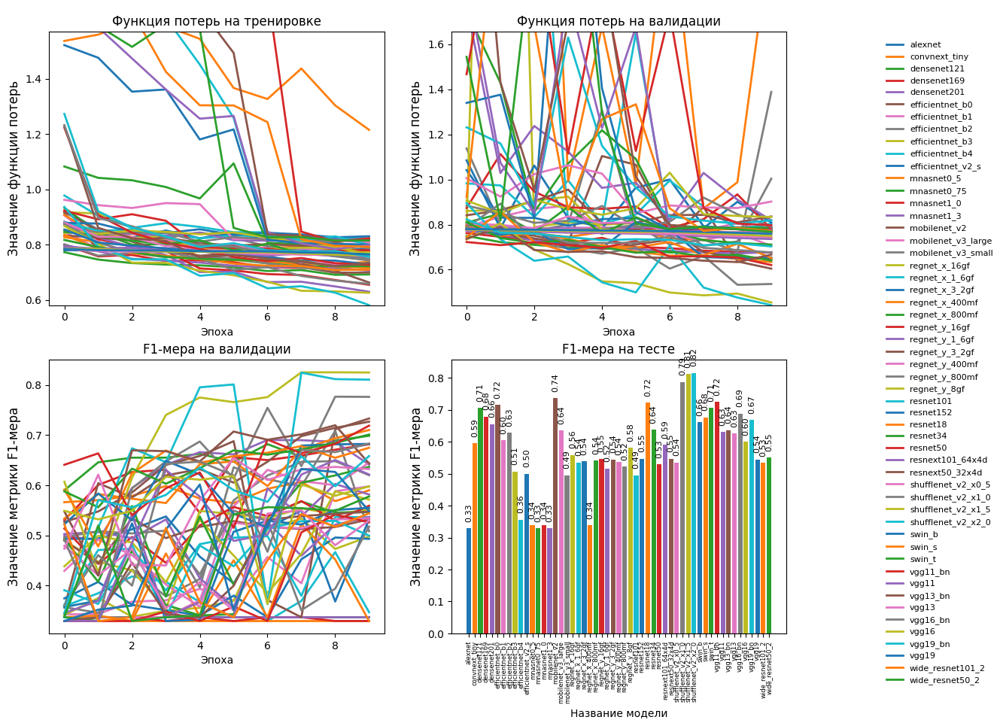

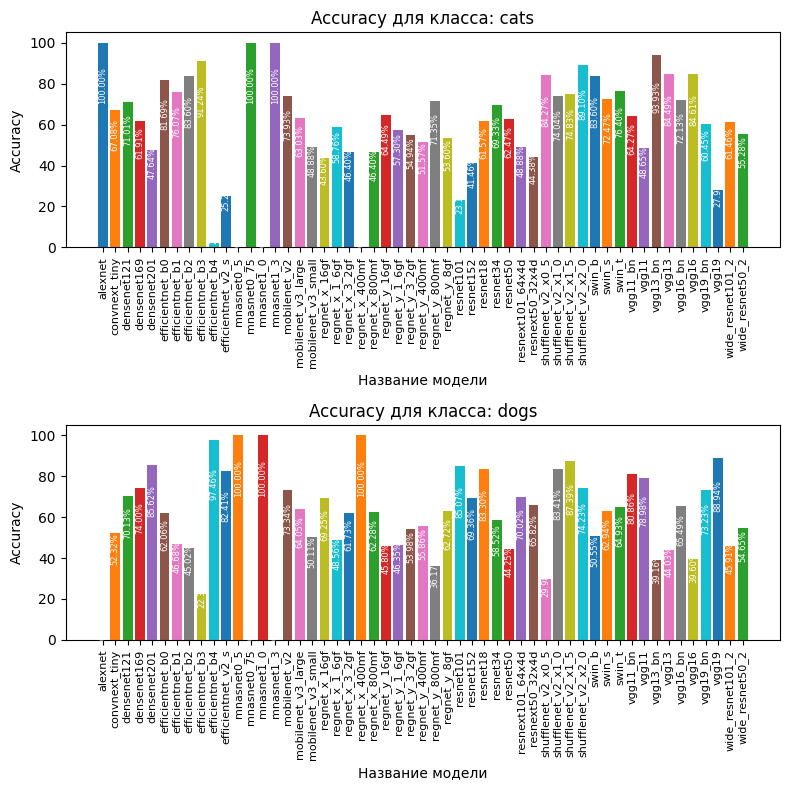

In [223]:
graduate_pipeline.graduate()

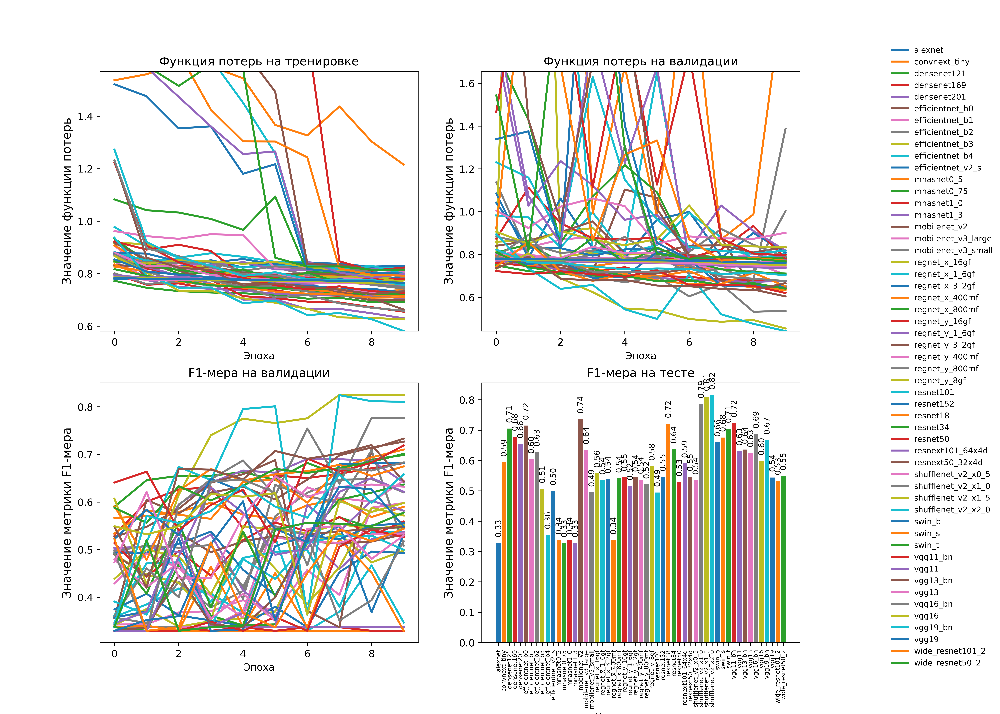

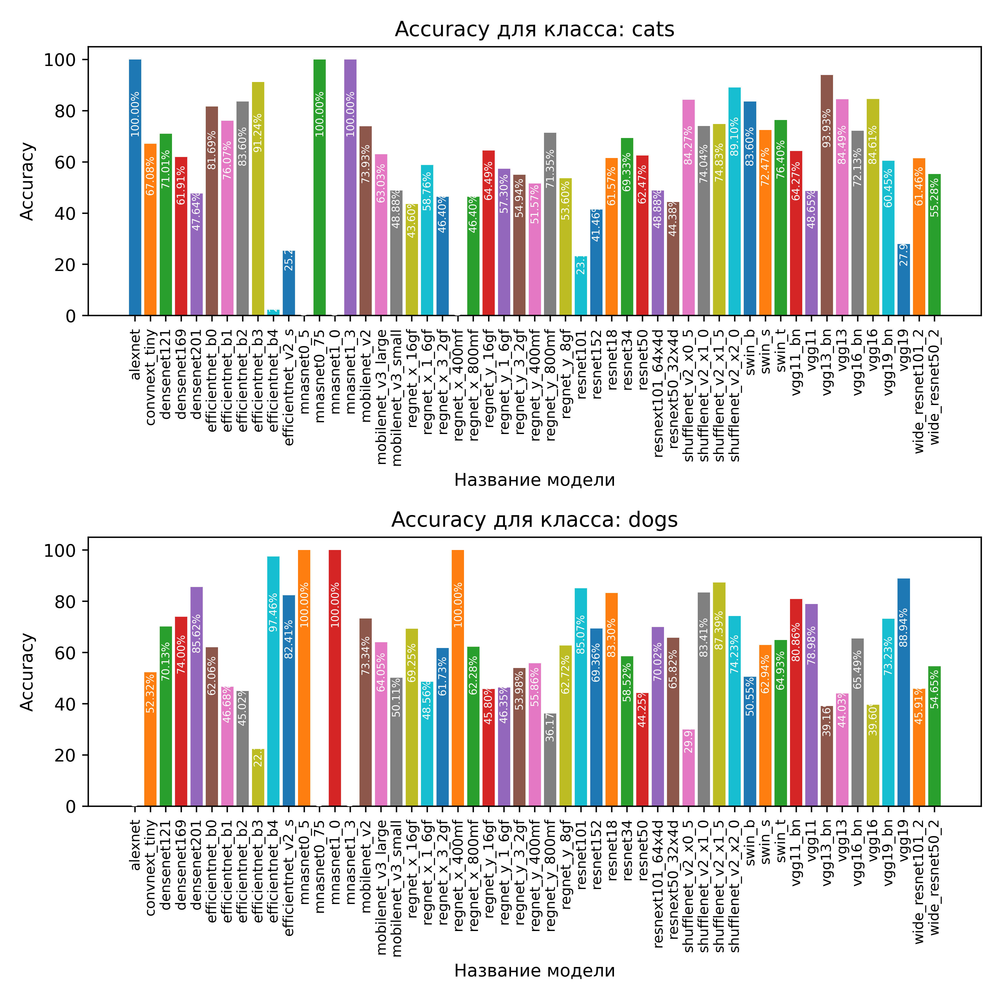

In [224]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_Exp4.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_Exp4.png"))

## Длительное обучение + лучший эксп

In [229]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "CatsVsDogs",
        "models": ["shufflenet_v2_x2_0"],
        "name_optimizers": ["AdamW"],
        "name_loss": "CrossEntropyLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 50,
        "class_percentage": {"cats": 0.3, "dogs": 1.0},
        "is_use_class_weights": True,
        "resampling_method": "undersampling"
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1672.74image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1744.52image/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_CatsVsDogs
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.91sample/s]



Epoch 1/50, Training Loss: 0.7818373362837788, Validation Loss: 0.6694855243809479
Accuracy: 0.5694915254237288, Precision: 0.6259043600036523, Recall: 0.5694915254237288, F1-score: 0.5121810434321343


Epoch 2/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.13sample/s]



Epoch 2/50, Training Loss: 0.6892301994295874, Validation Loss: 0.5868471929077375
Accuracy: 0.6949152542372882, Precision: 0.70726470729754, Recall: 0.6949152542372882, F1-score: 0.6907329032979306


Epoch 3/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.94sample/s]



Epoch 3/50, Training Loss: 0.6723110473033079, Validation Loss: 0.6207994846469265
Accuracy: 0.7220338983050848, Precision: 0.7373563794846172, Recall: 0.7220338983050848, F1-score: 0.7170879401596207


Epoch 4/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.49sample/s]



Epoch 4/50, Training Loss: 0.6442985593555719, Validation Loss: 0.57820005058232
Accuracy: 0.7220338983050848, Precision: 0.7642705665649281, Recall: 0.7220338983050848, F1-score: 0.7098850827513163


Epoch 5/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.62sample/s]



Epoch 5/50, Training Loss: 0.6076265445484739, Validation Loss: 0.48135274160379743
Accuracy: 0.7977401129943503, Precision: 0.8075697836585299, Recall: 0.7977401129943503, F1-score: 0.7959464857612887


Epoch 6/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.63sample/s]



Epoch 6/50, Training Loss: 0.5862973091221347, Validation Loss: 0.5020454996554865
Accuracy: 0.772316384180791, Precision: 0.7874293999458878, Recall: 0.772316384180791, F1-score: 0.7690341009658702


Epoch 7/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.13sample/s]



Epoch 7/50, Training Loss: 0.5642907366002958, Validation Loss: 0.4461560648376659
Accuracy: 0.7932203389830509, Precision: 0.7936494699986005, Recall: 0.7932203389830509, F1-score: 0.793106202488199


Epoch 8/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.52sample/s]



Epoch 8/50, Training Loss: 0.5617299373309637, Validation Loss: 0.5760649809729581
Accuracy: 0.6802259887005649, Precision: 0.707756734136366, Recall: 0.6802259887005649, F1-score: 0.6685534898278673


Epoch 9/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.52sample/s]



Epoch 9/50, Training Loss: 0.5528948945073328, Validation Loss: 0.420026018542085
Accuracy: 0.8355932203389831, Precision: 0.8393900195963833, Recall: 0.8355932203389831, F1-score: 0.8350578299339264


Epoch 10/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 10/50, Training Loss: 0.5245235834744378, Validation Loss: 0.39620387457353246
Accuracy: 0.8502824858757062, Precision: 0.8587402561526826, Recall: 0.8502824858757062, F1-score: 0.8493000109992174


Epoch 11/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.94sample/s]



Epoch 11/50, Training Loss: 0.5101999232347069, Validation Loss: 0.4111338718294424
Accuracy: 0.8271186440677966, Precision: 0.8376990902824529, Recall: 0.8271186440677966, F1-score: 0.8256226410973266


Epoch 12/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.60sample/s]



Epoch 12/50, Training Loss: 0.5112812127341929, Validation Loss: 0.3383596908658911
Accuracy: 0.8615819209039548, Precision: 0.8642746420068933, Recall: 0.8615819209039548, F1-score: 0.8613728957053395


Epoch 13/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.80sample/s]



Epoch 13/50, Training Loss: 0.49093836906951727, Validation Loss: 0.33242142053142104
Accuracy: 0.868361581920904, Precision: 0.869445578925873, Recall: 0.868361581920904, F1-score: 0.8682358405581891


Epoch 14/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.42sample/s]



Epoch 14/50, Training Loss: 0.4707408593487494, Validation Loss: 0.34258391007275907
Accuracy: 0.8395480225988701, Precision: 0.8667778165556675, Recall: 0.8395480225988701, F1-score: 0.8363337371160581


Epoch 15/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.77sample/s]



Epoch 15/50, Training Loss: 0.470548668524244, Validation Loss: 0.3387504367336715
Accuracy: 0.8514124293785311, Precision: 0.8532726430695913, Recall: 0.8514124293785311, F1-score: 0.8512599161954753


Epoch 16/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.47sample/s]



Epoch 16/50, Training Loss: 0.4530635595936136, Validation Loss: 0.2722815352644624
Accuracy: 0.9028248587570622, Precision: 0.9041826901834462, Recall: 0.9028248587570622, F1-score: 0.902721496938918


Epoch 17/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.80sample/s]



Epoch 17/50, Training Loss: 0.4424701850490062, Validation Loss: 0.24434111223129903
Accuracy: 0.9107344632768362, Precision: 0.9142392040596609, Recall: 0.9107344632768362, F1-score: 0.9105142185068628


Epoch 18/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 18/50, Training Loss: 0.42650115687105666, Validation Loss: 0.2561664727574351
Accuracy: 0.9022598870056497, Precision: 0.9031553383328276, Recall: 0.9022598870056497, F1-score: 0.9022227826617181


Epoch 19/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.70sample/s]



Epoch 19/50, Training Loss: 0.4317600738346781, Validation Loss: 0.23156479179943348
Accuracy: 0.9135593220338983, Precision: 0.9150819237106712, Recall: 0.9135593220338983, F1-score: 0.9134993340250046


Epoch 20/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.30sample/s]



Epoch 20/50, Training Loss: 0.4241313112714037, Validation Loss: 0.1880631029269116
Accuracy: 0.9384180790960452, Precision: 0.9389028456704968, Recall: 0.9384180790960452, F1-score: 0.9384083875361913


Epoch 21/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.59sample/s]



Epoch 21/50, Training Loss: 0.39462606066076206, Validation Loss: 0.2670934485471518
Accuracy: 0.8903954802259887, Precision: 0.9038246060017565, Recall: 0.8903954802259887, F1-score: 0.8893996998145082


Epoch 22/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.50sample/s]



Epoch 22/50, Training Loss: 0.3820356043292485, Validation Loss: 0.19514231011271477
Accuracy: 0.9214689265536723, Precision: 0.9222660053633263, Recall: 0.9214689265536723, F1-score: 0.9214190277085189


Epoch 23/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.36sample/s]


Epoch 00023: reducing learning rate of group 0 to 1.0000e-04.

Epoch 23/50, Training Loss: 0.3836238031176357, Validation Loss: 0.19019032537011105
Accuracy: 0.923728813559322, Precision: 0.9262825643440051, Recall: 0.923728813559322, F1-score: 0.9235924624915021


Epoch 24/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.57sample/s]



Epoch 24/50, Training Loss: 0.31963706545250115, Validation Loss: 0.13636788090238464
Accuracy: 0.9536723163841808, Precision: 0.9537267087938693, Recall: 0.9536723163841808, F1-score: 0.9536690626367872


Epoch 25/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.47sample/s]



Epoch 25/50, Training Loss: 0.3043205842017308, Validation Loss: 0.11679077219470578
Accuracy: 0.9593220338983051, Precision: 0.95977375181101, Recall: 0.9593220338983051, F1-score: 0.9593074842473506


Epoch 26/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.55sample/s]



Epoch 26/50, Training Loss: 0.3116609535829718, Validation Loss: 0.1110397745502618
Accuracy: 0.9666666666666667, Precision: 0.9670331243672212, Recall: 0.9666666666666667, F1-score: 0.9666568205775385


Epoch 27/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 27/50, Training Loss: 0.2859733325278841, Validation Loss: 0.09173322832580172
Accuracy: 0.9717514124293786, Precision: 0.9717533890633002, Recall: 0.9717514124293786, F1-score: 0.9717511599444799


Epoch 28/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 28/50, Training Loss: 0.2681529014739384, Validation Loss: 0.08215596339018164
Accuracy: 0.980225988700565, Precision: 0.9802405620259196, Recall: 0.980225988700565, F1-score: 0.9802254521542269


Epoch 29/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.72sample/s]



Epoch 29/50, Training Loss: 0.26955263164291265, Validation Loss: 0.06955992833495477
Accuracy: 0.9819209039548022, Precision: 0.981959184965139, Recall: 0.9819209039548022, F1-score: 0.9819199805213252


Epoch 30/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.11sample/s]



Epoch 30/50, Training Loss: 0.24300286674366375, Validation Loss: 0.05685038657827397
Accuracy: 0.9864406779661017, Precision: 0.986501766602401, Recall: 0.9864406779661017, F1-score: 0.9864397256497914


Epoch 31/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.97sample/s]



Epoch 31/50, Training Loss: 0.23211073620673717, Validation Loss: 0.05016944630303036
Accuracy: 0.9887005649717514, Precision: 0.9887028878773092, Recall: 0.9887005649717514, F1-score: 0.988700463977792


Epoch 32/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.29sample/s]



Epoch 32/50, Training Loss: 0.22622125563803816, Validation Loss: 0.04818715904655177
Accuracy: 0.988135593220339, Precision: 0.9881363073700248, Recall: 0.988135593220339, F1-score: 0.98813563487935


Epoch 33/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.95sample/s]



Epoch 33/50, Training Loss: 0.24440585235549822, Validation Loss: 0.06262894127896781
Accuracy: 0.9887005649717514, Precision: 0.9887235468735038, Recall: 0.9887005649717514, F1-score: 0.9887006948144963


Epoch 34/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.96sample/s]



Epoch 34/50, Training Loss: 0.22247967561802914, Validation Loss: 0.04816147192291873
Accuracy: 0.9892655367231639, Precision: 0.9892662436592164, Recall: 0.9892655367231639, F1-score: 0.9892655744146498


Epoch 35/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.27sample/s]



Epoch 35/50, Training Loss: 0.2167559644188156, Validation Loss: 0.048189414117885174
Accuracy: 0.9887005649717514, Precision: 0.9887032339853611, Recall: 0.9887005649717514, F1-score: 0.9887006371080832


Epoch 36/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.98sample/s]



Epoch 36/50, Training Loss: 0.22382981672601396, Validation Loss: 0.045283190540359015
Accuracy: 0.9903954802259887, Precision: 0.990396032807224, Recall: 0.9903954802259887, F1-score: 0.9903954403697874


Epoch 37/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.15sample/s]



Epoch 37/50, Training Loss: 0.21267975743898412, Validation Loss: 0.04228691129792629
Accuracy: 0.9915254237288136, Precision: 0.9915259864094448, Recall: 0.9915254237288136, F1-score: 0.9915253885615772


Epoch 38/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.05sample/s]



Epoch 38/50, Training Loss: 0.2141230811854613, Validation Loss: 0.04561066922947428
Accuracy: 0.9903954802259887, Precision: 0.9904013361337817, Recall: 0.9903954802259887, F1-score: 0.9903955630019275


Epoch 39/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 39/50, Training Loss: 0.19667671478107007, Validation Loss: 0.04237365693190677
Accuracy: 0.9903954802259887, Precision: 0.990396179948408, Recall: 0.9903954802259887, F1-score: 0.99039551394995


Epoch 40/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.81sample/s]



Epoch 40/50, Training Loss: 0.19763230432554618, Validation Loss: 0.03840615440391551
Accuracy: 0.9915254237288136, Precision: 0.991531266652332, Recall: 0.9915254237288136, F1-score: 0.9915254967664067


Epoch 41/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.33sample/s]



Epoch 41/50, Training Loss: 0.1953434751231441, Validation Loss: 0.03686993781708728
Accuracy: 0.9915254237288136, Precision: 0.9915414375037762, Recall: 0.9915254237288136, F1-score: 0.991525518406208


Epoch 42/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.26sample/s]



Epoch 42/50, Training Loss: 0.16657413897517415, Validation Loss: 0.03891342013711268
Accuracy: 0.988135593220339, Precision: 0.9881409302477784, Recall: 0.988135593220339, F1-score: 0.9881354227914547


Epoch 43/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.27sample/s]



Epoch 43/50, Training Loss: 0.18930653459632518, Validation Loss: 0.03733006782966566
Accuracy: 0.9898305084745763, Precision: 0.9898328544649098, Recall: 0.9898305084745763, F1-score: 0.9898304175800128


Epoch 44/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.53sample/s]


Epoch 00044: reducing learning rate of group 0 to 1.0000e-05.

Epoch 44/50, Training Loss: 0.18798949656515188, Validation Loss: 0.04060652347065845
Accuracy: 0.9898305084745763, Precision: 0.9898305084745763, Recall: 0.9898305084745763, F1-score: 0.9898305084745763


Epoch 45/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 45/50, Training Loss: 0.19679194560140065, Validation Loss: 0.0389557986850403
Accuracy: 0.9892655367231639, Precision: 0.9892662436592164, Recall: 0.9892655367231639, F1-score: 0.9892655744146498


Epoch 46/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.08sample/s]



Epoch 46/50, Training Loss: 0.16694607937714898, Validation Loss: 0.03768161664937891
Accuracy: 0.9898305084745763, Precision: 0.9898305084745763, Recall: 0.9898305084745763, F1-score: 0.9898305084745763


Epoch 47/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.18sample/s]



Epoch 47/50, Training Loss: 0.18441219392306207, Validation Loss: 0.036479310798827075
Accuracy: 0.9892655367231639, Precision: 0.9892714056152313, Recall: 0.9892655367231639, F1-score: 0.9892656292374484


Epoch 48/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.10sample/s]



Epoch 48/50, Training Loss: 0.17704111945101692, Validation Loss: 0.03688158330476006
Accuracy: 0.9909604519774011, Precision: 0.9909630979076499, Recall: 0.9909604519774011, F1-score: 0.9909605096864667


Epoch 49/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.91sample/s]



Epoch 49/50, Training Loss: 0.17267212272970536, Validation Loss: 0.03793295556126888
Accuracy: 0.9909604519774011, Precision: 0.9909834338791536, Recall: 0.9909604519774011, F1-score: 0.9909605558515969


Epoch 50/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.63sample/s]


Epoch 00050: reducing learning rate of group 0 to 1.0000e-06.

Epoch 50/50, Training Loss: 0.18198614929165832, Validation Loss: 0.0367316438758609
Accuracy: 0.9903954802259887, Precision: 0.9904013361337817, Recall: 0.9903954802259887, F1-score: 0.9903955630019275
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.49sample/s]


Test Accuracy: 0.9905239687848384
Precision: 0.9905388003040805, Recall: 0.9905239687848384, F1-score: 0.9905236890452531
Accuracy of  cats : 98 %
Accuracy of  dogs : 99 %


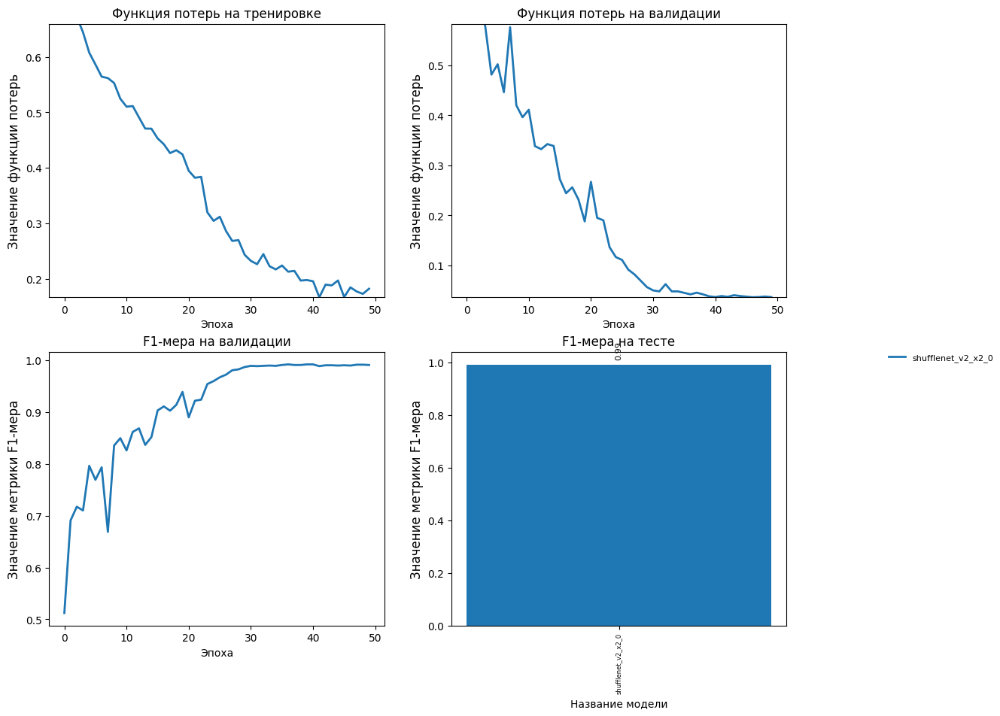

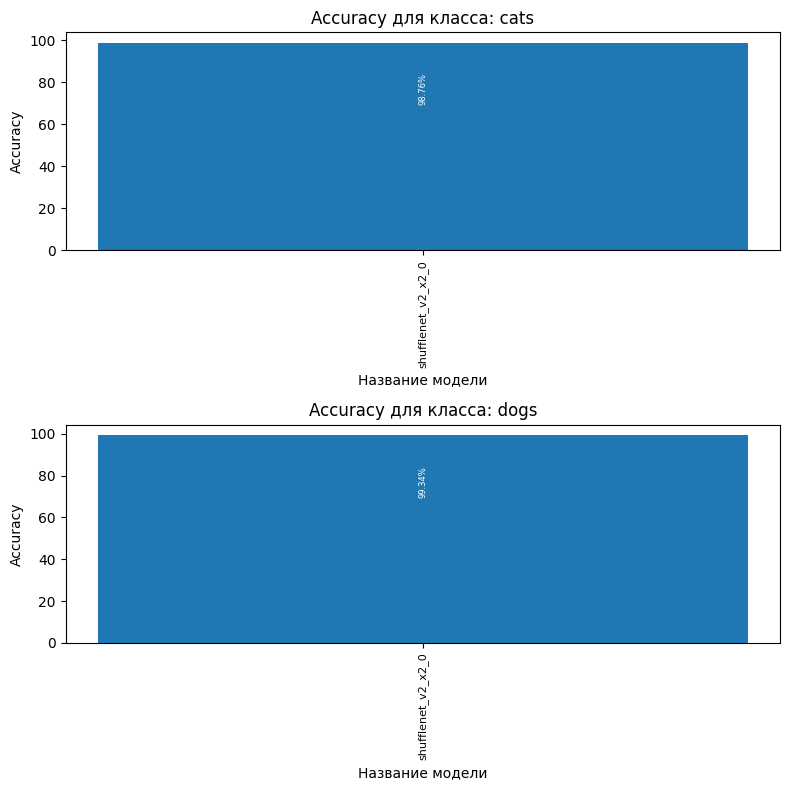

In [230]:
graduate_pipeline.graduate()

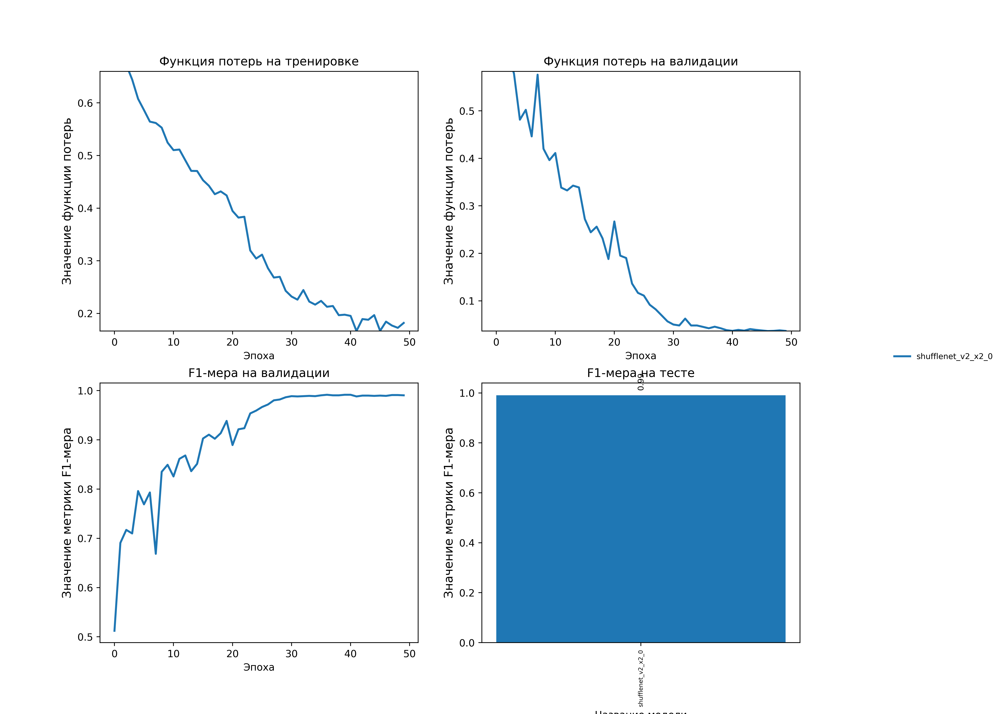

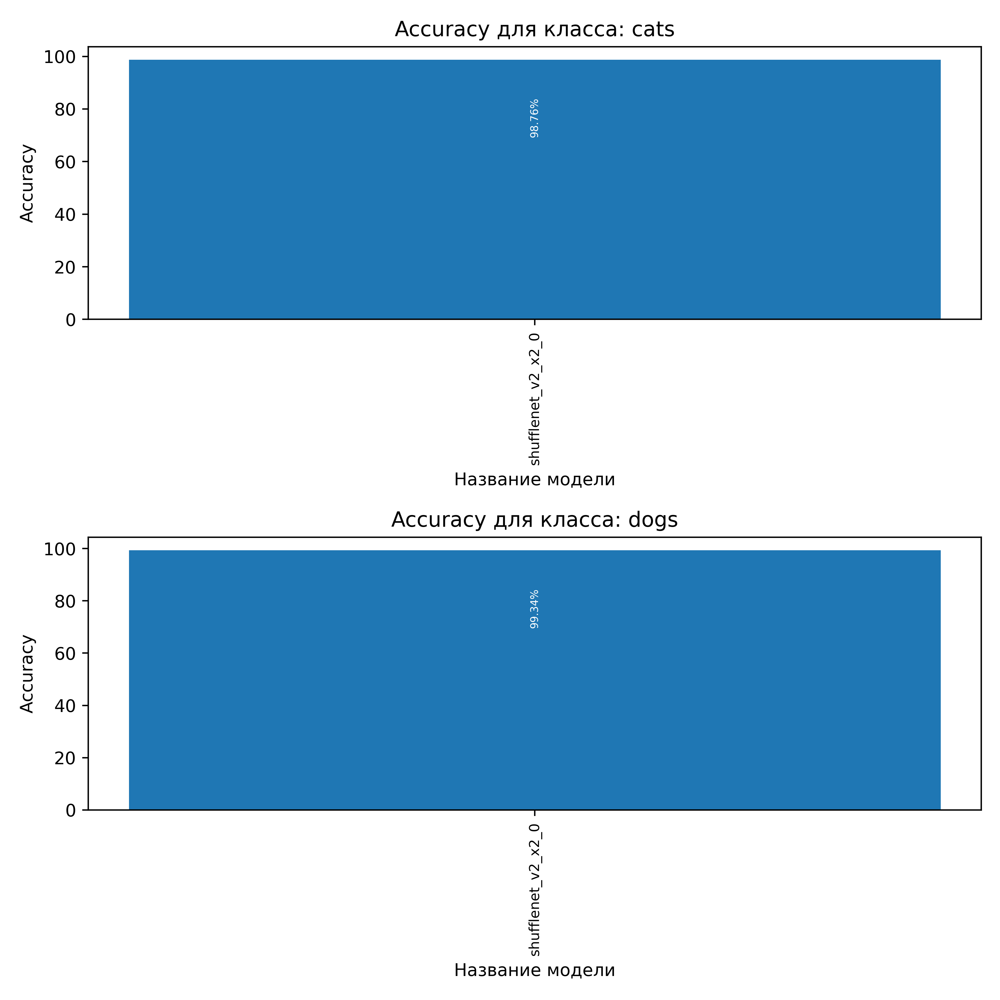

In [231]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_CatsVsDogs.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_CatsVsDogs.png"))

## Длительное обучение + лучший эксп + ImageNet

In [232]:
graduate_pipeline = validate_with_pydantic(EntryGraduateModel)(GraduateModelPipeline)(
    entry = {
        "prefix": "CatsVsDogs_ImageNet",
        "models": ["shufflenet_v2_x2_0"],
        "name_optimizers": ["AdamW"],
        "name_loss": "CrossEntropyLoss",
        "ratio":(70, 15, 15),
        "size_img": (64, 64),
        "batch_size": 25,
        "num_epochs": 50,
        "class_percentage": {"cats": 0.3, "dogs": 1.0},
        "is_use_class_weights": True,
        "is_use_imagenet_weights": True,
        "resampling_method": "undersampling"
    }
)


Class_name: cats
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1824.14image/s]



Class_name: dogs
Train_count: 900
Test_count: 300
Valid_count: 300


Shutil images: 100%|██████████████████████████████████████████████████████████| 1500/1500 [00:00<00:00, 1858.90image/s]
Downloading: "https://download.pytorch.org/models/shufflenetv2_x2_0-8be3c8ee.pth" to C:\Users\NightMare/.cache\torch\hub\checkpoints\shufflenetv2_x2_0-8be3c8ee.pth
100%|█████████████████████████████████████████████████████████████████████████████| 28.4M/28.4M [00:29<00:00, 1.01MB/s]



        
        ----------------------------------------------------------------------
        
        Выбранная модель: shufflenet_v2_x2_0
        Пользовательское название модели: shufflenet_v2_x2_0_CatsVsDogs_ImageNet
        Выбранный оптимизатор: AdamW
        
        ----------------------------------------------------------------------
        
        


Epoch 1/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 1/50, Training Loss: 0.5413268122476401, Validation Loss: 32.838974695000275
Accuracy: 0.8864406779661017, Precision: 0.8864420413427745, Recall: 0.8864406779661017, F1-score: 0.8864410767023491


Epoch 2/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.55sample/s]



Epoch 2/50, Training Loss: 0.41914324744050857, Validation Loss: 11.47977851377537
Accuracy: 0.9209039548022598, Precision: 0.9211509725788821, Recall: 0.9209039548022598, F1-score: 0.9208850631425942


Epoch 3/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.75sample/s]



Epoch 3/50, Training Loss: 0.39335030286582473, Validation Loss: 125.54689082757986
Accuracy: 0.9288135593220339, Precision: 0.9288442441608382, Recall: 0.9288135593220339, F1-score: 0.9288099233027175


Epoch 4/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.13sample/s]



Epoch 4/50, Training Loss: 0.3328431937651536, Validation Loss: 132.3781032331688
Accuracy: 0.9350282485875706, Precision: 0.9383813108903528, Recall: 0.9350282485875706, F1-score: 0.934924312059865


Epoch 5/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]


Epoch 00005: reducing learning rate of group 0 to 1.0000e-04.

Epoch 5/50, Training Loss: 0.29081624592702415, Validation Loss: 402.9700241266187
Accuracy: 0.9429378531073447, Precision: 0.9434264713550712, Recall: 0.9429378531073447, F1-score: 0.9429288728546359


Epoch 6/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.97sample/s]



Epoch 6/50, Training Loss: 0.23490979701690248, Validation Loss: 2.755364345860178
Accuracy: 0.9683615819209039, Precision: 0.9683721193137275, Recall: 0.9683615819209039, F1-score: 0.9683619050879572


Epoch 7/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.67sample/s]



Epoch 7/50, Training Loss: 0.21254457722824463, Validation Loss: 146.4148536800449
Accuracy: 0.9689265536723164, Precision: 0.9697560163052155, Recall: 0.9689265536723164, F1-score: 0.9689173772948102


Epoch 8/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.42sample/s]



Epoch 8/50, Training Loss: 0.2036048859434644, Validation Loss: 1.283815372815503
Accuracy: 0.9830508474576272, Precision: 0.9832530474638218, Recall: 0.9830508474576272, F1-score: 0.9830502631652754


Epoch 9/50 (Eval): 100%|███████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.17sample/s]



Epoch 9/50, Training Loss: 0.17631416527163943, Validation Loss: 0.9142005697253165
Accuracy: 0.984180790960452, Precision: 0.9842037728622043, Recall: 0.984180790960452, F1-score: 0.9841809727402948


Epoch 10/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 22.18sample/s]



Epoch 10/50, Training Loss: 0.16080402015769196, Validation Loss: 36.631412985920115
Accuracy: 0.988135593220339, Precision: 0.9881667681449486, Recall: 0.988135593220339, F1-score: 0.9881357257676756


Epoch 11/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.45sample/s]



Epoch 11/50, Training Loss: 0.15029634493387134, Validation Loss: 67.37501511975103
Accuracy: 0.9915254237288136, Precision: 0.9916020757950866, Recall: 0.9915254237288136, F1-score: 0.9915254534841101


Epoch 12/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.06sample/s]


Epoch 00012: reducing learning rate of group 0 to 1.0000e-05.

Epoch 12/50, Training Loss: 0.1494720005126241, Validation Loss: 75.78486831896441
Accuracy: 0.988135593220339, Precision: 0.9883623579619736, Recall: 0.988135593220339, F1-score: 0.9881350895366011


Epoch 13/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.23sample/s]



Epoch 13/50, Training Loss: 0.13191737617042773, Validation Loss: 321.2123041644766
Accuracy: 0.9830508474576272, Precision: 0.9834713583517325, Recall: 0.9830508474576272, F1-score: 0.9830488780754175


Epoch 14/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.37sample/s]



Epoch 14/50, Training Loss: 0.12032255050934262, Validation Loss: 52.16728793509899
Accuracy: 0.9926553672316384, Precision: 0.9927320986478766, Recall: 0.9926553672316384, F1-score: 0.9926553930195622


Epoch 15/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.32sample/s]


Epoch 00015: reducing learning rate of group 0 to 1.0000e-06.

Epoch 15/50, Training Loss: 0.1258909571019747, Validation Loss: 142.39642457498203
Accuracy: 0.9892655367231639, Precision: 0.9894073380361504, Recall: 0.9892655367231639, F1-score: 0.9892653825362331


Epoch 16/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 16/50, Training Loss: 0.13036799524299467, Validation Loss: 5.035358533438158
Accuracy: 0.9949152542372881, Precision: 0.9949158472161074, Recall: 0.9949152542372881, F1-score: 0.9949152331369463


Epoch 17/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.18sample/s]



Epoch 17/50, Training Loss: 0.12732825080361665, Validation Loss: 167.87276480807745
Accuracy: 0.9898305084745763, Precision: 0.9899918784747115, Recall: 0.9898305084745763, F1-score: 0.9898303007275108


Epoch 18/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.70sample/s]


Epoch 00018: reducing learning rate of group 0 to 1.0000e-07.

Epoch 18/50, Training Loss: 0.12709392187316804, Validation Loss: 258.3670016626208
Accuracy: 0.9830508474576272, Precision: 0.9833002050641628, Recall: 0.9830508474576272, F1-score: 0.9830499818315914


Epoch 19/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 19/50, Training Loss: 0.1248776963063839, Validation Loss: 77.34108023951553
Accuracy: 0.9943502824858758, Precision: 0.9943732643876281, Recall: 0.9943502824858758, F1-score: 0.9943503474072483


Epoch 20/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.77sample/s]



Epoch 20/50, Training Loss: 0.1242376965697842, Validation Loss: 132.2097929998835
Accuracy: 0.992090395480226, Precision: 0.9921538314415328, Recall: 0.992090395480226, F1-score: 0.992090445974111


Epoch 21/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.50sample/s]


Epoch 00021: reducing learning rate of group 0 to 1.0000e-08.

Epoch 21/50, Training Loss: 0.13032231549652376, Validation Loss: 273.6768925941107
Accuracy: 0.9870056497175141, Precision: 0.9872320580401376, Recall: 0.9870056497175141, F1-score: 0.9870050980638965


Epoch 22/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.46sample/s]



Epoch 22/50, Training Loss: 0.13033991053546826, Validation Loss: 134.62355402510977
Accuracy: 0.9909604519774011, Precision: 0.9910515527877322, Recall: 0.9909604519774011, F1-score: 0.9909604519774011


Epoch 23/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 23/50, Training Loss: 0.11400998781252768, Validation Loss: 102.59460811793744
Accuracy: 0.9915254237288136, Precision: 0.9916323330487612, Recall: 0.9915254237288136, F1-score: 0.991525388563463


Epoch 24/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 24/50, Training Loss: 0.13334901112730252, Validation Loss: 176.19630263691982
Accuracy: 0.988135593220339, Precision: 0.9883623579619736, Recall: 0.988135593220339, F1-score: 0.9881350895366011


Epoch 25/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.16sample/s]



Epoch 25/50, Training Loss: 0.1358794126166767, Validation Loss: 167.68696446308346
Accuracy: 0.9875706214689266, Precision: 0.9876338265966239, Recall: 0.9875706214689266, F1-score: 0.9875707008164601


Epoch 26/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.90sample/s]



Epoch 26/50, Training Loss: 0.13957189719266294, Validation Loss: 29.07876447829126
Accuracy: 0.9943502824858758, Precision: 0.9943528937910829, Recall: 0.9943502824858758, F1-score: 0.9943503185540417


Epoch 27/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.03sample/s]



Epoch 27/50, Training Loss: 0.12206210483096003, Validation Loss: 14.359795202961518
Accuracy: 0.996045197740113, Precision: 0.9960509887265335, Recall: 0.996045197740113, F1-score: 0.996045231824323


Epoch 28/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.14sample/s]



Epoch 28/50, Training Loss: 0.10613247233081315, Validation Loss: 94.66143805017079
Accuracy: 0.9875706214689266, Precision: 0.9876939778536349, Recall: 0.9875706214689266, F1-score: 0.9875705103823795


Epoch 29/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 29/50, Training Loss: 0.12640043030912215, Validation Loss: 223.8925245076143
Accuracy: 0.9870056497175141, Precision: 0.9872320580401376, Recall: 0.9870056497175141, F1-score: 0.9870050980638965


Epoch 30/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.09sample/s]



Epoch 30/50, Training Loss: 0.1332487489330451, Validation Loss: 264.1858929315204
Accuracy: 0.9864406779661017, Precision: 0.9866438130012266, Recall: 0.9864406779661017, F1-score: 0.9864402105322203


Epoch 31/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.27sample/s]



Epoch 31/50, Training Loss: 0.11212697867112062, Validation Loss: 128.18044290429185
Accuracy: 0.9870056497175141, Precision: 0.987147061466454, Recall: 0.9870056497175141, F1-score: 0.987005463070177


Epoch 32/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.42sample/s]



Epoch 32/50, Training Loss: 0.13048698260253647, Validation Loss: 78.05065717524388
Accuracy: 0.9898305084745763, Precision: 0.9899541880461448, Recall: 0.9898305084745763, F1-score: 0.9898304175855834


Epoch 33/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.39sample/s]



Epoch 33/50, Training Loss: 0.12896970036372388, Validation Loss: 147.0964329586625
Accuracy: 0.9898305084745763, Precision: 0.9899541880461448, Recall: 0.9898305084745763, F1-score: 0.9898304175855834


Epoch 34/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.92sample/s]



Epoch 34/50, Training Loss: 0.12885002365265413, Validation Loss: 118.3351218352452
Accuracy: 0.9909604519774011, Precision: 0.9910515527877322, Recall: 0.9909604519774011, F1-score: 0.9909604519774011


Epoch 35/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.16sample/s]



Epoch 35/50, Training Loss: 0.11659130085694933, Validation Loss: 72.41623691440162
Accuracy: 0.9898305084745763, Precision: 0.9898711576503971, Recall: 0.9898305084745763, F1-score: 0.989830612348109


Epoch 36/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.12sample/s]



Epoch 36/50, Training Loss: 0.12603373195227122, Validation Loss: 607.8873906751054
Accuracy: 0.9864406779661017, Precision: 0.9866912477276694, Recall: 0.9864406779661017, F1-score: 0.9864399854652732


Epoch 37/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.58sample/s]



Epoch 37/50, Training Loss: 0.12331066151786454, Validation Loss: 68.82179846521795
Accuracy: 0.992090395480226, Precision: 0.9921816001683339, Recall: 0.992090395480226, F1-score: 0.992090395480226


Epoch 38/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.15sample/s]



Epoch 38/50, Training Loss: 0.1123852672573832, Validation Loss: 45.476261484116385
Accuracy: 0.9954802259887006, Precision: 0.9954904863854367, Recall: 0.9954802259887006, F1-score: 0.9954802721554223


Epoch 39/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.83sample/s]



Epoch 39/50, Training Loss: 0.12428960981826807, Validation Loss: 133.88812760096295
Accuracy: 0.992090395480226, Precision: 0.9921538314415328, Recall: 0.992090395480226, F1-score: 0.992090445974111


Epoch 40/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.30sample/s]



Epoch 40/50, Training Loss: 0.10778541267686284, Validation Loss: 266.5457103374989
Accuracy: 0.9853107344632769, Precision: 0.9855135578220916, Recall: 0.9853107344632769, F1-score: 0.985310228076572


Epoch 41/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 19.99sample/s]



Epoch 41/50, Training Loss: 0.12200869055932126, Validation Loss: 342.12373095120586
Accuracy: 0.9864406779661017, Precision: 0.9867436620161012, Recall: 0.9864406779661017, F1-score: 0.9864397257665207


Epoch 42/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.93sample/s]



Epoch 42/50, Training Loss: 0.1182793020894847, Validation Loss: 775.0403467209603
Accuracy: 0.9858757062146892, Precision: 0.9861017581183015, Recall: 0.9858757062146892, F1-score: 0.9858751065911919


Epoch 43/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.36sample/s]



Epoch 43/50, Training Loss: 0.12402496098051059, Validation Loss: 22.076023550412753
Accuracy: 0.9949152542372881, Precision: 0.9949312463720144, Recall: 0.9949152542372881, F1-score: 0.9949153110437248


Epoch 44/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.19sample/s]



Epoch 44/50, Training Loss: 0.12894496645080725, Validation Loss: 54.229369022357965
Accuracy: 0.9949152542372881, Precision: 0.9949312463720144, Recall: 0.9949152542372881, F1-score: 0.9949153110437248


Epoch 45/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.24sample/s]



Epoch 45/50, Training Loss: 0.12392683304154996, Validation Loss: 76.89841898117349
Accuracy: 0.9892655367231639, Precision: 0.9893721834588168, Recall: 0.9892655367231639, F1-score: 0.9892654921803864


Epoch 46/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.15sample/s]



Epoch 46/50, Training Loss: 0.11717545181269601, Validation Loss: 238.27568153051612
Accuracy: 0.9903954802259887, Precision: 0.9905374763209985, Recall: 0.9903954802259887, F1-score: 0.9903953422692612


Epoch 47/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.18sample/s]



Epoch 47/50, Training Loss: 0.12269279430860404, Validation Loss: 18.757362701667677
Accuracy: 0.996045197740113, Precision: 0.9960611826614271, Recall: 0.996045197740113, F1-score: 0.996045241922897


Epoch 48/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 20.84sample/s]



Epoch 48/50, Training Loss: 0.12018361907529156, Validation Loss: 119.66408112964272
Accuracy: 0.9932203389830508, Precision: 0.9932838326527602, Recall: 0.9932203389830508, F1-score: 0.9932203822635237


Epoch 49/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.84sample/s]



Epoch 49/50, Training Loss: 0.12037443300817943, Validation Loss: 100.71088438627828
Accuracy: 0.9898305084745763, Precision: 0.9899541880461448, Recall: 0.9898305084745763, F1-score: 0.9898304175855834


Epoch 50/50 (Eval): 100%|██████████████████████████████████████████████████████████| 71/71 [00:03<00:00, 21.37sample/s]



Epoch 50/50, Training Loss: 0.12322621908410103, Validation Loss: 70.46996356356208
Accuracy: 0.9887005649717514, Precision: 0.9888617041135175, Recall: 0.9887005649717514, F1-score: 0.9887003341416786
Тренировка завершена!


Test: 100%|████████████████████████████████████████████████████████████████████████| 72/72 [00:03<00:00, 18.66sample/s]


Test Accuracy: 0.9871794871794872
Precision: 0.9873961304403891, Recall: 0.9871794871794872, F1-score: 0.9871769887043341
Accuracy of  cats : 97 %
Accuracy of  dogs : 99 %


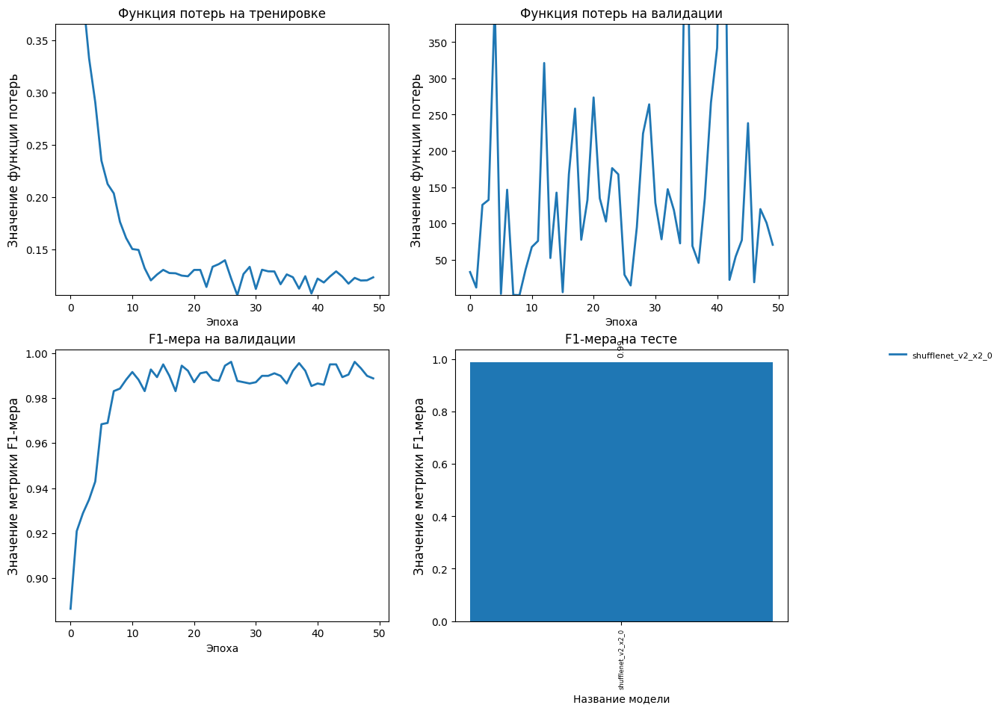

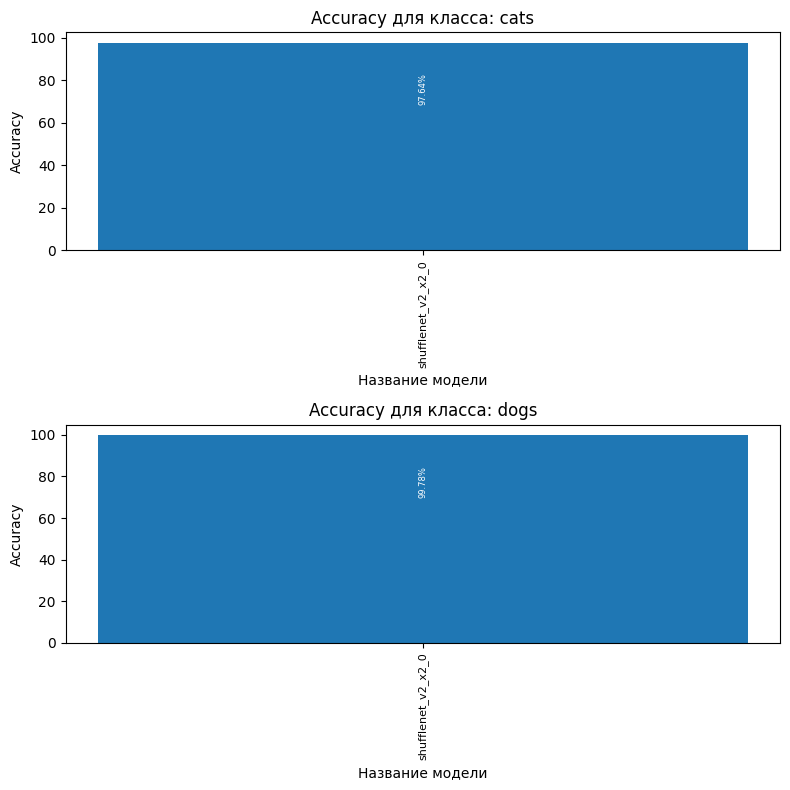

In [233]:
graduate_pipeline.graduate()

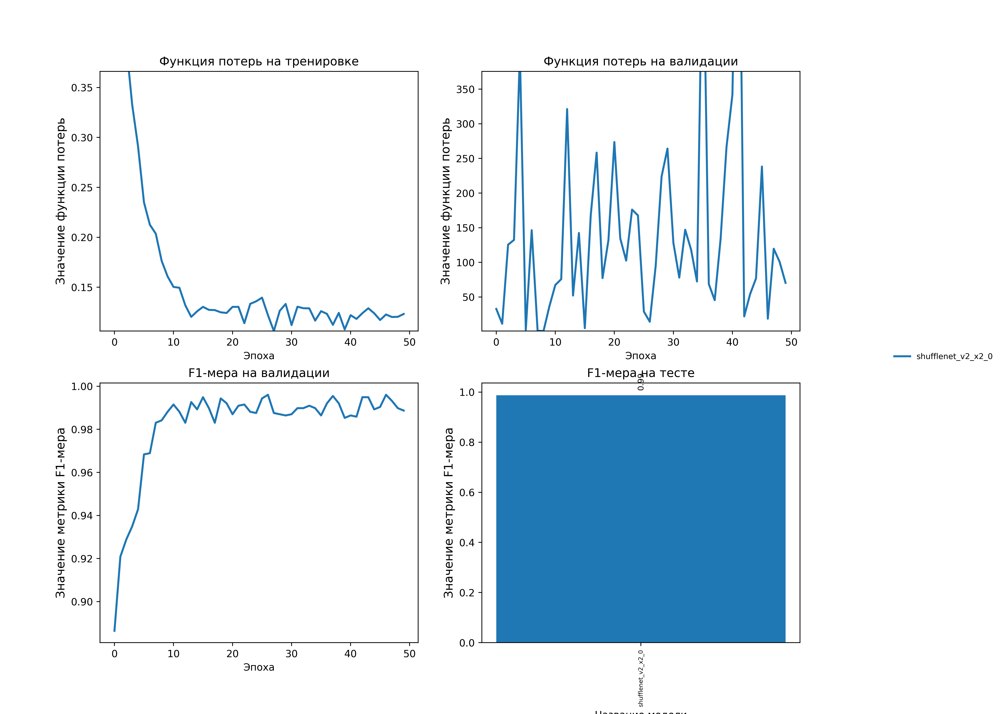

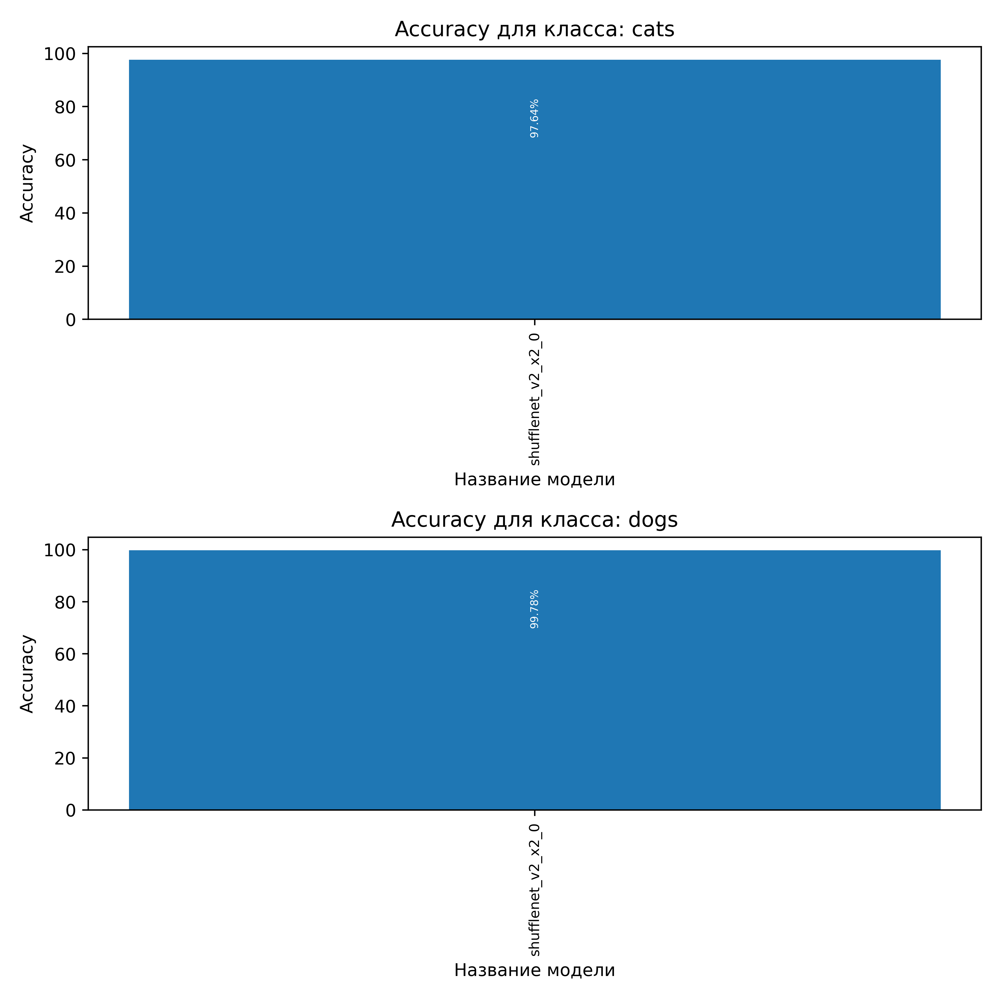

In [234]:
ipd.display(ipd.Image(filename="./plot/PlotsMetrics_CatsVsDogs_ImageNet.png"))
ipd.display(ipd.Image(filename="./plot/AccuracyForClass_CatsVsDogs_ImageNet.png"))

# Инференс

## shufflenet_v2_x2_0

In [239]:
imgs = [f"./images/{file}" for file in os.listdir("./images")]
print(imgs)

inference_pipeline = validate_with_pydantic(EntryInferenceModel)(InferenceModelPipeline)(
    entry = {
        "prefix": "CatsVsDogs",
        "name_model": "shufflenet_v2_x2_0",
        "image_path_list": imgs,
        "classes": ["cat", "dog"],
        "ground_truth": [0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1],
        "size_img": (64, 64)
    }
)

['./images/cat.jpg', './images/cat1.jpg', './images/cat2.jpg', './images/cat3.jpg', './images/cat4.jpg', './images/cat4.png', './images/dog.png', './images/dog1.jpg', './images/dog2.jpg', './images/dog3.jpg', './images/dog4.jpg']


17:43:51-470640 INFO     Модель инициализирована

17:43:51-716303 INFO     Модель shufflenet_v2_x2_0 успешно загружена с весами из ./weights.

Classifying:   0%|                                                                           | 0/11 [00:00<?, ?image/s]

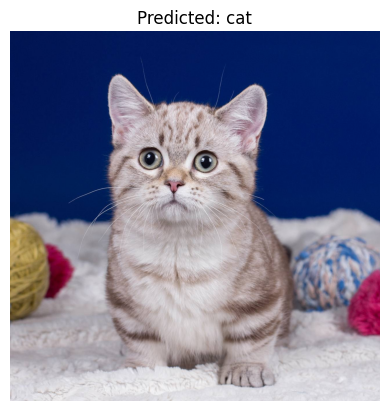

Classifying:   9%|██████                                                             | 1/11 [00:00<00:03,  3.07image/s]

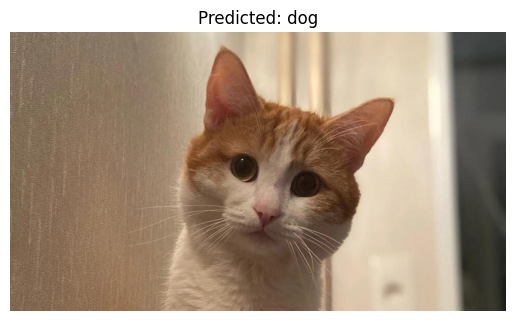

Classifying:  18%|████████████▏                                                      | 2/11 [00:00<00:02,  3.81image/s]

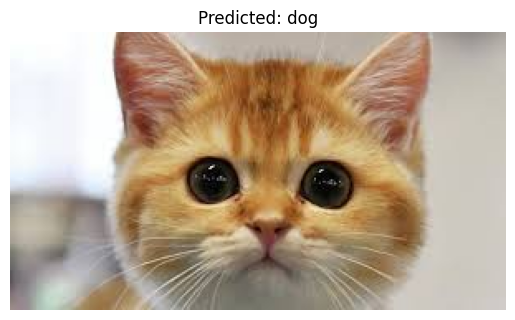

Classifying:  27%|██████████████████▎                                                | 3/11 [00:00<00:01,  4.44image/s]

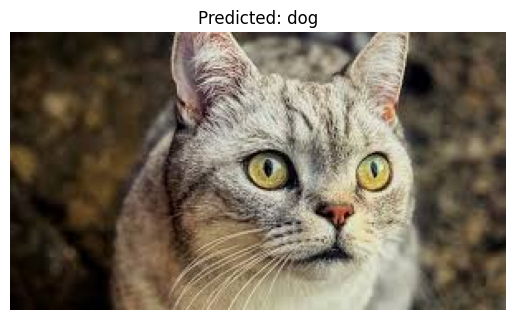

Classifying:  36%|████████████████████████▎                                          | 4/11 [00:00<00:01,  4.84image/s]

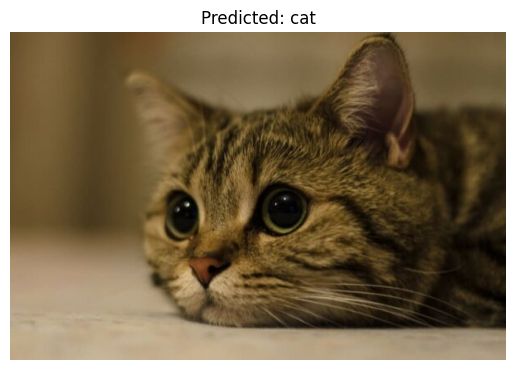

Classifying:  45%|██████████████████████████████▍                                    | 5/11 [00:01<00:01,  4.67image/s]

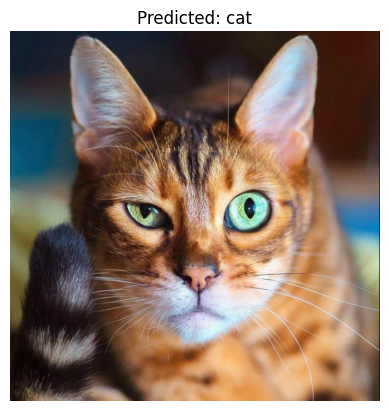

Classifying:  55%|████████████████████████████████████▌                              | 6/11 [00:01<00:01,  3.94image/s]

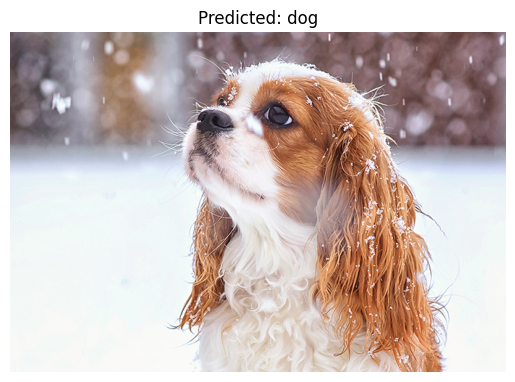

Classifying:  64%|██████████████████████████████████████████▋                        | 7/11 [00:01<00:01,  3.61image/s]

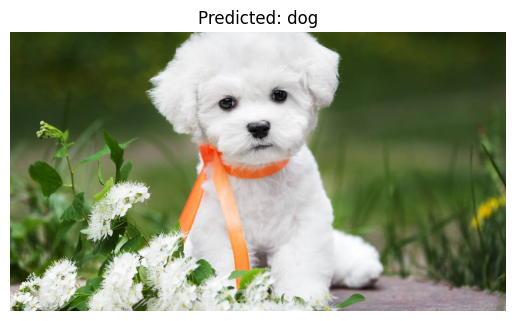

Classifying:  73%|████████████████████████████████████████████████▋                  | 8/11 [00:02<00:00,  3.72image/s]

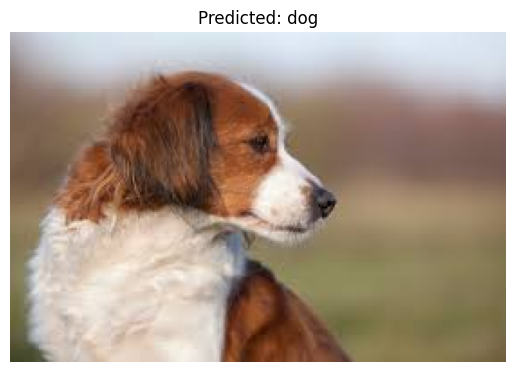

Classifying:  82%|██████████████████████████████████████████████████████▊            | 9/11 [00:02<00:00,  4.24image/s]

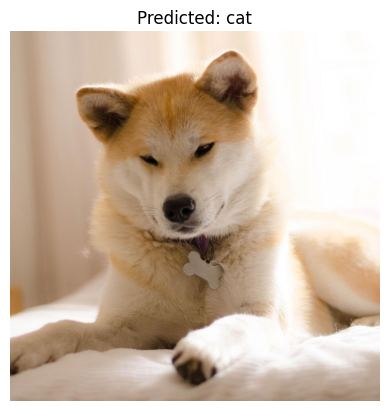

Classifying:  91%|████████████████████████████████████████████████████████████      | 10/11 [00:02<00:00,  3.85image/s]

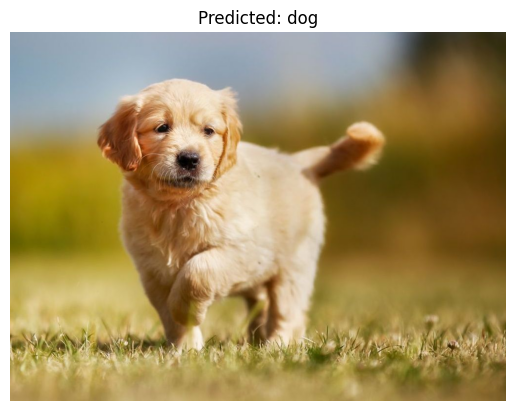

Classifying: 100%|██████████████████████████████████████████████████████████████████| 11/11 [00:02<00:00,  3.97image/s]

predictions: [0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1]


17:43:54-489952 INFO     Predictions: [0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1]

Precision: 0.538961038961039, Recall: 0.5454545454545454, F1-score: 0.5376845376845377


17:43:54-496028 INFO     Precision: 0.538961038961039, Recall: 0.5454545454545454, F1: 0.5376845376845377


(
    [0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1],
    [
        ('./images/cat.jpg', 0),
        ('./images/cat1.jpg', 1),
        ('./images/cat2.jpg', 1),
        ('./images/cat3.jpg', 1),
        ('./images/cat4.jpg', 0),
        ('./images/cat4.png', 0),
        ('./images/dog.png', 1),
        ('./images/dog1.jpg', 1),
        ('./images/dog2.jpg', 1),
        ('./images/dog3.jpg', 0),
        ('./images/dog4.jpg', 1)
    ]
)

In [240]:
inference_pipeline.inference()

## shufflenet_v2_x2_0 + ImageNet

In [241]:
imgs = [f"./images/{file}" for file in os.listdir("./images")]
print(imgs)

inference_pipeline = validate_with_pydantic(EntryInferenceModel)(InferenceModelPipeline)(
    entry = {
        "prefix": "CatsVsDogs_ImageNet",
        "name_model": "shufflenet_v2_x2_0",
        "image_path_list": imgs,
        "classes": ["cat", "dog"],
        "ground_truth": [0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1],
        "size_img": (64, 64)
    }
)

['./images/cat.jpg', './images/cat1.jpg', './images/cat2.jpg', './images/cat3.jpg', './images/cat4.jpg', './images/cat4.png', './images/dog.png', './images/dog1.jpg', './images/dog2.jpg', './images/dog3.jpg', './images/dog4.jpg']


17:44:03-568895 INFO     Модель инициализирована

17:44:03-700660 INFO     Модель shufflenet_v2_x2_0 успешно загружена с весами из ./weights.

Classifying:   0%|                                                                           | 0/11 [00:00<?, ?image/s]

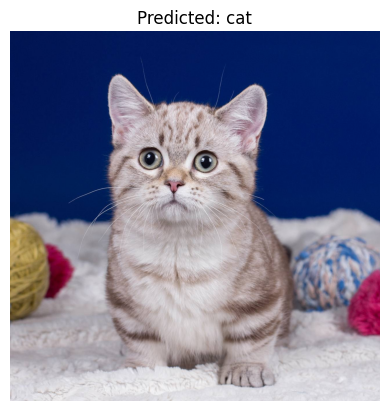

Classifying:   9%|██████                                                             | 1/11 [00:00<00:03,  3.25image/s]

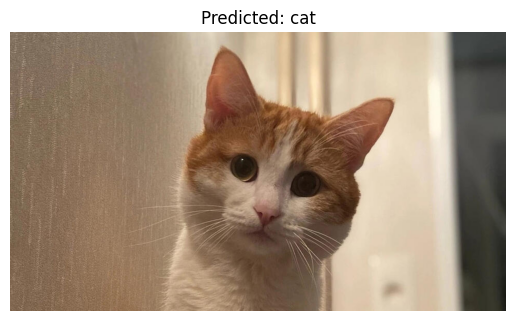

Classifying:  18%|████████████▏                                                      | 2/11 [00:00<00:02,  4.30image/s]

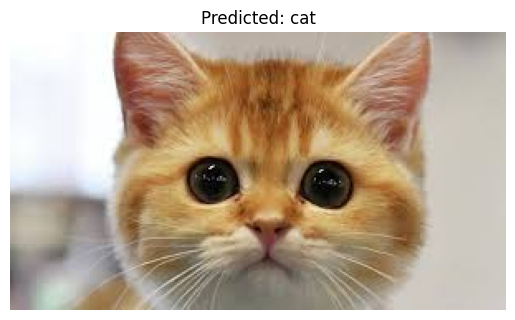

Classifying:  27%|██████████████████▎                                                | 3/11 [00:00<00:01,  5.19image/s]

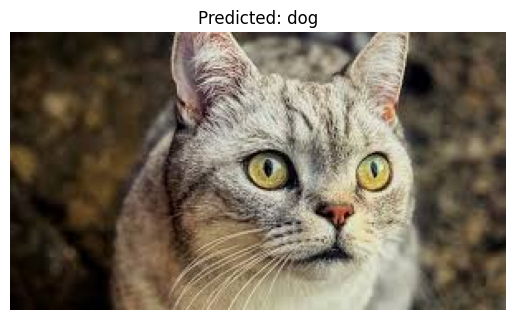

Classifying:  36%|████████████████████████▎                                          | 4/11 [00:00<00:01,  5.56image/s]

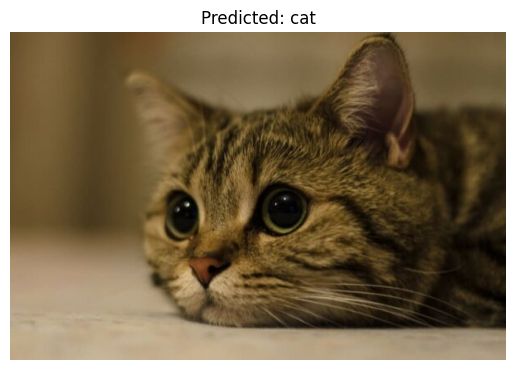

Classifying:  45%|██████████████████████████████▍                                    | 5/11 [00:00<00:01,  5.62image/s]

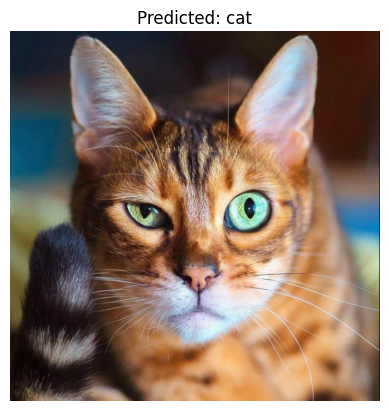

Classifying:  55%|████████████████████████████████████▌                              | 6/11 [00:01<00:01,  4.68image/s]

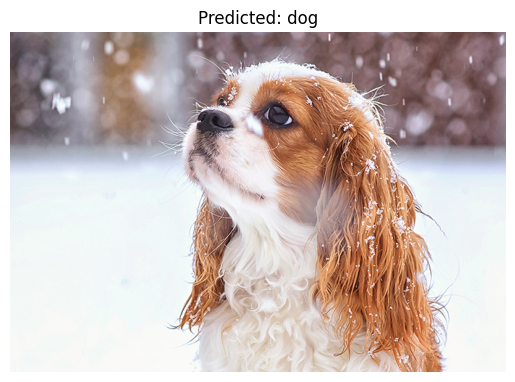

Classifying:  64%|██████████████████████████████████████████▋                        | 7/11 [00:01<00:00,  4.14image/s]

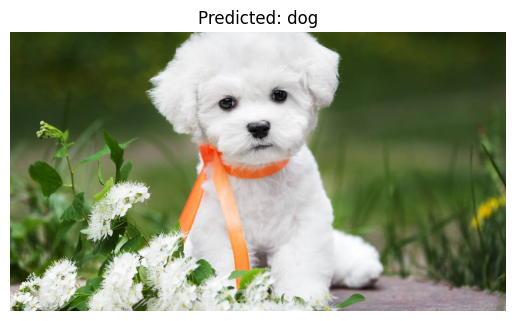

Classifying:  73%|████████████████████████████████████████████████▋                  | 8/11 [00:01<00:00,  4.17image/s]

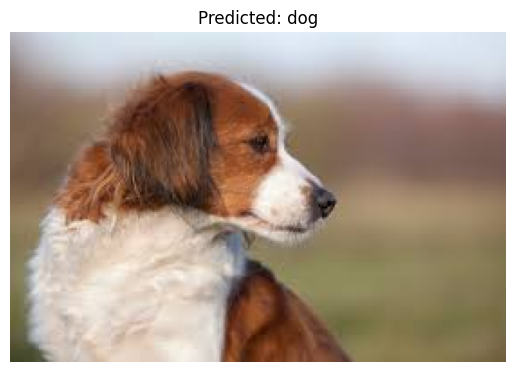

Classifying:  82%|██████████████████████████████████████████████████████▊            | 9/11 [00:01<00:00,  4.70image/s]

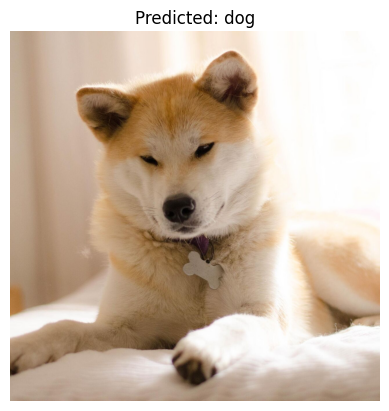

Classifying:  91%|████████████████████████████████████████████████████████████      | 10/11 [00:02<00:00,  4.16image/s]

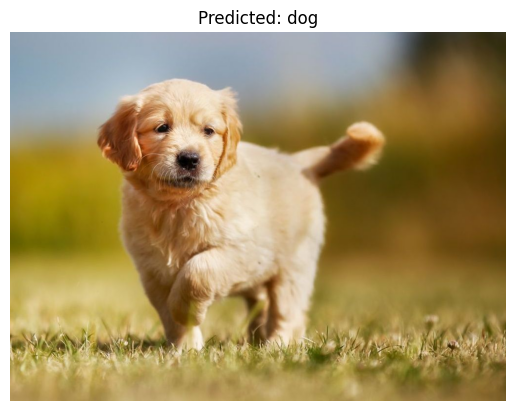

Classifying: 100%|██████████████████████████████████████████████████████████████████| 11/11 [00:02<00:00,  4.41image/s]

predictions: [0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1]


17:44:06-198140 INFO     Predictions: [0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1]

Precision: 0.8181818181818182, Recall: 0.8181818181818182, F1-score: 0.8181818181818182


17:44:06-204141 INFO     Precision: 0.8181818181818182, Recall: 0.8181818181818182, F1: 0.8181818181818182


(
    [0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1],
    [
        ('./images/cat.jpg', 0),
        ('./images/cat1.jpg', 0),
        ('./images/cat2.jpg', 0),
        ('./images/cat3.jpg', 1),
        ('./images/cat4.jpg', 0),
        ('./images/cat4.png', 0),
        ('./images/dog.png', 1),
        ('./images/dog1.jpg', 1),
        ('./images/dog2.jpg', 1),
        ('./images/dog3.jpg', 1),
        ('./images/dog4.jpg', 1)
    ]
)

In [242]:
inference_pipeline.inference()

# Выводы

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

<pre style="background-color: #888888; padding: 10px; border-radius: 5px; font-family: monospace;">
    <span style="color: white;">
        1. Лучший подход (Exp2) к решению дисбаланса классов оказался не очевидным, лучше эксперементировать.
        Какой подход выстрелит, думаю, зависит от набора данных.

        2. Трансфер обучения (ImageNet) естественным образом работает лучше, выше обобщающая способность,
        исходя из результатов инференса. + обучать меньше по времени, модель быстрее сходится.
    </span>
</pre>

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">